In [1]:
import pennylane as qml
import numpy as np
import matplotlib.pyplot as plt
import time
import datetime
import optax
from parent_dir import *
from data_gen import data_generator
import qutip
import gc
import os
import ipynbname  #! pip install ipynbname
from qiskit import QuantumCircuit, transpile
from qiskit_ibm_provider import IBMProvider
from qiskit_aer.noise import NoiseModel
from sklearn.model_selection import train_test_split

In [2]:
#nb_fname = ipynbname.name()
#ver = nb_fname[nb_fname.index('v'):nb_fname.index('_')]

In [3]:
# Added to silence some warnings.
from jax.config import config
config.update("jax_enable_x64", True)
import jax
import jax.numpy as jnp
jax.config.update('jax_platform_name', 'cpu')

In [4]:
ver = 'v9.9t'
problem = 'breast_cancer' #'3 circles'#'moon'#
shape =  "binary" #"bitwise" #"square plane"#"tetrahedron"#
rot = 'zyz' #'yzy' #'xzx' #
num_training = 400
num_test = 100

enc_dim = 3
num_qubits = 5
num_layers = 1
num_reupload = 1
num_rot = 1

max_n_converge = 10
thres_converge = 0.0001
preprocess = "scaling"#None #  "normalization"# "standardization" #
seed_num = data_seed_num= 40#

In [5]:
noise = training_noise = False#True#
fake_backend = False#True#
real_device =  False#True#
provider = IBMProvider(instance='ibm-q-hub-ntu/ntu-internal/default')
#provider = IBMProvider(instance='ibm-q/open/main')
backend = 'ibm_cusco'#'ibmq_jakarta'#'ibm_brisbane'#'ibmq_lima'#'ibmq_belem'#'ibmq_manila'#'ibmq_quito'#'ibm_lagos'#'ibm_nairobi'#''ibm_perth',#'ibm_oslo'#'ibmq_belem'#'ibmq_qasm_simulator'
#backend = provider.get_backend(backend)
#IBMProvider.save_account('155b8c03452e5e1f8e2b80e1f94f5ef9f02fbcbb3648cb260611a748cbee43b18eccd291859a83fb5830672e89078bd0395b260270b0c3de6c0c9aade6dbbbed')

date, day = time.strftime("%Y%m%d-%H%M"), time.strftime("%Y%m%d-%H")
cwd = os.getcwd()

In [6]:
import random
num_cvs = 5
num_seeds = 10
random.seed(seed_num)
seeds = [random.randint(0, 1E3) for _ in range(num_seeds)]
seeds

[469, 593, 898, 536, 32, 251, 289, 680, 984, 652]

In [7]:
# set range of aubits and rotations
settings, results= [], []
num_settings = r_enc, r_q ,r_f, r_r, r_rot = 1, 7, 1, 1, 1 #run the setting with n values
start_value = e0, q0, f0, r0, rot0 = 5, 1, 1, 3, 3

for e in range(r_enc):
    e = e+1 if r_enc!=1 else e0
    for q in range(r_q):
        q = q+1 if r_q!=1 else q0
        for f in range(r_f):
            f = f+1 if r_f!=1 else f0
            for r in range(r_r):
                r = r+1 if r_r!=1 else r0
                for n_rot in range(r_rot):
                    n_rot = n_rot+1 if r_rot!=1 else rot0
                    settings.append([e,q,f,r,n_rot] )

settings#=settings[:3]

[[5, 1, 1, 3, 3],
 [5, 2, 1, 3, 3],
 [5, 3, 1, 3, 3],
 [5, 4, 1, 3, 3],
 [5, 5, 1, 3, 3],
 [5, 6, 1, 3, 3],
 [5, 7, 1, 3, 3]]

In [8]:
h_params= {'lr':[[0.15,0.05,0.01],[0.15,0.05,0.01,0.001,0.0001]],  #
           'max_epoch':[3200],
           'batch_size':[50,100,300],
           'dynamic_size':[50],
           'thres':[[0.05,0.03,0.01]]}#]}#[0.05],
h_pms = [[i,j,k,l,m] for i in h_params['lr'] for j in h_params['max_epoch'] for k in h_params['batch_size'] for l in h_params['dynamic_size'] for m in h_params['thres']]
h_pms#=h_pms[:3]
h_pms

[[[0.15, 0.05, 0.01], 3200, 50, 50, [0.05, 0.03, 0.01]],
 [[0.15, 0.05, 0.01], 3200, 100, 50, [0.05, 0.03, 0.01]],
 [[0.15, 0.05, 0.01], 3200, 300, 50, [0.05, 0.03, 0.01]],
 [[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 50, 50, [0.05, 0.03, 0.01]],
 [[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 100, 50, [0.05, 0.03, 0.01]],
 [[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 300, 50, [0.05, 0.03, 0.01]]]

In [9]:
def model_noise(backend,fake_backend):
    #noise_model = None
    if fake_backend:   
        model_dict = {}
        i_bknd = backend.index('_')+1
        f_bknd = 'Fake'+backend[i_bknd].upper()+backend[i_bknd+1:]+'V2'
        import_str = "from {0} import {1}".format('qiskit.providers.fake_provider',f_bknd)
        exec(import_str,globals(),model_dict)
        exec('noise_model = NoiseModel.from_backend({})'.format(f_bknd+'()'),globals(),model_dict)
        noise_model = model_dict['noise_model']
    else:
        noise_model = NoiseModel.from_backend(provider.get_backend(backend)) #backend = provider.get_backend(backend)
    return noise_model
noise_model = model_noise(backend,fake_backend)

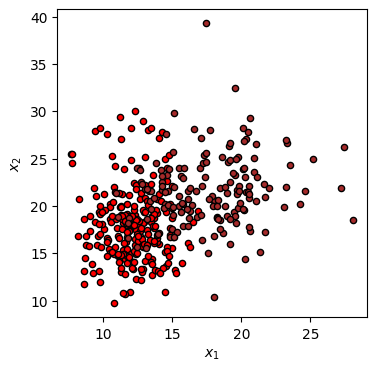

In [10]:
#key = jax.random.PRNGKey(seed_num)
def data_gen(problem,num_training=num_training, seed_num = 42):
    np.random.seed(seed_num)
    data=data_generator(problem,num_training)[0]
    x=np.array([i[0] for i in data])#.astype(float)
    y=np.array([i[1] for i in data])#.astype(float)
    return x,y #torch.tensor(x),torch.tensor(y)
    
def plot_data(x, y, fig=None, ax=None):
    if fig == None:
        fig, ax = plt.subplots(1, 1, figsize=(5, 5))
    brown = y == 0
    reds = y == 1
    green = y == 2
    blues = y == 3
    ax.scatter(x[reds, 0], x[reds, 1], c="red", s=20, edgecolor="k")
    ax.scatter(x[blues, 0], x[blues, 1], c="blue", s=20, edgecolor="k")
    ax.scatter(x[green, 0], x[green, 1], c="green", s=20, edgecolor="k")
    ax.scatter(x[brown, 0], x[brown, 1], c="brown", s=20, edgecolor="k")
    ax.set_xlabel("$x_1$")
    ax.set_ylabel("$x_2$")
    
Xdata, ydata = data_gen(problem,num_training)

fig, ax = plt.subplots(1, 1, figsize=(4, 4))
plot_data(Xdata, ydata, fig=fig, ax=ax)
plt.show()

theta= [0, 3.141592653589793] 
phi= [0, 0]
c_states= [[[1.000000e+00+0.j]
  [0.000000e+00+0.j]]

 [[6.123234e-17+0.j]
  [1.000000e+00+0.j]]] 
shape: (2, 2, 1)


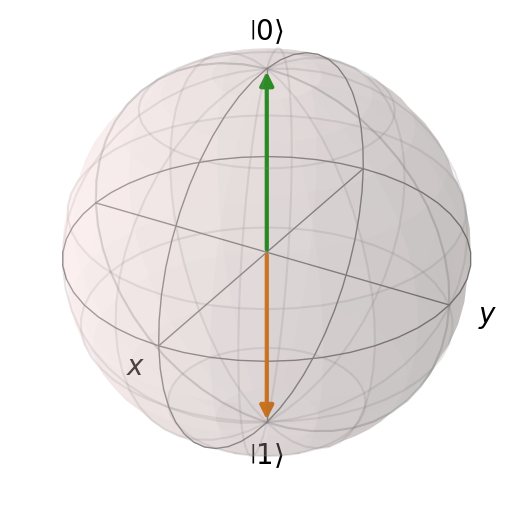

Array([[1.00000000e+00, 3.74939946e-33],
       [3.74939946e-33, 1.00000000e+00]], dtype=float64)

In [11]:
# Define output labels as quantum state vectors
def density_matrix(state):
    return state * np.conj(state).T

def state_labels(theta, phi):
    return [np.cos(np.array(a)/2)*label_0+np.exp(np.array(b)*1j)*np.sin(np.array(a)/2)*label_1 for a,b in zip(theta, phi)]

def plot_class_states(dm_labels, bloch3d=False):
    if bloch3d:
        b = qutip.Bloch() 
        b3d = qutip.Bloch3d()  #need Mayavi,PyQt
        for i in state_labels(theta, phi):
            s=(i[0,0]*qutip.basis(2, 0) + i[1,0]*qutip.basis(2, 1)).unit()
            b.add_states(s)
            b3d.add_states(s)
        b.show()
        b3d.show()
    else:
        b = qutip.Bloch() 
        for i in state_labels(theta, phi):
            s=(i[0,0]*qutip.basis(2, 0) + i[1,0]*qutip.basis(2, 1)).unit()
            b.add_states(s)
        b.show()
        
#Bloch sphere representation: 
#psi = alpha|0> + beta|1> = cos(theta/2)+e^(i*phi)sin(theta/2)


def angles(shape):
    shapes = ["square plane", "tetrahedron", "bitwise","binary"]
    shape = shape.lower()
    if shape not in shapes:
        raise ValueError('problem must be one of {}'.format(shapes))
    if shape == "square plane":
        theta = [np.pi/2]*4
        phi = [np.pi/4, -np.pi/4, 3*np.pi/4, -3*np.pi/4]
    if shape == "tetrahedron":
        X = [[0, 0], [0,1], [1,0],[1,1]]
        enc = []
        for x in X:
            MyEnc = [None, None]
            if x[0] or x[1]:
                #MyEnc[0] = 2*np.arccos(1/np.sqrt(3))
                MyEnc[0] = np.arccos(-1/3)
            else:
                MyEnc[0] = 0
            MyEnc[1] = (x[0]*2 + x[1])*2*np.pi/3
            enc.append(MyEnc)
            Enc = np.array(enc).T
        theta, phi = Enc[0], Enc[1]
    if shape in ["bitwise","binary"]:
        theta = [0,np.pi]
        phi = [0,0]
    return theta, phi

def yc(c_states,num_qubits=2): #mutual fidelities of c_states
    Yc = jnp.array([(np.abs(i.T.conj().dot(j)))**2 for i in c_states for j in c_states])
    Yc = Yc.reshape([num_class,num_class])
    if shape == "bitwise":
        for i in range(num_qubits-1):
            Yc = jnp.kron(Yc, Yc)
    return Yc
label_0 = np.array([[1.], [0.]])
label_1 = np.array([[0.], [1.]])

theta, phi = angles(shape)
num_class = len(theta)     # of class for one qubit
print('theta=',theta,'\nphi=',phi)
c_states = jnp.array(state_labels(theta, phi))
print('c_states=',c_states,'\nshape:',c_states.shape)
dm_labels = jnp.array([density_matrix(s) for s in c_states])
plot_class_states(dm_labels, bloch3d=False)  
# if 3d has err: pip install mayavi PyQt5 
# and see https://stackoverflow.com/questions/72110384/libgl-error-mesa-loader-failed-to-open-iris
# or https://askubuntu.com/questions/1418016/glibcxx-3-4-30-not-found-in-conda-environment
Yc = yc(c_states)

def totuple(a):
    try:
        return tuple(totuple(i) for i in a)
    except TypeError:
        return a.tolist()
dm_labels = totuple(dm_labels)
Yc

In [12]:
noise = training_noise
def device(num_qubits,noise=False,real_device=False,backend=backend,noise_model=None):
    if noise:
        if real_device:
            dev = qml.device('qiskit.ibmq.circuit_runner', wires=num_qubits, backend=backend, 
                             provider=provider,initial_layout= [1,2],start_session=True)#)#
        else:
            if not noise_model:
                noise_model = model_noise(backend,fake_backend)
            dev = qml.device('qiskit.aer', wires=num_qubits, diff_method="adjoint", noise_model=noise_model)#
    else: 
        dev = qml.device("default.qubit", wires=num_qubits)
    return dev
def conditional_qnode(f):
    def wrapper(*args):
        self = args[0]
        if self.noise:
            return qml.QNode(f,self.dev)(*args)
        else: 
            return qml.QNode(f,self.dev,interface='jax')(*args)
    return wrapper

In [13]:
class qcircuit:
    dev = device(num_qubits,noise,real_device,backend,noise_model)
    def __init__(self,params, x, y, n_qubits, n_layers, n_reupload, n_rot, enc_dim=2): 
        import math
        self.dev = device(num_qubits,noise,real_device,backend,noise_model)
        self.x = x
        self.y = y
        self.n_rot = n_rot
        self.n_qubits = n_qubits
        self.n_layers = n_layers
        self.n_reupload = n_reupload
        
        self.N = len(x[0])                                 # # of examples, and x = X_train.T
        self.noise = noise
        self.params = params   
        self.dim_x = (len(x))                              # dimension of x
        self.enc_dim = enc_dim
        self.least_q = math.ceil(self.dim_x/enc_dim)       # least qubit # for encoding
        if self.least_q>n_qubits: raise ValueError("Number of qubits not enough for encoding features.")
        
    def reshape_input(self,x_in): #'''May cause some prob ex. dim_in=4, enc_dim=3, q=5 e.g. not all enc_dim is filled'''
        enc_dim , n_qubits = self.enc_dim, self.n_qubits
        self.dim_in = len(x_in)
        if n_qubits*enc_dim >= self.dim_in*2:       # repeat to fill all qubits
            self.rep = n_qubits*enc_dim//self.dim_in
            x_in = jnp.tile(x_in,(self.rep,1))
        if remain_dim:=enc_dim*n_qubits-len(x_in):           # make x_in be integer multiple of enc_dim
            x_in = jnp.vstack((np.zeros((remain_dim,self.N)), x_in)) 
        x_in = x_in.reshape(len(x_in)//enc_dim,enc_dim,self.N) # (least_q_#,enc_dim,N) ## each qubit have enc_dim input dims
        return x_in
    def encode_op(self,x):
        op = ()
        #print(x[0][0].shape)
        for q in range(self.n_qubits):
            for e_i in range(self.enc_dim):
                if even := (e_i+1)%2:   #Rx(0)Rx(2)...
                    op = op+(qml.RX(x[q][e_i], wires=q),)
                    if e_i>=len(x[0]): op = op+(qml.RX(0, wires=q),)  ;print('Warning: # of encoding features is more than enc_dim.')                   
                else:                   #Ry(1)Ry(3)...
                    op = op+(qml.RY(x[q][e_i], wires=q),)
                    if e_i>=len(x[0]): op = op+(qml.RY(0, wires=q),)  ;print('Warning: # of encoding features is more than enc_dim.') 
                    # Notice that JAX don't have IndexError: out of bound error.
                    # It simply returns the last results.
        return op

    def reupload_op(self,x):
        op=()
        for q in range(self.n_qubits):
            for e_i in range(self.enc_dim):
                if even := (e_i+1)%2:   #RxRyRxRy...(0,1,2,...)
                    op = op+(qml.RX(x[q][e_i], wires=q),)
                    if e_i>=len(x[0]): op = op+(qml.RX(0, wires=q),)  ;print('Warning: # of encoding features is more than enc_dim.')                   
                else:
                    op = op+(qml.RY(x[q][e_i], wires=q),)
                    if e_i>=len(x[0]): op = op+(qml.RY(0, wires=q),)  ;print('Warning: # of encoding features is more than enc_dim.') 
        return op

    def rot_op(self,p):
        op = ()
        #p = self.params['params'][0]
        rots = ["zyz", "xzx", "yzy"]
        if rot not in rots:
            raise ValueError('rotation must be one of {}'.format(rots))
        if rot=='zyz':
            for n_rot in range(self.n_rot):
                for q in range(self.n_qubits):
                    op = op+(qml.Rot(*p[q,n_rot], wires=q),)
                    op = op+(qml.CNOT(wires=[q-1,q]),) if q != 0 else op
        if rot=='xzx':
            for n_rot in range(self.n_rot):
                for q in range(self.n_qubits):
                    op = op+(qml.Rot(*p[q,n_rot], wires=q),)
                    op = op+(qml.CNOT(wires=[q-1,q]),) if q != 0 else op
        if rot=='yzy':
            for n_rot in range(self.n_rot):
                for q in range(self.n_qubits):
                    op = op+(qml.Rot(*p[q,n_rot], wires=q),)
                    op = op+(qml.CNOT(wires=[q-1,q]),) if q != 0 else op
        return op

    # @qml.qnode(dev,interface='jax')   ## To print circuit, use @qml.qnode instead of @conditional_qnode
    @conditional_qnode
    def enc_circuit(self,p, x):
        # p0=p['scaling']
        # p0=jnp.tile(p0,(self.n_qubits,1))
        for r_j in range(self.n_reupload):
            p1 = p['scaling'][r_j][:len(x)]#
            p2 = p['circ'][r_j]
            p1=jnp.tile(p1.reshape(len(x),self.enc_dim,1),(1,1,self.N))

            x2 = x*p1
            #x2=[x[0],x[1]*p[12],x[2]*p[13],x[3]*p[14],x[4]*p[15],x[5]*p[16]] if problem=='breast_cancer' else [x[:,0],x[:,1]*p[12],x[:,2]*p[13]]
            qml.apply(self.encode_op(x2))
            qml.apply(self.rot_op(p2))
            
        return [qml.expval(qml.PauliZ(q)) for q in range(self.n_qubits)]

    @conditional_qnode
    def circuit(self,p, x):
        #p0 = p['params']
        #x2=[x[0],x[1]*p0[12],x[2]*p0[13]]
        x1 = jnp.tile(x,(self.enc_dim,1,1)).reshape(self.n_qubits,self.enc_dim,self.N) # (q,N)->(enc,q,N)->(q,enc,N)
        for r_j in range(self.n_reupload):
            p1 = p['scaling'][r_j]
            p2 = p['circ'][r_j]
            p1=jnp.tile(p1.reshape(self.n_qubits,self.enc_dim,1),(1,1,self.N))
            x2 = p1*x1
            qml.apply(self.reupload_op(x2))
            qml.apply(self.rot_op(p2))
        
        return [qml.expval(qml.PauliZ(q)) for q in range(self.n_qubits)]
    
    # @qml.qnode(dev,interface='jax')
    @conditional_qnode
    def circuit_end(self,p, x, y):
        y=np.array(y)
        for r_j in range(self.n_reupload):
            p1 = p['scaling'][r_j]
            p2 = p['circ'][r_j]
            p1=jnp.tile(p1.reshape(self.n_qubits,self.enc_dim,1),(1,1,self.N))
            # p = p['params']
            # x2=[x[0],x[1]*p[12],x[2]*p[13]]
            if self.n_layers==1:
                # x2=[x[0],x[1]*p[12],x[2]*p[13],x[3]*p[14],x[4]*p[15],x[5]*p[16]] if problem=='breast_cancer' else [x[0],x[1]*p[12],x[2]*p[13]]
                x2 = x*p1
                qml.apply(self.encode_op(x2))
            else:
                x1 = jnp.tile(x,(self.enc_dim,1,1)).reshape(self.n_qubits,self.enc_dim,self.N) # (q,N)->(enc,q,N)->(q,enc,N)
                x2 = x1*p1
                qml.apply(self.reupload_op(x2))        
            qml.apply(self.rot_op(p2))
        return [qml.expval(qml.Hermitian(y, wires=[q])) for q in range(self.n_qubits)] 
        #return qml.expval(qml.Hermitian(y, wires=[0])) ,qml.expval(qml.Hermitian(y, wires=[1]))

    def qc_2q(self):
        x = self.reshape_input(self.x)
        params, y = self.params, self.y    
        for f_i in range(self.n_layers-1):
            #p = params[f_i]
            #print(x.shape)
            x = jnp.array(ocs)
            p = {i:j[f_i] for i,j in params.items()}
            ocs = self.enc_circuit(p, x) if f_i==0 else self.circuit(p, x)
            # ocs =  self.enc_circuit(self,p, x) if f_i==0 else self.circuit(p, x)
            # print(qml.draw(self.enc_circuit)(self,p, x)) ## To print circuit, use @qml.qnode instead of @conditional_qnode 

            
        p = {i:j[self.n_layers-1] for i,j in params.items()}
        #p = params[self.n_layers-1]
        ocs =  self.circuit_end(p, x, y)
        x = ocs
        return ocs
    jqc_2q = jax.jit(qc_2q, static_argnums=(0))

In [14]:
# a=qcircuit(params, jnp.array([X_train[:,0],X_train[:,1]]), dm_labels[0],num_qubits, num_layers,num_reupload,num_rot,enc_dim)
# zzz = a.qc_2q()

In [15]:
# a=qcircuit(params, jnp.array([X_train[:,0],X_train[:,1]]), dm_labels[0], n_qubits, num_layers,enc_dim)
# ccc = a.jqc_2q()

In [16]:
#zzz[1]-ccc[1]

In [17]:
def test(params, x, y, *args, **kwargs):
    # args : num_qubits,num_layers,num_reupload,num_rot,enc_dim
    #num_qubits,num_layers,num_reupload,num_rot,enc_dim = args if args else [None]*5
        
    def fidel_function(params, x_i,y):  
        qc = qcircuit(params, x_i, y, num_qubits,num_layers,num_reupload,num_rot,enc_dim)
        if noise:
            return qc.qc_2q()
        else:
            print('circuit is jitted')
            return qc.jqc_2q()

    def jloss(params,fidelities,y_i):
        b = 1 if shape=="bitwise" else 0        
        #print('fidelities',fidelities.shape)
        return sum([1/2*(params[num_layers+i,j]*fidelities[i,j]-Yc[y_i,2*i*b+j])**2 for  i in range(num_qubits) for j in range(num_class)])    
        #return sum([-(Yc[y_i,2*i*b+j]*jnp.log(fidelities[i,j])) for  i in range(num_qubits) for j in range(num_class)])    
        
    def cost(params,x,y):
        x_in = x.T   #[[0 vector],[x1 vector],[x2 vector]]
        loss = 0
        predicted = []
        #print('yshape',y.shape)
        tot_fidelities = jnp.array([fidel_function(params, x_in, dm) for dm in dm_labels]).T #shape:(N,#qubit,#class)
        tot_fidelities = tot_fidelities.reshape(len(y),num_qubits,num_class)
        
        tot_fids = jax.vmap(jnp.kron,(0,0),0)(tot_fidelities[:,0],tot_fidelities[:,1]).reshape(len(y),num_qubits,num_class) if shape=="bitwise" else tot_fidelities
        Loss = jax.vmap(jloss,(None,0,0))(params['loss'],tot_fids,y)
        Loss = jnp.sum(Loss)/len(y)/num_qubits
        predicted = jax.vmap(np.argmax)(tot_fids) if shape == "bitwise" else jax.vmap(np.argmax)(tot_fids)%num_class
        return Loss, predicted

    '''for diff input to same fun., if u take grad after operation it will csuse error
       But do operation seperately (for diff input) and add together is ok '''
    '''grad go to 0 if u diff over fun of fun； 
       which is: diff(fun(p)) is ok, but if f=fun(p), diff(f) is 0  
       2022/12/26'''
    (loss,predicted), grad = jax.value_and_grad(cost, has_aux=True)(params,x,y)
    return jnp.array(predicted), loss, grad

jtest =  test if noise else jax.jit(test) 

In [18]:
#@jax.jit
def accuracy_score(y_true, y_pred):
    score = y_true == y_pred
    return score.sum().astype(int) / len(y_true)

def iterate_minibatches(inputs, targets, batch_size):
    for start_idx in range(0, inputs.shape[0], batch_size):
        idxs = slice(start_idx, start_idx + batch_size)
        yield inputs[idxs], targets[idxs]

In [19]:
def scores(params, x_tr, y_tr, x_te=None, y_te=None, report=False):
    
    predicted_train, loss , grads = jtest(params, x_tr, y_tr)
    accuracy_train = accuracy_score(y_tr, predicted_train)
    
    if x_te is None and y_te is None:
        return accuracy_train, loss  
    else:
        predicted_test, loss_test , grads_test = jtest(params, x_te, y_te)
        accuracy_test = accuracy_score(y_te, predicted_test)
        if report:
            from sklearn.metrics import classification_report
            return classification_report(y_te, predicted_test)
        else:
            return accuracy_train, loss, accuracy_test, loss_test    

In [20]:
def initialize_data(problem,n_training=None,n_test=None,seed_num=0,enc_dim=3):
    def normalize(x,preprocess='scaling'):
        from sklearn import preprocessing  
        if preprocess:
            preprocess = preprocess.lower()
            preprocesses = ["standardization", "scaling", "normalization"]
            if preprocess not in preprocesses:
                raise ValueError(f'preprocess must be one of {preprocesses}')
            if preprocess == 'standardization':
                x = preprocessing.StandardScaler().fit(x).transform(x)*2*np.pi
            if preprocess == 'scaling':
                x = preprocessing.MinMaxScaler().fit_transform(x)*2*np.pi
            if preprocess == 'normalization':
                x = preprocessing.normalize(x, norm='l2')*2*np.pi
        return x

    if problem=='breast_cancer':
        if n_training>569:
            raise ValueError('num_training must < 569')
        if n_test: global num_test # in order to change the global value of num_test
        if num_test > 569-n_training:
            num_test = n_test = 569-n_training
            print('Warning: num_test is set to', num_test)
        x,y = data_gen(problem,569,seed_num=seed_num)
        Xtrain, Xtest, y_train, y_test = train_test_split(
            x,y,test_size=n_test,train_size=n_training,
            random_state=seed_num,stratify=y)
    else:
        Xtrain, y_train = data_gen(problem,n_training,seed_num=seed_num)
        Xtest, y_test = data_gen(problem,n_test,seed_num=np.random.randint(1e6))
    
    X_train = Xtrain
    X_test = Xtest
        
    X_train = normalize(X_train,preprocess)
    X_test = normalize(X_test,preprocess)
    

    if n_training and n_test:
        return X_train, y_train, X_test, y_test
    else:
        if n_training:
            return X_train, y_train
        else:
            return X_test, y_test

In [21]:
# problem = 'breast_cancer'#'3 circles'#'moon'#
# shape =  "binary"#"tetrahedron"#"bitwise" #"square plane"#
# rot = 'zyz'#'yzy' #'xzx' #
# num_training = 400
# num_test = 500

# num_qubits = 2
# num_layers = 5

# #learning_rate,epochs,batch_size,dynamic_size,threshold = [0.15,0.05,0.01], 3000 , 50,20, [0.05]
# #learning_rate,epochs,batch_size,dynamic_size,threshold = [0.15,0.05,0.01,0.002,0.01],20000, 50,20, [0.05]#50, 0.01
# learning_rate,epochs,batch_size,dynamic_size,threshold = [0.15,0.05,0.01,0.001,0.0001],60000, 400, 50, [0.05,0.05,0.005,0.0001]#50, 0.01
# preprocess =  "scaling" #"standardization" # "normalization" #None#
# seed_num = 42#

In [22]:
# ##
# len_params = 12+enc_dim#len(X_train[0]) #12*params+dim_data*scaling factor
# params = initiallize_params(num_layers, num_reupload, num_qubits, len_params, enc_dim, seed_num)
# a=qcircuit(params, jnp.array([X_train[:,0],X_train[:,1]]), dm_labels[0],num_qubits, num_layers,num_reupload,enc_dim)
# zzz = a.qc_2q()

In [23]:
def initiallize_params(n_feedforward, n_reupload, n_qubits, enc_dim, n_rot, seed_num=40):
    num_layers = n_feedforward
    key = jax.random.PRNGKey(seed_num)
    key_s, key_c, key_l = jax.random.split(key,3)
    p_s = jax.random.uniform(key_s,(n_feedforward, n_reupload, n_qubits, enc_dim),dtype=jnp.float64) #12*params,2*scaling factor  
    p_c = jax.random.uniform(key_c,(n_feedforward, n_reupload, n_qubits, n_rot, 3),dtype=jnp.float64)
    p_l = jax.random.uniform(key_l,(n_qubits, num_class),dtype=jnp.float64)
    p = {'params':p_s,'scaling':p_s, 'circ':p_c,'loss':p_l}
    return p

In [24]:
# # Generate training and test data
# start = time.process_time()
# iter_lr = iter(learning_rate)
# iter_thres = iter(list(threshold))
# lr = next(iter_lr)
# thres_n = next(iter_thres)

# X_train, y_train, X_test, y_test = initialize_data(problem,num_training,num_test,seed_num,enc_dim)

# # initialize random weights
# len_params = 12+enc_dim#len(X_train[0]) #12*params+dim_data*scaling factor
# params = initiallize_params(num_layers, num_reupload, num_qubits, len_params, enc_dim, num_rot, seed_num)


# loss_history = []
# accuracy_history = []
# optimizer = optax.inject_hyperparams(optax.adam)(learning_rate=lr)#optax.adam(learning_rate=0.05)
# opt_state = optimizer.init(params)

In [25]:
# predicted_train, loss , grads = jtest(params, X_train, y_train)
# accuracy_train = accuracy_score(y_train, predicted_train)
# predicted_test, loss_test , grads_test = jtest(params, X_test, y_test)
# accuracy_test = accuracy_score(y_test, predicted_test)

# # save predictions with random weights for comparison
# initial_predictions = predicted_test

# start2 = time.process_time()
# print("Epoch: {:2d} | Cost: {:3f} | Train accuracy: {:3f} | Test Accuracy: {:3f}".format(0, loss, accuracy_train, accuracy_test))
# print('compile time:',start2-start)

In [26]:
def fit(params: optax.Params, optimizer: optax.GradientTransformation,opt_state,x,y,x_valid=None,y_valid=None) -> optax.Params:
  #opt_state = optimizer.init(params)
  def step(params, opt_state,x,y):
    loss_batches = jnp.array([])
    predicted_train = jnp.array([])
    iter_batch = iterate_minibatches(x, y, batch_size=batch_size)
    for x_batch, y_batch in iter_batch:
        predicted_batch, loss_batch , grads = jtest(params, x_batch, y_batch)
        updates, opt_state = optimizer.update(grads, opt_state, params)
        params = optax.apply_updates(params, updates)
        loss_batches = jax.numpy.append(loss_batches,loss_batch)
        predicted_train = jax.numpy.append(predicted_train, predicted_batch)
    loss_value = jnp.average(loss_batches)
    return params, opt_state, loss_value, predicted_train
  n_converge = 0

  
  #loss_history = []
  params_history = []
  state_history = []
  valid_accuracy_history=[]
  ave_loss = 1
  l_r = lr
  thres = thres_n
  for i  in range(max_epoch):
    i=i+1
    state_history.append(opt_state) #save value advance otherwise it saves the updated one
    params_history.append(params)
    
    params, opt_state, loss_value , predicted_train= step(params, opt_state, x, y)
    accuracy_train = accuracy_score(y, predicted_train)
    
    print(f'step {i}, accuracy_train:{accuracy_train}, loss: {loss_value}')
    if x_valid is not None and y_valid is not None:
        accuracy_valid, loss_valid = scores(params, x_valid, y_valid)
        valid_loss_history.append(float(loss_valid))
        valid_accuracy_history.append(float(accuracy_valid))
    loss_history.append(float(loss_value))    
    accuracy_history.append(float(accuracy_train))
    
    if i%dynamic_size==0:
        c_ave = sum(loss_history[-dynamic_size:])/dynamic_size #current loss average
        now_thres = abs(c_ave-ave_loss)/ave_loss
        print(now_thres)
        if  now_thres<=thres:
            try:
                l_r=next(iter_lr)#learning_rate
                #loc_best_accuracy = np.argmax(accuracy_history[-dynamic_size:])-dynamic_size
                loc_best_loss = np.argmin(loss_history[-dynamic_size:])-dynamic_size
                params = params_history[loc_best_loss]
                #print('best known accuracy:', accuracy_history[loc_best_accuracy]) #update lr based on accuracy
                print('accuracy of best loss :', accuracy_history[loc_best_loss]) #update lr based on loss
                
                opt_state.hyperparams['learning_rate'] = l_r
                #print('lr:', l_r, opt_state.hyperparams['learning_rate'])
                try:
                    thres = next(iter_thres)
                except StopIteration:
                    print(thres)
            except StopIteration:
                pass
        print('lr:', l_r, opt_state.hyperparams['learning_rate'])
        print(i)
        n_converge  = n_converge+1 if now_thres<thres_converge else 0
        ave_loss = c_ave
        
    if i==max_epoch or n_converge==max_n_converge:
        n_converge = 1 if n_converge==0 else n_converge 
        #loc_best_accuracy = np.argmax(accuracy_history[-dynamic_size*10:])-dynamic_size*10
        candidate_history = loss_history if x_valid is None else valid_loss_history
        loc_best_loss = np.argmin(candidate_history[-dynamic_size*n_converge:])-dynamic_size*n_converge
        params = params_history[loc_best_loss]
        opt_state = state_history[loc_best_loss]
        num_epoch = i
        print('lr:', l_r, opt_state.hyperparams['learning_rate'])
        print('accuracy of best loss:',accuracy_history[loc_best_loss],loc_best_loss)
        #print('best known accuracy:',accuracy_history[loc_best_loss],loc_best_loss)
        break
  return params, l_r, opt_state, num_epoch

In [27]:
if 'lay' not in ver:
    ver = ver+f'_lay{num_layers}'
    ver = ver+'_'+backend+'_'+date if noise else ver+'_'+date
#print(os.getcwd())
filename = ver[:ver.index('_')]
os.chdir(cwd)
if not os.path.exists('Figures/'+filename+'/'+day):
    try:
        os.mkdir('Figures/'+filename)
        os.mkdir('Figures/'+filename+'/'+day)
        os.chdir('Figures/'+filename+'/'+day)
    except FileExistsError:
        os.mkdir('Figures/'+filename+'/'+day)
        os.chdir('Figures/'+filename+'/'+day)
    except Exception as e:
        print(e)
else: os.chdir('Figures/'+filename+'/'+day)
print(os.getcwd())

/mnt/c/Users/paes20705/OneDrive/桌面/Main Programs/Python/Jupyter/Research/References/universal_qlassifier-master/test/Figures/v9.9t/20240720-16


In [28]:
def plot_loss_history(l_h, val_l_h=[], setting=None, fig_name=''):
    fig, ax = plt.subplots(1, 1)
    plt.plot(range(len(l_h)),l_h,color=(255/255,100/255,100/255),label='Loss')
    if val_l_h:
        plt.plot(range(len(val_l_h)),val_l_h,color='g',label='Validation loss')
    plt.title("Loss") # title
    plt.ylabel("loss") # y label
    plt.xlabel("epoch") # x label
    plt.legend()
    plt.show()
    if fig_name:
        fig.savefig('{}.png'.format(fig_name), transparent=True)
    elif fig_name is None:
        pass  #don't save, just print
    else:    
        fig.savefig('{}_loss.png'.format(setting), transparent=True)        

In [29]:
from sklearn.model_selection import StratifiedKFold
x,y, X_test, y_test = initialize_data(problem,num_training,num_test,seed_num,enc_dim)

skf = StratifiedKFold(n_splits=5)
for index_tr, index_te in skf.split(x, y):
    cv_xtr, cv_ytr = x[index_tr], y[index_tr]
    cv_xte, cv_yte = x[index_te], y[index_te]
    print(cv_xtr.shape,cv_ytr.shape)

(320, 5) (320,)
(320, 5) (320,)
(320, 5) (320,)
(320, 5) (320,)
(320, 5) (320,)


In [30]:
def n_cv(n_fold, x, y, setting, *var, seed_num=42):
    from sklearn.utils import shuffle
    from sklearn.model_selection import StratifiedKFold
    global loss_history,valid_loss_history, accuracy_history, loss_history_cvs 
    global iter_lr, iter_thres, lr, thres_n
    
    skf = StratifiedKFold(n_splits=5)
    enc_dim,num_qubits,num_layers,num_reupload,num_rot = setting 
    start = time.process_time()
    cv_rsts= []

    for index_tr, index_te in skf.split(x, y):
        cv_xtr, cv_ytr = x[index_tr], y[index_tr]
        cv_xte, cv_yte = x[index_te], y[index_te]
        
        iter_lr = iter(learning_rate)
        iter_thres = iter(list(threshold))
        lr = next(iter_lr)
        thres_n = next(iter_thres)
        
        # initialize random weights
        params = initiallize_params(num_layers, num_reupload, num_qubits, enc_dim, num_rot, seed_num)
        optimizer = optax.inject_hyperparams(optax.adam)(learning_rate=lr)#optax.adam(learning_rate=0.05)
        opt_state = optimizer.init(params)

        loss_history = []
        valid_loss_history = []
        accuracy_history = []

        params, lr, opt_state, num_epoch = fit(params, optimizer, opt_state, cv_xtr, cv_ytr, cv_xte, cv_yte)
        accuracy_train, loss, accuracy_test, loss_test = scores(params, cv_xtr, cv_ytr,cv_xte, cv_yte)
        loss_history_cvs.append([loss_history,valid_loss_history])
        print("Epoch: {:2d} | Cost: {:3f} | Train accuracy: {:3f} | Test Accuracy: {:3f}".format(0, loss, accuracy_train, accuracy_test))
        print(f"(n_dim, n_q, n_f, n_r, n_rot) = {enc_dim, num_qubits, num_layers, num_reupload, num_rot}")
        cv_rsts.append([accuracy_test, loss])
        plot_loss_history(loss_history, valid_loss_history, setting=setting, fig_name=None)
        
    end = time.process_time()
    print("cv_time ：%f s" % (end - start))
    return sum(np.array(cv_rsts)[:,0])/n_fold, sum(np.array(cv_rsts)[:,1])/n_fold

circuit is jitted
circuit is jitted
circuit is jitted
circuit is jitted
step 1, accuracy_train:0.66875, loss: 0.382261252184681
circuit is jitted
circuit is jitted
step 2, accuracy_train:0.784375, loss: 0.36314383303988873
step 3, accuracy_train:0.84375, loss: 0.35564091246827667
step 4, accuracy_train:0.84375, loss: 0.3503073339059149
step 5, accuracy_train:0.834375, loss: 0.3511697890823689
step 6, accuracy_train:0.89375, loss: 0.3491306413800996
step 7, accuracy_train:0.88125, loss: 0.35034146051933107
step 8, accuracy_train:0.871875, loss: 0.3518119297422358
step 9, accuracy_train:0.884375, loss: 0.3488548471519603
step 10, accuracy_train:0.88125, loss: 0.34542023357884244
step 11, accuracy_train:0.88125, loss: 0.34794682720504827
step 12, accuracy_train:0.85625, loss: 0.3525367684088301
step 13, accuracy_train:0.871875, loss: 0.3500570327538592
step 14, accuracy_train:0.86875, loss: 0.35237738991479484
step 15, accuracy_train:0.871875, loss: 0.3519531751077874
step 16, accuracy_tr

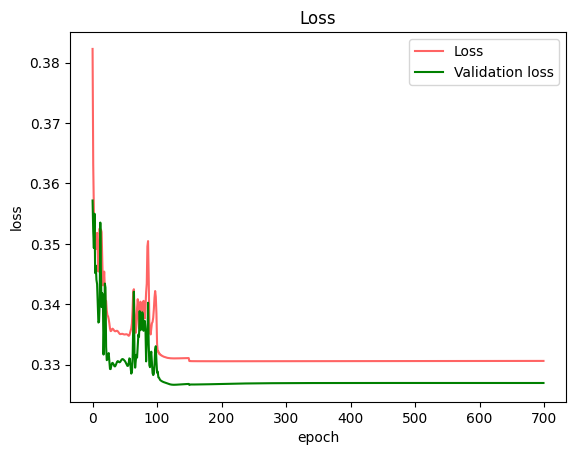

step 1, accuracy_train:0.696875, loss: 0.3740832276658621
step 2, accuracy_train:0.834375, loss: 0.3501403438179868
step 3, accuracy_train:0.878125, loss: 0.3458242591417225
step 4, accuracy_train:0.91875, loss: 0.33793277581915576
step 5, accuracy_train:0.91875, loss: 0.3355301165553261
step 6, accuracy_train:0.928125, loss: 0.33831202969622765
step 7, accuracy_train:0.91875, loss: 0.3371421696964996
step 8, accuracy_train:0.91875, loss: 0.3373440673305492
step 9, accuracy_train:0.9125, loss: 0.34037314508224004
step 10, accuracy_train:0.934375, loss: 0.3374369557896216
step 11, accuracy_train:0.925, loss: 0.33400105811514397
step 12, accuracy_train:0.928125, loss: 0.3350925162608329
step 13, accuracy_train:0.94375, loss: 0.3330652251270056
step 14, accuracy_train:0.93125, loss: 0.33234755065883254
step 15, accuracy_train:0.928125, loss: 0.3328254948008212
step 16, accuracy_train:0.93125, loss: 0.33355762931558064
step 17, accuracy_train:0.925, loss: 0.3344800850842486
step 18, accura

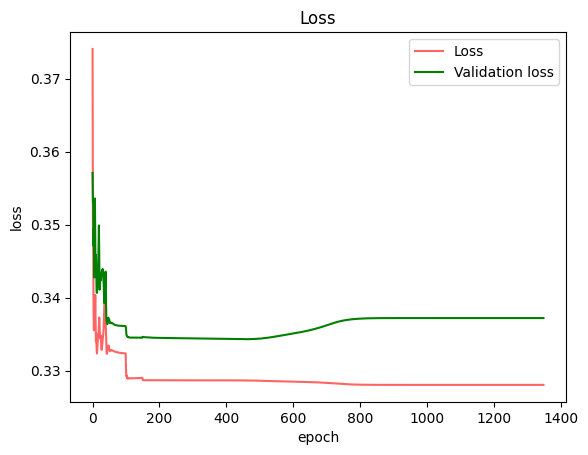

step 1, accuracy_train:0.66875, loss: 0.37968650556509337
step 2, accuracy_train:0.76875, loss: 0.36824063588771067
step 3, accuracy_train:0.7625, loss: 0.36383040823847956
step 4, accuracy_train:0.83125, loss: 0.3511150172255261
step 5, accuracy_train:0.875, loss: 0.3431635865157366
step 6, accuracy_train:0.909375, loss: 0.338082922855076
step 7, accuracy_train:0.9125, loss: 0.33689620412057913
step 8, accuracy_train:0.91875, loss: 0.33700134711623336
step 9, accuracy_train:0.9125, loss: 0.3362348282343338
step 10, accuracy_train:0.9125, loss: 0.3390852623541771
step 11, accuracy_train:0.903125, loss: 0.33999930835969305
step 12, accuracy_train:0.921875, loss: 0.33821142726693193
step 13, accuracy_train:0.925, loss: 0.33605560259108697
step 14, accuracy_train:0.925, loss: 0.33477988308268064
step 15, accuracy_train:0.928125, loss: 0.33461619078159377
step 16, accuracy_train:0.925, loss: 0.33392439810291585
step 17, accuracy_train:0.909375, loss: 0.3339446181753366
step 18, accuracy_tr

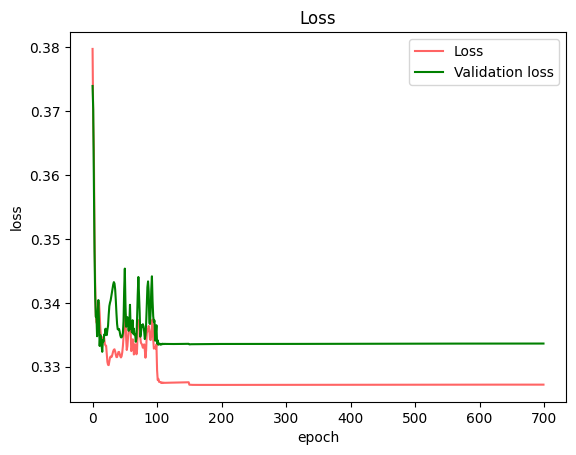

step 1, accuracy_train:0.6625, loss: 0.3775815108513593
step 2, accuracy_train:0.78125, loss: 0.3626605771714332
step 3, accuracy_train:0.821875, loss: 0.3530029318430912
step 4, accuracy_train:0.88125, loss: 0.3416560589378859
step 5, accuracy_train:0.903125, loss: 0.33802657772881084
step 6, accuracy_train:0.9125, loss: 0.33767365865392446
step 7, accuracy_train:0.915625, loss: 0.33788740611825496
step 8, accuracy_train:0.925, loss: 0.3356927335801077
step 9, accuracy_train:0.925, loss: 0.3348825341173829
step 10, accuracy_train:0.91875, loss: 0.33324151078296627
step 11, accuracy_train:0.93125, loss: 0.333035018628919
step 12, accuracy_train:0.928125, loss: 0.3329961278451635
step 13, accuracy_train:0.928125, loss: 0.3330607259732194
step 14, accuracy_train:0.921875, loss: 0.33288341943413624
step 15, accuracy_train:0.928125, loss: 0.332099195913275
step 16, accuracy_train:0.93125, loss: 0.3313906693461073
step 17, accuracy_train:0.928125, loss: 0.33102439833144015
step 18, accuracy

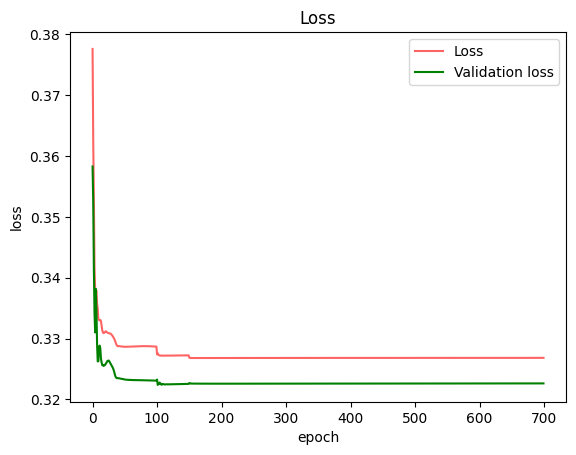

step 1, accuracy_train:0.684375, loss: 0.37545743523445957
step 2, accuracy_train:0.765625, loss: 0.3649281242991209
step 3, accuracy_train:0.79375, loss: 0.3610337919823319
step 4, accuracy_train:0.8, loss: 0.35939102980046467
step 5, accuracy_train:0.875, loss: 0.35182174279899636
step 6, accuracy_train:0.846875, loss: 0.35197316641254145
step 7, accuracy_train:0.89375, loss: 0.34772574318447863
step 8, accuracy_train:0.871875, loss: 0.3471956864482042
step 9, accuracy_train:0.853125, loss: 0.3494830781320082
step 10, accuracy_train:0.846875, loss: 0.3520761868588279
step 11, accuracy_train:0.86875, loss: 0.343982925012841
step 12, accuracy_train:0.934375, loss: 0.33585433340586296
step 13, accuracy_train:0.921875, loss: 0.33509244066475624
step 14, accuracy_train:0.9125, loss: 0.33629426202119217
step 15, accuracy_train:0.90625, loss: 0.339283101631241
step 16, accuracy_train:0.9, loss: 0.3411949768265144
step 17, accuracy_train:0.88125, loss: 0.3427637643413696
step 18, accuracy_tr

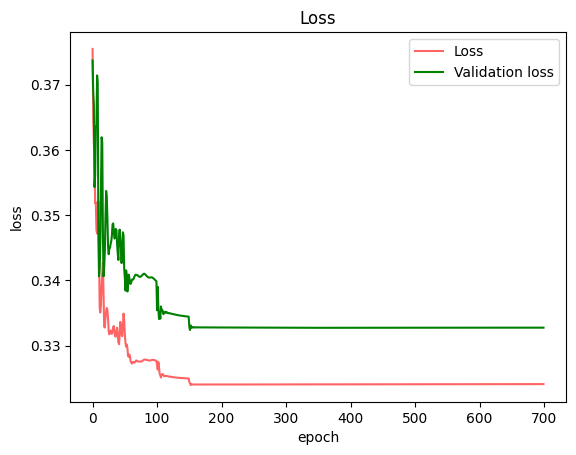

cv_time ：68.663255 s
[[0.15, 0.05, 0.01], 3200, 50, 50, [0.05, 0.03, 0.01]]
circuit is jitted
circuit is jitted
step 1, accuracy_train:0.71875, loss: 0.3737967156329122
step 2, accuracy_train:0.778125, loss: 0.3632180631561197
step 3, accuracy_train:0.825, loss: 0.3579097515775967
step 4, accuracy_train:0.846875, loss: 0.35138010058120717
step 5, accuracy_train:0.8625, loss: 0.3497754670372558
step 6, accuracy_train:0.884375, loss: 0.3434099172997136
step 7, accuracy_train:0.896875, loss: 0.3401959135363933
step 8, accuracy_train:0.896875, loss: 0.3379954364581187
step 9, accuracy_train:0.915625, loss: 0.3364612356466774
step 10, accuracy_train:0.934375, loss: 0.33550213307514454
step 11, accuracy_train:0.91875, loss: 0.33416660230391937
step 12, accuracy_train:0.934375, loss: 0.3338389601797236
step 13, accuracy_train:0.925, loss: 0.3339323794575232
step 14, accuracy_train:0.93125, loss: 0.3336363026258715
step 15, accuracy_train:0.915625, loss: 0.33567298900737796
step 16, accuracy_t

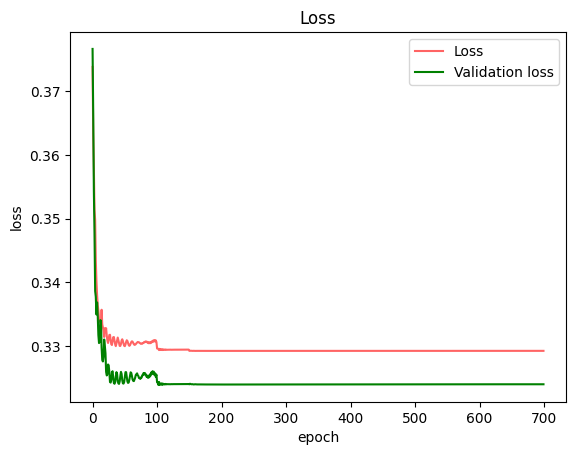

step 1, accuracy_train:0.65, loss: 0.385251593242273
step 2, accuracy_train:0.69375, loss: 0.37740240940241127
step 3, accuracy_train:0.74375, loss: 0.3683076779168572
step 4, accuracy_train:0.878125, loss: 0.3493525607589548
step 5, accuracy_train:0.890625, loss: 0.3449274606532059
step 6, accuracy_train:0.871875, loss: 0.34583998933505855
step 7, accuracy_train:0.8875, loss: 0.3405247736037923
step 8, accuracy_train:0.90625, loss: 0.3391110247351631
step 9, accuracy_train:0.909375, loss: 0.33831604491610306
step 10, accuracy_train:0.915625, loss: 0.33674086098066375
step 11, accuracy_train:0.90625, loss: 0.3347582808870016
step 12, accuracy_train:0.928125, loss: 0.3339222068976223
step 13, accuracy_train:0.9125, loss: 0.3340181900465572
step 14, accuracy_train:0.915625, loss: 0.3330822580558944
step 15, accuracy_train:0.915625, loss: 0.332480638043135
step 16, accuracy_train:0.915625, loss: 0.33200162374759534
step 17, accuracy_train:0.921875, loss: 0.33171714733022817
step 18, accur

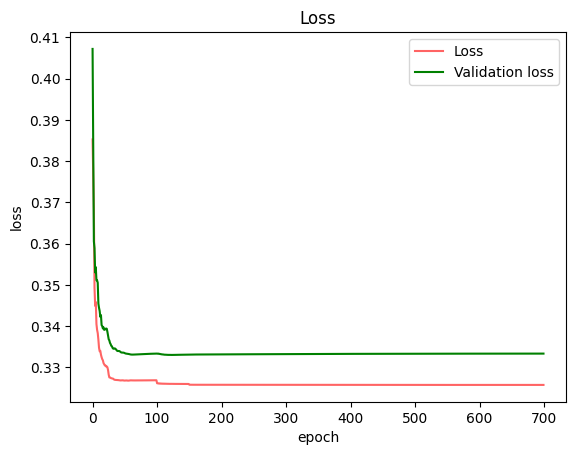

step 1, accuracy_train:0.63125, loss: 0.3823817683860058
step 2, accuracy_train:0.79375, loss: 0.3636709053076654
step 3, accuracy_train:0.871875, loss: 0.344946295634704
step 4, accuracy_train:0.828125, loss: 0.3468315587757854
step 5, accuracy_train:0.88125, loss: 0.3441306983267717
step 6, accuracy_train:0.903125, loss: 0.34011858621316116
step 7, accuracy_train:0.903125, loss: 0.33849134637079703
step 8, accuracy_train:0.896875, loss: 0.33878795819505686
step 9, accuracy_train:0.89375, loss: 0.33708824949984556
step 10, accuracy_train:0.9125, loss: 0.335711541176614
step 11, accuracy_train:0.915625, loss: 0.33372933594103904
step 12, accuracy_train:0.921875, loss: 0.3325886217896341
step 13, accuracy_train:0.9125, loss: 0.33164161861811875
step 14, accuracy_train:0.925, loss: 0.33197440423775126
step 15, accuracy_train:0.915625, loss: 0.3324518059508672
step 16, accuracy_train:0.921875, loss: 0.3315777203363688
step 17, accuracy_train:0.934375, loss: 0.3303677075690721
step 18, acc

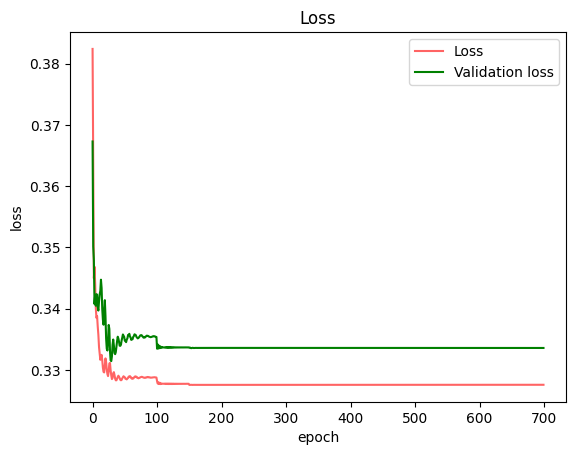

step 1, accuracy_train:0.634375, loss: 0.38428694622077897
step 2, accuracy_train:0.85625, loss: 0.35674231636631665
step 3, accuracy_train:0.865625, loss: 0.34700254010019077
step 4, accuracy_train:0.834375, loss: 0.350447424190661
step 5, accuracy_train:0.828125, loss: 0.3540335387134643
step 6, accuracy_train:0.903125, loss: 0.3446910366316393
step 7, accuracy_train:0.859375, loss: 0.3495570739450134
step 8, accuracy_train:0.878125, loss: 0.3466825463817782
step 9, accuracy_train:0.909375, loss: 0.34041418444463967
step 10, accuracy_train:0.8875, loss: 0.3422988272836688
step 11, accuracy_train:0.90625, loss: 0.33945812413305865
step 12, accuracy_train:0.896875, loss: 0.33979473011914285
step 13, accuracy_train:0.90625, loss: 0.3366351725151759
step 14, accuracy_train:0.909375, loss: 0.3353410651986401
step 15, accuracy_train:0.909375, loss: 0.33501857884824043
step 16, accuracy_train:0.9125, loss: 0.3364754901141036
step 17, accuracy_train:0.909375, loss: 0.3351835076910982
step 18

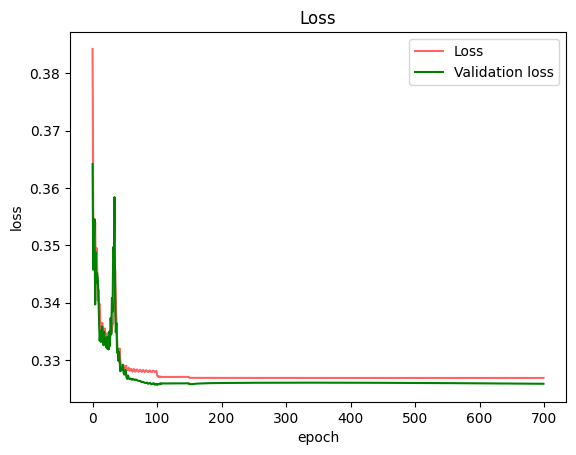

step 1, accuracy_train:0.621875, loss: 0.3877025427539128
step 2, accuracy_train:0.66875, loss: 0.3757895907828852
step 3, accuracy_train:0.81875, loss: 0.35629122299385274
step 4, accuracy_train:0.85, loss: 0.35302693843673827
step 5, accuracy_train:0.871875, loss: 0.3438696525831739
step 6, accuracy_train:0.86875, loss: 0.343595440170925
step 7, accuracy_train:0.884375, loss: 0.34149741482296114
step 8, accuracy_train:0.88125, loss: 0.34185264605999677
step 9, accuracy_train:0.909375, loss: 0.3378756407865053
step 10, accuracy_train:0.90625, loss: 0.33672310526759597
step 11, accuracy_train:0.89375, loss: 0.33859076030743734
step 12, accuracy_train:0.89375, loss: 0.3395588263586698
step 13, accuracy_train:0.896875, loss: 0.3361578136774023
step 14, accuracy_train:0.909375, loss: 0.33511491536562216
step 15, accuracy_train:0.903125, loss: 0.3361801651138771
step 16, accuracy_train:0.896875, loss: 0.3398285866987722
step 17, accuracy_train:0.890625, loss: 0.3372384963416659
step 18, ac

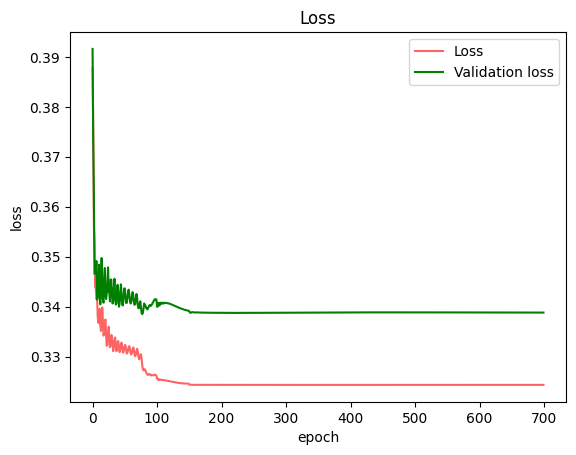

cv_time ：31.221890 s
[[0.15, 0.05, 0.01], 3200, 100, 50, [0.05, 0.03, 0.01]]
circuit is jitted
circuit is jitted
step 1, accuracy_train:0.621875, loss: 0.3817834565933226
step 2, accuracy_train:0.759375, loss: 0.3832337855973701
step 3, accuracy_train:0.71875, loss: 0.3671176744327015
step 4, accuracy_train:0.75, loss: 0.36406025398323183
step 5, accuracy_train:0.825, loss: 0.3517819879253926
step 6, accuracy_train:0.771875, loss: 0.353083828014909
step 7, accuracy_train:0.8625, loss: 0.3437803785164846
step 8, accuracy_train:0.84375, loss: 0.341335441104787
step 9, accuracy_train:0.840625, loss: 0.34041066128097236
step 10, accuracy_train:0.85625, loss: 0.3397027362307974
step 11, accuracy_train:0.884375, loss: 0.3361763261947498
step 12, accuracy_train:0.865625, loss: 0.3371165691623287
step 13, accuracy_train:0.89375, loss: 0.3368166900522632
step 14, accuracy_train:0.9, loss: 0.33358989191611665
step 15, accuracy_train:0.8875, loss: 0.3334268154795233
step 16, accuracy_train:0.8906

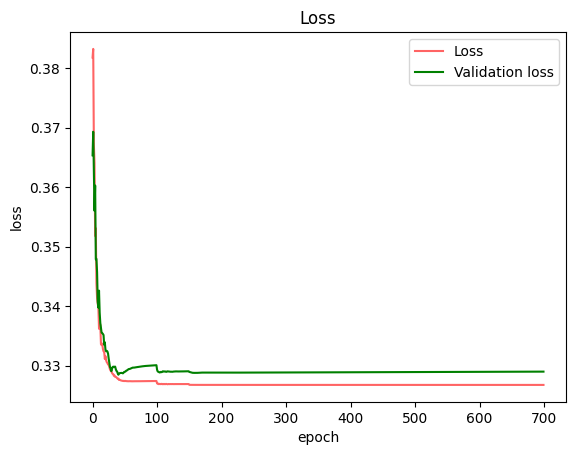

step 1, accuracy_train:0.615625, loss: 0.38128752031265456
step 2, accuracy_train:0.7875, loss: 0.37918232667713436
step 3, accuracy_train:0.721875, loss: 0.3672883571945149
step 4, accuracy_train:0.746875, loss: 0.365013220355672
step 5, accuracy_train:0.8375, loss: 0.3490028416522172
step 6, accuracy_train:0.765625, loss: 0.35219540617120215
step 7, accuracy_train:0.86875, loss: 0.3432691747927985
step 8, accuracy_train:0.85625, loss: 0.34157287622254573
step 9, accuracy_train:0.865625, loss: 0.3378397887181324
step 10, accuracy_train:0.878125, loss: 0.33745575419739904
step 11, accuracy_train:0.875, loss: 0.33518472874204636
step 12, accuracy_train:0.853125, loss: 0.3358099835912145
step 13, accuracy_train:0.9, loss: 0.33529356734829585
step 14, accuracy_train:0.915625, loss: 0.33165380135907474
step 15, accuracy_train:0.890625, loss: 0.33213093870652577
step 16, accuracy_train:0.896875, loss: 0.3321289743872411
step 17, accuracy_train:0.896875, loss: 0.3309196236553842
step 18, acc

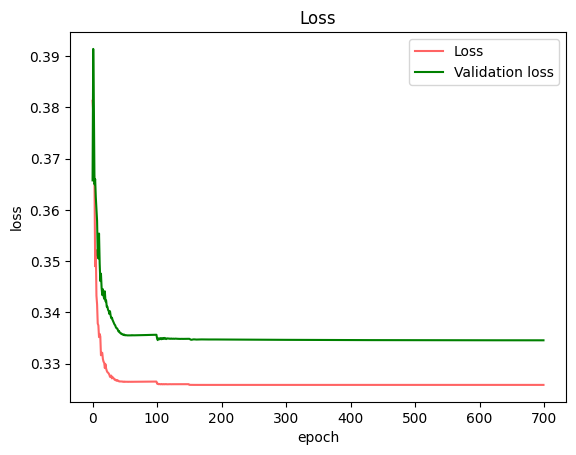

step 1, accuracy_train:0.590625, loss: 0.38252320553371755
step 2, accuracy_train:0.765625, loss: 0.3821560991631343
step 3, accuracy_train:0.75, loss: 0.36553483461761616
step 4, accuracy_train:0.75625, loss: 0.3638602534060778
step 5, accuracy_train:0.83125, loss: 0.34886251563495674
step 6, accuracy_train:0.778125, loss: 0.3521119303692542
step 7, accuracy_train:0.84375, loss: 0.34423830864165517
step 8, accuracy_train:0.85625, loss: 0.34000002015591707
step 9, accuracy_train:0.85625, loss: 0.33908247252032364
step 10, accuracy_train:0.871875, loss: 0.3392480466633984
step 11, accuracy_train:0.88125, loss: 0.336628442430873
step 12, accuracy_train:0.85625, loss: 0.3354202562332789
step 13, accuracy_train:0.890625, loss: 0.33516162501681523
step 14, accuracy_train:0.884375, loss: 0.3323436448201472
step 15, accuracy_train:0.89375, loss: 0.33270627253650864
step 16, accuracy_train:0.890625, loss: 0.33249205329734527
step 17, accuracy_train:0.89375, loss: 0.3320830823666026
step 18, ac

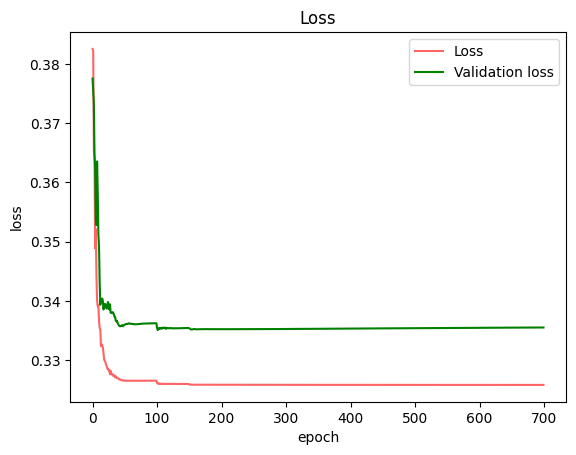

step 1, accuracy_train:0.6, loss: 0.382038157089194
step 2, accuracy_train:0.765625, loss: 0.3820722797263692
step 3, accuracy_train:0.71875, loss: 0.37166669143994197
step 4, accuracy_train:0.76875, loss: 0.36735970222638736
step 5, accuracy_train:0.803125, loss: 0.3507102311825204
step 6, accuracy_train:0.765625, loss: 0.3561818574876463
step 7, accuracy_train:0.8375, loss: 0.3441161988499599
step 8, accuracy_train:0.834375, loss: 0.34608128400688765
step 9, accuracy_train:0.8375, loss: 0.34183138578356226
step 10, accuracy_train:0.825, loss: 0.3387425660767366
step 11, accuracy_train:0.85625, loss: 0.33871452411059416
step 12, accuracy_train:0.875, loss: 0.3347716938360919
step 13, accuracy_train:0.865625, loss: 0.33642921154784294
step 14, accuracy_train:0.896875, loss: 0.33515907112728094
step 15, accuracy_train:0.9, loss: 0.3319631923651083
step 16, accuracy_train:0.875, loss: 0.33245859652351484
step 17, accuracy_train:0.878125, loss: 0.33277937223863635
step 18, accuracy_train:

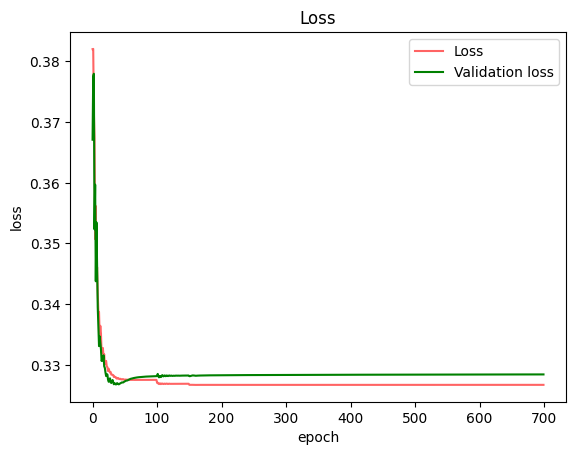

step 1, accuracy_train:0.6125, loss: 0.3843288308626642
step 2, accuracy_train:0.8, loss: 0.37215194392007184
step 3, accuracy_train:0.746875, loss: 0.3551684987415934
step 4, accuracy_train:0.840625, loss: 0.35151268916259704
step 5, accuracy_train:0.828125, loss: 0.34764104936499896
step 6, accuracy_train:0.871875, loss: 0.33729083627902245
step 7, accuracy_train:0.88125, loss: 0.3361024231534455
step 8, accuracy_train:0.88125, loss: 0.3355583877830127
step 9, accuracy_train:0.89375, loss: 0.33058105011510674
step 10, accuracy_train:0.878125, loss: 0.3327770334740283
step 11, accuracy_train:0.89375, loss: 0.3313812222085306
step 12, accuracy_train:0.88125, loss: 0.33073048165785723
step 13, accuracy_train:0.9, loss: 0.3308299340399574
step 14, accuracy_train:0.9, loss: 0.32896373153563774
step 15, accuracy_train:0.89375, loss: 0.3293142050479907
step 16, accuracy_train:0.909375, loss: 0.3275195277800801
step 17, accuracy_train:0.90625, loss: 0.3274541209350421
step 18, accuracy_train

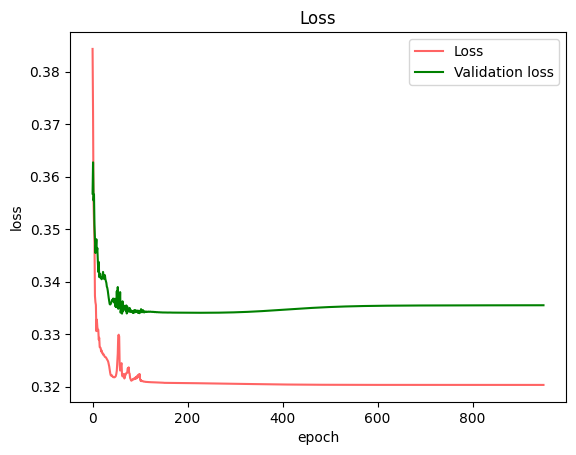

cv_time ：20.530543 s
[[0.15, 0.05, 0.01], 3200, 300, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.66875, loss: 0.382261252184681
step 2, accuracy_train:0.784375, loss: 0.36314383303988873
step 3, accuracy_train:0.84375, loss: 0.35564091246827667
step 4, accuracy_train:0.84375, loss: 0.3503073339059149
step 5, accuracy_train:0.834375, loss: 0.3511697890823689
step 6, accuracy_train:0.89375, loss: 0.3491306413800996
step 7, accuracy_train:0.88125, loss: 0.35034146051933107
step 8, accuracy_train:0.871875, loss: 0.3518119297422358
step 9, accuracy_train:0.884375, loss: 0.3488548471519603
step 10, accuracy_train:0.88125, loss: 0.34542023357884244
step 11, accuracy_train:0.88125, loss: 0.34794682720504827
step 12, accuracy_train:0.85625, loss: 0.3525367684088301
step 13, accuracy_train:0.871875, loss: 0.3500570327538592
step 14, accuracy_train:0.86875, loss: 0.35237738991479484
step 15, accuracy_train:0.871875, loss: 0.3519531751077874
step 16, accuracy_train:0.878125, loss: 0.347522941

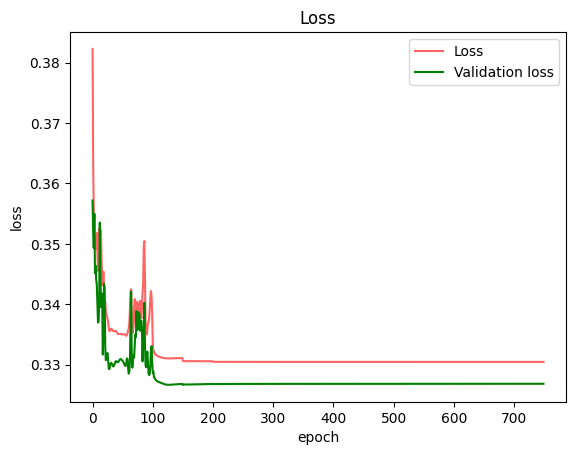

step 1, accuracy_train:0.696875, loss: 0.3740832276658621
step 2, accuracy_train:0.834375, loss: 0.3501403438179868
step 3, accuracy_train:0.878125, loss: 0.3458242591417225
step 4, accuracy_train:0.91875, loss: 0.33793277581915576
step 5, accuracy_train:0.91875, loss: 0.3355301165553261
step 6, accuracy_train:0.928125, loss: 0.33831202969622765
step 7, accuracy_train:0.91875, loss: 0.3371421696964996
step 8, accuracy_train:0.91875, loss: 0.3373440673305492
step 9, accuracy_train:0.9125, loss: 0.34037314508224004
step 10, accuracy_train:0.934375, loss: 0.3374369557896216
step 11, accuracy_train:0.925, loss: 0.33400105811514397
step 12, accuracy_train:0.928125, loss: 0.3350925162608329
step 13, accuracy_train:0.94375, loss: 0.3330652251270056
step 14, accuracy_train:0.93125, loss: 0.33234755065883254
step 15, accuracy_train:0.928125, loss: 0.3328254948008212
step 16, accuracy_train:0.93125, loss: 0.33355762931558064
step 17, accuracy_train:0.925, loss: 0.3344800850842486
step 18, accura

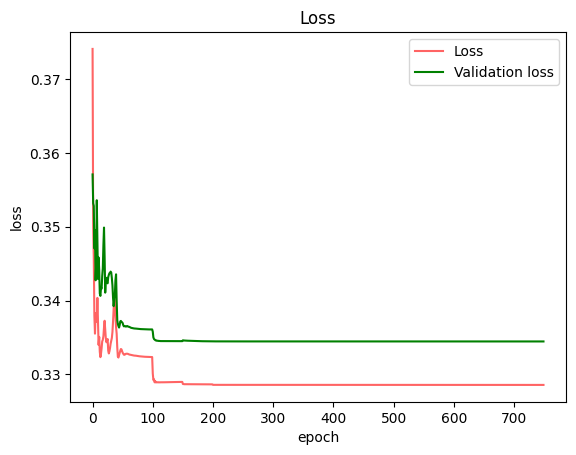

step 1, accuracy_train:0.66875, loss: 0.37968650556509337
step 2, accuracy_train:0.76875, loss: 0.36824063588771067
step 3, accuracy_train:0.7625, loss: 0.36383040823847956
step 4, accuracy_train:0.83125, loss: 0.3511150172255261
step 5, accuracy_train:0.875, loss: 0.3431635865157366
step 6, accuracy_train:0.909375, loss: 0.338082922855076
step 7, accuracy_train:0.9125, loss: 0.33689620412057913
step 8, accuracy_train:0.91875, loss: 0.33700134711623336
step 9, accuracy_train:0.9125, loss: 0.3362348282343338
step 10, accuracy_train:0.9125, loss: 0.3390852623541771
step 11, accuracy_train:0.903125, loss: 0.33999930835969305
step 12, accuracy_train:0.921875, loss: 0.33821142726693193
step 13, accuracy_train:0.925, loss: 0.33605560259108697
step 14, accuracy_train:0.925, loss: 0.33477988308268064
step 15, accuracy_train:0.928125, loss: 0.33461619078159377
step 16, accuracy_train:0.925, loss: 0.33392439810291585
step 17, accuracy_train:0.909375, loss: 0.3339446181753366
step 18, accuracy_tr

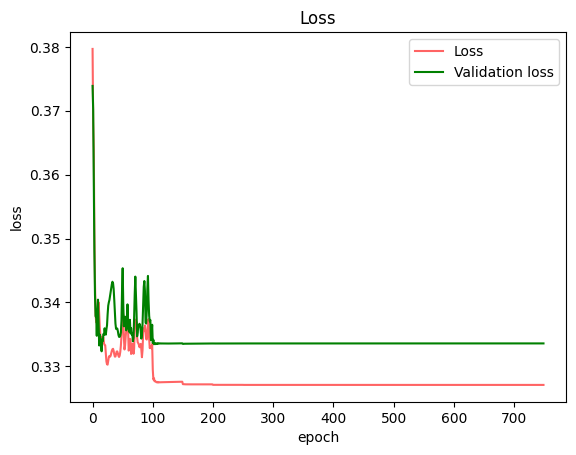

step 1, accuracy_train:0.6625, loss: 0.3775815108513593
step 2, accuracy_train:0.78125, loss: 0.3626605771714332
step 3, accuracy_train:0.821875, loss: 0.3530029318430912
step 4, accuracy_train:0.88125, loss: 0.3416560589378859
step 5, accuracy_train:0.903125, loss: 0.33802657772881084
step 6, accuracy_train:0.9125, loss: 0.33767365865392446
step 7, accuracy_train:0.915625, loss: 0.33788740611825496
step 8, accuracy_train:0.925, loss: 0.3356927335801077
step 9, accuracy_train:0.925, loss: 0.3348825341173829
step 10, accuracy_train:0.91875, loss: 0.33324151078296627
step 11, accuracy_train:0.93125, loss: 0.333035018628919
step 12, accuracy_train:0.928125, loss: 0.3329961278451635
step 13, accuracy_train:0.928125, loss: 0.3330607259732194
step 14, accuracy_train:0.921875, loss: 0.33288341943413624
step 15, accuracy_train:0.928125, loss: 0.332099195913275
step 16, accuracy_train:0.93125, loss: 0.3313906693461073
step 17, accuracy_train:0.928125, loss: 0.33102439833144015
step 18, accuracy

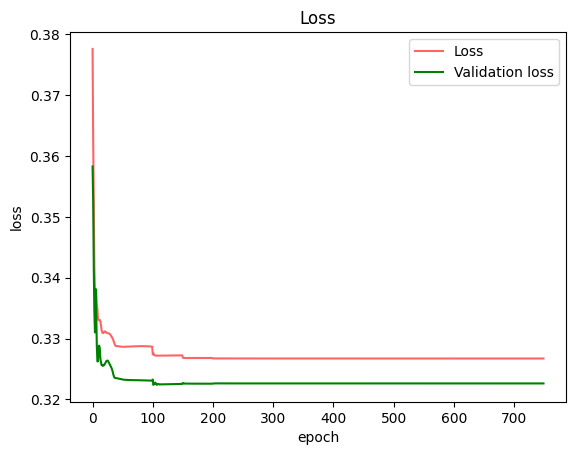

step 1, accuracy_train:0.684375, loss: 0.37545743523445957
step 2, accuracy_train:0.765625, loss: 0.3649281242991209
step 3, accuracy_train:0.79375, loss: 0.3610337919823319
step 4, accuracy_train:0.8, loss: 0.35939102980046467
step 5, accuracy_train:0.875, loss: 0.35182174279899636
step 6, accuracy_train:0.846875, loss: 0.35197316641254145
step 7, accuracy_train:0.89375, loss: 0.34772574318447863
step 8, accuracy_train:0.871875, loss: 0.3471956864482042
step 9, accuracy_train:0.853125, loss: 0.3494830781320082
step 10, accuracy_train:0.846875, loss: 0.3520761868588279
step 11, accuracy_train:0.86875, loss: 0.343982925012841
step 12, accuracy_train:0.934375, loss: 0.33585433340586296
step 13, accuracy_train:0.921875, loss: 0.33509244066475624
step 14, accuracy_train:0.9125, loss: 0.33629426202119217
step 15, accuracy_train:0.90625, loss: 0.339283101631241
step 16, accuracy_train:0.9, loss: 0.3411949768265144
step 17, accuracy_train:0.88125, loss: 0.3427637643413696
step 18, accuracy_tr

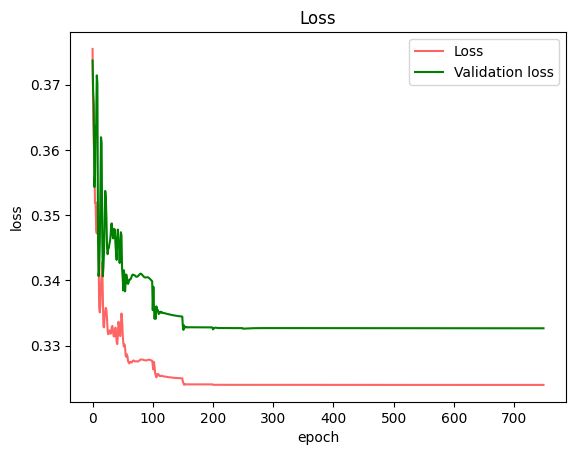

cv_time ：50.692290 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 50, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.71875, loss: 0.3737967156329122
step 2, accuracy_train:0.778125, loss: 0.3632180631561197
step 3, accuracy_train:0.825, loss: 0.3579097515775967
step 4, accuracy_train:0.846875, loss: 0.35138010058120717
step 5, accuracy_train:0.8625, loss: 0.3497754670372558
step 6, accuracy_train:0.884375, loss: 0.3434099172997136
step 7, accuracy_train:0.896875, loss: 0.3401959135363933
step 8, accuracy_train:0.896875, loss: 0.3379954364581187
step 9, accuracy_train:0.915625, loss: 0.3364612356466774
step 10, accuracy_train:0.934375, loss: 0.33550213307514454
step 11, accuracy_train:0.91875, loss: 0.33416660230391937
step 12, accuracy_train:0.934375, loss: 0.3338389601797236
step 13, accuracy_train:0.925, loss: 0.3339323794575232
step 14, accuracy_train:0.93125, loss: 0.3336363026258715
step 15, accuracy_train:0.915625, loss: 0.33567298900737796
step 16, accuracy_train:0.921875, loss: 

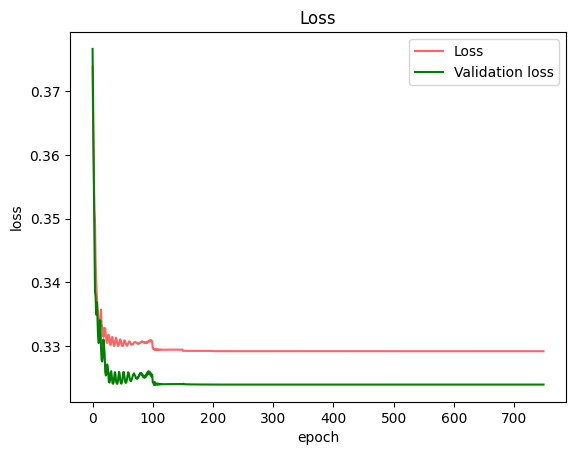

step 1, accuracy_train:0.65, loss: 0.385251593242273
step 2, accuracy_train:0.69375, loss: 0.37740240940241127
step 3, accuracy_train:0.74375, loss: 0.3683076779168572
step 4, accuracy_train:0.878125, loss: 0.3493525607589548
step 5, accuracy_train:0.890625, loss: 0.3449274606532059
step 6, accuracy_train:0.871875, loss: 0.34583998933505855
step 7, accuracy_train:0.8875, loss: 0.3405247736037923
step 8, accuracy_train:0.90625, loss: 0.3391110247351631
step 9, accuracy_train:0.909375, loss: 0.33831604491610306
step 10, accuracy_train:0.915625, loss: 0.33674086098066375
step 11, accuracy_train:0.90625, loss: 0.3347582808870016
step 12, accuracy_train:0.928125, loss: 0.3339222068976223
step 13, accuracy_train:0.9125, loss: 0.3340181900465572
step 14, accuracy_train:0.915625, loss: 0.3330822580558944
step 15, accuracy_train:0.915625, loss: 0.332480638043135
step 16, accuracy_train:0.915625, loss: 0.33200162374759534
step 17, accuracy_train:0.921875, loss: 0.33171714733022817
step 18, accur

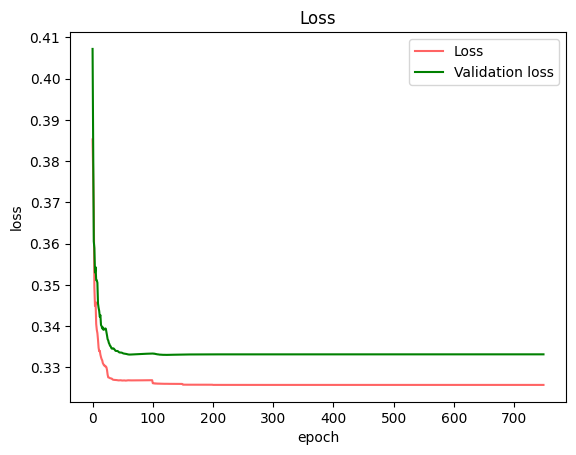

step 1, accuracy_train:0.63125, loss: 0.3823817683860058
step 2, accuracy_train:0.79375, loss: 0.3636709053076654
step 3, accuracy_train:0.871875, loss: 0.344946295634704
step 4, accuracy_train:0.828125, loss: 0.3468315587757854
step 5, accuracy_train:0.88125, loss: 0.3441306983267717
step 6, accuracy_train:0.903125, loss: 0.34011858621316116
step 7, accuracy_train:0.903125, loss: 0.33849134637079703
step 8, accuracy_train:0.896875, loss: 0.33878795819505686
step 9, accuracy_train:0.89375, loss: 0.33708824949984556
step 10, accuracy_train:0.9125, loss: 0.335711541176614
step 11, accuracy_train:0.915625, loss: 0.33372933594103904
step 12, accuracy_train:0.921875, loss: 0.3325886217896341
step 13, accuracy_train:0.9125, loss: 0.33164161861811875
step 14, accuracy_train:0.925, loss: 0.33197440423775126
step 15, accuracy_train:0.915625, loss: 0.3324518059508672
step 16, accuracy_train:0.921875, loss: 0.3315777203363688
step 17, accuracy_train:0.934375, loss: 0.3303677075690721
step 18, acc

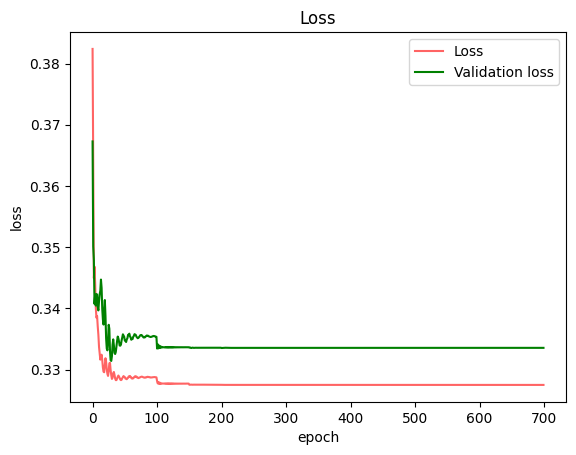

step 1, accuracy_train:0.634375, loss: 0.38428694622077897
step 2, accuracy_train:0.85625, loss: 0.35674231636631665
step 3, accuracy_train:0.865625, loss: 0.34700254010019077
step 4, accuracy_train:0.834375, loss: 0.350447424190661
step 5, accuracy_train:0.828125, loss: 0.3540335387134643
step 6, accuracy_train:0.903125, loss: 0.3446910366316393
step 7, accuracy_train:0.859375, loss: 0.3495570739450134
step 8, accuracy_train:0.878125, loss: 0.3466825463817782
step 9, accuracy_train:0.909375, loss: 0.34041418444463967
step 10, accuracy_train:0.8875, loss: 0.3422988272836688
step 11, accuracy_train:0.90625, loss: 0.33945812413305865
step 12, accuracy_train:0.896875, loss: 0.33979473011914285
step 13, accuracy_train:0.90625, loss: 0.3366351725151759
step 14, accuracy_train:0.909375, loss: 0.3353410651986401
step 15, accuracy_train:0.909375, loss: 0.33501857884824043
step 16, accuracy_train:0.9125, loss: 0.3364754901141036
step 17, accuracy_train:0.909375, loss: 0.3351835076910982
step 18

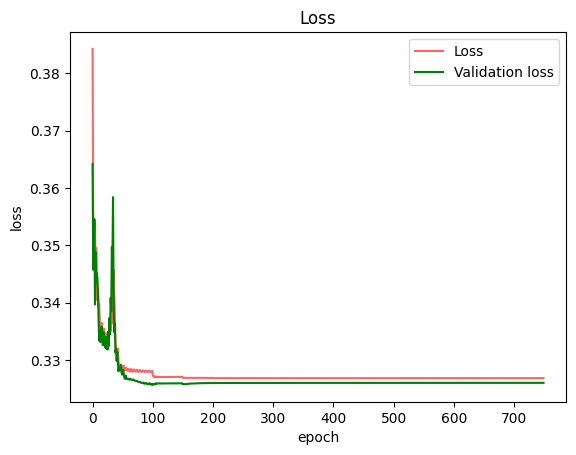

step 1, accuracy_train:0.621875, loss: 0.3877025427539128
step 2, accuracy_train:0.66875, loss: 0.3757895907828852
step 3, accuracy_train:0.81875, loss: 0.35629122299385274
step 4, accuracy_train:0.85, loss: 0.35302693843673827
step 5, accuracy_train:0.871875, loss: 0.3438696525831739
step 6, accuracy_train:0.86875, loss: 0.343595440170925
step 7, accuracy_train:0.884375, loss: 0.34149741482296114
step 8, accuracy_train:0.88125, loss: 0.34185264605999677
step 9, accuracy_train:0.909375, loss: 0.3378756407865053
step 10, accuracy_train:0.90625, loss: 0.33672310526759597
step 11, accuracy_train:0.89375, loss: 0.33859076030743734
step 12, accuracy_train:0.89375, loss: 0.3395588263586698
step 13, accuracy_train:0.896875, loss: 0.3361578136774023
step 14, accuracy_train:0.909375, loss: 0.33511491536562216
step 15, accuracy_train:0.903125, loss: 0.3361801651138771
step 16, accuracy_train:0.896875, loss: 0.3398285866987722
step 17, accuracy_train:0.890625, loss: 0.3372384963416659
step 18, ac

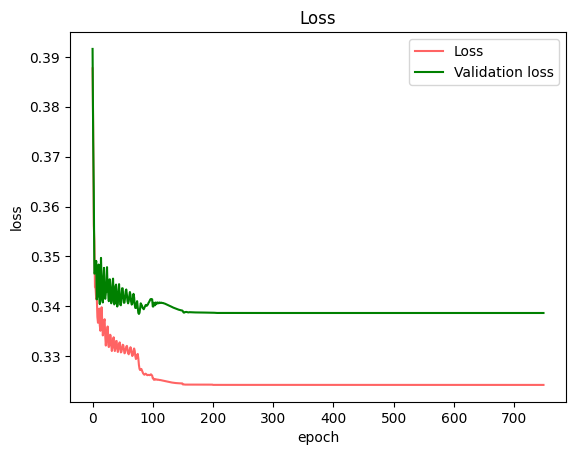

cv_time ：30.343701 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 100, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.621875, loss: 0.3817834565933226
step 2, accuracy_train:0.759375, loss: 0.3832337855973701
step 3, accuracy_train:0.71875, loss: 0.3671176744327015
step 4, accuracy_train:0.75, loss: 0.36406025398323183
step 5, accuracy_train:0.825, loss: 0.3517819879253926
step 6, accuracy_train:0.771875, loss: 0.353083828014909
step 7, accuracy_train:0.8625, loss: 0.3437803785164846
step 8, accuracy_train:0.84375, loss: 0.341335441104787
step 9, accuracy_train:0.840625, loss: 0.34041066128097236
step 10, accuracy_train:0.85625, loss: 0.3397027362307974
step 11, accuracy_train:0.884375, loss: 0.3361763261947498
step 12, accuracy_train:0.865625, loss: 0.3371165691623287
step 13, accuracy_train:0.89375, loss: 0.3368166900522632
step 14, accuracy_train:0.9, loss: 0.33358989191611665
step 15, accuracy_train:0.8875, loss: 0.3334268154795233
step 16, accuracy_train:0.890625, loss: 0.333685227

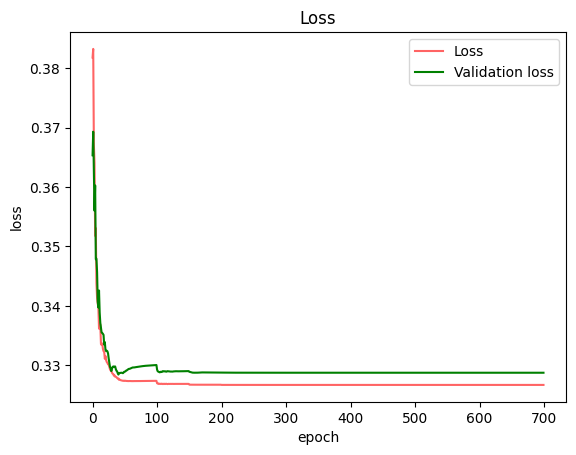

step 1, accuracy_train:0.615625, loss: 0.38128752031265456
step 2, accuracy_train:0.7875, loss: 0.37918232667713436
step 3, accuracy_train:0.721875, loss: 0.3672883571945149
step 4, accuracy_train:0.746875, loss: 0.365013220355672
step 5, accuracy_train:0.8375, loss: 0.3490028416522172
step 6, accuracy_train:0.765625, loss: 0.35219540617120215
step 7, accuracy_train:0.86875, loss: 0.3432691747927985
step 8, accuracy_train:0.85625, loss: 0.34157287622254573
step 9, accuracy_train:0.865625, loss: 0.3378397887181324
step 10, accuracy_train:0.878125, loss: 0.33745575419739904
step 11, accuracy_train:0.875, loss: 0.33518472874204636
step 12, accuracy_train:0.853125, loss: 0.3358099835912145
step 13, accuracy_train:0.9, loss: 0.33529356734829585
step 14, accuracy_train:0.915625, loss: 0.33165380135907474
step 15, accuracy_train:0.890625, loss: 0.33213093870652577
step 16, accuracy_train:0.896875, loss: 0.3321289743872411
step 17, accuracy_train:0.896875, loss: 0.3309196236553842
step 18, acc

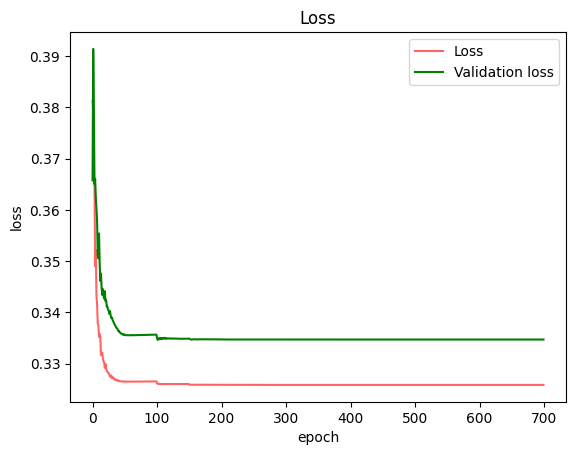

step 1, accuracy_train:0.590625, loss: 0.38252320553371755
step 2, accuracy_train:0.765625, loss: 0.3821560991631343
step 3, accuracy_train:0.75, loss: 0.36553483461761616
step 4, accuracy_train:0.75625, loss: 0.3638602534060778
step 5, accuracy_train:0.83125, loss: 0.34886251563495674
step 6, accuracy_train:0.778125, loss: 0.3521119303692542
step 7, accuracy_train:0.84375, loss: 0.34423830864165517
step 8, accuracy_train:0.85625, loss: 0.34000002015591707
step 9, accuracy_train:0.85625, loss: 0.33908247252032364
step 10, accuracy_train:0.871875, loss: 0.3392480466633984
step 11, accuracy_train:0.88125, loss: 0.336628442430873
step 12, accuracy_train:0.85625, loss: 0.3354202562332789
step 13, accuracy_train:0.890625, loss: 0.33516162501681523
step 14, accuracy_train:0.884375, loss: 0.3323436448201472
step 15, accuracy_train:0.89375, loss: 0.33270627253650864
step 16, accuracy_train:0.890625, loss: 0.33249205329734527
step 17, accuracy_train:0.89375, loss: 0.3320830823666026
step 18, ac

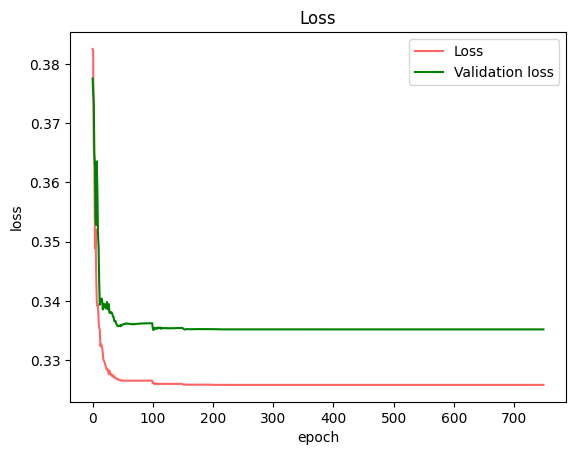

step 1, accuracy_train:0.6, loss: 0.382038157089194
step 2, accuracy_train:0.765625, loss: 0.3820722797263692
step 3, accuracy_train:0.71875, loss: 0.37166669143994197
step 4, accuracy_train:0.76875, loss: 0.36735970222638736
step 5, accuracy_train:0.803125, loss: 0.3507102311825204
step 6, accuracy_train:0.765625, loss: 0.3561818574876463
step 7, accuracy_train:0.8375, loss: 0.3441161988499599
step 8, accuracy_train:0.834375, loss: 0.34608128400688765
step 9, accuracy_train:0.8375, loss: 0.34183138578356226
step 10, accuracy_train:0.825, loss: 0.3387425660767366
step 11, accuracy_train:0.85625, loss: 0.33871452411059416
step 12, accuracy_train:0.875, loss: 0.3347716938360919
step 13, accuracy_train:0.865625, loss: 0.33642921154784294
step 14, accuracy_train:0.896875, loss: 0.33515907112728094
step 15, accuracy_train:0.9, loss: 0.3319631923651083
step 16, accuracy_train:0.875, loss: 0.33245859652351484
step 17, accuracy_train:0.878125, loss: 0.33277937223863635
step 18, accuracy_train:

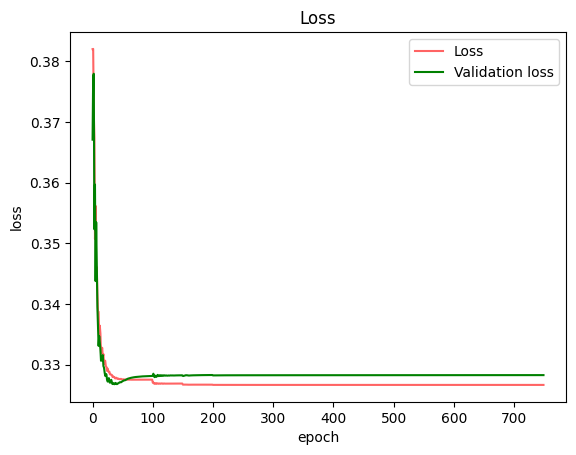

step 1, accuracy_train:0.6125, loss: 0.3843288308626642
step 2, accuracy_train:0.8, loss: 0.37215194392007184
step 3, accuracy_train:0.746875, loss: 0.3551684987415934
step 4, accuracy_train:0.840625, loss: 0.35151268916259704
step 5, accuracy_train:0.828125, loss: 0.34764104936499896
step 6, accuracy_train:0.871875, loss: 0.33729083627902245
step 7, accuracy_train:0.88125, loss: 0.3361024231534455
step 8, accuracy_train:0.88125, loss: 0.3355583877830127
step 9, accuracy_train:0.89375, loss: 0.33058105011510674
step 10, accuracy_train:0.878125, loss: 0.3327770334740283
step 11, accuracy_train:0.89375, loss: 0.3313812222085306
step 12, accuracy_train:0.88125, loss: 0.33073048165785723
step 13, accuracy_train:0.9, loss: 0.3308299340399574
step 14, accuracy_train:0.9, loss: 0.32896373153563774
step 15, accuracy_train:0.89375, loss: 0.3293142050479907
step 16, accuracy_train:0.909375, loss: 0.3275195277800801
step 17, accuracy_train:0.90625, loss: 0.3274541209350421
step 18, accuracy_train

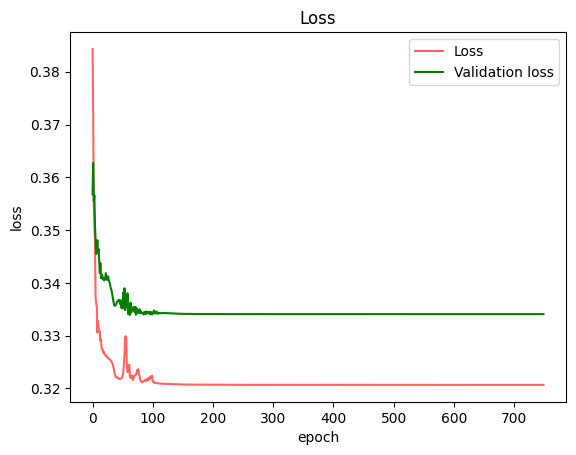

cv_time ：16.956763 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 300, 50, [0.05, 0.03, 0.01]]


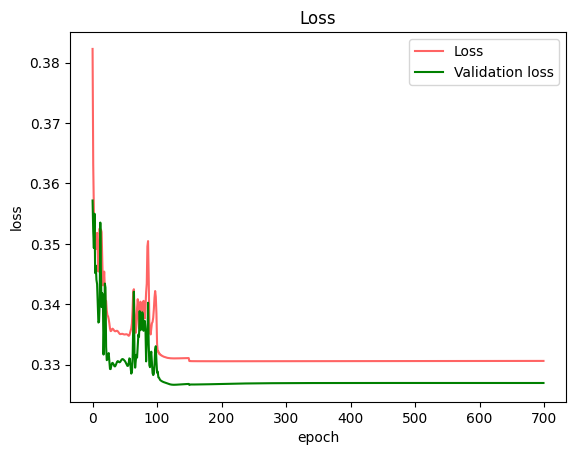

circuit is jitted
circuit is jitted
circuit is jitted
circuit is jitted
step 1, accuracy_train:0.646875, loss: 0.23620315993873192
circuit is jitted
circuit is jitted
step 2, accuracy_train:0.83125, loss: 0.15377639879467378
step 3, accuracy_train:0.859375, loss: 0.1152904098832381
step 4, accuracy_train:0.86875, loss: 0.11011143976995426
step 5, accuracy_train:0.88125, loss: 0.10037920327534647
step 6, accuracy_train:0.884375, loss: 0.10948209400710868
step 7, accuracy_train:0.8875, loss: 0.10790968528962286
step 8, accuracy_train:0.909375, loss: 0.08152816383275092
step 9, accuracy_train:0.91875, loss: 0.0777015721706098
step 10, accuracy_train:0.91875, loss: 0.07912400755448067
step 11, accuracy_train:0.915625, loss: 0.07850676383835702
step 12, accuracy_train:0.91875, loss: 0.07869663219763437
step 13, accuracy_train:0.921875, loss: 0.07780727814058618
step 14, accuracy_train:0.90625, loss: 0.084317130595274
step 15, accuracy_train:0.896875, loss: 0.0910271640511561
step 16, accura

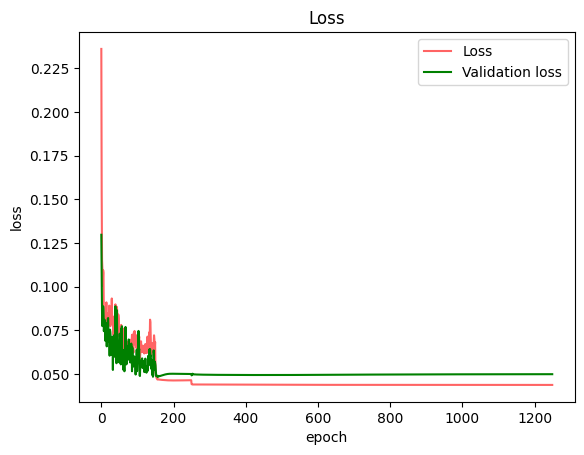

step 1, accuracy_train:0.621875, loss: 0.24923193126518567
step 2, accuracy_train:0.7125, loss: 0.21078380320961446
step 3, accuracy_train:0.840625, loss: 0.144018943591785
step 4, accuracy_train:0.865625, loss: 0.12809883783770892
step 5, accuracy_train:0.86875, loss: 0.12591188183305355
step 6, accuracy_train:0.896875, loss: 0.10986032985479081
step 7, accuracy_train:0.89375, loss: 0.09634270377165102
step 8, accuracy_train:0.89375, loss: 0.099831535800219
step 9, accuracy_train:0.921875, loss: 0.08623679847888192
step 10, accuracy_train:0.909375, loss: 0.08038534070343827
step 11, accuracy_train:0.9, loss: 0.08483264917859525
step 12, accuracy_train:0.91875, loss: 0.08048308853387352
step 13, accuracy_train:0.921875, loss: 0.07432040216327873
step 14, accuracy_train:0.928125, loss: 0.07365436019461517
step 15, accuracy_train:0.921875, loss: 0.06069174360669114
step 16, accuracy_train:0.934375, loss: 0.06450308380085817
step 17, accuracy_train:0.93125, loss: 0.0647637226972224
step 1

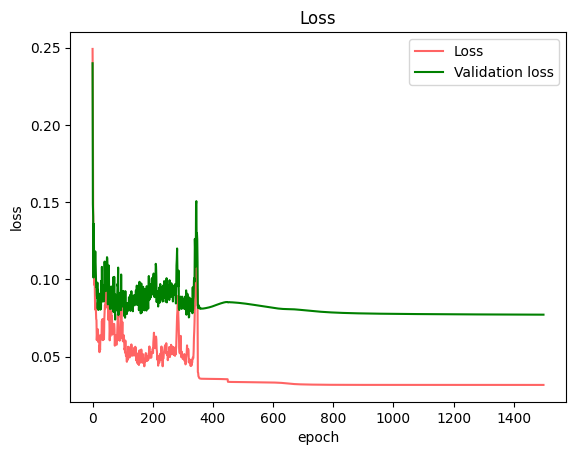

step 1, accuracy_train:0.59375, loss: 0.26216467324270987
step 2, accuracy_train:0.690625, loss: 0.23082414675482588
step 3, accuracy_train:0.75625, loss: 0.17727634343741094
step 4, accuracy_train:0.7875, loss: 0.16591076406390945
step 5, accuracy_train:0.76875, loss: 0.16252451239821442
step 6, accuracy_train:0.828125, loss: 0.1421999061535586
step 7, accuracy_train:0.884375, loss: 0.10954847163094636
step 8, accuracy_train:0.86875, loss: 0.1036797765852543
step 9, accuracy_train:0.89375, loss: 0.08804839295486394
step 10, accuracy_train:0.8875, loss: 0.09162497775189671
step 11, accuracy_train:0.878125, loss: 0.1069132850524473
step 12, accuracy_train:0.884375, loss: 0.096538371229227
step 13, accuracy_train:0.928125, loss: 0.08730922226893524
step 14, accuracy_train:0.915625, loss: 0.08019479796984968
step 15, accuracy_train:0.890625, loss: 0.09059991950626091
step 16, accuracy_train:0.91875, loss: 0.08261693338769763
step 17, accuracy_train:0.90625, loss: 0.07724876576487427
step 

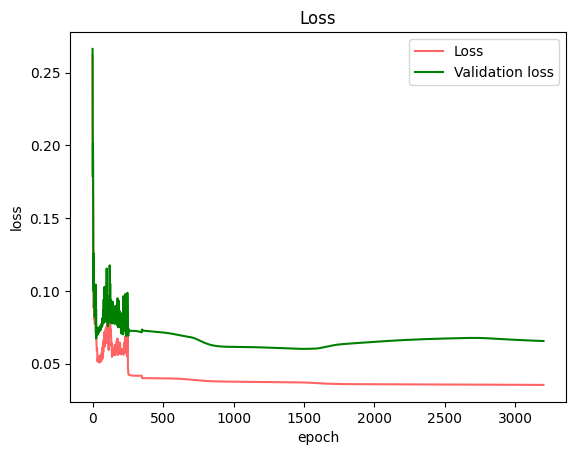

step 1, accuracy_train:0.528125, loss: 0.2721689784797986
step 2, accuracy_train:0.703125, loss: 0.21657484713871952
step 3, accuracy_train:0.76875, loss: 0.17113752723002162
step 4, accuracy_train:0.859375, loss: 0.1303845898243573
step 5, accuracy_train:0.88125, loss: 0.10806978131972418
step 6, accuracy_train:0.878125, loss: 0.10551960023297288
step 7, accuracy_train:0.909375, loss: 0.08659210607392409
step 8, accuracy_train:0.91875, loss: 0.07916841146321947
step 9, accuracy_train:0.925, loss: 0.07938164709372764
step 10, accuracy_train:0.925, loss: 0.07418747246346713
step 11, accuracy_train:0.93125, loss: 0.06458989418211541
step 12, accuracy_train:0.940625, loss: 0.06240917396591926
step 13, accuracy_train:0.9375, loss: 0.059446842158797406
step 14, accuracy_train:0.940625, loss: 0.05401067423234127
step 15, accuracy_train:0.940625, loss: 0.053397540772194975
step 16, accuracy_train:0.934375, loss: 0.05333088756983693
step 17, accuracy_train:0.9375, loss: 0.055897100159981755
st

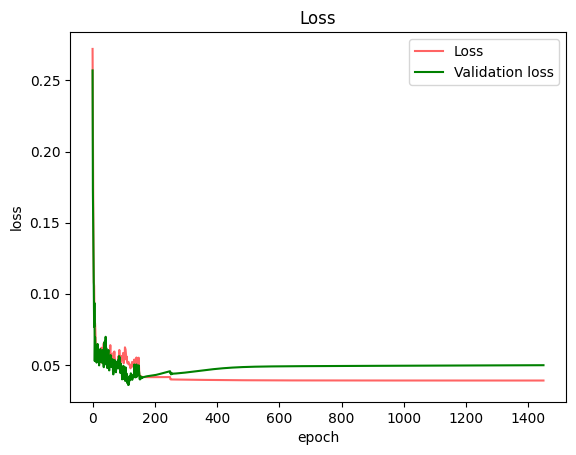

step 1, accuracy_train:0.534375, loss: 0.27373713527002136
step 2, accuracy_train:0.684375, loss: 0.2201648553373853
step 3, accuracy_train:0.746875, loss: 0.18251638446073895
step 4, accuracy_train:0.8125, loss: 0.1508007164924474
step 5, accuracy_train:0.859375, loss: 0.13274400605385947
step 6, accuracy_train:0.846875, loss: 0.12115644678816789
step 7, accuracy_train:0.88125, loss: 0.10777598591080624
step 8, accuracy_train:0.890625, loss: 0.09090649356961757
step 9, accuracy_train:0.89375, loss: 0.08384462938276988
step 10, accuracy_train:0.921875, loss: 0.07392168016435013
step 11, accuracy_train:0.903125, loss: 0.08015910308683442
step 12, accuracy_train:0.921875, loss: 0.07635300577445009
step 13, accuracy_train:0.91875, loss: 0.08712104796958377
step 14, accuracy_train:0.9125, loss: 0.08367914468368802
step 15, accuracy_train:0.925, loss: 0.07854414539241164
step 16, accuracy_train:0.89375, loss: 0.08009243221873584
step 17, accuracy_train:0.91875, loss: 0.08403025484485432
ste

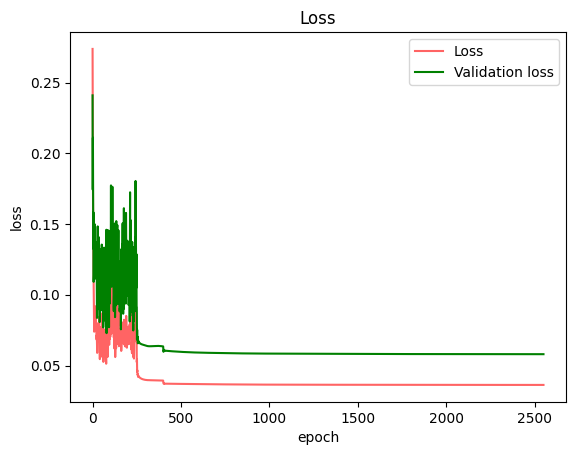

cv_time ：252.889447 s
[[0.15, 0.05, 0.01], 3200, 50, 50, [0.05, 0.03, 0.01]]
circuit is jitted
circuit is jitted
step 1, accuracy_train:0.540625, loss: 0.28032297867727196
step 2, accuracy_train:0.73125, loss: 0.20165141188853397
step 3, accuracy_train:0.809375, loss: 0.19374053321975798
step 4, accuracy_train:0.83125, loss: 0.16576113214517896
step 5, accuracy_train:0.88125, loss: 0.11963968376759829
step 6, accuracy_train:0.890625, loss: 0.09677505618112309
step 7, accuracy_train:0.909375, loss: 0.08775670851396558
step 8, accuracy_train:0.9125, loss: 0.08076648857906811
step 9, accuracy_train:0.921875, loss: 0.06777814125042993
step 10, accuracy_train:0.928125, loss: 0.06344888779210385
step 11, accuracy_train:0.93125, loss: 0.05747872578403203
step 12, accuracy_train:0.934375, loss: 0.057580322460925135
step 13, accuracy_train:0.934375, loss: 0.053533937632742674
step 14, accuracy_train:0.940625, loss: 0.0516969113198619
step 15, accuracy_train:0.9375, loss: 0.04989656156894757
ste

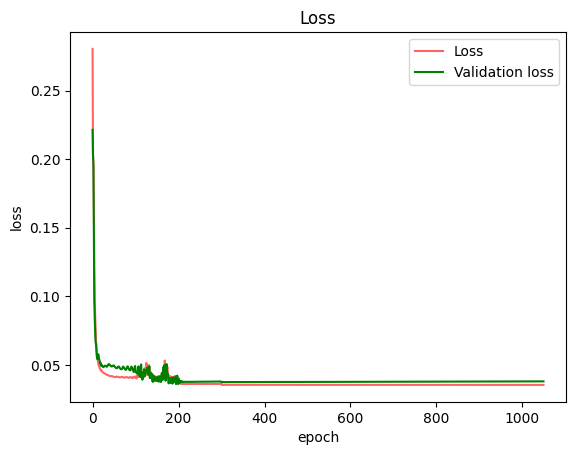

step 1, accuracy_train:0.528125, loss: 0.2773340793371266
step 2, accuracy_train:0.74375, loss: 0.19670665881188837
step 3, accuracy_train:0.828125, loss: 0.17665399176126576
step 4, accuracy_train:0.878125, loss: 0.13422811485886177
step 5, accuracy_train:0.90625, loss: 0.09621425225680318
step 6, accuracy_train:0.925, loss: 0.07596537675314595
step 7, accuracy_train:0.93125, loss: 0.06952729105145675
step 8, accuracy_train:0.9375, loss: 0.06165173852221211
step 9, accuracy_train:0.93125, loss: 0.05337350218454222
step 10, accuracy_train:0.9375, loss: 0.05111158736951932
step 11, accuracy_train:0.93125, loss: 0.045227394359528786
step 12, accuracy_train:0.9375, loss: 0.04526179865511416
step 13, accuracy_train:0.9375, loss: 0.043489088970737264
step 14, accuracy_train:0.940625, loss: 0.042429729860487084
step 15, accuracy_train:0.940625, loss: 0.04245198169488476
step 16, accuracy_train:0.940625, loss: 0.041277730735634496
step 17, accuracy_train:0.94375, loss: 0.04045307644182569
ste

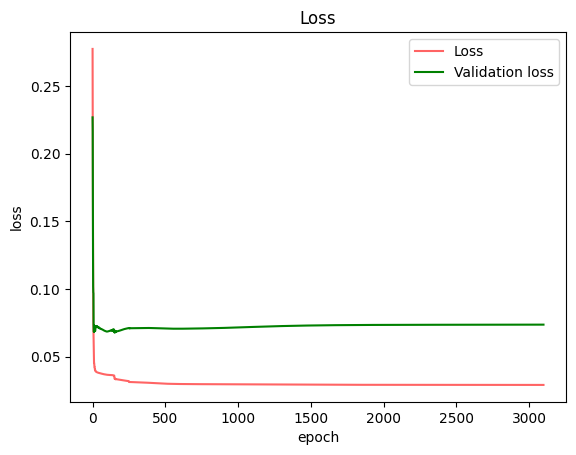

step 1, accuracy_train:0.503125, loss: 0.2905310196035484
step 2, accuracy_train:0.778125, loss: 0.1988037690603337
step 3, accuracy_train:0.80625, loss: 0.1742922993873412
step 4, accuracy_train:0.75, loss: 0.1961457597790684
step 5, accuracy_train:0.809375, loss: 0.15830648043501883
step 6, accuracy_train:0.840625, loss: 0.1370013336960753
step 7, accuracy_train:0.9, loss: 0.09596221298976207
step 8, accuracy_train:0.896875, loss: 0.09664891802909124
step 9, accuracy_train:0.90625, loss: 0.08786075796930126
step 10, accuracy_train:0.915625, loss: 0.07508708823068569
step 11, accuracy_train:0.921875, loss: 0.060611958800230445
step 12, accuracy_train:0.921875, loss: 0.05989833983696841
step 13, accuracy_train:0.921875, loss: 0.0653672102417695
step 14, accuracy_train:0.93125, loss: 0.054902313243658345
step 15, accuracy_train:0.940625, loss: 0.04773386614415639
step 16, accuracy_train:0.946875, loss: 0.04867493318959411
step 17, accuracy_train:0.934375, loss: 0.05064962761901644
step 

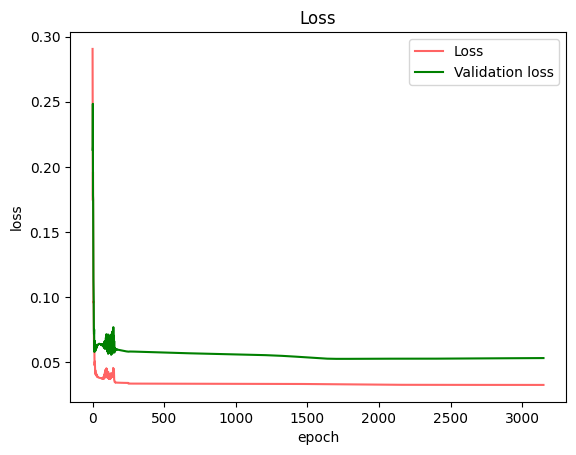

step 1, accuracy_train:0.50625, loss: 0.2871989052239484
step 2, accuracy_train:0.734375, loss: 0.1949508513866815
step 3, accuracy_train:0.73125, loss: 0.1817842618126777
step 4, accuracy_train:0.715625, loss: 0.19487887075261814
step 5, accuracy_train:0.765625, loss: 0.16405004890732292
step 6, accuracy_train:0.8, loss: 0.13204136861105376
step 7, accuracy_train:0.871875, loss: 0.10817915044137669
step 8, accuracy_train:0.890625, loss: 0.0960279374960461
step 9, accuracy_train:0.8875, loss: 0.09057231453710142
step 10, accuracy_train:0.91875, loss: 0.07032579009873868
step 11, accuracy_train:0.90625, loss: 0.06969629042482851
step 12, accuracy_train:0.915625, loss: 0.06231120011611832
step 13, accuracy_train:0.925, loss: 0.06147401475331938
step 14, accuracy_train:0.928125, loss: 0.05443874277497358
step 15, accuracy_train:0.93125, loss: 0.053940149283130845
step 16, accuracy_train:0.934375, loss: 0.05160458038640561
step 17, accuracy_train:0.94375, loss: 0.050288126391301
step 18, a

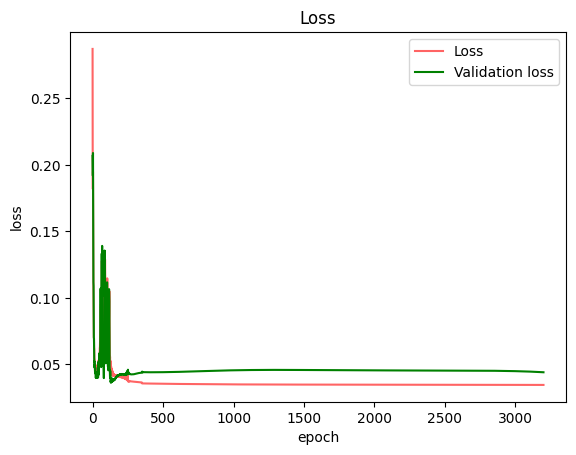

step 1, accuracy_train:0.521875, loss: 0.28444323265440397
step 2, accuracy_train:0.709375, loss: 0.2070217214690089
step 3, accuracy_train:0.759375, loss: 0.17659046579419152
step 4, accuracy_train:0.8, loss: 0.17754588027584173
step 5, accuracy_train:0.846875, loss: 0.12908589497914869
step 6, accuracy_train:0.884375, loss: 0.12253739554903018
step 7, accuracy_train:0.903125, loss: 0.08862146909121693
step 8, accuracy_train:0.909375, loss: 0.08142143749261996
step 9, accuracy_train:0.915625, loss: 0.0809864679546719
step 10, accuracy_train:0.9125, loss: 0.08059405115013267
step 11, accuracy_train:0.915625, loss: 0.06664735661764726
step 12, accuracy_train:0.928125, loss: 0.05771936330804603
step 13, accuracy_train:0.91875, loss: 0.05916813369264848
step 14, accuracy_train:0.915625, loss: 0.05832670932972746
step 15, accuracy_train:0.934375, loss: 0.0504458690490193
step 16, accuracy_train:0.93125, loss: 0.05314973070329131
step 17, accuracy_train:0.93125, loss: 0.05167973275250023
st

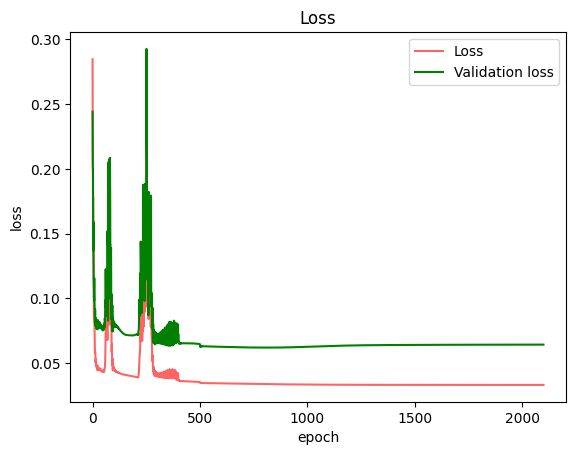

cv_time ：238.127830 s
[[0.15, 0.05, 0.01], 3200, 100, 50, [0.05, 0.03, 0.01]]
circuit is jitted
circuit is jitted
step 1, accuracy_train:0.271875, loss: 0.3364421628646119
step 2, accuracy_train:0.684375, loss: 0.20819579251557907
step 3, accuracy_train:0.75625, loss: 0.15682014908966824
step 4, accuracy_train:0.78125, loss: 0.15135402939498324
step 5, accuracy_train:0.796875, loss: 0.13879768976121198
step 6, accuracy_train:0.825, loss: 0.1339735689046896
step 7, accuracy_train:0.853125, loss: 0.12546883480315624
step 8, accuracy_train:0.865625, loss: 0.11326787461490956
step 9, accuracy_train:0.8625, loss: 0.10046587509511609
step 10, accuracy_train:0.875, loss: 0.08999840157012488
step 11, accuracy_train:0.890625, loss: 0.07587081948601761
step 12, accuracy_train:0.915625, loss: 0.0683746059909387
step 13, accuracy_train:0.915625, loss: 0.06542926660807523
step 14, accuracy_train:0.9125, loss: 0.05877839318266211
step 15, accuracy_train:0.909375, loss: 0.05463602126711139
step 16, a

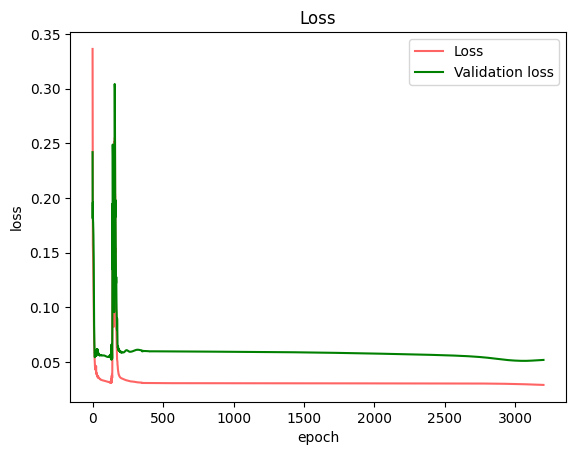

step 1, accuracy_train:0.265625, loss: 0.3299651487386513
step 2, accuracy_train:0.540625, loss: 0.2314685386076501
step 3, accuracy_train:0.7375, loss: 0.17631169084159443
step 4, accuracy_train:0.7, loss: 0.1812049832163184
step 5, accuracy_train:0.759375, loss: 0.1632904845511101
step 6, accuracy_train:0.834375, loss: 0.1530888483806376
step 7, accuracy_train:0.834375, loss: 0.13500052489928688
step 8, accuracy_train:0.865625, loss: 0.11242352111134829
step 9, accuracy_train:0.884375, loss: 0.10114013545843831
step 10, accuracy_train:0.878125, loss: 0.10072229655201644
step 11, accuracy_train:0.86875, loss: 0.09848567181325829
step 12, accuracy_train:0.878125, loss: 0.08529460036762496
step 13, accuracy_train:0.871875, loss: 0.07526940882834007
step 14, accuracy_train:0.884375, loss: 0.07016506128556889
step 15, accuracy_train:0.890625, loss: 0.0639896957824991
step 16, accuracy_train:0.890625, loss: 0.05967682936183134
step 17, accuracy_train:0.89375, loss: 0.05536779589752478
step

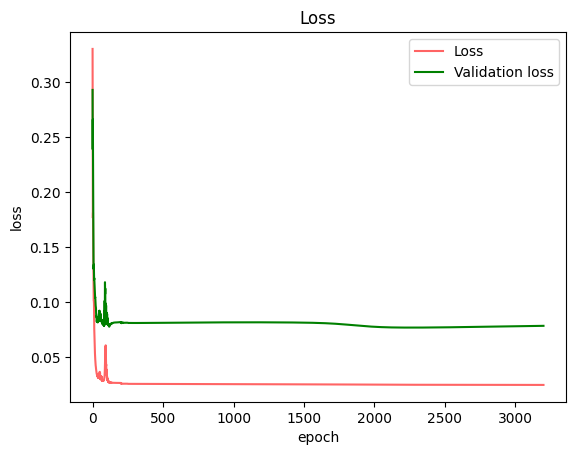

step 1, accuracy_train:0.278125, loss: 0.34090553429324577
step 2, accuracy_train:0.64375, loss: 0.2174076652790175
step 3, accuracy_train:0.765625, loss: 0.1666072454612828
step 4, accuracy_train:0.840625, loss: 0.14520038915152472
step 5, accuracy_train:0.85, loss: 0.14600112470110332
step 6, accuracy_train:0.79375, loss: 0.14225299194210939
step 7, accuracy_train:0.85, loss: 0.12250568095111464
step 8, accuracy_train:0.871875, loss: 0.09360557376507411
step 9, accuracy_train:0.8875, loss: 0.08947962972006507
step 10, accuracy_train:0.896875, loss: 0.07061387829486654
step 11, accuracy_train:0.86875, loss: 0.07774265656251654
step 12, accuracy_train:0.878125, loss: 0.06504919598038345
step 13, accuracy_train:0.896875, loss: 0.06415804276594338
step 14, accuracy_train:0.90625, loss: 0.05255345320151674
step 15, accuracy_train:0.89375, loss: 0.056363194756466825
step 16, accuracy_train:0.91875, loss: 0.04937976328352424
step 17, accuracy_train:0.9125, loss: 0.04827006150278357
step 18,

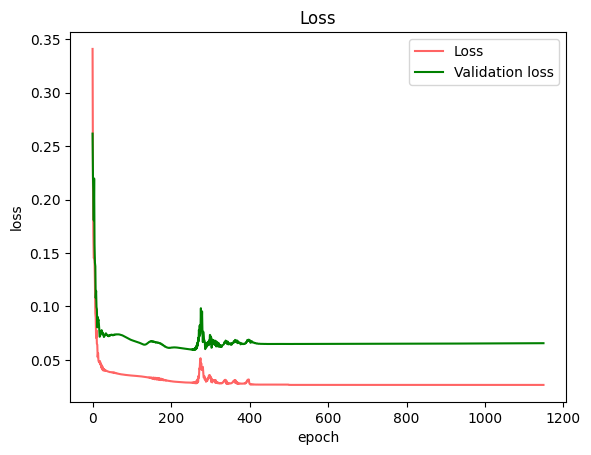

step 1, accuracy_train:0.278125, loss: 0.33992072458729516
step 2, accuracy_train:0.6125, loss: 0.2189744806273744
step 3, accuracy_train:0.74375, loss: 0.18070303176549476
step 4, accuracy_train:0.75625, loss: 0.15831411805855966
step 5, accuracy_train:0.790625, loss: 0.16236314147700692
step 6, accuracy_train:0.8, loss: 0.1469942134162999
step 7, accuracy_train:0.821875, loss: 0.1171336985095853
step 8, accuracy_train:0.878125, loss: 0.09367730770503613
step 9, accuracy_train:0.890625, loss: 0.08751994696143396
step 10, accuracy_train:0.86875, loss: 0.08675268706267213
step 11, accuracy_train:0.890625, loss: 0.07148227659751602
step 12, accuracy_train:0.909375, loss: 0.06653974032965868
step 13, accuracy_train:0.928125, loss: 0.06135332601830626
step 14, accuracy_train:0.909375, loss: 0.05835283087486855
step 15, accuracy_train:0.91875, loss: 0.05251748702917234
step 16, accuracy_train:0.925, loss: 0.053901873815214205
step 17, accuracy_train:0.91875, loss: 0.05079643854120916
step 1

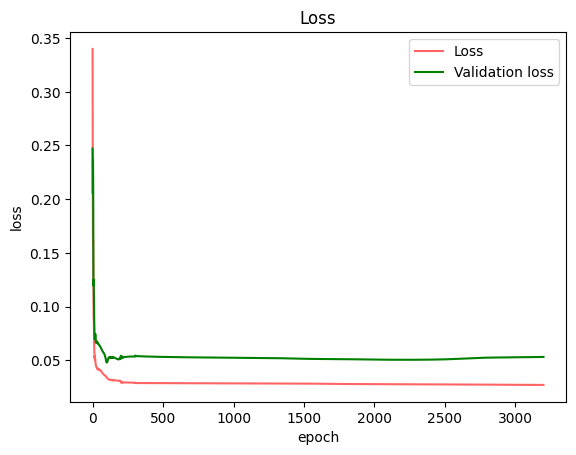

step 1, accuracy_train:0.271875, loss: 0.33804139147789014
step 2, accuracy_train:0.471875, loss: 0.27033796432358037
step 3, accuracy_train:0.759375, loss: 0.20370792609747557
step 4, accuracy_train:0.76875, loss: 0.1837478731956998
step 5, accuracy_train:0.78125, loss: 0.1612611360548875
step 6, accuracy_train:0.828125, loss: 0.13675784214105774
step 7, accuracy_train:0.89375, loss: 0.10378629069539691
step 8, accuracy_train:0.878125, loss: 0.09372006294965499
step 9, accuracy_train:0.871875, loss: 0.09169510404607421
step 10, accuracy_train:0.89375, loss: 0.07413300576546467
step 11, accuracy_train:0.896875, loss: 0.06220751076743626
step 12, accuracy_train:0.909375, loss: 0.05770045018409741
step 13, accuracy_train:0.896875, loss: 0.05384050151923858
step 14, accuracy_train:0.903125, loss: 0.05248884481722975
step 15, accuracy_train:0.915625, loss: 0.04796012486961701
step 16, accuracy_train:0.91875, loss: 0.047565827481791834
step 17, accuracy_train:0.9125, loss: 0.043414275675029

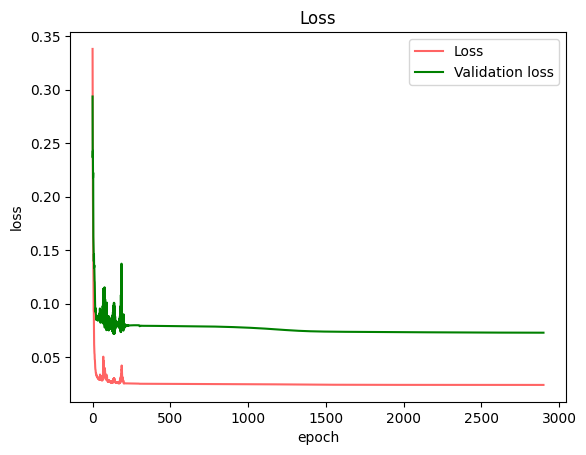

cv_time ：202.503742 s
[[0.15, 0.05, 0.01], 3200, 300, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.646875, loss: 0.23620315993873192
step 2, accuracy_train:0.83125, loss: 0.15377639879467378
step 3, accuracy_train:0.859375, loss: 0.1152904098832381
step 4, accuracy_train:0.86875, loss: 0.11011143976995426
step 5, accuracy_train:0.88125, loss: 0.10037920327534647
step 6, accuracy_train:0.884375, loss: 0.10948209400710868
step 7, accuracy_train:0.8875, loss: 0.10790968528962286
step 8, accuracy_train:0.909375, loss: 0.08152816383275092
step 9, accuracy_train:0.91875, loss: 0.0777015721706098
step 10, accuracy_train:0.91875, loss: 0.07912400755448067
step 11, accuracy_train:0.915625, loss: 0.07850676383835702
step 12, accuracy_train:0.91875, loss: 0.07869663219763437
step 13, accuracy_train:0.921875, loss: 0.07780727814058618
step 14, accuracy_train:0.90625, loss: 0.084317130595274
step 15, accuracy_train:0.896875, loss: 0.0910271640511561
step 16, accuracy_train:0.91875, loss: 0.0804

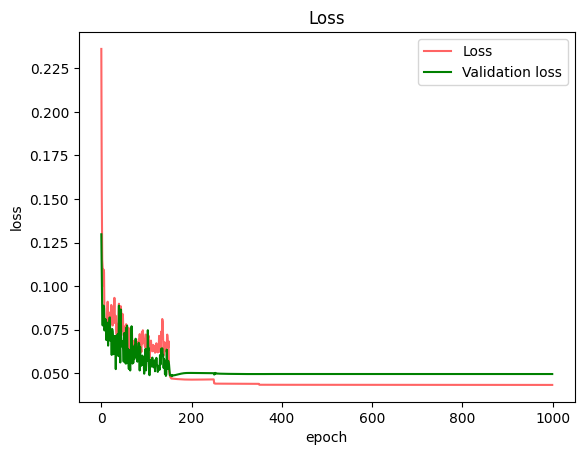

step 1, accuracy_train:0.621875, loss: 0.24923193126518567
step 2, accuracy_train:0.7125, loss: 0.21078380320961446
step 3, accuracy_train:0.840625, loss: 0.144018943591785
step 4, accuracy_train:0.865625, loss: 0.12809883783770892
step 5, accuracy_train:0.86875, loss: 0.12591188183305355
step 6, accuracy_train:0.896875, loss: 0.10986032985479081
step 7, accuracy_train:0.89375, loss: 0.09634270377165102
step 8, accuracy_train:0.89375, loss: 0.099831535800219
step 9, accuracy_train:0.921875, loss: 0.08623679847888192
step 10, accuracy_train:0.909375, loss: 0.08038534070343827
step 11, accuracy_train:0.9, loss: 0.08483264917859525
step 12, accuracy_train:0.91875, loss: 0.08048308853387352
step 13, accuracy_train:0.921875, loss: 0.07432040216327873
step 14, accuracy_train:0.928125, loss: 0.07365436019461517
step 15, accuracy_train:0.921875, loss: 0.06069174360669114
step 16, accuracy_train:0.934375, loss: 0.06450308380085817
step 17, accuracy_train:0.93125, loss: 0.0647637226972224
step 1

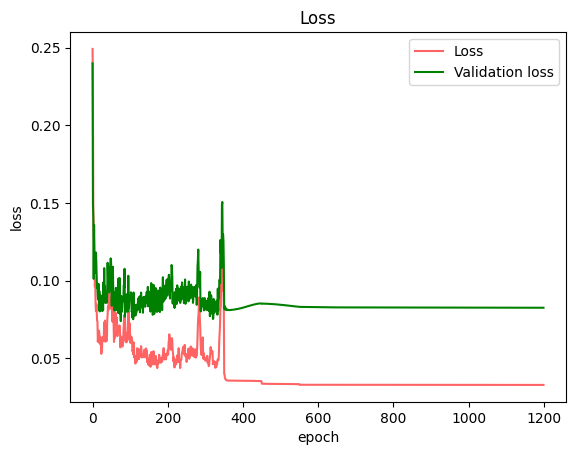

step 1, accuracy_train:0.59375, loss: 0.26216467324270987
step 2, accuracy_train:0.690625, loss: 0.23082414675482588
step 3, accuracy_train:0.75625, loss: 0.17727634343741094
step 4, accuracy_train:0.7875, loss: 0.16591076406390945
step 5, accuracy_train:0.76875, loss: 0.16252451239821442
step 6, accuracy_train:0.828125, loss: 0.1421999061535586
step 7, accuracy_train:0.884375, loss: 0.10954847163094636
step 8, accuracy_train:0.86875, loss: 0.1036797765852543
step 9, accuracy_train:0.89375, loss: 0.08804839295486394
step 10, accuracy_train:0.8875, loss: 0.09162497775189671
step 11, accuracy_train:0.878125, loss: 0.1069132850524473
step 12, accuracy_train:0.884375, loss: 0.096538371229227
step 13, accuracy_train:0.928125, loss: 0.08730922226893524
step 14, accuracy_train:0.915625, loss: 0.08019479796984968
step 15, accuracy_train:0.890625, loss: 0.09059991950626091
step 16, accuracy_train:0.91875, loss: 0.08261693338769763
step 17, accuracy_train:0.90625, loss: 0.07724876576487427
step 

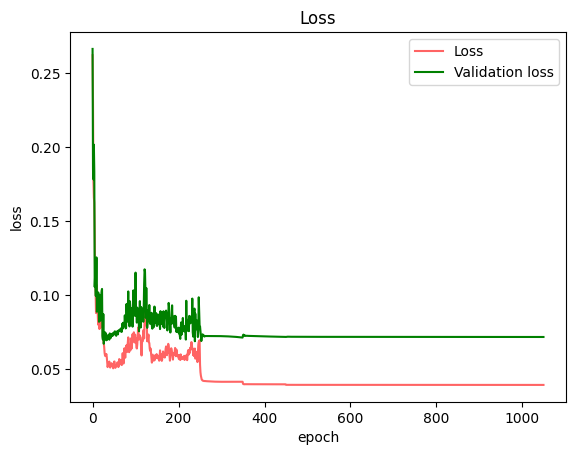

step 1, accuracy_train:0.528125, loss: 0.2721689784797986
step 2, accuracy_train:0.703125, loss: 0.21657484713871952
step 3, accuracy_train:0.76875, loss: 0.17113752723002162
step 4, accuracy_train:0.859375, loss: 0.1303845898243573
step 5, accuracy_train:0.88125, loss: 0.10806978131972418
step 6, accuracy_train:0.878125, loss: 0.10551960023297288
step 7, accuracy_train:0.909375, loss: 0.08659210607392409
step 8, accuracy_train:0.91875, loss: 0.07916841146321947
step 9, accuracy_train:0.925, loss: 0.07938164709372764
step 10, accuracy_train:0.925, loss: 0.07418747246346713
step 11, accuracy_train:0.93125, loss: 0.06458989418211541
step 12, accuracy_train:0.940625, loss: 0.06240917396591926
step 13, accuracy_train:0.9375, loss: 0.059446842158797406
step 14, accuracy_train:0.940625, loss: 0.05401067423234127
step 15, accuracy_train:0.940625, loss: 0.053397540772194975
step 16, accuracy_train:0.934375, loss: 0.05333088756983693
step 17, accuracy_train:0.9375, loss: 0.055897100159981755
st

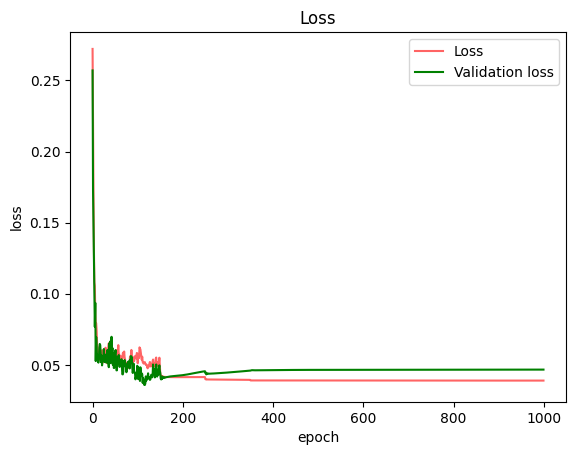

step 1, accuracy_train:0.534375, loss: 0.27373713527002136
step 2, accuracy_train:0.684375, loss: 0.2201648553373853
step 3, accuracy_train:0.746875, loss: 0.18251638446073895
step 4, accuracy_train:0.8125, loss: 0.1508007164924474
step 5, accuracy_train:0.859375, loss: 0.13274400605385947
step 6, accuracy_train:0.846875, loss: 0.12115644678816789
step 7, accuracy_train:0.88125, loss: 0.10777598591080624
step 8, accuracy_train:0.890625, loss: 0.09090649356961757
step 9, accuracy_train:0.89375, loss: 0.08384462938276988
step 10, accuracy_train:0.921875, loss: 0.07392168016435013
step 11, accuracy_train:0.903125, loss: 0.08015910308683442
step 12, accuracy_train:0.921875, loss: 0.07635300577445009
step 13, accuracy_train:0.91875, loss: 0.08712104796958377
step 14, accuracy_train:0.9125, loss: 0.08367914468368802
step 15, accuracy_train:0.925, loss: 0.07854414539241164
step 16, accuracy_train:0.89375, loss: 0.08009243221873584
step 17, accuracy_train:0.91875, loss: 0.08403025484485432
ste

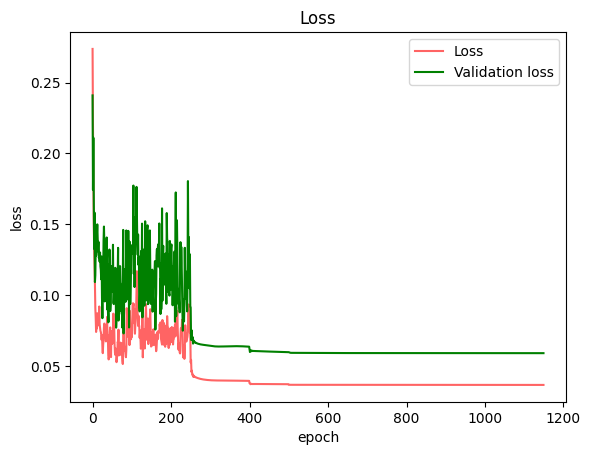

cv_time ：127.858481 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 50, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.540625, loss: 0.28032297867727196
step 2, accuracy_train:0.73125, loss: 0.20165141188853397
step 3, accuracy_train:0.809375, loss: 0.19374053321975798
step 4, accuracy_train:0.83125, loss: 0.16576113214517896
step 5, accuracy_train:0.88125, loss: 0.11963968376759829
step 6, accuracy_train:0.890625, loss: 0.09677505618112309
step 7, accuracy_train:0.909375, loss: 0.08775670851396558
step 8, accuracy_train:0.9125, loss: 0.08076648857906811
step 9, accuracy_train:0.921875, loss: 0.06777814125042993
step 10, accuracy_train:0.928125, loss: 0.06344888779210385
step 11, accuracy_train:0.93125, loss: 0.05747872578403203
step 12, accuracy_train:0.934375, loss: 0.057580322460925135
step 13, accuracy_train:0.934375, loss: 0.053533937632742674
step 14, accuracy_train:0.940625, loss: 0.0516969113198619
step 15, accuracy_train:0.9375, loss: 0.04989656156894757
step 16, accuracy_train:

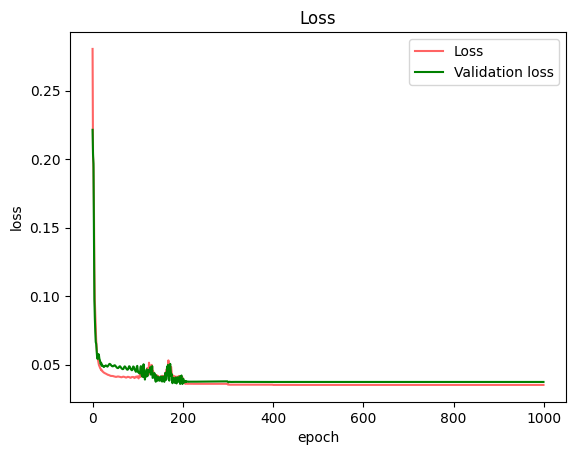

step 1, accuracy_train:0.528125, loss: 0.2773340793371266
step 2, accuracy_train:0.74375, loss: 0.19670665881188837
step 3, accuracy_train:0.828125, loss: 0.17665399176126576
step 4, accuracy_train:0.878125, loss: 0.13422811485886177
step 5, accuracy_train:0.90625, loss: 0.09621425225680318
step 6, accuracy_train:0.925, loss: 0.07596537675314595
step 7, accuracy_train:0.93125, loss: 0.06952729105145675
step 8, accuracy_train:0.9375, loss: 0.06165173852221211
step 9, accuracy_train:0.93125, loss: 0.05337350218454222
step 10, accuracy_train:0.9375, loss: 0.05111158736951932
step 11, accuracy_train:0.93125, loss: 0.045227394359528786
step 12, accuracy_train:0.9375, loss: 0.04526179865511416
step 13, accuracy_train:0.9375, loss: 0.043489088970737264
step 14, accuracy_train:0.940625, loss: 0.042429729860487084
step 15, accuracy_train:0.940625, loss: 0.04245198169488476
step 16, accuracy_train:0.940625, loss: 0.041277730735634496
step 17, accuracy_train:0.94375, loss: 0.04045307644182569
ste

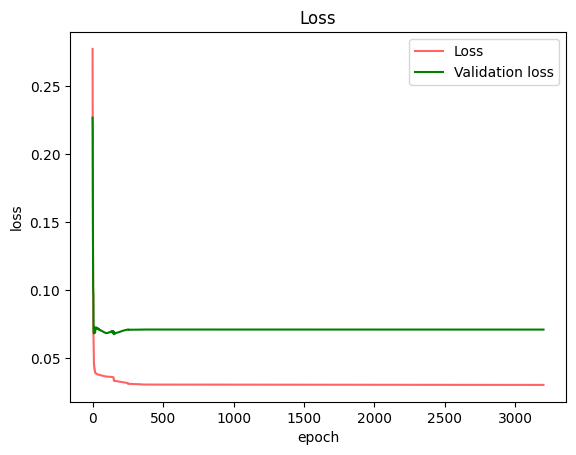

step 1, accuracy_train:0.503125, loss: 0.2905310196035484
step 2, accuracy_train:0.778125, loss: 0.1988037690603337
step 3, accuracy_train:0.80625, loss: 0.1742922993873412
step 4, accuracy_train:0.75, loss: 0.1961457597790684
step 5, accuracy_train:0.809375, loss: 0.15830648043501883
step 6, accuracy_train:0.840625, loss: 0.1370013336960753
step 7, accuracy_train:0.9, loss: 0.09596221298976207
step 8, accuracy_train:0.896875, loss: 0.09664891802909124
step 9, accuracy_train:0.90625, loss: 0.08786075796930126
step 10, accuracy_train:0.915625, loss: 0.07508708823068569
step 11, accuracy_train:0.921875, loss: 0.060611958800230445
step 12, accuracy_train:0.921875, loss: 0.05989833983696841
step 13, accuracy_train:0.921875, loss: 0.0653672102417695
step 14, accuracy_train:0.93125, loss: 0.054902313243658345
step 15, accuracy_train:0.940625, loss: 0.04773386614415639
step 16, accuracy_train:0.946875, loss: 0.04867493318959411
step 17, accuracy_train:0.934375, loss: 0.05064962761901644
step 

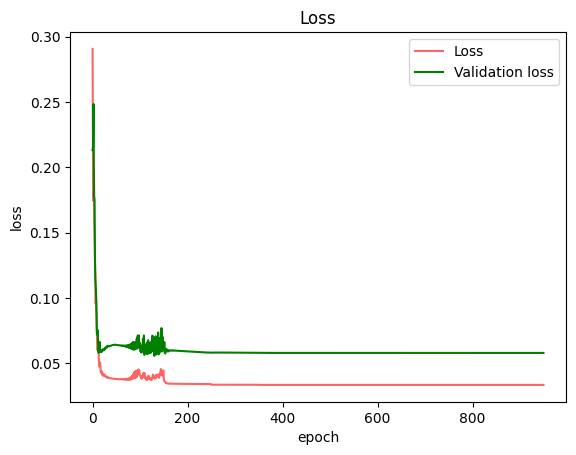

step 1, accuracy_train:0.50625, loss: 0.2871989052239484
step 2, accuracy_train:0.734375, loss: 0.1949508513866815
step 3, accuracy_train:0.73125, loss: 0.1817842618126777
step 4, accuracy_train:0.715625, loss: 0.19487887075261814
step 5, accuracy_train:0.765625, loss: 0.16405004890732292
step 6, accuracy_train:0.8, loss: 0.13204136861105376
step 7, accuracy_train:0.871875, loss: 0.10817915044137669
step 8, accuracy_train:0.890625, loss: 0.0960279374960461
step 9, accuracy_train:0.8875, loss: 0.09057231453710142
step 10, accuracy_train:0.91875, loss: 0.07032579009873868
step 11, accuracy_train:0.90625, loss: 0.06969629042482851
step 12, accuracy_train:0.915625, loss: 0.06231120011611832
step 13, accuracy_train:0.925, loss: 0.06147401475331938
step 14, accuracy_train:0.928125, loss: 0.05443874277497358
step 15, accuracy_train:0.93125, loss: 0.053940149283130845
step 16, accuracy_train:0.934375, loss: 0.05160458038640561
step 17, accuracy_train:0.94375, loss: 0.050288126391301
step 18, a

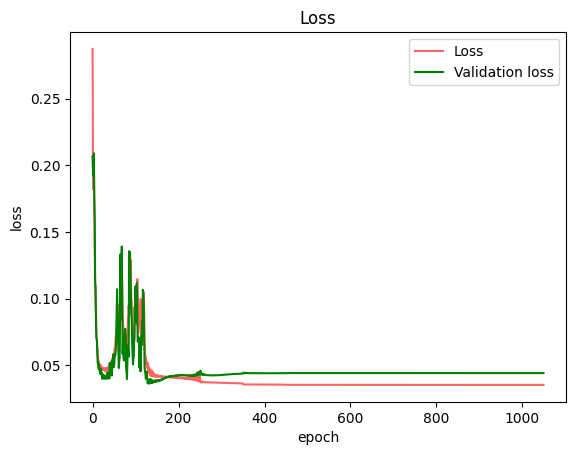

step 1, accuracy_train:0.521875, loss: 0.28444323265440397
step 2, accuracy_train:0.709375, loss: 0.2070217214690089
step 3, accuracy_train:0.759375, loss: 0.17659046579419152
step 4, accuracy_train:0.8, loss: 0.17754588027584173
step 5, accuracy_train:0.846875, loss: 0.12908589497914869
step 6, accuracy_train:0.884375, loss: 0.12253739554903018
step 7, accuracy_train:0.903125, loss: 0.08862146909121693
step 8, accuracy_train:0.909375, loss: 0.08142143749261996
step 9, accuracy_train:0.915625, loss: 0.0809864679546719
step 10, accuracy_train:0.9125, loss: 0.08059405115013267
step 11, accuracy_train:0.915625, loss: 0.06664735661764726
step 12, accuracy_train:0.928125, loss: 0.05771936330804603
step 13, accuracy_train:0.91875, loss: 0.05916813369264848
step 14, accuracy_train:0.915625, loss: 0.05832670932972746
step 15, accuracy_train:0.934375, loss: 0.0504458690490193
step 16, accuracy_train:0.93125, loss: 0.05314973070329131
step 17, accuracy_train:0.93125, loss: 0.05167973275250023
st

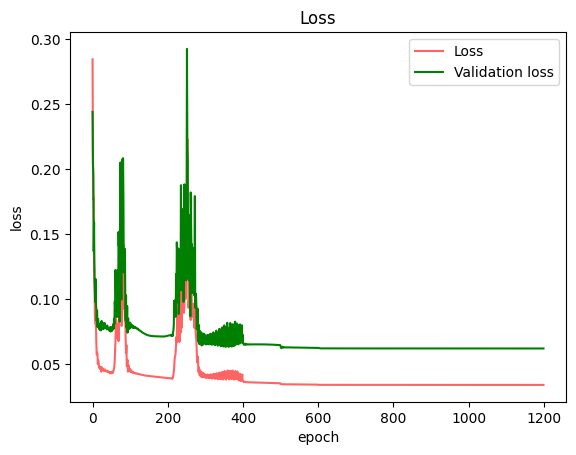

cv_time ：132.409559 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 100, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.271875, loss: 0.3364421628646119
step 2, accuracy_train:0.684375, loss: 0.20819579251557907
step 3, accuracy_train:0.75625, loss: 0.15682014908966824
step 4, accuracy_train:0.78125, loss: 0.15135402939498324
step 5, accuracy_train:0.796875, loss: 0.13879768976121198
step 6, accuracy_train:0.825, loss: 0.1339735689046896
step 7, accuracy_train:0.853125, loss: 0.12546883480315624
step 8, accuracy_train:0.865625, loss: 0.11326787461490956
step 9, accuracy_train:0.8625, loss: 0.10046587509511609
step 10, accuracy_train:0.875, loss: 0.08999840157012488
step 11, accuracy_train:0.890625, loss: 0.07587081948601761
step 12, accuracy_train:0.915625, loss: 0.0683746059909387
step 13, accuracy_train:0.915625, loss: 0.06542926660807523
step 14, accuracy_train:0.9125, loss: 0.05877839318266211
step 15, accuracy_train:0.909375, loss: 0.05463602126711139
step 16, accuracy_train:0.90312

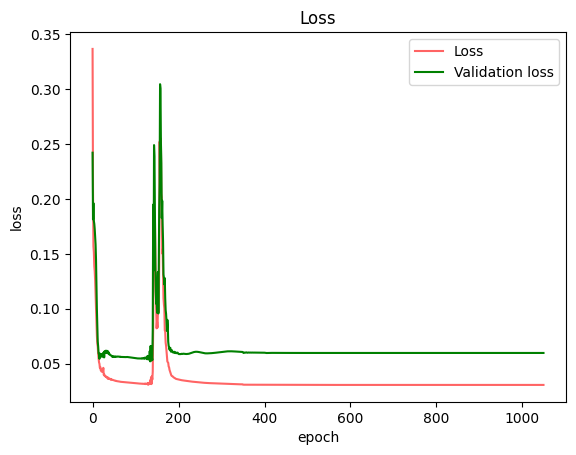

step 1, accuracy_train:0.265625, loss: 0.3299651487386513
step 2, accuracy_train:0.540625, loss: 0.2314685386076501
step 3, accuracy_train:0.7375, loss: 0.17631169084159443
step 4, accuracy_train:0.7, loss: 0.1812049832163184
step 5, accuracy_train:0.759375, loss: 0.1632904845511101
step 6, accuracy_train:0.834375, loss: 0.1530888483806376
step 7, accuracy_train:0.834375, loss: 0.13500052489928688
step 8, accuracy_train:0.865625, loss: 0.11242352111134829
step 9, accuracy_train:0.884375, loss: 0.10114013545843831
step 10, accuracy_train:0.878125, loss: 0.10072229655201644
step 11, accuracy_train:0.86875, loss: 0.09848567181325829
step 12, accuracy_train:0.878125, loss: 0.08529460036762496
step 13, accuracy_train:0.871875, loss: 0.07526940882834007
step 14, accuracy_train:0.884375, loss: 0.07016506128556889
step 15, accuracy_train:0.890625, loss: 0.0639896957824991
step 16, accuracy_train:0.890625, loss: 0.05967682936183134
step 17, accuracy_train:0.89375, loss: 0.05536779589752478
step

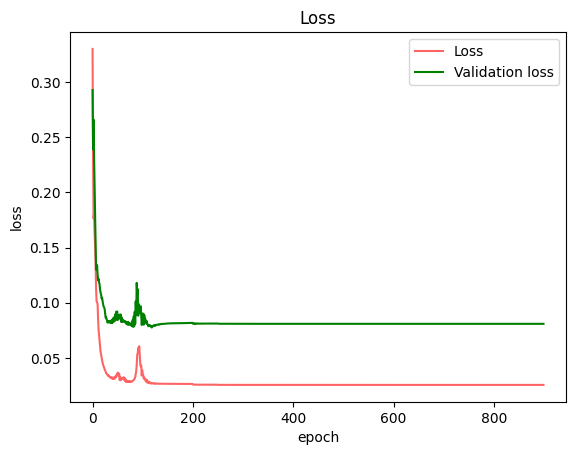

step 1, accuracy_train:0.278125, loss: 0.34090553429324577
step 2, accuracy_train:0.64375, loss: 0.2174076652790175
step 3, accuracy_train:0.765625, loss: 0.1666072454612828
step 4, accuracy_train:0.840625, loss: 0.14520038915152472
step 5, accuracy_train:0.85, loss: 0.14600112470110332
step 6, accuracy_train:0.79375, loss: 0.14225299194210939
step 7, accuracy_train:0.85, loss: 0.12250568095111464
step 8, accuracy_train:0.871875, loss: 0.09360557376507411
step 9, accuracy_train:0.8875, loss: 0.08947962972006507
step 10, accuracy_train:0.896875, loss: 0.07061387829486654
step 11, accuracy_train:0.86875, loss: 0.07774265656251654
step 12, accuracy_train:0.878125, loss: 0.06504919598038345
step 13, accuracy_train:0.896875, loss: 0.06415804276594338
step 14, accuracy_train:0.90625, loss: 0.05255345320151674
step 15, accuracy_train:0.89375, loss: 0.056363194756466825
step 16, accuracy_train:0.91875, loss: 0.04937976328352424
step 17, accuracy_train:0.9125, loss: 0.04827006150278357
step 18,

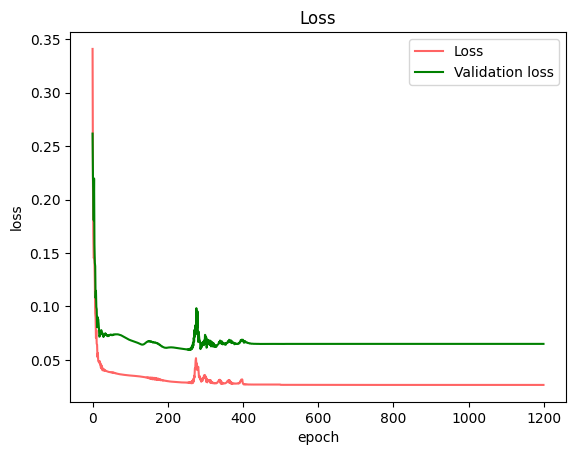

step 1, accuracy_train:0.278125, loss: 0.33992072458729516
step 2, accuracy_train:0.6125, loss: 0.2189744806273744
step 3, accuracy_train:0.74375, loss: 0.18070303176549476
step 4, accuracy_train:0.75625, loss: 0.15831411805855966
step 5, accuracy_train:0.790625, loss: 0.16236314147700692
step 6, accuracy_train:0.8, loss: 0.1469942134162999
step 7, accuracy_train:0.821875, loss: 0.1171336985095853
step 8, accuracy_train:0.878125, loss: 0.09367730770503613
step 9, accuracy_train:0.890625, loss: 0.08751994696143396
step 10, accuracy_train:0.86875, loss: 0.08675268706267213
step 11, accuracy_train:0.890625, loss: 0.07148227659751602
step 12, accuracy_train:0.909375, loss: 0.06653974032965868
step 13, accuracy_train:0.928125, loss: 0.06135332601830626
step 14, accuracy_train:0.909375, loss: 0.05835283087486855
step 15, accuracy_train:0.91875, loss: 0.05251748702917234
step 16, accuracy_train:0.925, loss: 0.053901873815214205
step 17, accuracy_train:0.91875, loss: 0.05079643854120916
step 1

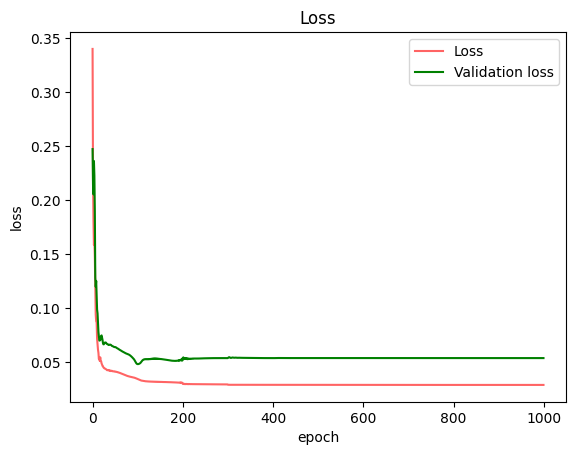

step 1, accuracy_train:0.271875, loss: 0.33804139147789014
step 2, accuracy_train:0.471875, loss: 0.27033796432358037
step 3, accuracy_train:0.759375, loss: 0.20370792609747557
step 4, accuracy_train:0.76875, loss: 0.1837478731956998
step 5, accuracy_train:0.78125, loss: 0.1612611360548875
step 6, accuracy_train:0.828125, loss: 0.13675784214105774
step 7, accuracy_train:0.89375, loss: 0.10378629069539691
step 8, accuracy_train:0.878125, loss: 0.09372006294965499
step 9, accuracy_train:0.871875, loss: 0.09169510404607421
step 10, accuracy_train:0.89375, loss: 0.07413300576546467
step 11, accuracy_train:0.896875, loss: 0.06220751076743626
step 12, accuracy_train:0.909375, loss: 0.05770045018409741
step 13, accuracy_train:0.896875, loss: 0.05384050151923858
step 14, accuracy_train:0.903125, loss: 0.05248884481722975
step 15, accuracy_train:0.915625, loss: 0.04796012486961701
step 16, accuracy_train:0.91875, loss: 0.047565827481791834
step 17, accuracy_train:0.9125, loss: 0.043414275675029

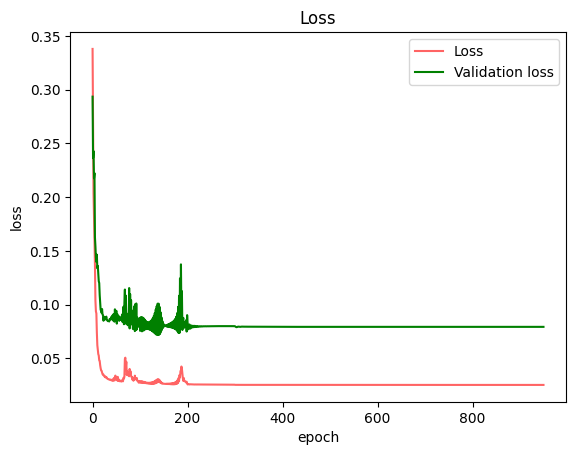

cv_time ：72.964388 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 300, 50, [0.05, 0.03, 0.01]]


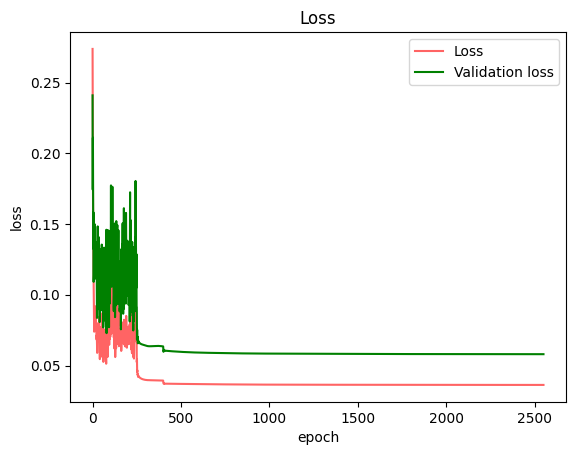

circuit is jitted
circuit is jitted
circuit is jitted
circuit is jitted
step 1, accuracy_train:0.61875, loss: 0.24266175680328214
circuit is jitted
circuit is jitted
step 2, accuracy_train:0.7125, loss: 0.20897712835477147
step 3, accuracy_train:0.8375, loss: 0.1512189793760922
step 4, accuracy_train:0.89375, loss: 0.12312673066741543
step 5, accuracy_train:0.91875, loss: 0.106856925477455
step 6, accuracy_train:0.896875, loss: 0.1071674017752296
step 7, accuracy_train:0.875, loss: 0.11769753627693409
step 8, accuracy_train:0.8875, loss: 0.10997690009306767
step 9, accuracy_train:0.921875, loss: 0.09707754027504709
step 10, accuracy_train:0.921875, loss: 0.09917299423566187
step 11, accuracy_train:0.928125, loss: 0.09596501975955864
step 12, accuracy_train:0.925, loss: 0.09812776082839442
step 13, accuracy_train:0.89375, loss: 0.10489743124642627
step 14, accuracy_train:0.93125, loss: 0.08890695411059234
step 15, accuracy_train:0.915625, loss: 0.089683937598262
step 16, accuracy_train:

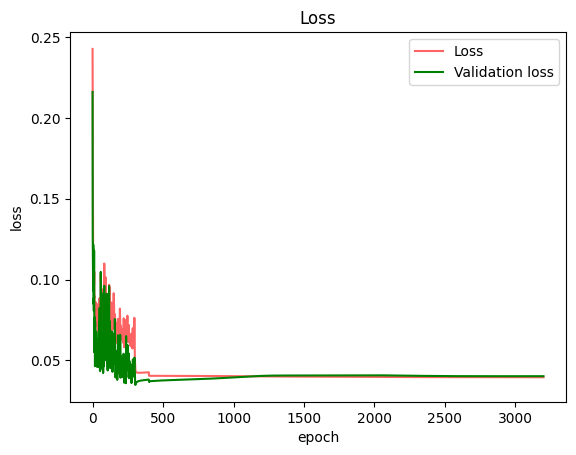

step 1, accuracy_train:0.6, loss: 0.2511865763590249
step 2, accuracy_train:0.6875, loss: 0.22251928163236417
step 3, accuracy_train:0.778125, loss: 0.18749192580109425
step 4, accuracy_train:0.790625, loss: 0.16605070932370544
step 5, accuracy_train:0.88125, loss: 0.1369229468595678
step 6, accuracy_train:0.86875, loss: 0.12112696086823393
step 7, accuracy_train:0.89375, loss: 0.10677986929014371
step 8, accuracy_train:0.90625, loss: 0.11039761460574177
step 9, accuracy_train:0.915625, loss: 0.10208673741015269
step 10, accuracy_train:0.896875, loss: 0.11521911596165148
step 11, accuracy_train:0.93125, loss: 0.09106658095446836
step 12, accuracy_train:0.925, loss: 0.09351413166048564
step 13, accuracy_train:0.934375, loss: 0.09032680849678146
step 14, accuracy_train:0.915625, loss: 0.09184953945564171
step 15, accuracy_train:0.925, loss: 0.0799193302513913
step 16, accuracy_train:0.925, loss: 0.07584553786471977
step 17, accuracy_train:0.921875, loss: 0.07609993582777376
step 18, accu

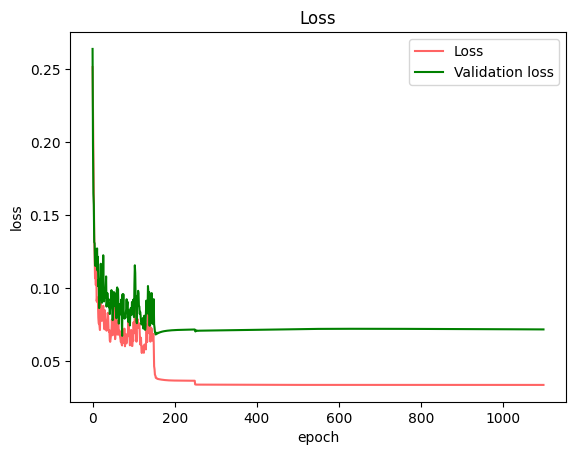

step 1, accuracy_train:0.63125, loss: 0.24693706439693586
step 2, accuracy_train:0.7625, loss: 0.19532339903020932
step 3, accuracy_train:0.859375, loss: 0.15800030269827048
step 4, accuracy_train:0.875, loss: 0.142191252287007
step 5, accuracy_train:0.8875, loss: 0.12001529850360346
step 6, accuracy_train:0.90625, loss: 0.11099949224820986
step 7, accuracy_train:0.90625, loss: 0.10385864320053513
step 8, accuracy_train:0.940625, loss: 0.09616344416367029
step 9, accuracy_train:0.928125, loss: 0.08186993189977308
step 10, accuracy_train:0.934375, loss: 0.07382871062586603
step 11, accuracy_train:0.934375, loss: 0.06705866597571758
step 12, accuracy_train:0.9375, loss: 0.06779900683252685
step 13, accuracy_train:0.928125, loss: 0.06761207823514759
step 14, accuracy_train:0.940625, loss: 0.0686321823384927
step 15, accuracy_train:0.928125, loss: 0.07090924828793828
step 16, accuracy_train:0.91875, loss: 0.07864173237754479
step 17, accuracy_train:0.921875, loss: 0.07267213320144372
step 

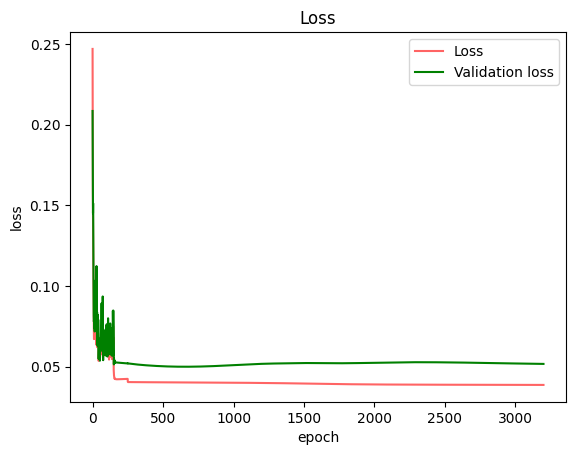

step 1, accuracy_train:0.625, loss: 0.24526301141936985
step 2, accuracy_train:0.75625, loss: 0.19589218434350603
step 3, accuracy_train:0.76875, loss: 0.18468592133414513
step 4, accuracy_train:0.815625, loss: 0.1553491637300485
step 5, accuracy_train:0.86875, loss: 0.12592891879034082
step 6, accuracy_train:0.9, loss: 0.10737301505894895
step 7, accuracy_train:0.921875, loss: 0.09946072014925503
step 8, accuracy_train:0.91875, loss: 0.0915764990377049
step 9, accuracy_train:0.91875, loss: 0.0885804864434871
step 10, accuracy_train:0.928125, loss: 0.08715805376806957
step 11, accuracy_train:0.93125, loss: 0.0771273020568342
step 12, accuracy_train:0.925, loss: 0.0735077745929379
step 13, accuracy_train:0.934375, loss: 0.06806411898732026
step 14, accuracy_train:0.93125, loss: 0.06664680804285357
step 15, accuracy_train:0.940625, loss: 0.0640011383204916
step 16, accuracy_train:0.925, loss: 0.06669235991026745
step 17, accuracy_train:0.934375, loss: 0.06692080389433036
step 18, accurac

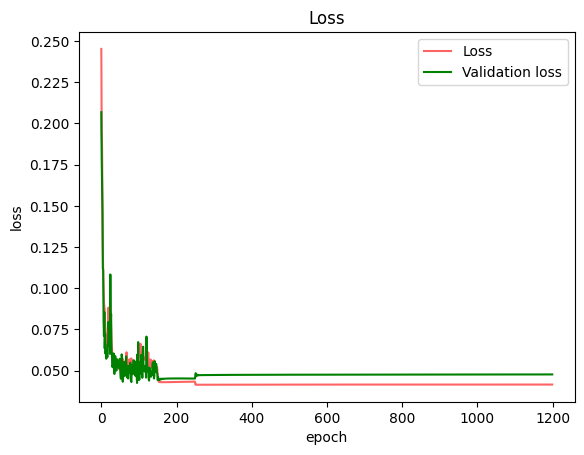

step 1, accuracy_train:0.646875, loss: 0.2405700710652295
step 2, accuracy_train:0.80625, loss: 0.18702305765836544
step 3, accuracy_train:0.803125, loss: 0.1664375514400305
step 4, accuracy_train:0.859375, loss: 0.1484916885946965
step 5, accuracy_train:0.89375, loss: 0.1212482811686696
step 6, accuracy_train:0.9125, loss: 0.116928317338586
step 7, accuracy_train:0.91875, loss: 0.09590595552578123
step 8, accuracy_train:0.884375, loss: 0.10884752221000155
step 9, accuracy_train:0.909375, loss: 0.11571838773563431
step 10, accuracy_train:0.9, loss: 0.10837143930161676
step 11, accuracy_train:0.9, loss: 0.10669036106739474
step 12, accuracy_train:0.896875, loss: 0.10182234420416021
step 13, accuracy_train:0.9375, loss: 0.080524297009522
step 14, accuracy_train:0.9, loss: 0.0996790164512892
step 15, accuracy_train:0.925, loss: 0.09018782848944817
step 16, accuracy_train:0.921875, loss: 0.090093045911137
step 17, accuracy_train:0.925, loss: 0.08317904375527767
step 18, accuracy_train:0.91

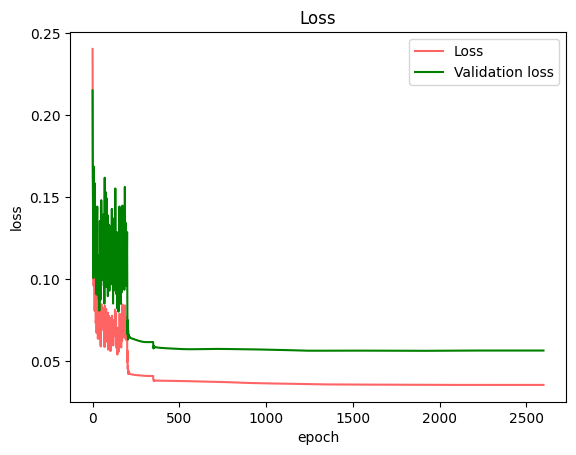

cv_time ：453.068363 s
[[0.15, 0.05, 0.01], 3200, 50, 50, [0.05, 0.03, 0.01]]
circuit is jitted
circuit is jitted
step 1, accuracy_train:0.496875, loss: 0.26349980979785215
step 2, accuracy_train:0.675, loss: 0.21740806633878612
step 3, accuracy_train:0.753125, loss: 0.19377555836293997
step 4, accuracy_train:0.803125, loss: 0.16938066991133027
step 5, accuracy_train:0.8625, loss: 0.14181211053011364
step 6, accuracy_train:0.859375, loss: 0.12346545351263127
step 7, accuracy_train:0.890625, loss: 0.10659229223955621
step 8, accuracy_train:0.89375, loss: 0.09763033894185788
step 9, accuracy_train:0.921875, loss: 0.0788387571538851
step 10, accuracy_train:0.934375, loss: 0.06998195740507823
step 11, accuracy_train:0.928125, loss: 0.06938863582998367
step 12, accuracy_train:0.925, loss: 0.06175646541505724
step 13, accuracy_train:0.93125, loss: 0.05833112048018913
step 14, accuracy_train:0.925, loss: 0.05711090453673911
step 15, accuracy_train:0.9375, loss: 0.0542215623936892
step 16, accu

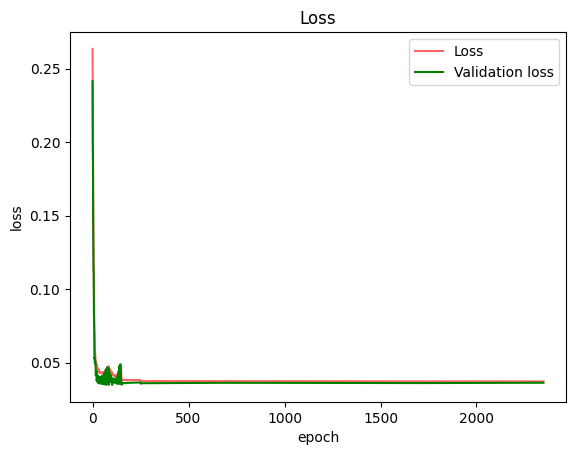

step 1, accuracy_train:0.5125, loss: 0.27167777029782375
step 2, accuracy_train:0.6125, loss: 0.2262508281041676
step 3, accuracy_train:0.71875, loss: 0.20301000616687792
step 4, accuracy_train:0.765625, loss: 0.19229945559064648
step 5, accuracy_train:0.790625, loss: 0.17944314920981358
step 6, accuracy_train:0.84375, loss: 0.15249646308865528
step 7, accuracy_train:0.896875, loss: 0.1348576722653028
step 8, accuracy_train:0.9, loss: 0.11156686283172512
step 9, accuracy_train:0.9, loss: 0.09586576033294972
step 10, accuracy_train:0.928125, loss: 0.08536667335652347
step 11, accuracy_train:0.915625, loss: 0.07765101886469467
step 12, accuracy_train:0.90625, loss: 0.06964337122318058
step 13, accuracy_train:0.934375, loss: 0.06538817241923542
step 14, accuracy_train:0.934375, loss: 0.05983591752275248
step 15, accuracy_train:0.94375, loss: 0.05679776839686261
step 16, accuracy_train:0.940625, loss: 0.05329037086772638
step 17, accuracy_train:0.93125, loss: 0.05474845306459166
step 18, a

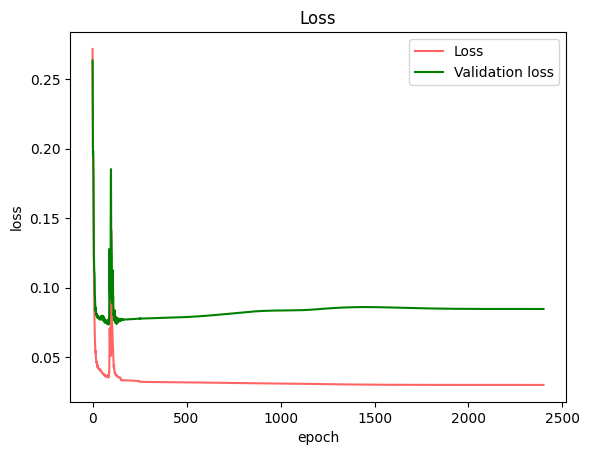

step 1, accuracy_train:0.484375, loss: 0.2655936885530672
step 2, accuracy_train:0.6375, loss: 0.21852133794033501
step 3, accuracy_train:0.740625, loss: 0.1987885649609977
step 4, accuracy_train:0.765625, loss: 0.17980002098930184
step 5, accuracy_train:0.8375, loss: 0.14687545026437246
step 6, accuracy_train:0.834375, loss: 0.13495543536045934
step 7, accuracy_train:0.85, loss: 0.11709084957166115
step 8, accuracy_train:0.9, loss: 0.09002056881836717
step 9, accuracy_train:0.915625, loss: 0.08854394804992943
step 10, accuracy_train:0.90625, loss: 0.0878585452580167
step 11, accuracy_train:0.921875, loss: 0.09114495663329023
step 12, accuracy_train:0.934375, loss: 0.07779365481529618
step 13, accuracy_train:0.91875, loss: 0.069711045979682
step 14, accuracy_train:0.934375, loss: 0.06563945614986812
step 15, accuracy_train:0.928125, loss: 0.06075966867066811
step 16, accuracy_train:0.946875, loss: 0.054940946540637164
step 17, accuracy_train:0.928125, loss: 0.0584954245598458
step 18, 

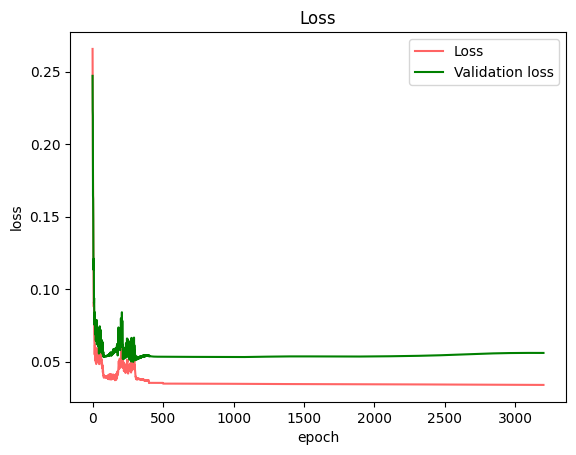

step 1, accuracy_train:0.46875, loss: 0.2740513423315347
step 2, accuracy_train:0.653125, loss: 0.21816610323587968
step 3, accuracy_train:0.69375, loss: 0.21274632816182115
step 4, accuracy_train:0.715625, loss: 0.19550385039249218
step 5, accuracy_train:0.765625, loss: 0.18229366028355481
step 6, accuracy_train:0.778125, loss: 0.1780284152778196
step 7, accuracy_train:0.790625, loss: 0.16827655442134695
step 8, accuracy_train:0.825, loss: 0.15911253937067776
step 9, accuracy_train:0.875, loss: 0.15527445863478
step 10, accuracy_train:0.878125, loss: 0.1341063348871978
step 11, accuracy_train:0.896875, loss: 0.12808332613057827
step 12, accuracy_train:0.890625, loss: 0.11529543128888924
step 13, accuracy_train:0.890625, loss: 0.11207371412595744
step 14, accuracy_train:0.90625, loss: 0.0972747093028219
step 15, accuracy_train:0.91875, loss: 0.09091571060345574
step 16, accuracy_train:0.928125, loss: 0.08617371760936554
step 17, accuracy_train:0.940625, loss: 0.07514199966382315
step 1

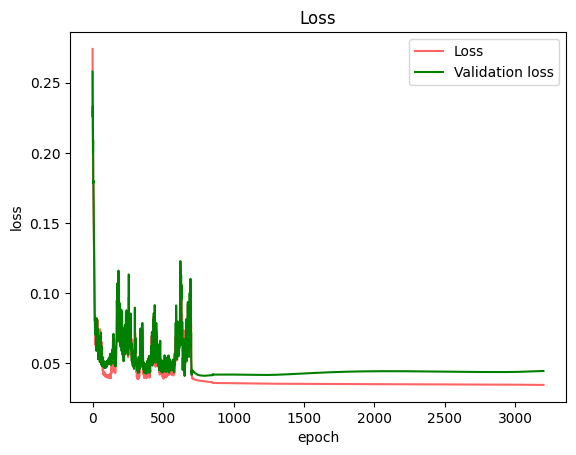

step 1, accuracy_train:0.44375, loss: 0.2918403808024544
step 2, accuracy_train:0.615625, loss: 0.2358541905644001
step 3, accuracy_train:0.65, loss: 0.21934177106382596
step 4, accuracy_train:0.671875, loss: 0.21918357971750277
step 5, accuracy_train:0.69375, loss: 0.20474290723569302
step 6, accuracy_train:0.778125, loss: 0.18205812837672433
step 7, accuracy_train:0.79375, loss: 0.16440324904514658
step 8, accuracy_train:0.853125, loss: 0.1530363047375473
step 9, accuracy_train:0.821875, loss: 0.1434589827340576
step 10, accuracy_train:0.85625, loss: 0.13111586994608754
step 11, accuracy_train:0.878125, loss: 0.12423968755835887
step 12, accuracy_train:0.890625, loss: 0.1119278469843277
step 13, accuracy_train:0.8875, loss: 0.10842443234888616
step 14, accuracy_train:0.9125, loss: 0.11324809108492936
step 15, accuracy_train:0.928125, loss: 0.08422937176698551
step 16, accuracy_train:0.921875, loss: 0.07692993678835384
step 17, accuracy_train:0.93125, loss: 0.07607275926478195
step 18

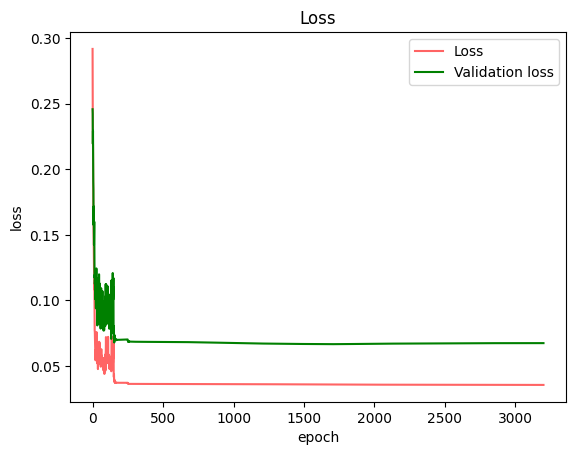

cv_time ：397.819980 s
[[0.15, 0.05, 0.01], 3200, 100, 50, [0.05, 0.03, 0.01]]
circuit is jitted
circuit is jitted
step 1, accuracy_train:0.45625, loss: 0.2732765478528
step 2, accuracy_train:0.5625, loss: 0.22263656143333804
step 3, accuracy_train:0.709375, loss: 0.19538228759655893
step 4, accuracy_train:0.696875, loss: 0.18038589681424927
step 5, accuracy_train:0.796875, loss: 0.16698338227449164
step 6, accuracy_train:0.815625, loss: 0.16546727036471917
step 7, accuracy_train:0.825, loss: 0.14805517482409825
step 8, accuracy_train:0.834375, loss: 0.1360195156341205
step 9, accuracy_train:0.846875, loss: 0.12603734148255968
step 10, accuracy_train:0.9, loss: 0.107128380635196
step 11, accuracy_train:0.909375, loss: 0.1046833916196911
step 12, accuracy_train:0.903125, loss: 0.09313763763939348
step 13, accuracy_train:0.8875, loss: 0.09068044997838405
step 14, accuracy_train:0.90625, loss: 0.08489785568893553
step 15, accuracy_train:0.9, loss: 0.08236655636166215
step 16, accuracy_trai

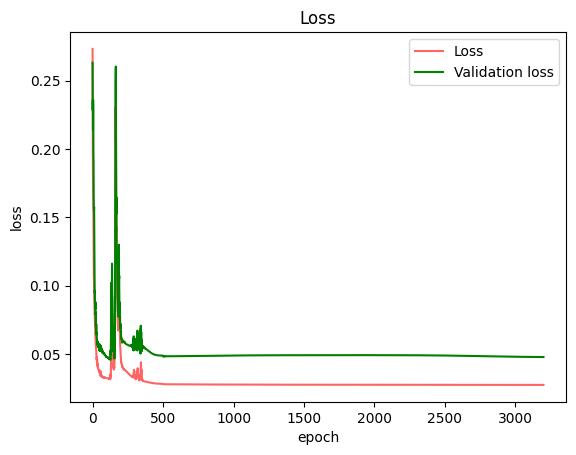

step 1, accuracy_train:0.48125, loss: 0.2688367231860849
step 2, accuracy_train:0.465625, loss: 0.23126578907847056
step 3, accuracy_train:0.55, loss: 0.2213827288874497
step 4, accuracy_train:0.584375, loss: 0.19465599902494113
step 5, accuracy_train:0.653125, loss: 0.18707527371272192
step 6, accuracy_train:0.725, loss: 0.16667067177341596
step 7, accuracy_train:0.73125, loss: 0.15976791378047706
step 8, accuracy_train:0.725, loss: 0.16462242609093
step 9, accuracy_train:0.725, loss: 0.14604681165327907
step 10, accuracy_train:0.78125, loss: 0.13157980854918006
step 11, accuracy_train:0.834375, loss: 0.12182249974134614
step 12, accuracy_train:0.890625, loss: 0.11664158820654483
step 13, accuracy_train:0.8875, loss: 0.10828748709730168
step 14, accuracy_train:0.89375, loss: 0.100457639597929
step 15, accuracy_train:0.903125, loss: 0.09400260721540883
step 16, accuracy_train:0.909375, loss: 0.08660347057467488
step 17, accuracy_train:0.90625, loss: 0.08116470774522869
step 18, accurac

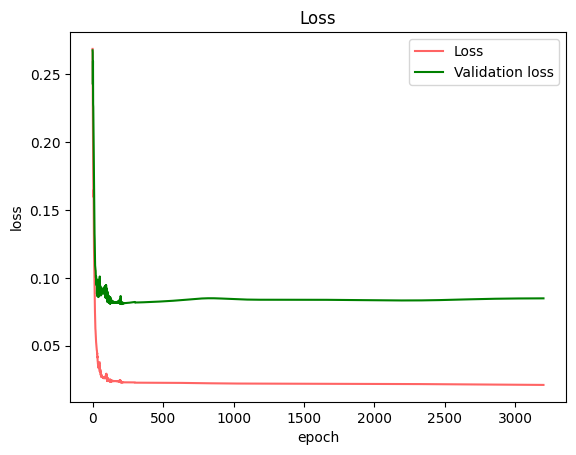

step 1, accuracy_train:0.478125, loss: 0.26415289516861995
step 2, accuracy_train:0.64375, loss: 0.2167219179994801
step 3, accuracy_train:0.6, loss: 0.1999075859182965
step 4, accuracy_train:0.746875, loss: 0.18256020776930654
step 5, accuracy_train:0.753125, loss: 0.1794328439232785
step 6, accuracy_train:0.746875, loss: 0.1848696829864218
step 7, accuracy_train:0.81875, loss: 0.15249895137572264
step 8, accuracy_train:0.853125, loss: 0.13162300053291254
step 9, accuracy_train:0.871875, loss: 0.1165950768931509
step 10, accuracy_train:0.86875, loss: 0.11631241949572685
step 11, accuracy_train:0.8875, loss: 0.10180566925520425
step 12, accuracy_train:0.890625, loss: 0.09036184179223873
step 13, accuracy_train:0.890625, loss: 0.08886069108807268
step 14, accuracy_train:0.903125, loss: 0.07695623366608176
step 15, accuracy_train:0.9, loss: 0.07004228230490028
step 16, accuracy_train:0.9125, loss: 0.06556158563216509
step 17, accuracy_train:0.903125, loss: 0.06602627659038622
step 18, ac

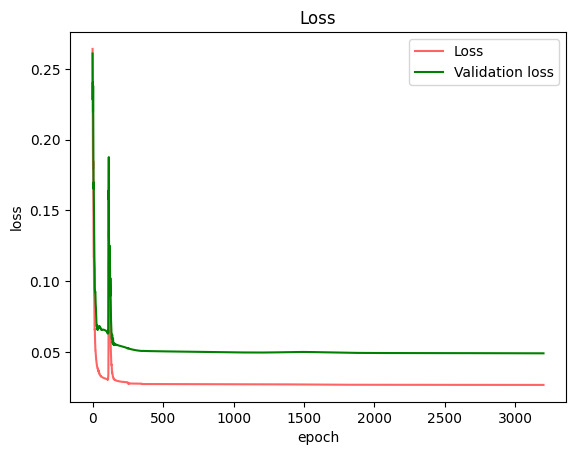

step 1, accuracy_train:0.453125, loss: 0.2706280750189738
step 2, accuracy_train:0.4625, loss: 0.2184015163489791
step 3, accuracy_train:0.621875, loss: 0.19436653906033619
step 4, accuracy_train:0.71875, loss: 0.1866094253234522
step 5, accuracy_train:0.734375, loss: 0.18173729975622158
step 6, accuracy_train:0.8, loss: 0.14085629812590633
step 7, accuracy_train:0.834375, loss: 0.14338083515721914
step 8, accuracy_train:0.84375, loss: 0.12677557947944762
step 9, accuracy_train:0.871875, loss: 0.11065897011585854
step 10, accuracy_train:0.85625, loss: 0.11257927117542701
step 11, accuracy_train:0.884375, loss: 0.10105081785463543
step 12, accuracy_train:0.89375, loss: 0.09528400486895382
step 13, accuracy_train:0.88125, loss: 0.0905276596777484
step 14, accuracy_train:0.884375, loss: 0.08339908061610773
step 15, accuracy_train:0.8875, loss: 0.08170585391994309
step 16, accuracy_train:0.890625, loss: 0.07590497984927605
step 17, accuracy_train:0.896875, loss: 0.06991617866038824
step 18

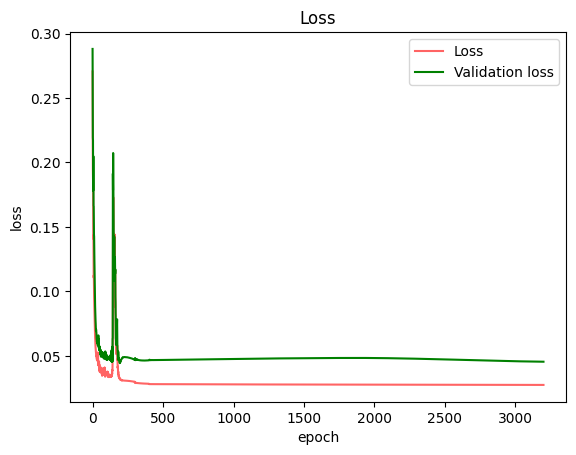

step 1, accuracy_train:0.4625, loss: 0.28969762223591444
step 2, accuracy_train:0.4625, loss: 0.258368586644789
step 3, accuracy_train:0.646875, loss: 0.21434553491011651
step 4, accuracy_train:0.653125, loss: 0.20241838887164432
step 5, accuracy_train:0.71875, loss: 0.19587183786672352
step 6, accuracy_train:0.796875, loss: 0.16361778985815403
step 7, accuracy_train:0.78125, loss: 0.15473207715759446
step 8, accuracy_train:0.815625, loss: 0.13405249146525
step 9, accuracy_train:0.796875, loss: 0.11815164563346309
step 10, accuracy_train:0.85625, loss: 0.1022761097466395
step 11, accuracy_train:0.83125, loss: 0.09877743484461744
step 12, accuracy_train:0.86875, loss: 0.09209554388127197
step 13, accuracy_train:0.85625, loss: 0.09205251451343166
step 14, accuracy_train:0.878125, loss: 0.08486843628048316
step 15, accuracy_train:0.890625, loss: 0.0783576267959639
step 16, accuracy_train:0.9, loss: 0.07403985074531859
step 17, accuracy_train:0.896875, loss: 0.07070678920584922
step 18, ac

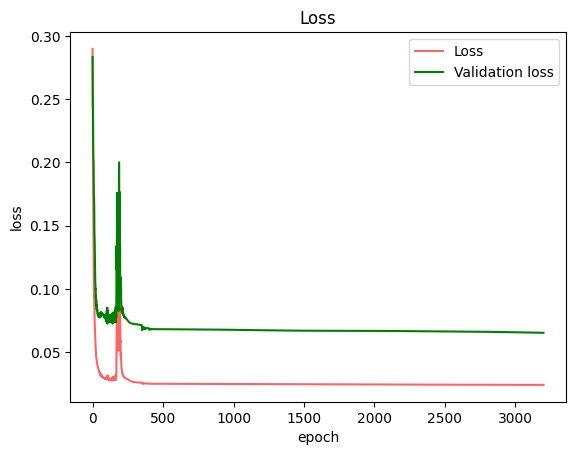

cv_time ：353.741016 s
[[0.15, 0.05, 0.01], 3200, 300, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.61875, loss: 0.24266175680328214
step 2, accuracy_train:0.7125, loss: 0.20897712835477147
step 3, accuracy_train:0.8375, loss: 0.1512189793760922
step 4, accuracy_train:0.89375, loss: 0.12312673066741543
step 5, accuracy_train:0.91875, loss: 0.106856925477455
step 6, accuracy_train:0.896875, loss: 0.1071674017752296
step 7, accuracy_train:0.875, loss: 0.11769753627693409
step 8, accuracy_train:0.8875, loss: 0.10997690009306767
step 9, accuracy_train:0.921875, loss: 0.09707754027504709
step 10, accuracy_train:0.921875, loss: 0.09917299423566187
step 11, accuracy_train:0.928125, loss: 0.09596501975955864
step 12, accuracy_train:0.925, loss: 0.09812776082839442
step 13, accuracy_train:0.89375, loss: 0.10489743124642627
step 14, accuracy_train:0.93125, loss: 0.08890695411059234
step 15, accuracy_train:0.915625, loss: 0.089683937598262
step 16, accuracy_train:0.921875, loss: 0.080630121951

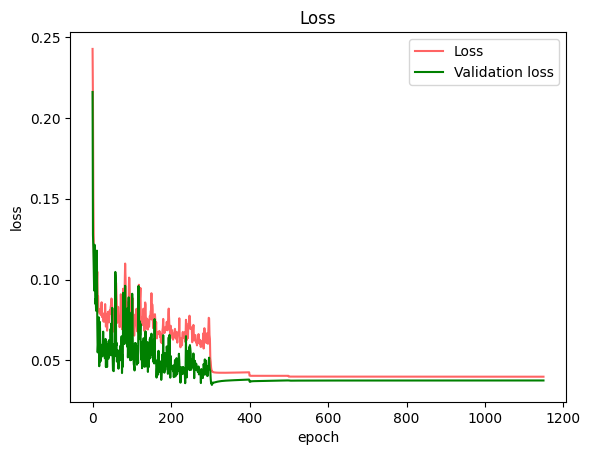

step 1, accuracy_train:0.6, loss: 0.2511865763590249
step 2, accuracy_train:0.6875, loss: 0.22251928163236417
step 3, accuracy_train:0.778125, loss: 0.18749192580109425
step 4, accuracy_train:0.790625, loss: 0.16605070932370544
step 5, accuracy_train:0.88125, loss: 0.1369229468595678
step 6, accuracy_train:0.86875, loss: 0.12112696086823393
step 7, accuracy_train:0.89375, loss: 0.10677986929014371
step 8, accuracy_train:0.90625, loss: 0.11039761460574177
step 9, accuracy_train:0.915625, loss: 0.10208673741015269
step 10, accuracy_train:0.896875, loss: 0.11521911596165148
step 11, accuracy_train:0.93125, loss: 0.09106658095446836
step 12, accuracy_train:0.925, loss: 0.09351413166048564
step 13, accuracy_train:0.934375, loss: 0.09032680849678146
step 14, accuracy_train:0.915625, loss: 0.09184953945564171
step 15, accuracy_train:0.925, loss: 0.0799193302513913
step 16, accuracy_train:0.925, loss: 0.07584553786471977
step 17, accuracy_train:0.921875, loss: 0.07609993582777376
step 18, accu

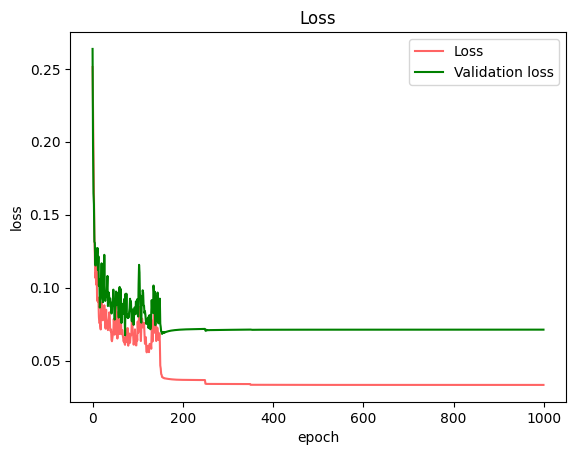

step 1, accuracy_train:0.63125, loss: 0.24693706439693586
step 2, accuracy_train:0.7625, loss: 0.19532339903020932
step 3, accuracy_train:0.859375, loss: 0.15800030269827048
step 4, accuracy_train:0.875, loss: 0.142191252287007
step 5, accuracy_train:0.8875, loss: 0.12001529850360346
step 6, accuracy_train:0.90625, loss: 0.11099949224820986
step 7, accuracy_train:0.90625, loss: 0.10385864320053513
step 8, accuracy_train:0.940625, loss: 0.09616344416367029
step 9, accuracy_train:0.928125, loss: 0.08186993189977308
step 10, accuracy_train:0.934375, loss: 0.07382871062586603
step 11, accuracy_train:0.934375, loss: 0.06705866597571758
step 12, accuracy_train:0.9375, loss: 0.06779900683252685
step 13, accuracy_train:0.928125, loss: 0.06761207823514759
step 14, accuracy_train:0.940625, loss: 0.0686321823384927
step 15, accuracy_train:0.928125, loss: 0.07090924828793828
step 16, accuracy_train:0.91875, loss: 0.07864173237754479
step 17, accuracy_train:0.921875, loss: 0.07267213320144372
step 

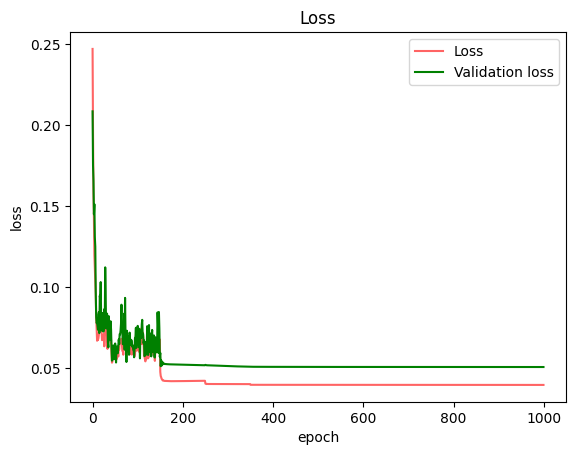

step 1, accuracy_train:0.625, loss: 0.24526301141936985
step 2, accuracy_train:0.75625, loss: 0.19589218434350603
step 3, accuracy_train:0.76875, loss: 0.18468592133414513
step 4, accuracy_train:0.815625, loss: 0.1553491637300485
step 5, accuracy_train:0.86875, loss: 0.12592891879034082
step 6, accuracy_train:0.9, loss: 0.10737301505894895
step 7, accuracy_train:0.921875, loss: 0.09946072014925503
step 8, accuracy_train:0.91875, loss: 0.0915764990377049
step 9, accuracy_train:0.91875, loss: 0.0885804864434871
step 10, accuracy_train:0.928125, loss: 0.08715805376806957
step 11, accuracy_train:0.93125, loss: 0.0771273020568342
step 12, accuracy_train:0.925, loss: 0.0735077745929379
step 13, accuracy_train:0.934375, loss: 0.06806411898732026
step 14, accuracy_train:0.93125, loss: 0.06664680804285357
step 15, accuracy_train:0.940625, loss: 0.0640011383204916
step 16, accuracy_train:0.925, loss: 0.06669235991026745
step 17, accuracy_train:0.934375, loss: 0.06692080389433036
step 18, accurac

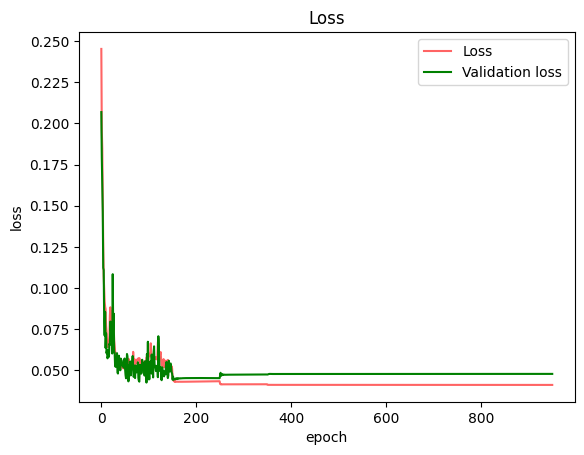

step 1, accuracy_train:0.646875, loss: 0.2405700710652295
step 2, accuracy_train:0.80625, loss: 0.18702305765836544
step 3, accuracy_train:0.803125, loss: 0.1664375514400305
step 4, accuracy_train:0.859375, loss: 0.1484916885946965
step 5, accuracy_train:0.89375, loss: 0.1212482811686696
step 6, accuracy_train:0.9125, loss: 0.116928317338586
step 7, accuracy_train:0.91875, loss: 0.09590595552578123
step 8, accuracy_train:0.884375, loss: 0.10884752221000155
step 9, accuracy_train:0.909375, loss: 0.11571838773563431
step 10, accuracy_train:0.9, loss: 0.10837143930161676
step 11, accuracy_train:0.9, loss: 0.10669036106739474
step 12, accuracy_train:0.896875, loss: 0.10182234420416021
step 13, accuracy_train:0.9375, loss: 0.080524297009522
step 14, accuracy_train:0.9, loss: 0.0996790164512892
step 15, accuracy_train:0.925, loss: 0.09018782848944817
step 16, accuracy_train:0.921875, loss: 0.090093045911137
step 17, accuracy_train:0.925, loss: 0.08317904375527767
step 18, accuracy_train:0.91

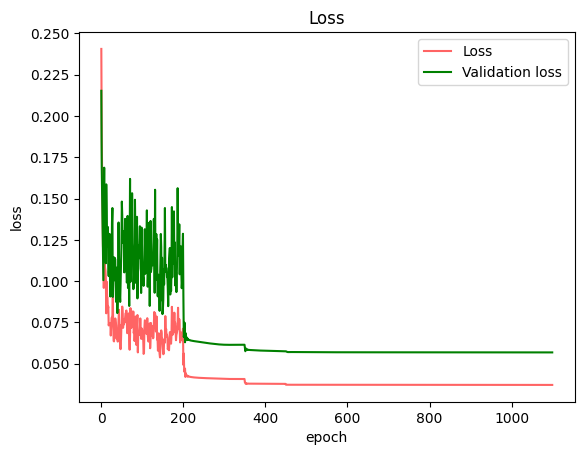

cv_time ：162.342442 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 50, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.496875, loss: 0.26349980979785215
step 2, accuracy_train:0.675, loss: 0.21740806633878612
step 3, accuracy_train:0.753125, loss: 0.19377555836293997
step 4, accuracy_train:0.803125, loss: 0.16938066991133027
step 5, accuracy_train:0.8625, loss: 0.14181211053011364
step 6, accuracy_train:0.859375, loss: 0.12346545351263127
step 7, accuracy_train:0.890625, loss: 0.10659229223955621
step 8, accuracy_train:0.89375, loss: 0.09763033894185788
step 9, accuracy_train:0.921875, loss: 0.0788387571538851
step 10, accuracy_train:0.934375, loss: 0.06998195740507823
step 11, accuracy_train:0.928125, loss: 0.06938863582998367
step 12, accuracy_train:0.925, loss: 0.06175646541505724
step 13, accuracy_train:0.93125, loss: 0.05833112048018913
step 14, accuracy_train:0.925, loss: 0.05711090453673911
step 15, accuracy_train:0.9375, loss: 0.0542215623936892
step 16, accuracy_train:0.93125, l

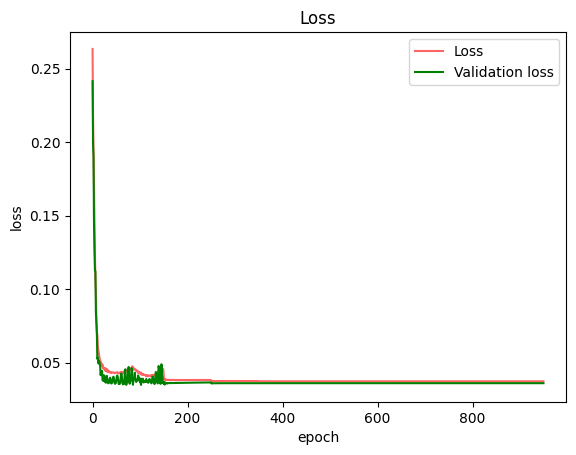

step 1, accuracy_train:0.5125, loss: 0.27167777029782375
step 2, accuracy_train:0.6125, loss: 0.2262508281041676
step 3, accuracy_train:0.71875, loss: 0.20301000616687792
step 4, accuracy_train:0.765625, loss: 0.19229945559064648
step 5, accuracy_train:0.790625, loss: 0.17944314920981358
step 6, accuracy_train:0.84375, loss: 0.15249646308865528
step 7, accuracy_train:0.896875, loss: 0.1348576722653028
step 8, accuracy_train:0.9, loss: 0.11156686283172512
step 9, accuracy_train:0.9, loss: 0.09586576033294972
step 10, accuracy_train:0.928125, loss: 0.08536667335652347
step 11, accuracy_train:0.915625, loss: 0.07765101886469467
step 12, accuracy_train:0.90625, loss: 0.06964337122318058
step 13, accuracy_train:0.934375, loss: 0.06538817241923542
step 14, accuracy_train:0.934375, loss: 0.05983591752275248
step 15, accuracy_train:0.94375, loss: 0.05679776839686261
step 16, accuracy_train:0.940625, loss: 0.05329037086772638
step 17, accuracy_train:0.93125, loss: 0.05474845306459166
step 18, a

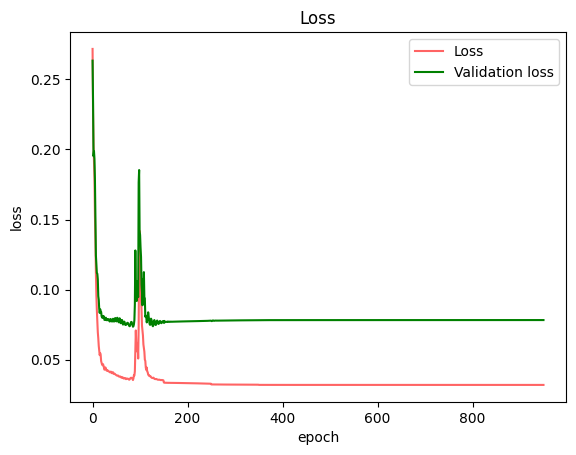

step 1, accuracy_train:0.484375, loss: 0.2655936885530672
step 2, accuracy_train:0.6375, loss: 0.21852133794033501
step 3, accuracy_train:0.740625, loss: 0.1987885649609977
step 4, accuracy_train:0.765625, loss: 0.17980002098930184
step 5, accuracy_train:0.8375, loss: 0.14687545026437246
step 6, accuracy_train:0.834375, loss: 0.13495543536045934
step 7, accuracy_train:0.85, loss: 0.11709084957166115
step 8, accuracy_train:0.9, loss: 0.09002056881836717
step 9, accuracy_train:0.915625, loss: 0.08854394804992943
step 10, accuracy_train:0.90625, loss: 0.0878585452580167
step 11, accuracy_train:0.921875, loss: 0.09114495663329023
step 12, accuracy_train:0.934375, loss: 0.07779365481529618
step 13, accuracy_train:0.91875, loss: 0.069711045979682
step 14, accuracy_train:0.934375, loss: 0.06563945614986812
step 15, accuracy_train:0.928125, loss: 0.06075966867066811
step 16, accuracy_train:0.946875, loss: 0.054940946540637164
step 17, accuracy_train:0.928125, loss: 0.0584954245598458
step 18, 

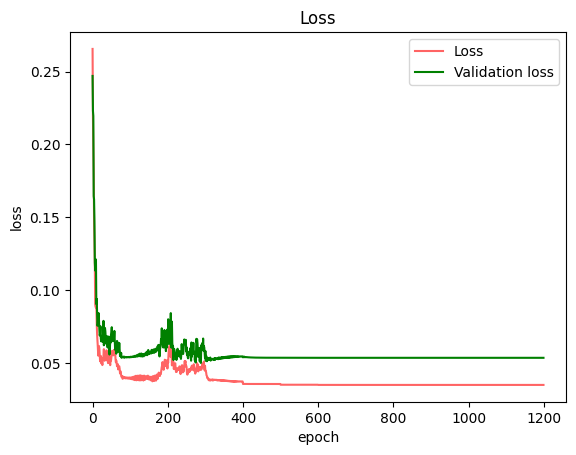

step 1, accuracy_train:0.46875, loss: 0.2740513423315347
step 2, accuracy_train:0.653125, loss: 0.21816610323587968
step 3, accuracy_train:0.69375, loss: 0.21274632816182115
step 4, accuracy_train:0.715625, loss: 0.19550385039249218
step 5, accuracy_train:0.765625, loss: 0.18229366028355481
step 6, accuracy_train:0.778125, loss: 0.1780284152778196
step 7, accuracy_train:0.790625, loss: 0.16827655442134695
step 8, accuracy_train:0.825, loss: 0.15911253937067776
step 9, accuracy_train:0.875, loss: 0.15527445863478
step 10, accuracy_train:0.878125, loss: 0.1341063348871978
step 11, accuracy_train:0.896875, loss: 0.12808332613057827
step 12, accuracy_train:0.890625, loss: 0.11529543128888924
step 13, accuracy_train:0.890625, loss: 0.11207371412595744
step 14, accuracy_train:0.90625, loss: 0.0972747093028219
step 15, accuracy_train:0.91875, loss: 0.09091571060345574
step 16, accuracy_train:0.928125, loss: 0.08617371760936554
step 17, accuracy_train:0.940625, loss: 0.07514199966382315
step 1

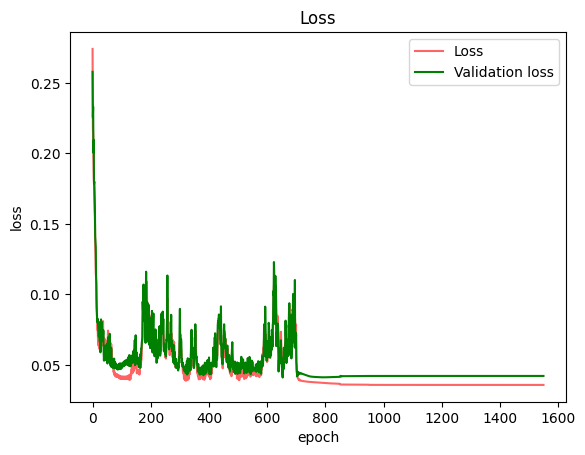

step 1, accuracy_train:0.44375, loss: 0.2918403808024544
step 2, accuracy_train:0.615625, loss: 0.2358541905644001
step 3, accuracy_train:0.65, loss: 0.21934177106382596
step 4, accuracy_train:0.671875, loss: 0.21918357971750277
step 5, accuracy_train:0.69375, loss: 0.20474290723569302
step 6, accuracy_train:0.778125, loss: 0.18205812837672433
step 7, accuracy_train:0.79375, loss: 0.16440324904514658
step 8, accuracy_train:0.853125, loss: 0.1530363047375473
step 9, accuracy_train:0.821875, loss: 0.1434589827340576
step 10, accuracy_train:0.85625, loss: 0.13111586994608754
step 11, accuracy_train:0.878125, loss: 0.12423968755835887
step 12, accuracy_train:0.890625, loss: 0.1119278469843277
step 13, accuracy_train:0.8875, loss: 0.10842443234888616
step 14, accuracy_train:0.9125, loss: 0.11324809108492936
step 15, accuracy_train:0.928125, loss: 0.08422937176698551
step 16, accuracy_train:0.921875, loss: 0.07692993678835384
step 17, accuracy_train:0.93125, loss: 0.07607275926478195
step 18

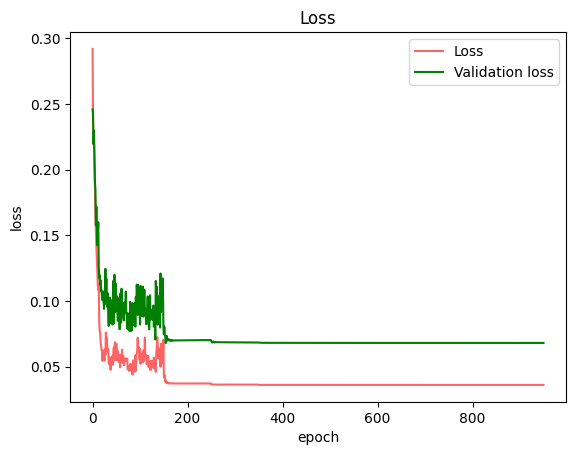

cv_time ：141.132061 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 100, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.45625, loss: 0.2732765478528
step 2, accuracy_train:0.5625, loss: 0.22263656143333804
step 3, accuracy_train:0.709375, loss: 0.19538228759655893
step 4, accuracy_train:0.696875, loss: 0.18038589681424927
step 5, accuracy_train:0.796875, loss: 0.16698338227449164
step 6, accuracy_train:0.815625, loss: 0.16546727036471917
step 7, accuracy_train:0.825, loss: 0.14805517482409825
step 8, accuracy_train:0.834375, loss: 0.1360195156341205
step 9, accuracy_train:0.846875, loss: 0.12603734148255968
step 10, accuracy_train:0.9, loss: 0.107128380635196
step 11, accuracy_train:0.909375, loss: 0.1046833916196911
step 12, accuracy_train:0.903125, loss: 0.09313763763939348
step 13, accuracy_train:0.8875, loss: 0.09068044997838405
step 14, accuracy_train:0.90625, loss: 0.08489785568893553
step 15, accuracy_train:0.9, loss: 0.08236655636166215
step 16, accuracy_train:0.9, loss: 0.078780

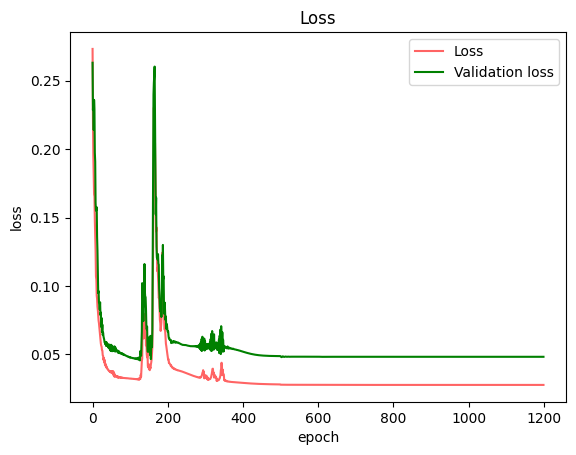

step 1, accuracy_train:0.48125, loss: 0.2688367231860849
step 2, accuracy_train:0.465625, loss: 0.23126578907847056
step 3, accuracy_train:0.55, loss: 0.2213827288874497
step 4, accuracy_train:0.584375, loss: 0.19465599902494113
step 5, accuracy_train:0.653125, loss: 0.18707527371272192
step 6, accuracy_train:0.725, loss: 0.16667067177341596
step 7, accuracy_train:0.73125, loss: 0.15976791378047706
step 8, accuracy_train:0.725, loss: 0.16462242609093
step 9, accuracy_train:0.725, loss: 0.14604681165327907
step 10, accuracy_train:0.78125, loss: 0.13157980854918006
step 11, accuracy_train:0.834375, loss: 0.12182249974134614
step 12, accuracy_train:0.890625, loss: 0.11664158820654483
step 13, accuracy_train:0.8875, loss: 0.10828748709730168
step 14, accuracy_train:0.89375, loss: 0.100457639597929
step 15, accuracy_train:0.903125, loss: 0.09400260721540883
step 16, accuracy_train:0.909375, loss: 0.08660347057467488
step 17, accuracy_train:0.90625, loss: 0.08116470774522869
step 18, accurac

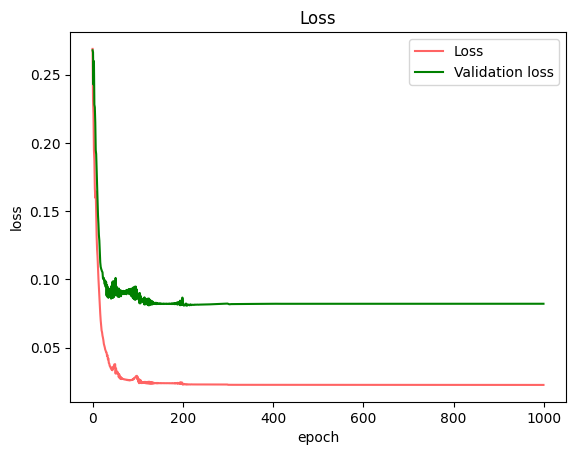

step 1, accuracy_train:0.478125, loss: 0.26415289516861995
step 2, accuracy_train:0.64375, loss: 0.2167219179994801
step 3, accuracy_train:0.6, loss: 0.1999075859182965
step 4, accuracy_train:0.746875, loss: 0.18256020776930654
step 5, accuracy_train:0.753125, loss: 0.1794328439232785
step 6, accuracy_train:0.746875, loss: 0.1848696829864218
step 7, accuracy_train:0.81875, loss: 0.15249895137572264
step 8, accuracy_train:0.853125, loss: 0.13162300053291254
step 9, accuracy_train:0.871875, loss: 0.1165950768931509
step 10, accuracy_train:0.86875, loss: 0.11631241949572685
step 11, accuracy_train:0.8875, loss: 0.10180566925520425
step 12, accuracy_train:0.890625, loss: 0.09036184179223873
step 13, accuracy_train:0.890625, loss: 0.08886069108807268
step 14, accuracy_train:0.903125, loss: 0.07695623366608176
step 15, accuracy_train:0.9, loss: 0.07004228230490028
step 16, accuracy_train:0.9125, loss: 0.06556158563216509
step 17, accuracy_train:0.903125, loss: 0.06602627659038622
step 18, ac

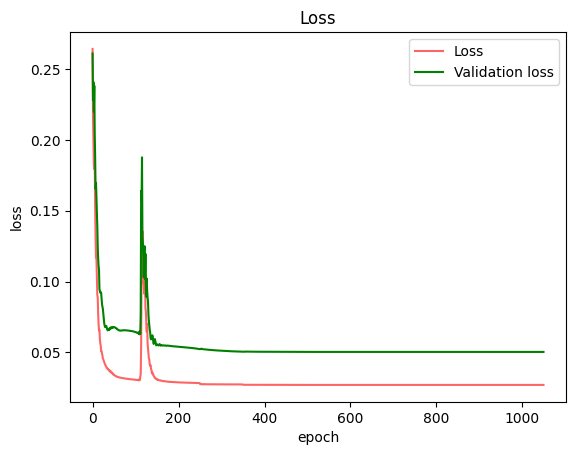

step 1, accuracy_train:0.453125, loss: 0.2706280750189738
step 2, accuracy_train:0.4625, loss: 0.2184015163489791
step 3, accuracy_train:0.621875, loss: 0.19436653906033619
step 4, accuracy_train:0.71875, loss: 0.1866094253234522
step 5, accuracy_train:0.734375, loss: 0.18173729975622158
step 6, accuracy_train:0.8, loss: 0.14085629812590633
step 7, accuracy_train:0.834375, loss: 0.14338083515721914
step 8, accuracy_train:0.84375, loss: 0.12677557947944762
step 9, accuracy_train:0.871875, loss: 0.11065897011585854
step 10, accuracy_train:0.85625, loss: 0.11257927117542701
step 11, accuracy_train:0.884375, loss: 0.10105081785463543
step 12, accuracy_train:0.89375, loss: 0.09528400486895382
step 13, accuracy_train:0.88125, loss: 0.0905276596777484
step 14, accuracy_train:0.884375, loss: 0.08339908061610773
step 15, accuracy_train:0.8875, loss: 0.08170585391994309
step 16, accuracy_train:0.890625, loss: 0.07590497984927605
step 17, accuracy_train:0.896875, loss: 0.06991617866038824
step 18

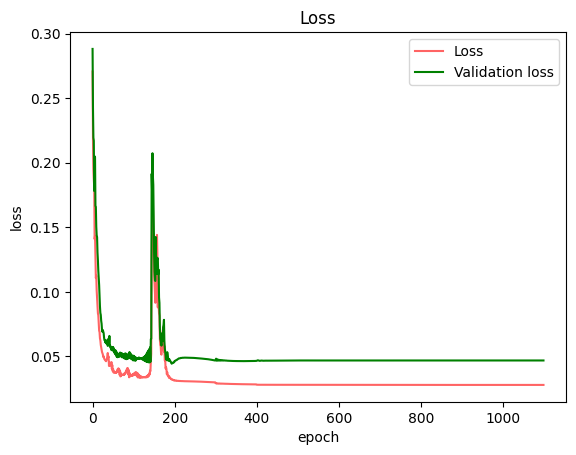

step 1, accuracy_train:0.4625, loss: 0.28969762223591444
step 2, accuracy_train:0.4625, loss: 0.258368586644789
step 3, accuracy_train:0.646875, loss: 0.21434553491011651
step 4, accuracy_train:0.653125, loss: 0.20241838887164432
step 5, accuracy_train:0.71875, loss: 0.19587183786672352
step 6, accuracy_train:0.796875, loss: 0.16361778985815403
step 7, accuracy_train:0.78125, loss: 0.15473207715759446
step 8, accuracy_train:0.815625, loss: 0.13405249146525
step 9, accuracy_train:0.796875, loss: 0.11815164563346309
step 10, accuracy_train:0.85625, loss: 0.1022761097466395
step 11, accuracy_train:0.83125, loss: 0.09877743484461744
step 12, accuracy_train:0.86875, loss: 0.09209554388127197
step 13, accuracy_train:0.85625, loss: 0.09205251451343166
step 14, accuracy_train:0.878125, loss: 0.08486843628048316
step 15, accuracy_train:0.890625, loss: 0.0783576267959639
step 16, accuracy_train:0.9, loss: 0.07403985074531859
step 17, accuracy_train:0.896875, loss: 0.07070678920584922
step 18, ac

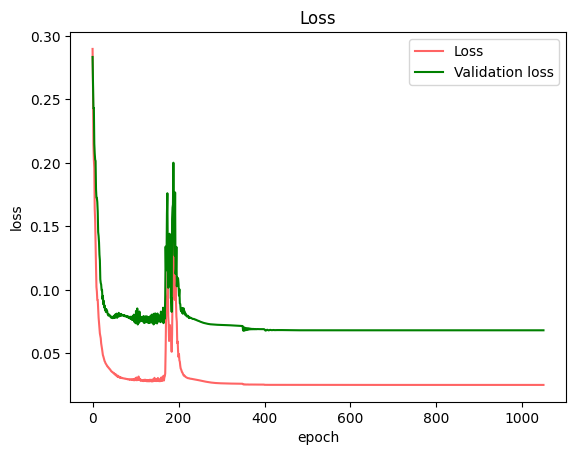

cv_time ：112.511991 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 300, 50, [0.05, 0.03, 0.01]]


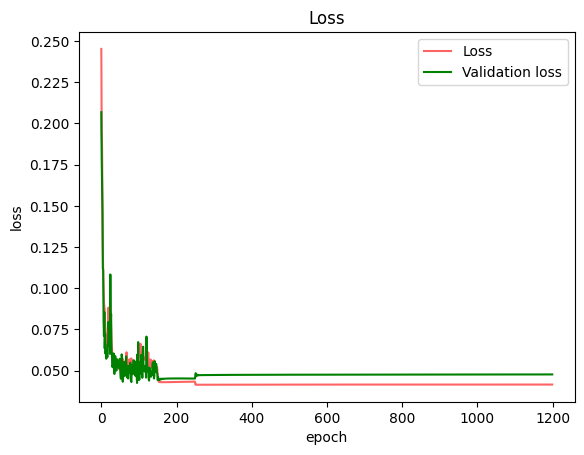

circuit is jitted
circuit is jitted
circuit is jitted
circuit is jitted
step 1, accuracy_train:0.559375, loss: 0.2574272852586131
circuit is jitted
circuit is jitted
step 2, accuracy_train:0.56875, loss: 0.23509410111937337
step 3, accuracy_train:0.64375, loss: 0.2318617646809568
step 4, accuracy_train:0.61875, loss: 0.22938877900572585
step 5, accuracy_train:0.625, loss: 0.22544678565603463
step 6, accuracy_train:0.721875, loss: 0.21085214863135607
step 7, accuracy_train:0.678125, loss: 0.2062313718630283
step 8, accuracy_train:0.75625, loss: 0.19848809791489436
step 9, accuracy_train:0.734375, loss: 0.20292600880860026
step 10, accuracy_train:0.775, loss: 0.20147749626870554
step 11, accuracy_train:0.803125, loss: 0.19634597275296956
step 12, accuracy_train:0.834375, loss: 0.18065303492855217
step 13, accuracy_train:0.834375, loss: 0.17036998041636464
step 14, accuracy_train:0.828125, loss: 0.16818011799504182
step 15, accuracy_train:0.815625, loss: 0.16010500320083576
step 16, accur

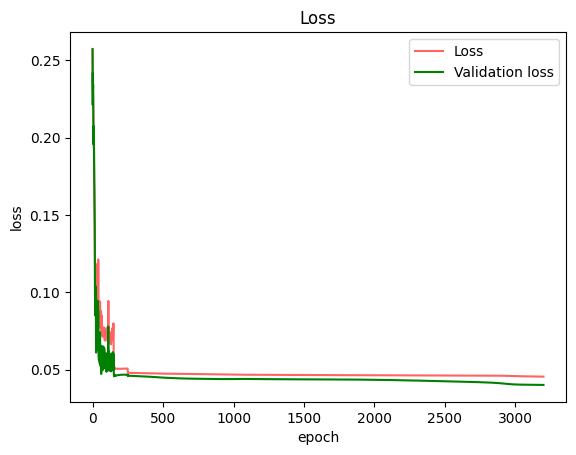

step 1, accuracy_train:0.6375, loss: 0.2522738190959038
step 2, accuracy_train:0.634375, loss: 0.231018070829628
step 3, accuracy_train:0.69375, loss: 0.21926351007764286
step 4, accuracy_train:0.7875, loss: 0.1905324783801067
step 5, accuracy_train:0.809375, loss: 0.15785151586013527
step 6, accuracy_train:0.83125, loss: 0.1528544369520686
step 7, accuracy_train:0.859375, loss: 0.13197050958201254
step 8, accuracy_train:0.89375, loss: 0.12618598116053217
step 9, accuracy_train:0.896875, loss: 0.11548582767290276
step 10, accuracy_train:0.909375, loss: 0.09771508729370251
step 11, accuracy_train:0.903125, loss: 0.09436956812021986
step 12, accuracy_train:0.88125, loss: 0.09904469964289721
step 13, accuracy_train:0.915625, loss: 0.09421617251489336
step 14, accuracy_train:0.91875, loss: 0.08968641377091513
step 15, accuracy_train:0.928125, loss: 0.09504694317616573
step 16, accuracy_train:0.909375, loss: 0.09387284241657169
step 17, accuracy_train:0.9, loss: 0.08654652251953142
step 18,

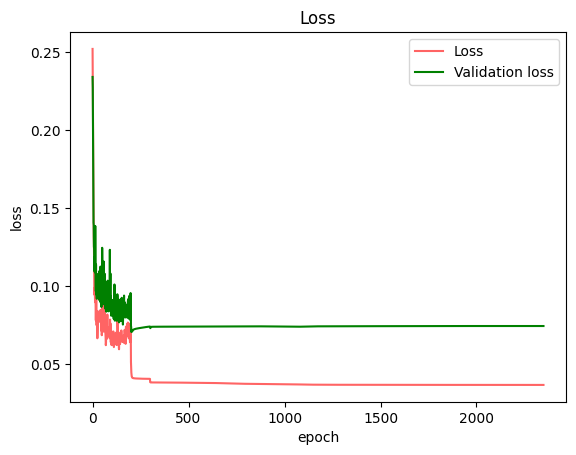

step 1, accuracy_train:0.6, loss: 0.2518754293867238
step 2, accuracy_train:0.640625, loss: 0.2305173586592706
step 3, accuracy_train:0.6875, loss: 0.223706827500615
step 4, accuracy_train:0.7125, loss: 0.21183520604949196
step 5, accuracy_train:0.746875, loss: 0.20088300508114026
step 6, accuracy_train:0.715625, loss: 0.20109181703892942
step 7, accuracy_train:0.7875, loss: 0.1806720131278808
step 8, accuracy_train:0.825, loss: 0.16979759090059865
step 9, accuracy_train:0.834375, loss: 0.15653532312544474
step 10, accuracy_train:0.8625, loss: 0.14139246298385594
step 11, accuracy_train:0.896875, loss: 0.12488139715231844
step 12, accuracy_train:0.88125, loss: 0.12299261389399371
step 13, accuracy_train:0.903125, loss: 0.11961175757627886
step 14, accuracy_train:0.909375, loss: 0.10801196139884814
step 15, accuracy_train:0.921875, loss: 0.10690389646901959
step 16, accuracy_train:0.903125, loss: 0.10118225702797247
step 17, accuracy_train:0.928125, loss: 0.09373736946469216
step 18, ac

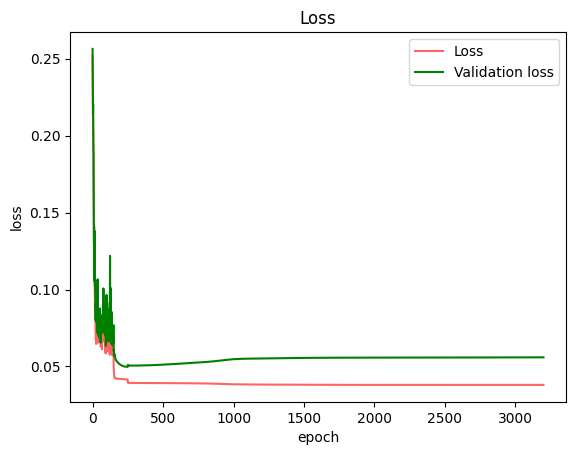

step 1, accuracy_train:0.56875, loss: 0.2539692339526212
step 2, accuracy_train:0.678125, loss: 0.2364494068770336
step 3, accuracy_train:0.696875, loss: 0.21806925008606165
step 4, accuracy_train:0.7, loss: 0.21790309629657
step 5, accuracy_train:0.640625, loss: 0.22008800549385688
step 6, accuracy_train:0.7, loss: 0.2135949664743058
step 7, accuracy_train:0.73125, loss: 0.2049329935205737
step 8, accuracy_train:0.765625, loss: 0.1909955190724755
step 9, accuracy_train:0.76875, loss: 0.18381697195472518
step 10, accuracy_train:0.853125, loss: 0.16373173419960937
step 11, accuracy_train:0.86875, loss: 0.15305366416730262
step 12, accuracy_train:0.875, loss: 0.1421678279793128
step 13, accuracy_train:0.896875, loss: 0.13568676840471006
step 14, accuracy_train:0.9, loss: 0.12511238698151655
step 15, accuracy_train:0.909375, loss: 0.1197311534768007
step 16, accuracy_train:0.9, loss: 0.1220817984072426
step 17, accuracy_train:0.91875, loss: 0.11062903292012391
step 18, accuracy_train:0.90

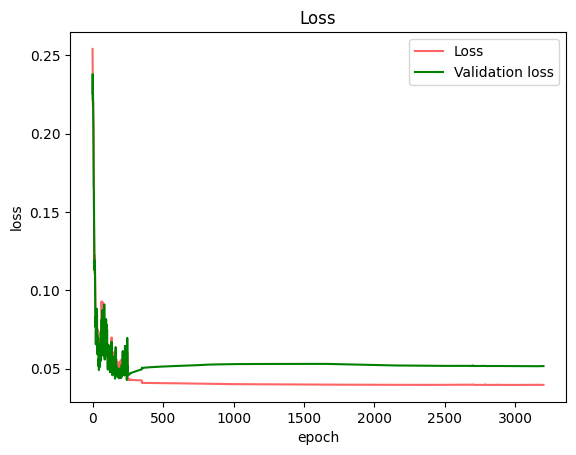

step 1, accuracy_train:0.56875, loss: 0.25605575763232064
step 2, accuracy_train:0.684375, loss: 0.22644402869544195
step 3, accuracy_train:0.709375, loss: 0.21960541684569876
step 4, accuracy_train:0.728125, loss: 0.21191662990198268
step 5, accuracy_train:0.740625, loss: 0.20169938960773165
step 6, accuracy_train:0.784375, loss: 0.19422771836594982
step 7, accuracy_train:0.746875, loss: 0.19523772448008198
step 8, accuracy_train:0.778125, loss: 0.18808846462904116
step 9, accuracy_train:0.790625, loss: 0.18317919929091975
step 10, accuracy_train:0.790625, loss: 0.1844648465828545
step 11, accuracy_train:0.8375, loss: 0.1708320517932783
step 12, accuracy_train:0.846875, loss: 0.16306380003624235
step 13, accuracy_train:0.890625, loss: 0.14701890046198715
step 14, accuracy_train:0.88125, loss: 0.13276317390560824
step 15, accuracy_train:0.9, loss: 0.11872090800995978
step 16, accuracy_train:0.89375, loss: 0.11841824324290347
step 17, accuracy_train:0.896875, loss: 0.11343999272000495
s

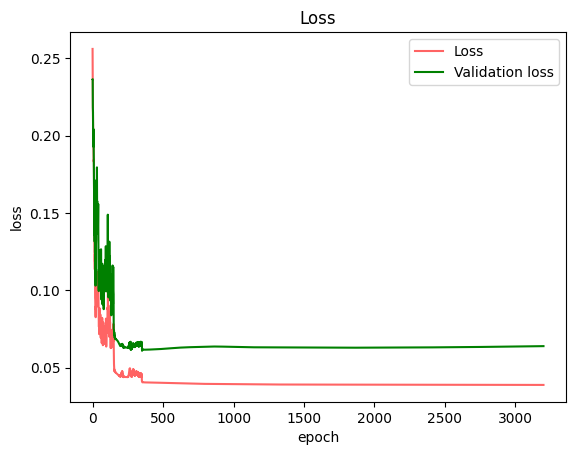

cv_time ：876.608969 s
[[0.15, 0.05, 0.01], 3200, 50, 50, [0.05, 0.03, 0.01]]
circuit is jitted
circuit is jitted
step 1, accuracy_train:0.578125, loss: 0.2766327373923395
step 2, accuracy_train:0.628125, loss: 0.21476085851706397
step 3, accuracy_train:0.6875, loss: 0.2154341568415729
step 4, accuracy_train:0.69375, loss: 0.21877026401084568
step 5, accuracy_train:0.703125, loss: 0.19632248724321477
step 6, accuracy_train:0.825, loss: 0.18025802267987812
step 7, accuracy_train:0.821875, loss: 0.17206182039382423
step 8, accuracy_train:0.8375, loss: 0.1669085502435273
step 9, accuracy_train:0.865625, loss: 0.14278796434103375
step 10, accuracy_train:0.88125, loss: 0.13504176073332544
step 11, accuracy_train:0.896875, loss: 0.12649807753177927
step 12, accuracy_train:0.89375, loss: 0.12154475574323263
step 13, accuracy_train:0.903125, loss: 0.11307775826663263
step 14, accuracy_train:0.8875, loss: 0.10728647692609822
step 15, accuracy_train:0.903125, loss: 0.098906098298483
step 16, accu

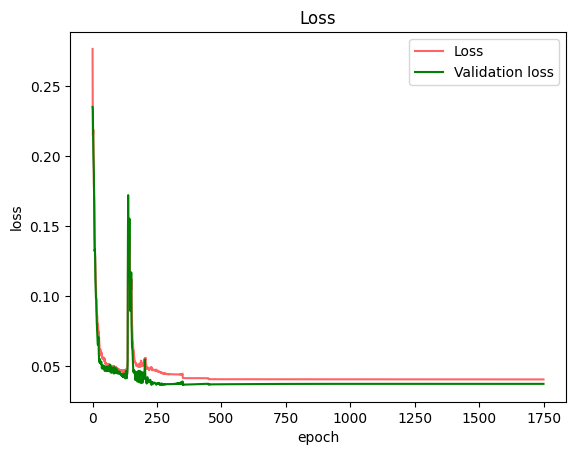

step 1, accuracy_train:0.59375, loss: 0.27085426453113026
step 2, accuracy_train:0.675, loss: 0.21081960120694265
step 3, accuracy_train:0.7625, loss: 0.20078438627330447
step 4, accuracy_train:0.7625, loss: 0.19493819605543217
step 5, accuracy_train:0.840625, loss: 0.17859163404911374
step 6, accuracy_train:0.890625, loss: 0.15361218471461996
step 7, accuracy_train:0.8875, loss: 0.14324377167977564
step 8, accuracy_train:0.896875, loss: 0.12625296864466307
step 9, accuracy_train:0.928125, loss: 0.11389117499759585
step 10, accuracy_train:0.9125, loss: 0.1072587763886006
step 11, accuracy_train:0.934375, loss: 0.09574636505983997
step 12, accuracy_train:0.9375, loss: 0.0856587204587368
step 13, accuracy_train:0.915625, loss: 0.08130703015737903
step 14, accuracy_train:0.91875, loss: 0.08165620288697689
step 15, accuracy_train:0.921875, loss: 0.07553589495795235
step 16, accuracy_train:0.915625, loss: 0.06617884653701964
step 17, accuracy_train:0.928125, loss: 0.06562418051467353
step 1

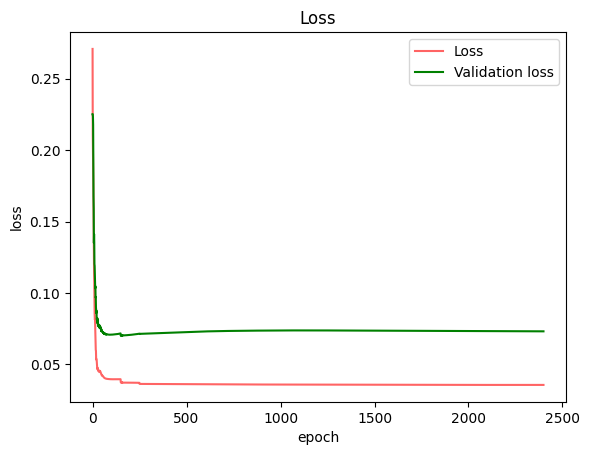

step 1, accuracy_train:0.5125, loss: 0.279391507488965
step 2, accuracy_train:0.65, loss: 0.2085935141547813
step 3, accuracy_train:0.70625, loss: 0.20739781958224507
step 4, accuracy_train:0.6625, loss: 0.20942344638733795
step 5, accuracy_train:0.75625, loss: 0.19799049941134939
step 6, accuracy_train:0.8125, loss: 0.1822382098228295
step 7, accuracy_train:0.803125, loss: 0.1761900956354239
step 8, accuracy_train:0.8375, loss: 0.16450134438001957
step 9, accuracy_train:0.878125, loss: 0.15689432037566553
step 10, accuracy_train:0.85625, loss: 0.1542334820144885
step 11, accuracy_train:0.875, loss: 0.14846082741320232
step 12, accuracy_train:0.871875, loss: 0.14503898214224584
step 13, accuracy_train:0.903125, loss: 0.14374909232902772
step 14, accuracy_train:0.896875, loss: 0.13614630366706412
step 15, accuracy_train:0.8875, loss: 0.1316209928204739
step 16, accuracy_train:0.90625, loss: 0.13136844197940875
step 17, accuracy_train:0.90625, loss: 0.1254959744684993
step 18, accuracy_t

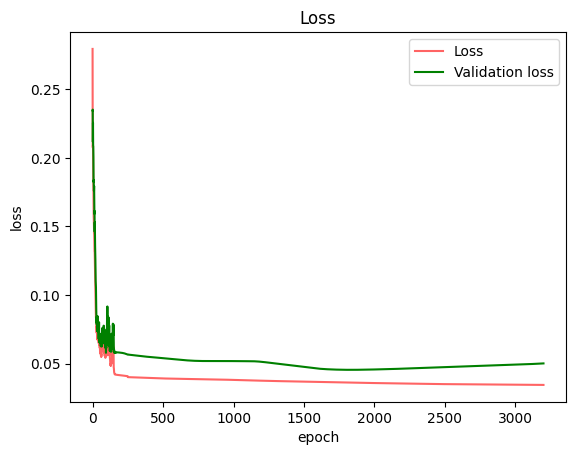

step 1, accuracy_train:0.459375, loss: 0.2828522669767253
step 2, accuracy_train:0.590625, loss: 0.21880941764876283
step 3, accuracy_train:0.671875, loss: 0.2265542956442649
step 4, accuracy_train:0.715625, loss: 0.21905936767343254
step 5, accuracy_train:0.7375, loss: 0.20414878508782064
step 6, accuracy_train:0.75625, loss: 0.19872192642213526
step 7, accuracy_train:0.759375, loss: 0.18993285709312818
step 8, accuracy_train:0.771875, loss: 0.1758285887441811
step 9, accuracy_train:0.834375, loss: 0.16579348826490115
step 10, accuracy_train:0.840625, loss: 0.16107123323895242
step 11, accuracy_train:0.84375, loss: 0.15155275930711287
step 12, accuracy_train:0.859375, loss: 0.14335530426190152
step 13, accuracy_train:0.8875, loss: 0.13389424924842008
step 14, accuracy_train:0.884375, loss: 0.12270560400776628
step 15, accuracy_train:0.89375, loss: 0.1145780641875205
step 16, accuracy_train:0.9, loss: 0.10365941153163333
step 17, accuracy_train:0.8875, loss: 0.10200455752836446
step 18

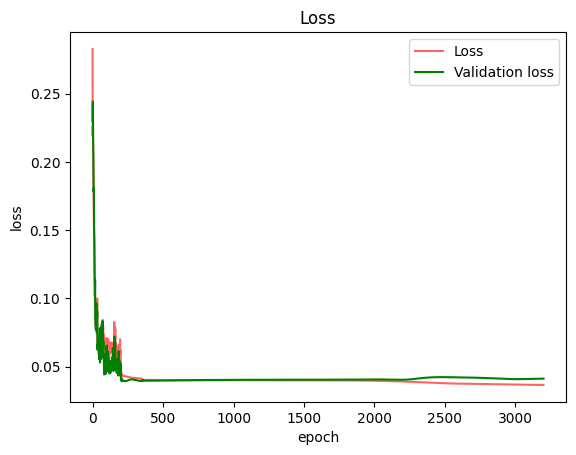

step 1, accuracy_train:0.503125, loss: 0.2806364633530879
step 2, accuracy_train:0.55625, loss: 0.23903439232991064
step 3, accuracy_train:0.615625, loss: 0.2329163668242798
step 4, accuracy_train:0.69375, loss: 0.22006457350647868
step 5, accuracy_train:0.68125, loss: 0.21399668193582944
step 6, accuracy_train:0.73125, loss: 0.202972936575803
step 7, accuracy_train:0.746875, loss: 0.18917110056417968
step 8, accuracy_train:0.815625, loss: 0.16778902613437838
step 9, accuracy_train:0.840625, loss: 0.158855589808069
step 10, accuracy_train:0.8625, loss: 0.15330164694423587
step 11, accuracy_train:0.884375, loss: 0.13656842916087106
step 12, accuracy_train:0.878125, loss: 0.13492057299344185
step 13, accuracy_train:0.878125, loss: 0.12411944054677727
step 14, accuracy_train:0.91875, loss: 0.10074341658379514
step 15, accuracy_train:0.9125, loss: 0.09782445062397435
step 16, accuracy_train:0.91875, loss: 0.09468361459201233
step 17, accuracy_train:0.91875, loss: 0.09105723522720555
step 1

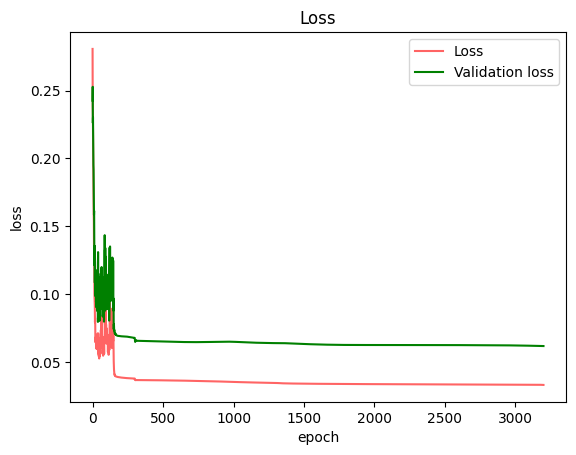

cv_time ：565.641025 s
[[0.15, 0.05, 0.01], 3200, 100, 50, [0.05, 0.03, 0.01]]
circuit is jitted
circuit is jitted
step 1, accuracy_train:0.50625, loss: 0.3085359160777735
step 2, accuracy_train:0.721875, loss: 0.21927544329303283
step 3, accuracy_train:0.659375, loss: 0.2004885957006753
step 4, accuracy_train:0.7375, loss: 0.18371082616461057
step 5, accuracy_train:0.746875, loss: 0.17756525060535885
step 6, accuracy_train:0.771875, loss: 0.1711518647950531
step 7, accuracy_train:0.825, loss: 0.1678658713861937
step 8, accuracy_train:0.815625, loss: 0.15995928798467826
step 9, accuracy_train:0.8625, loss: 0.14846373219450848
step 10, accuracy_train:0.878125, loss: 0.13460295985632198
step 11, accuracy_train:0.871875, loss: 0.12429214345677421
step 12, accuracy_train:0.875, loss: 0.12144977096691173
step 13, accuracy_train:0.890625, loss: 0.11598161393405833
step 14, accuracy_train:0.871875, loss: 0.11029123574542962
step 15, accuracy_train:0.878125, loss: 0.10476149655609493
step 16, a

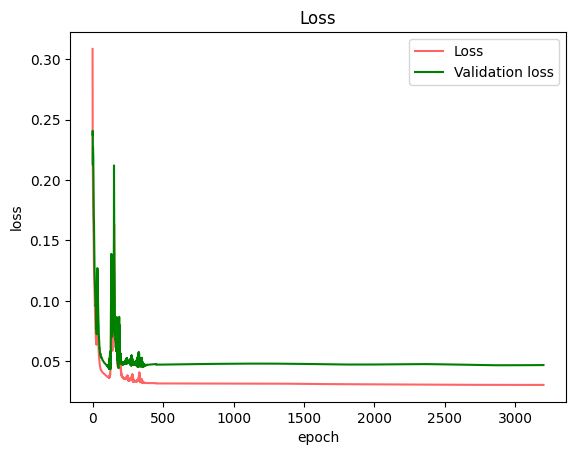

step 1, accuracy_train:0.496875, loss: 0.3052115906943395
step 2, accuracy_train:0.540625, loss: 0.23581724581002572
step 3, accuracy_train:0.6875, loss: 0.19215599619877727
step 4, accuracy_train:0.74375, loss: 0.17272247765671575
step 5, accuracy_train:0.771875, loss: 0.1715095714467874
step 6, accuracy_train:0.7625, loss: 0.16648953002590466
step 7, accuracy_train:0.8, loss: 0.16048953317189377
step 8, accuracy_train:0.865625, loss: 0.1522385401338841
step 9, accuracy_train:0.84375, loss: 0.1388780861897931
step 10, accuracy_train:0.84375, loss: 0.13198793968151187
step 11, accuracy_train:0.86875, loss: 0.1244550966905715
step 12, accuracy_train:0.8875, loss: 0.11472802333331314
step 13, accuracy_train:0.903125, loss: 0.1096782390260572
step 14, accuracy_train:0.915625, loss: 0.10191049974710656
step 15, accuracy_train:0.928125, loss: 0.09489233803256686
step 16, accuracy_train:0.9, loss: 0.08781722423143579
step 17, accuracy_train:0.925, loss: 0.07948243910529425
step 18, accuracy_

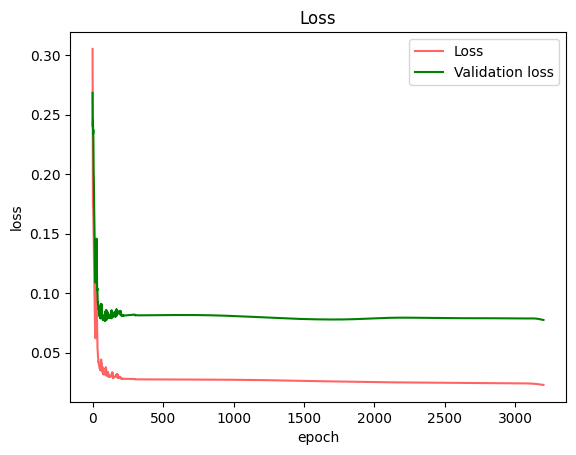

step 1, accuracy_train:0.5125, loss: 0.3161457977098737
step 2, accuracy_train:0.634375, loss: 0.23607200618974572
step 3, accuracy_train:0.64375, loss: 0.1874283555794552
step 4, accuracy_train:0.809375, loss: 0.1711831903498598
step 5, accuracy_train:0.784375, loss: 0.16503598342814324
step 6, accuracy_train:0.825, loss: 0.1604291660383424
step 7, accuracy_train:0.83125, loss: 0.1543949408211074
step 8, accuracy_train:0.775, loss: 0.1518930747339402
step 9, accuracy_train:0.803125, loss: 0.1460845328018894
step 10, accuracy_train:0.784375, loss: 0.13442824538500273
step 11, accuracy_train:0.846875, loss: 0.12394236107168852
step 12, accuracy_train:0.88125, loss: 0.12322243307862696
step 13, accuracy_train:0.8875, loss: 0.11564624698742351
step 14, accuracy_train:0.9, loss: 0.109536067958331
step 15, accuracy_train:0.909375, loss: 0.10268294601633364
step 16, accuracy_train:0.90625, loss: 0.09777778999972796
step 17, accuracy_train:0.90625, loss: 0.09471860451445704
step 18, accuracy_

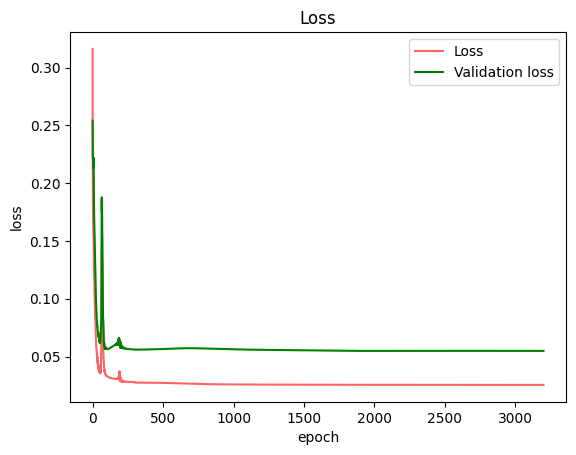

step 1, accuracy_train:0.509375, loss: 0.31501080039563045
step 2, accuracy_train:0.640625, loss: 0.22410343435897762
step 3, accuracy_train:0.675, loss: 0.19242481008383094
step 4, accuracy_train:0.70625, loss: 0.18213721666551255
step 5, accuracy_train:0.78125, loss: 0.18317701898913558
step 6, accuracy_train:0.778125, loss: 0.17880014371838943
step 7, accuracy_train:0.76875, loss: 0.16191000477672166
step 8, accuracy_train:0.778125, loss: 0.16088716151715865
step 9, accuracy_train:0.834375, loss: 0.14979823431229472
step 10, accuracy_train:0.825, loss: 0.14218729990045847
step 11, accuracy_train:0.834375, loss: 0.13307868651335802
step 12, accuracy_train:0.86875, loss: 0.1274872209516365
step 13, accuracy_train:0.878125, loss: 0.1154889810914268
step 14, accuracy_train:0.859375, loss: 0.11120692758857631
step 15, accuracy_train:0.884375, loss: 0.10894078782597891
step 16, accuracy_train:0.90625, loss: 0.10468874814730719
step 17, accuracy_train:0.890625, loss: 0.10158135162791702
st

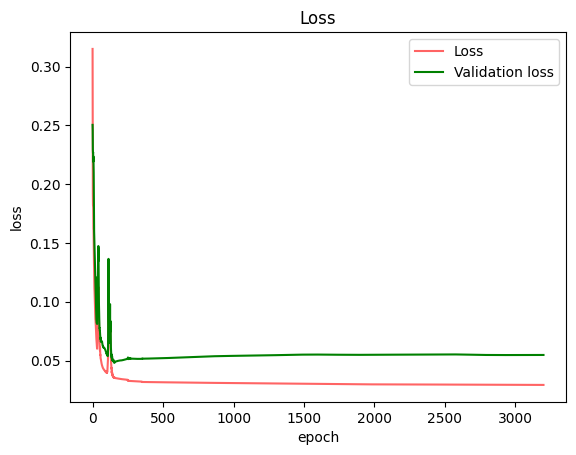

step 1, accuracy_train:0.515625, loss: 0.307682062749718
step 2, accuracy_train:0.54375, loss: 0.23921451797053944
step 3, accuracy_train:0.671875, loss: 0.20875395018515752
step 4, accuracy_train:0.715625, loss: 0.19325770703896322
step 5, accuracy_train:0.709375, loss: 0.19111695418749547
step 6, accuracy_train:0.76875, loss: 0.17853181454800487
step 7, accuracy_train:0.80625, loss: 0.1751704708027104
step 8, accuracy_train:0.853125, loss: 0.15110546990307105
step 9, accuracy_train:0.86875, loss: 0.12876668001459568
step 10, accuracy_train:0.890625, loss: 0.12038477009174318
step 11, accuracy_train:0.903125, loss: 0.1095793071770039
step 12, accuracy_train:0.903125, loss: 0.10014862078870893
step 13, accuracy_train:0.884375, loss: 0.0942833826217869
step 14, accuracy_train:0.89375, loss: 0.08500945867594728
step 15, accuracy_train:0.89375, loss: 0.07793622138942602
step 16, accuracy_train:0.9125, loss: 0.07431576835724531
step 17, accuracy_train:0.91875, loss: 0.0708382329417126
step

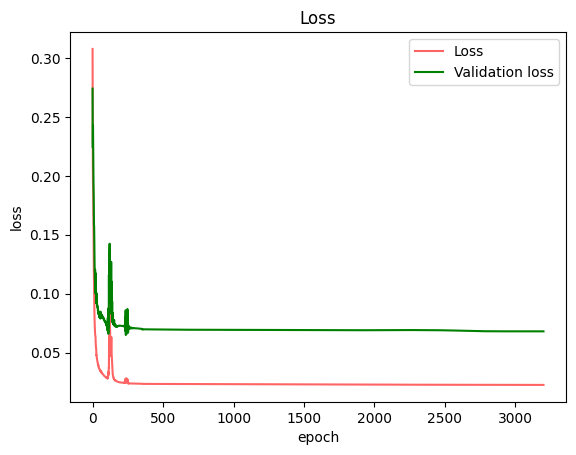

cv_time ：542.829014 s
[[0.15, 0.05, 0.01], 3200, 300, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.559375, loss: 0.2574272852586131
step 2, accuracy_train:0.56875, loss: 0.23509410111937337
step 3, accuracy_train:0.64375, loss: 0.2318617646809568
step 4, accuracy_train:0.61875, loss: 0.22938877900572585
step 5, accuracy_train:0.625, loss: 0.22544678565603463
step 6, accuracy_train:0.721875, loss: 0.21085214863135607
step 7, accuracy_train:0.678125, loss: 0.2062313718630283
step 8, accuracy_train:0.75625, loss: 0.19848809791489436
step 9, accuracy_train:0.734375, loss: 0.20292600880860026
step 10, accuracy_train:0.775, loss: 0.20147749626870554
step 11, accuracy_train:0.803125, loss: 0.19634597275296956
step 12, accuracy_train:0.834375, loss: 0.18065303492855217
step 13, accuracy_train:0.834375, loss: 0.17036998041636464
step 14, accuracy_train:0.828125, loss: 0.16818011799504182
step 15, accuracy_train:0.815625, loss: 0.16010500320083576
step 16, accuracy_train:0.871875, loss: 0.14

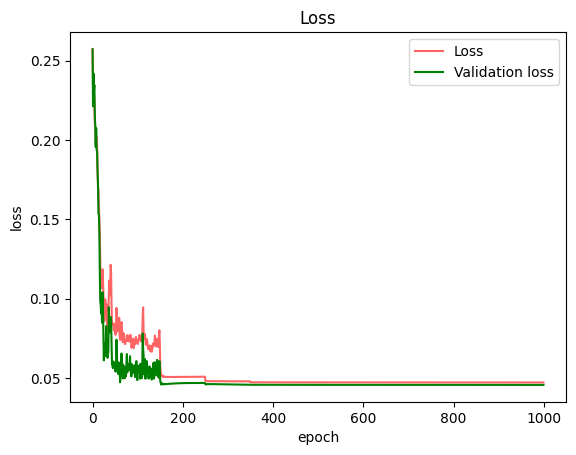

step 1, accuracy_train:0.6375, loss: 0.2522738190959038
step 2, accuracy_train:0.634375, loss: 0.231018070829628
step 3, accuracy_train:0.69375, loss: 0.21926351007764286
step 4, accuracy_train:0.7875, loss: 0.1905324783801067
step 5, accuracy_train:0.809375, loss: 0.15785151586013527
step 6, accuracy_train:0.83125, loss: 0.1528544369520686
step 7, accuracy_train:0.859375, loss: 0.13197050958201254
step 8, accuracy_train:0.89375, loss: 0.12618598116053217
step 9, accuracy_train:0.896875, loss: 0.11548582767290276
step 10, accuracy_train:0.909375, loss: 0.09771508729370251
step 11, accuracy_train:0.903125, loss: 0.09436956812021986
step 12, accuracy_train:0.88125, loss: 0.09904469964289721
step 13, accuracy_train:0.915625, loss: 0.09421617251489336
step 14, accuracy_train:0.91875, loss: 0.08968641377091513
step 15, accuracy_train:0.928125, loss: 0.09504694317616573
step 16, accuracy_train:0.909375, loss: 0.09387284241657169
step 17, accuracy_train:0.9, loss: 0.08654652251953142
step 18,

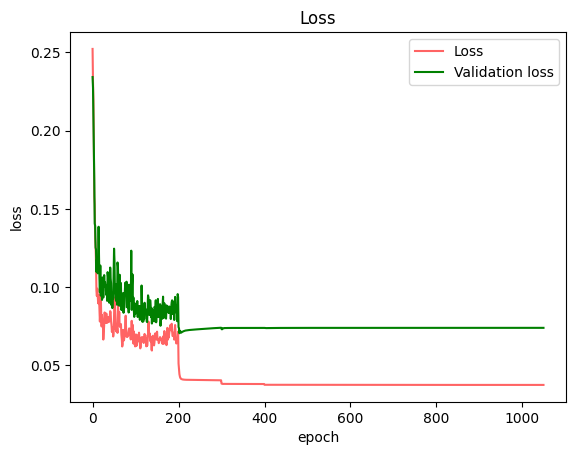

step 1, accuracy_train:0.6, loss: 0.2518754293867238
step 2, accuracy_train:0.640625, loss: 0.2305173586592706
step 3, accuracy_train:0.6875, loss: 0.223706827500615
step 4, accuracy_train:0.7125, loss: 0.21183520604949196
step 5, accuracy_train:0.746875, loss: 0.20088300508114026
step 6, accuracy_train:0.715625, loss: 0.20109181703892942
step 7, accuracy_train:0.7875, loss: 0.1806720131278808
step 8, accuracy_train:0.825, loss: 0.16979759090059865
step 9, accuracy_train:0.834375, loss: 0.15653532312544474
step 10, accuracy_train:0.8625, loss: 0.14139246298385594
step 11, accuracy_train:0.896875, loss: 0.12488139715231844
step 12, accuracy_train:0.88125, loss: 0.12299261389399371
step 13, accuracy_train:0.903125, loss: 0.11961175757627886
step 14, accuracy_train:0.909375, loss: 0.10801196139884814
step 15, accuracy_train:0.921875, loss: 0.10690389646901959
step 16, accuracy_train:0.903125, loss: 0.10118225702797247
step 17, accuracy_train:0.928125, loss: 0.09373736946469216
step 18, ac

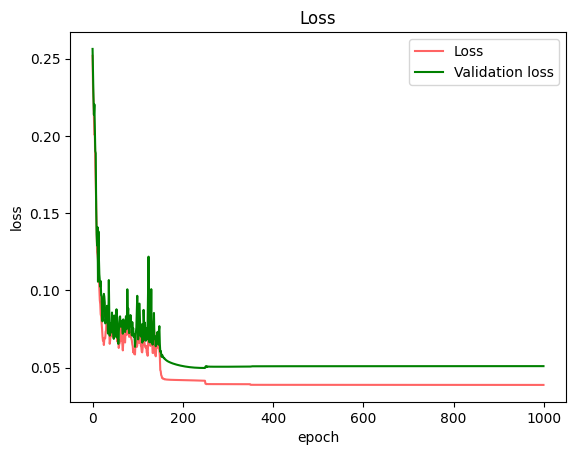

step 1, accuracy_train:0.56875, loss: 0.2539692339526212
step 2, accuracy_train:0.678125, loss: 0.2364494068770336
step 3, accuracy_train:0.696875, loss: 0.21806925008606165
step 4, accuracy_train:0.7, loss: 0.21790309629657
step 5, accuracy_train:0.640625, loss: 0.22008800549385688
step 6, accuracy_train:0.7, loss: 0.2135949664743058
step 7, accuracy_train:0.73125, loss: 0.2049329935205737
step 8, accuracy_train:0.765625, loss: 0.1909955190724755
step 9, accuracy_train:0.76875, loss: 0.18381697195472518
step 10, accuracy_train:0.853125, loss: 0.16373173419960937
step 11, accuracy_train:0.86875, loss: 0.15305366416730262
step 12, accuracy_train:0.875, loss: 0.1421678279793128
step 13, accuracy_train:0.896875, loss: 0.13568676840471006
step 14, accuracy_train:0.9, loss: 0.12511238698151655
step 15, accuracy_train:0.909375, loss: 0.1197311534768007
step 16, accuracy_train:0.9, loss: 0.1220817984072426
step 17, accuracy_train:0.91875, loss: 0.11062903292012391
step 18, accuracy_train:0.90

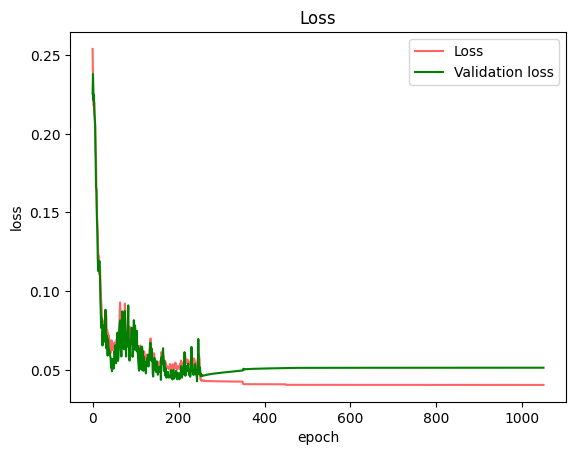

step 1, accuracy_train:0.56875, loss: 0.25605575763232064
step 2, accuracy_train:0.684375, loss: 0.22644402869544195
step 3, accuracy_train:0.709375, loss: 0.21960541684569876
step 4, accuracy_train:0.728125, loss: 0.21191662990198268
step 5, accuracy_train:0.740625, loss: 0.20169938960773165
step 6, accuracy_train:0.784375, loss: 0.19422771836594982
step 7, accuracy_train:0.746875, loss: 0.19523772448008198
step 8, accuracy_train:0.778125, loss: 0.18808846462904116
step 9, accuracy_train:0.790625, loss: 0.18317919929091975
step 10, accuracy_train:0.790625, loss: 0.1844648465828545
step 11, accuracy_train:0.8375, loss: 0.1708320517932783
step 12, accuracy_train:0.846875, loss: 0.16306380003624235
step 13, accuracy_train:0.890625, loss: 0.14701890046198715
step 14, accuracy_train:0.88125, loss: 0.13276317390560824
step 15, accuracy_train:0.9, loss: 0.11872090800995978
step 16, accuracy_train:0.89375, loss: 0.11841824324290347
step 17, accuracy_train:0.896875, loss: 0.11343999272000495
s

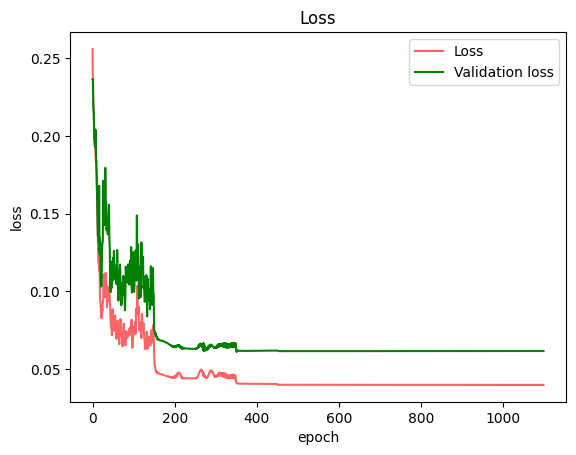

cv_time ：224.731765 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 50, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.578125, loss: 0.2766327373923395
step 2, accuracy_train:0.628125, loss: 0.21476085851706397
step 3, accuracy_train:0.6875, loss: 0.2154341568415729
step 4, accuracy_train:0.69375, loss: 0.21877026401084568
step 5, accuracy_train:0.703125, loss: 0.19632248724321477
step 6, accuracy_train:0.825, loss: 0.18025802267987812
step 7, accuracy_train:0.821875, loss: 0.17206182039382423
step 8, accuracy_train:0.8375, loss: 0.1669085502435273
step 9, accuracy_train:0.865625, loss: 0.14278796434103375
step 10, accuracy_train:0.88125, loss: 0.13504176073332544
step 11, accuracy_train:0.896875, loss: 0.12649807753177927
step 12, accuracy_train:0.89375, loss: 0.12154475574323263
step 13, accuracy_train:0.903125, loss: 0.11307775826663263
step 14, accuracy_train:0.8875, loss: 0.10728647692609822
step 15, accuracy_train:0.903125, loss: 0.098906098298483
step 16, accuracy_train:0.903125, 

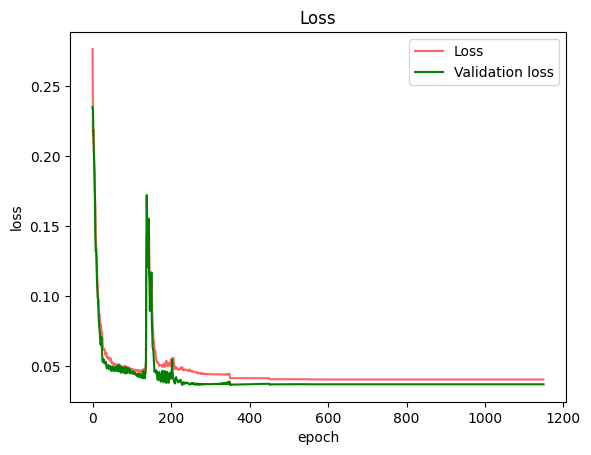

step 1, accuracy_train:0.59375, loss: 0.27085426453113026
step 2, accuracy_train:0.675, loss: 0.21081960120694265
step 3, accuracy_train:0.7625, loss: 0.20078438627330447
step 4, accuracy_train:0.7625, loss: 0.19493819605543217
step 5, accuracy_train:0.840625, loss: 0.17859163404911374
step 6, accuracy_train:0.890625, loss: 0.15361218471461996
step 7, accuracy_train:0.8875, loss: 0.14324377167977564
step 8, accuracy_train:0.896875, loss: 0.12625296864466307
step 9, accuracy_train:0.928125, loss: 0.11389117499759585
step 10, accuracy_train:0.9125, loss: 0.1072587763886006
step 11, accuracy_train:0.934375, loss: 0.09574636505983997
step 12, accuracy_train:0.9375, loss: 0.0856587204587368
step 13, accuracy_train:0.915625, loss: 0.08130703015737903
step 14, accuracy_train:0.91875, loss: 0.08165620288697689
step 15, accuracy_train:0.921875, loss: 0.07553589495795235
step 16, accuracy_train:0.915625, loss: 0.06617884653701964
step 17, accuracy_train:0.928125, loss: 0.06562418051467353
step 1

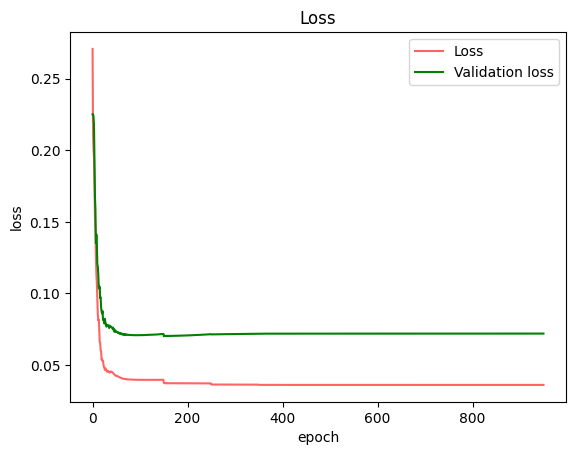

step 1, accuracy_train:0.5125, loss: 0.279391507488965
step 2, accuracy_train:0.65, loss: 0.2085935141547813
step 3, accuracy_train:0.70625, loss: 0.20739781958224507
step 4, accuracy_train:0.6625, loss: 0.20942344638733795
step 5, accuracy_train:0.75625, loss: 0.19799049941134939
step 6, accuracy_train:0.8125, loss: 0.1822382098228295
step 7, accuracy_train:0.803125, loss: 0.1761900956354239
step 8, accuracy_train:0.8375, loss: 0.16450134438001957
step 9, accuracy_train:0.878125, loss: 0.15689432037566553
step 10, accuracy_train:0.85625, loss: 0.1542334820144885
step 11, accuracy_train:0.875, loss: 0.14846082741320232
step 12, accuracy_train:0.871875, loss: 0.14503898214224584
step 13, accuracy_train:0.903125, loss: 0.14374909232902772
step 14, accuracy_train:0.896875, loss: 0.13614630366706412
step 15, accuracy_train:0.8875, loss: 0.1316209928204739
step 16, accuracy_train:0.90625, loss: 0.13136844197940875
step 17, accuracy_train:0.90625, loss: 0.1254959744684993
step 18, accuracy_t

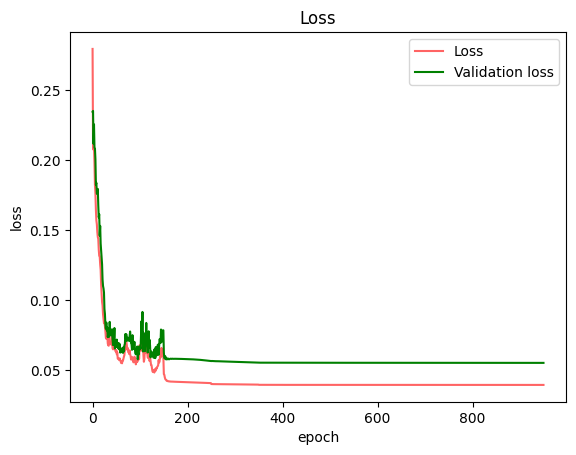

step 1, accuracy_train:0.459375, loss: 0.2828522669767253
step 2, accuracy_train:0.590625, loss: 0.21880941764876283
step 3, accuracy_train:0.671875, loss: 0.2265542956442649
step 4, accuracy_train:0.715625, loss: 0.21905936767343254
step 5, accuracy_train:0.7375, loss: 0.20414878508782064
step 6, accuracy_train:0.75625, loss: 0.19872192642213526
step 7, accuracy_train:0.759375, loss: 0.18993285709312818
step 8, accuracy_train:0.771875, loss: 0.1758285887441811
step 9, accuracy_train:0.834375, loss: 0.16579348826490115
step 10, accuracy_train:0.840625, loss: 0.16107123323895242
step 11, accuracy_train:0.84375, loss: 0.15155275930711287
step 12, accuracy_train:0.859375, loss: 0.14335530426190152
step 13, accuracy_train:0.8875, loss: 0.13389424924842008
step 14, accuracy_train:0.884375, loss: 0.12270560400776628
step 15, accuracy_train:0.89375, loss: 0.1145780641875205
step 16, accuracy_train:0.9, loss: 0.10365941153163333
step 17, accuracy_train:0.8875, loss: 0.10200455752836446
step 18

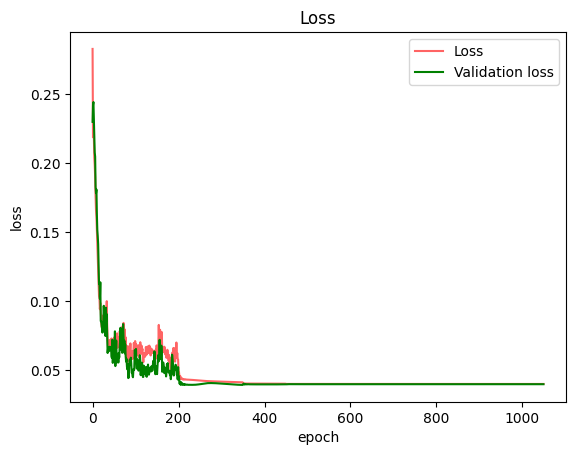

step 1, accuracy_train:0.503125, loss: 0.2806364633530879
step 2, accuracy_train:0.55625, loss: 0.23903439232991064
step 3, accuracy_train:0.615625, loss: 0.2329163668242798
step 4, accuracy_train:0.69375, loss: 0.22006457350647868
step 5, accuracy_train:0.68125, loss: 0.21399668193582944
step 6, accuracy_train:0.73125, loss: 0.202972936575803
step 7, accuracy_train:0.746875, loss: 0.18917110056417968
step 8, accuracy_train:0.815625, loss: 0.16778902613437838
step 9, accuracy_train:0.840625, loss: 0.158855589808069
step 10, accuracy_train:0.8625, loss: 0.15330164694423587
step 11, accuracy_train:0.884375, loss: 0.13656842916087106
step 12, accuracy_train:0.878125, loss: 0.13492057299344185
step 13, accuracy_train:0.878125, loss: 0.12411944054677727
step 14, accuracy_train:0.91875, loss: 0.10074341658379514
step 15, accuracy_train:0.9125, loss: 0.09782445062397435
step 16, accuracy_train:0.91875, loss: 0.09468361459201233
step 17, accuracy_train:0.91875, loss: 0.09105723522720555
step 1

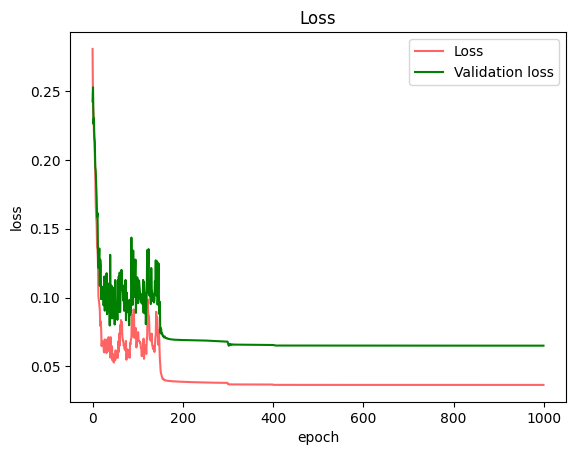

cv_time ：189.841644 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 100, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.50625, loss: 0.3085359160777735
step 2, accuracy_train:0.721875, loss: 0.21927544329303283
step 3, accuracy_train:0.659375, loss: 0.2004885957006753
step 4, accuracy_train:0.7375, loss: 0.18371082616461057
step 5, accuracy_train:0.746875, loss: 0.17756525060535885
step 6, accuracy_train:0.771875, loss: 0.1711518647950531
step 7, accuracy_train:0.825, loss: 0.1678658713861937
step 8, accuracy_train:0.815625, loss: 0.15995928798467826
step 9, accuracy_train:0.8625, loss: 0.14846373219450848
step 10, accuracy_train:0.878125, loss: 0.13460295985632198
step 11, accuracy_train:0.871875, loss: 0.12429214345677421
step 12, accuracy_train:0.875, loss: 0.12144977096691173
step 13, accuracy_train:0.890625, loss: 0.11598161393405833
step 14, accuracy_train:0.871875, loss: 0.11029123574542962
step 15, accuracy_train:0.878125, loss: 0.10476149655609493
step 16, accuracy_train:0.89687

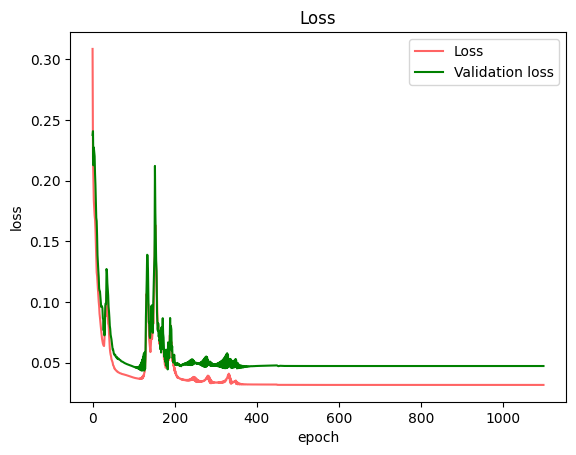

step 1, accuracy_train:0.496875, loss: 0.3052115906943395
step 2, accuracy_train:0.540625, loss: 0.23581724581002572
step 3, accuracy_train:0.6875, loss: 0.19215599619877727
step 4, accuracy_train:0.74375, loss: 0.17272247765671575
step 5, accuracy_train:0.771875, loss: 0.1715095714467874
step 6, accuracy_train:0.7625, loss: 0.16648953002590466
step 7, accuracy_train:0.8, loss: 0.16048953317189377
step 8, accuracy_train:0.865625, loss: 0.1522385401338841
step 9, accuracy_train:0.84375, loss: 0.1388780861897931
step 10, accuracy_train:0.84375, loss: 0.13198793968151187
step 11, accuracy_train:0.86875, loss: 0.1244550966905715
step 12, accuracy_train:0.8875, loss: 0.11472802333331314
step 13, accuracy_train:0.903125, loss: 0.1096782390260572
step 14, accuracy_train:0.915625, loss: 0.10191049974710656
step 15, accuracy_train:0.928125, loss: 0.09489233803256686
step 16, accuracy_train:0.9, loss: 0.08781722423143579
step 17, accuracy_train:0.925, loss: 0.07948243910529425
step 18, accuracy_

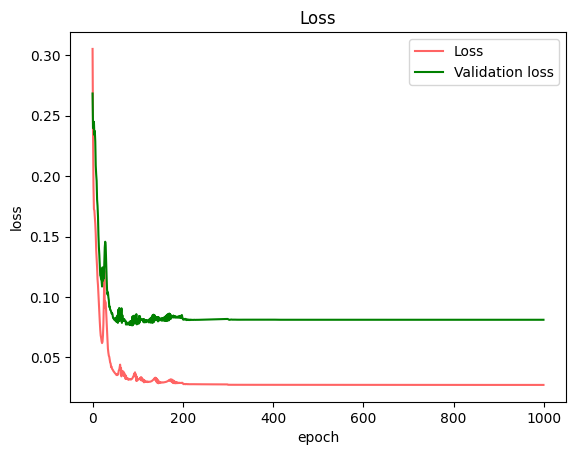

step 1, accuracy_train:0.5125, loss: 0.3161457977098737
step 2, accuracy_train:0.634375, loss: 0.23607200618974572
step 3, accuracy_train:0.64375, loss: 0.1874283555794552
step 4, accuracy_train:0.809375, loss: 0.1711831903498598
step 5, accuracy_train:0.784375, loss: 0.16503598342814324
step 6, accuracy_train:0.825, loss: 0.1604291660383424
step 7, accuracy_train:0.83125, loss: 0.1543949408211074
step 8, accuracy_train:0.775, loss: 0.1518930747339402
step 9, accuracy_train:0.803125, loss: 0.1460845328018894
step 10, accuracy_train:0.784375, loss: 0.13442824538500273
step 11, accuracy_train:0.846875, loss: 0.12394236107168852
step 12, accuracy_train:0.88125, loss: 0.12322243307862696
step 13, accuracy_train:0.8875, loss: 0.11564624698742351
step 14, accuracy_train:0.9, loss: 0.109536067958331
step 15, accuracy_train:0.909375, loss: 0.10268294601633364
step 16, accuracy_train:0.90625, loss: 0.09777778999972796
step 17, accuracy_train:0.90625, loss: 0.09471860451445704
step 18, accuracy_

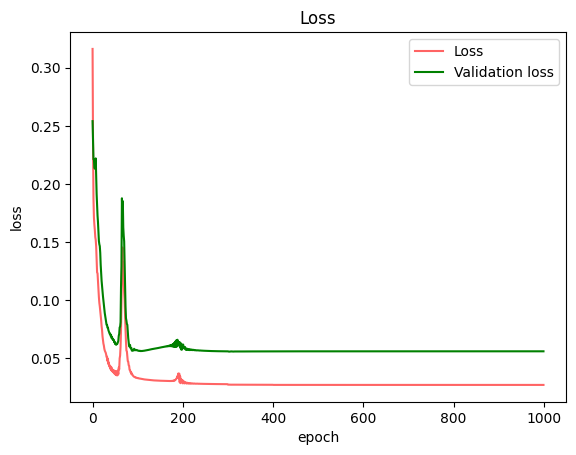

step 1, accuracy_train:0.509375, loss: 0.31501080039563045
step 2, accuracy_train:0.640625, loss: 0.22410343435897762
step 3, accuracy_train:0.675, loss: 0.19242481008383094
step 4, accuracy_train:0.70625, loss: 0.18213721666551255
step 5, accuracy_train:0.78125, loss: 0.18317701898913558
step 6, accuracy_train:0.778125, loss: 0.17880014371838943
step 7, accuracy_train:0.76875, loss: 0.16191000477672166
step 8, accuracy_train:0.778125, loss: 0.16088716151715865
step 9, accuracy_train:0.834375, loss: 0.14979823431229472
step 10, accuracy_train:0.825, loss: 0.14218729990045847
step 11, accuracy_train:0.834375, loss: 0.13307868651335802
step 12, accuracy_train:0.86875, loss: 0.1274872209516365
step 13, accuracy_train:0.878125, loss: 0.1154889810914268
step 14, accuracy_train:0.859375, loss: 0.11120692758857631
step 15, accuracy_train:0.884375, loss: 0.10894078782597891
step 16, accuracy_train:0.90625, loss: 0.10468874814730719
step 17, accuracy_train:0.890625, loss: 0.10158135162791702
st

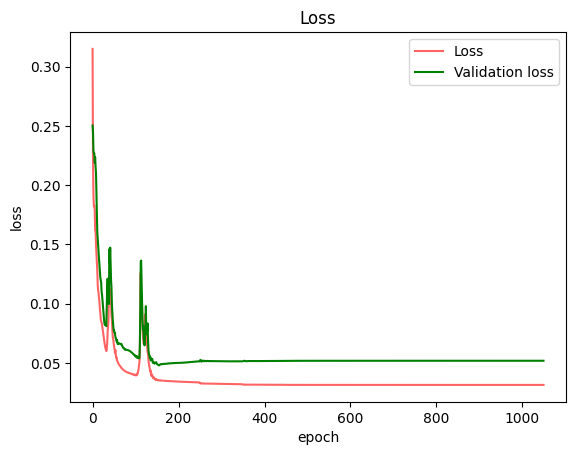

step 1, accuracy_train:0.515625, loss: 0.307682062749718
step 2, accuracy_train:0.54375, loss: 0.23921451797053944
step 3, accuracy_train:0.671875, loss: 0.20875395018515752
step 4, accuracy_train:0.715625, loss: 0.19325770703896322
step 5, accuracy_train:0.709375, loss: 0.19111695418749547
step 6, accuracy_train:0.76875, loss: 0.17853181454800487
step 7, accuracy_train:0.80625, loss: 0.1751704708027104
step 8, accuracy_train:0.853125, loss: 0.15110546990307105
step 9, accuracy_train:0.86875, loss: 0.12876668001459568
step 10, accuracy_train:0.890625, loss: 0.12038477009174318
step 11, accuracy_train:0.903125, loss: 0.1095793071770039
step 12, accuracy_train:0.903125, loss: 0.10014862078870893
step 13, accuracy_train:0.884375, loss: 0.0942833826217869
step 14, accuracy_train:0.89375, loss: 0.08500945867594728
step 15, accuracy_train:0.89375, loss: 0.07793622138942602
step 16, accuracy_train:0.9125, loss: 0.07431576835724531
step 17, accuracy_train:0.91875, loss: 0.0708382329417126
step

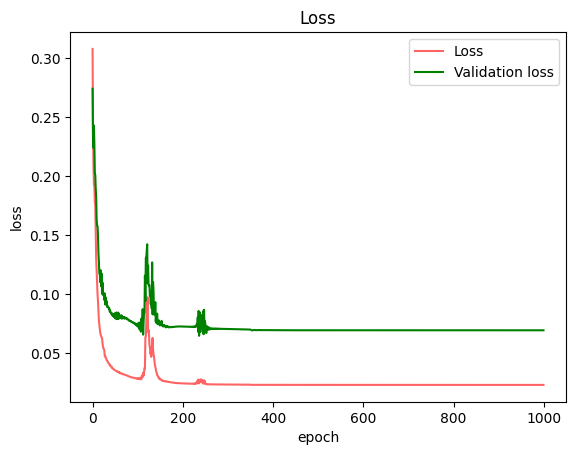

cv_time ：160.195031 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 300, 50, [0.05, 0.03, 0.01]]


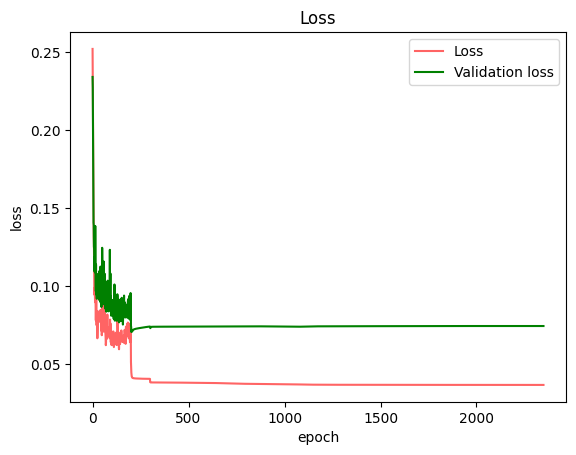

circuit is jitted
circuit is jitted
circuit is jitted
circuit is jitted
step 1, accuracy_train:0.634375, loss: 0.26655141255441
circuit is jitted
circuit is jitted
step 2, accuracy_train:0.659375, loss: 0.22496748555717735
step 3, accuracy_train:0.7, loss: 0.2279942673551732
step 4, accuracy_train:0.7375, loss: 0.20889342635888497
step 5, accuracy_train:0.815625, loss: 0.18930453983130216
step 6, accuracy_train:0.84375, loss: 0.1644190201290881
step 7, accuracy_train:0.8625, loss: 0.14459103510996066
step 8, accuracy_train:0.884375, loss: 0.12864073828965816
step 9, accuracy_train:0.9, loss: 0.12887306583493743
step 10, accuracy_train:0.890625, loss: 0.12435860575568314
step 11, accuracy_train:0.890625, loss: 0.1303415578010959
step 12, accuracy_train:0.890625, loss: 0.13388355514163797
step 13, accuracy_train:0.89375, loss: 0.11582797509402945
step 14, accuracy_train:0.884375, loss: 0.1366527122882673
step 15, accuracy_train:0.90625, loss: 0.12013822161101761
step 16, accuracy_train:0

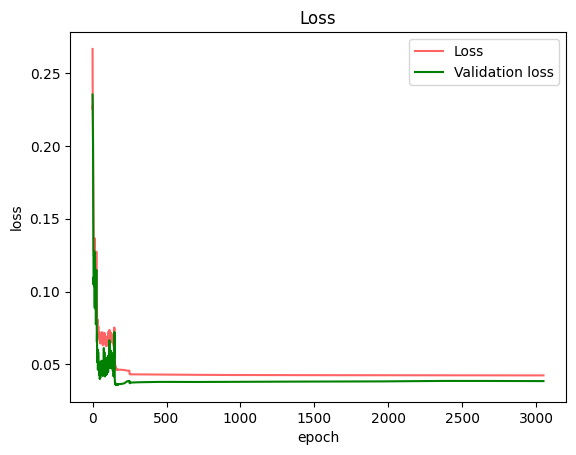

step 1, accuracy_train:0.640625, loss: 0.26489808228310213
step 2, accuracy_train:0.759375, loss: 0.2156435338119013
step 3, accuracy_train:0.809375, loss: 0.20181056711542958
step 4, accuracy_train:0.81875, loss: 0.1984315192725516
step 5, accuracy_train:0.85625, loss: 0.18327531328637342
step 6, accuracy_train:0.878125, loss: 0.16306112872972417
step 7, accuracy_train:0.8875, loss: 0.15205252905967073
step 8, accuracy_train:0.890625, loss: 0.1424804273590705
step 9, accuracy_train:0.9, loss: 0.13127725708389382
step 10, accuracy_train:0.9, loss: 0.11886214783906086
step 11, accuracy_train:0.9, loss: 0.11068879450978586
step 12, accuracy_train:0.915625, loss: 0.10493249203068195
step 13, accuracy_train:0.921875, loss: 0.11095821500296471
step 14, accuracy_train:0.91875, loss: 0.10083786236212568
step 15, accuracy_train:0.921875, loss: 0.09221265918349644
step 16, accuracy_train:0.90625, loss: 0.08920296788262516
step 17, accuracy_train:0.93125, loss: 0.09088077661958621
step 18, accur

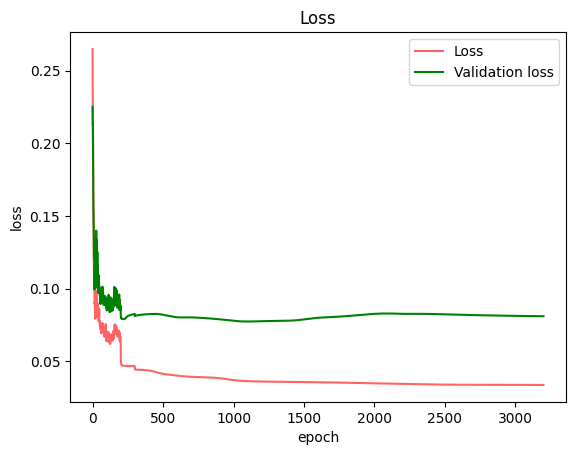

step 1, accuracy_train:0.69375, loss: 0.25990242895811
step 2, accuracy_train:0.740625, loss: 0.21865345711836204
step 3, accuracy_train:0.821875, loss: 0.20084226530675248
step 4, accuracy_train:0.85, loss: 0.19408122325434146
step 5, accuracy_train:0.83125, loss: 0.18368814067550635
step 6, accuracy_train:0.859375, loss: 0.16973730989071914
step 7, accuracy_train:0.85625, loss: 0.1567408595103054
step 8, accuracy_train:0.853125, loss: 0.15861014460620107
step 9, accuracy_train:0.871875, loss: 0.1407651259191779
step 10, accuracy_train:0.8875, loss: 0.1261643154361878
step 11, accuracy_train:0.89375, loss: 0.112813488968176
step 12, accuracy_train:0.896875, loss: 0.10931121754972309
step 13, accuracy_train:0.896875, loss: 0.10693369769067108
step 14, accuracy_train:0.896875, loss: 0.10100988064582099
step 15, accuracy_train:0.91875, loss: 0.09930750921414001
step 16, accuracy_train:0.903125, loss: 0.09750788253171999
step 17, accuracy_train:0.9125, loss: 0.10149554466623414
step 18, a

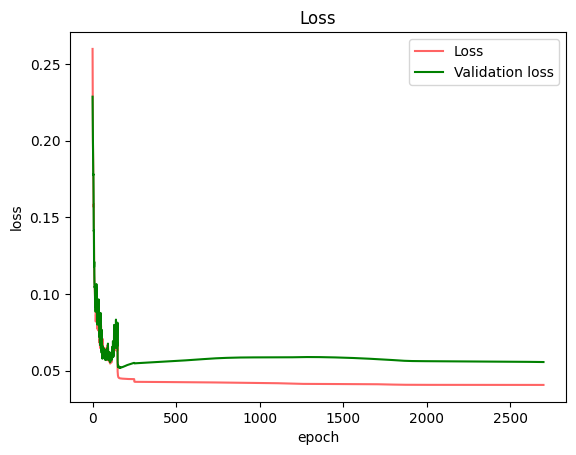

step 1, accuracy_train:0.66875, loss: 0.264130563126788
step 2, accuracy_train:0.6875, loss: 0.22425763913808278
step 3, accuracy_train:0.715625, loss: 0.21910654086144737
step 4, accuracy_train:0.71875, loss: 0.21401771967140407
step 5, accuracy_train:0.821875, loss: 0.18338166557152716
step 6, accuracy_train:0.85625, loss: 0.15452882016794303
step 7, accuracy_train:0.853125, loss: 0.14262205924679464
step 8, accuracy_train:0.859375, loss: 0.13603956258865793
step 9, accuracy_train:0.859375, loss: 0.12891046224114136
step 10, accuracy_train:0.890625, loss: 0.12411360209352044
step 11, accuracy_train:0.875, loss: 0.1210295800264008
step 12, accuracy_train:0.871875, loss: 0.11354377923562166
step 13, accuracy_train:0.896875, loss: 0.10331553552793032
step 14, accuracy_train:0.915625, loss: 0.10736324175650215
step 15, accuracy_train:0.89375, loss: 0.11930050301721803
step 16, accuracy_train:0.90625, loss: 0.10610727697826157
step 17, accuracy_train:0.896875, loss: 0.10227108759046377
st

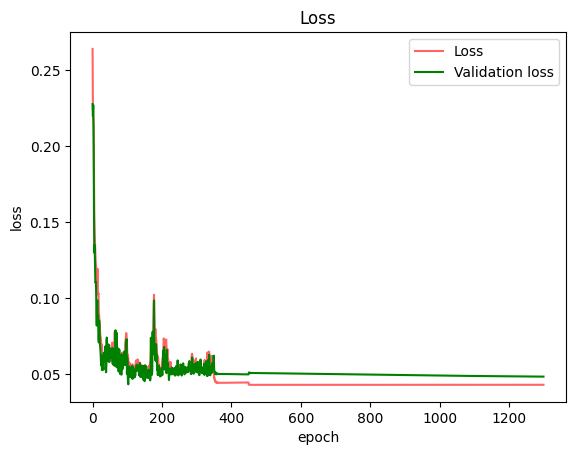

step 1, accuracy_train:0.690625, loss: 0.26056751956592356
step 2, accuracy_train:0.73125, loss: 0.22307835829828218
step 3, accuracy_train:0.728125, loss: 0.20643984204607724
step 4, accuracy_train:0.834375, loss: 0.19480811805740736
step 5, accuracy_train:0.853125, loss: 0.17110683849955458
step 6, accuracy_train:0.896875, loss: 0.1560998405625185
step 7, accuracy_train:0.915625, loss: 0.14230305604965476
step 8, accuracy_train:0.903125, loss: 0.1309434624952915
step 9, accuracy_train:0.9, loss: 0.12552684180227938
step 10, accuracy_train:0.903125, loss: 0.10930129820933032
step 11, accuracy_train:0.925, loss: 0.09476273219370586
step 12, accuracy_train:0.91875, loss: 0.10618246086042388
step 13, accuracy_train:0.90625, loss: 0.1003801395386004
step 14, accuracy_train:0.9125, loss: 0.09402590966693064
step 15, accuracy_train:0.921875, loss: 0.08496131384827278
step 16, accuracy_train:0.921875, loss: 0.07822481886240627
step 17, accuracy_train:0.9375, loss: 0.07471815625465376
step 18

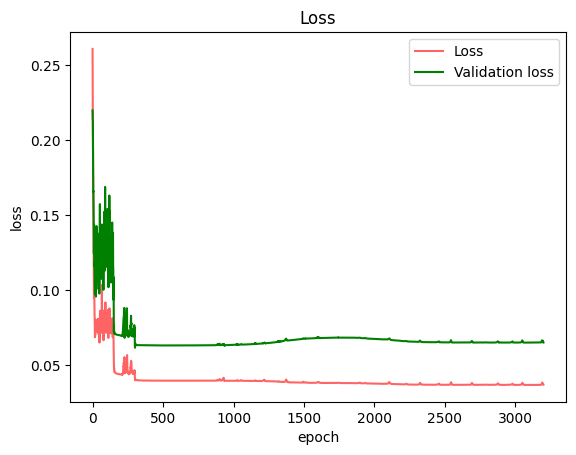

cv_time ：1269.054744 s
[[0.15, 0.05, 0.01], 3200, 50, 50, [0.05, 0.03, 0.01]]
circuit is jitted
circuit is jitted
step 1, accuracy_train:0.559375, loss: 0.29764341309096426
step 2, accuracy_train:0.678125, loss: 0.21876571478924017
step 3, accuracy_train:0.75, loss: 0.21568454749245908
step 4, accuracy_train:0.73125, loss: 0.21490848113816013
step 5, accuracy_train:0.725, loss: 0.20557857319921308
step 6, accuracy_train:0.8, loss: 0.19269992725803775
step 7, accuracy_train:0.803125, loss: 0.18084387816148217
step 8, accuracy_train:0.853125, loss: 0.16910792758136167
step 9, accuracy_train:0.859375, loss: 0.1586098045492237
step 10, accuracy_train:0.8875, loss: 0.15049699338774974
step 11, accuracy_train:0.896875, loss: 0.1458426270763017
step 12, accuracy_train:0.903125, loss: 0.1362811985322101
step 13, accuracy_train:0.88125, loss: 0.13002895830622613
step 14, accuracy_train:0.9, loss: 0.12365864793498746
step 15, accuracy_train:0.909375, loss: 0.11836561231260498
step 16, accuracy_t

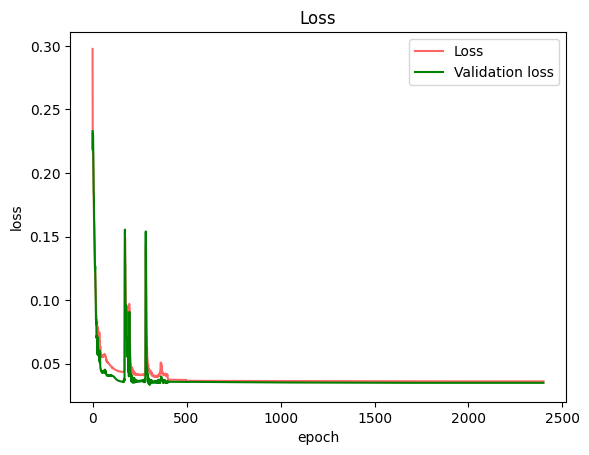

step 1, accuracy_train:0.63125, loss: 0.29319217850584156
step 2, accuracy_train:0.715625, loss: 0.2017131245724256
step 3, accuracy_train:0.803125, loss: 0.19583122461631736
step 4, accuracy_train:0.8125, loss: 0.1967752426541463
step 5, accuracy_train:0.85625, loss: 0.1716314449134262
step 6, accuracy_train:0.86875, loss: 0.15727285483242104
step 7, accuracy_train:0.9, loss: 0.14570929880082184
step 8, accuracy_train:0.878125, loss: 0.13349871364181332
step 9, accuracy_train:0.89375, loss: 0.11769272732503658
step 10, accuracy_train:0.90625, loss: 0.10631040297226253
step 11, accuracy_train:0.921875, loss: 0.09473385669394235
step 12, accuracy_train:0.921875, loss: 0.08667122252107347
step 13, accuracy_train:0.928125, loss: 0.08025129011423876
step 14, accuracy_train:0.93125, loss: 0.07145270373762154
step 15, accuracy_train:0.928125, loss: 0.06664198708273969
step 16, accuracy_train:0.934375, loss: 0.06721644456641222
step 17, accuracy_train:0.925, loss: 0.06672619282637368
step 18,

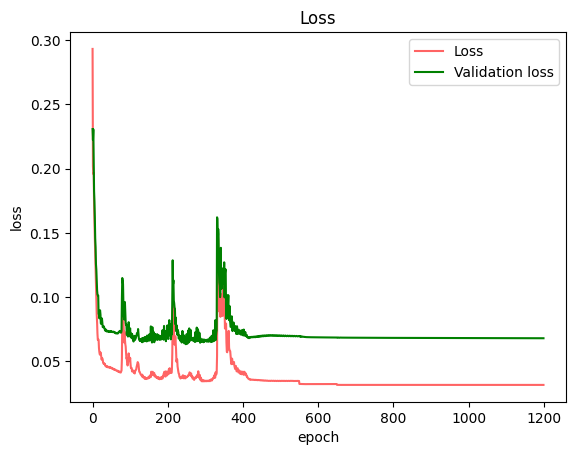

step 1, accuracy_train:0.59375, loss: 0.2981725550709363
step 2, accuracy_train:0.70625, loss: 0.2118051243026782
step 3, accuracy_train:0.828125, loss: 0.20172557847762385
step 4, accuracy_train:0.84375, loss: 0.197170833056088
step 5, accuracy_train:0.840625, loss: 0.1827040742165636
step 6, accuracy_train:0.865625, loss: 0.16943136813162088
step 7, accuracy_train:0.9, loss: 0.15723580409047583
step 8, accuracy_train:0.875, loss: 0.14292111467732188
step 9, accuracy_train:0.903125, loss: 0.12425624733102131
step 10, accuracy_train:0.915625, loss: 0.11035515817003143
step 11, accuracy_train:0.9125, loss: 0.0996282378784915
step 12, accuracy_train:0.903125, loss: 0.09175728019144339
step 13, accuracy_train:0.9, loss: 0.08440951011521328
step 14, accuracy_train:0.921875, loss: 0.08292269308544786
step 15, accuracy_train:0.91875, loss: 0.08712940840163047
step 16, accuracy_train:0.89375, loss: 0.09221370109866367
step 17, accuracy_train:0.90625, loss: 0.08359180696967677
step 18, accurac

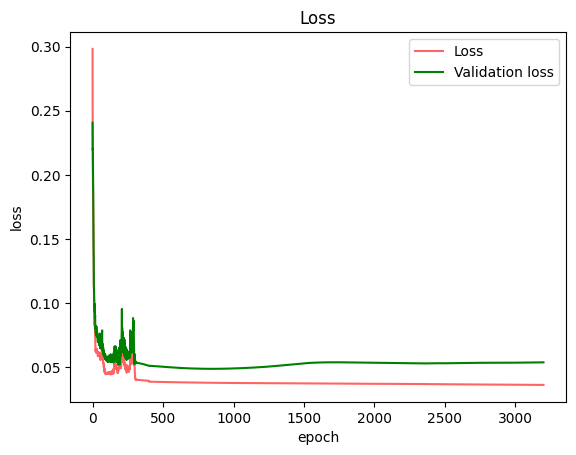

step 1, accuracy_train:0.621875, loss: 0.2958399547231546
step 2, accuracy_train:0.75, loss: 0.2025160007593808
step 3, accuracy_train:0.75625, loss: 0.20436172819331938
step 4, accuracy_train:0.7625, loss: 0.19868448583041676
step 5, accuracy_train:0.8125, loss: 0.18875948763197956
step 6, accuracy_train:0.890625, loss: 0.16793076112750346
step 7, accuracy_train:0.871875, loss: 0.15716908093622667
step 8, accuracy_train:0.903125, loss: 0.14478268503056446
step 9, accuracy_train:0.875, loss: 0.13097859459392736
step 10, accuracy_train:0.90625, loss: 0.11501983491484638
step 11, accuracy_train:0.884375, loss: 0.10856670389857692
step 12, accuracy_train:0.896875, loss: 0.10146391259683252
step 13, accuracy_train:0.9, loss: 0.09560016987858809
step 14, accuracy_train:0.9, loss: 0.08881434470286192
step 15, accuracy_train:0.90625, loss: 0.08759110269796938
step 16, accuracy_train:0.89375, loss: 0.08185233201665001
step 17, accuracy_train:0.909375, loss: 0.0831627782579995
step 18, accuracy

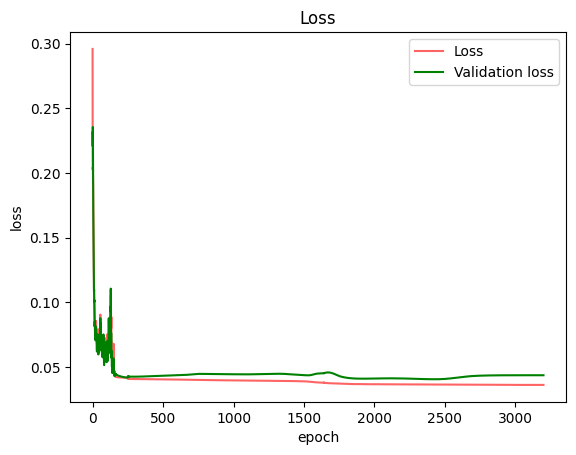

step 1, accuracy_train:0.609375, loss: 0.29754626119643035
step 2, accuracy_train:0.709375, loss: 0.20964843639815078
step 3, accuracy_train:0.80625, loss: 0.20341717365638295
step 4, accuracy_train:0.803125, loss: 0.19438962958735823
step 5, accuracy_train:0.8125, loss: 0.18792405343187588
step 6, accuracy_train:0.825, loss: 0.17815372829412143
step 7, accuracy_train:0.859375, loss: 0.17178389461883126
step 8, accuracy_train:0.86875, loss: 0.1523736846760811
step 9, accuracy_train:0.8625, loss: 0.14825254657824752
step 10, accuracy_train:0.896875, loss: 0.13265824851058927
step 11, accuracy_train:0.90625, loss: 0.12310559476562936
step 12, accuracy_train:0.903125, loss: 0.1203918747229345
step 13, accuracy_train:0.90625, loss: 0.1115815140489255
step 14, accuracy_train:0.909375, loss: 0.10530227352159105
step 15, accuracy_train:0.9, loss: 0.09220900394170542
step 16, accuracy_train:0.90625, loss: 0.09454176495516761
step 17, accuracy_train:0.9125, loss: 0.08735359841809204
step 18, ac

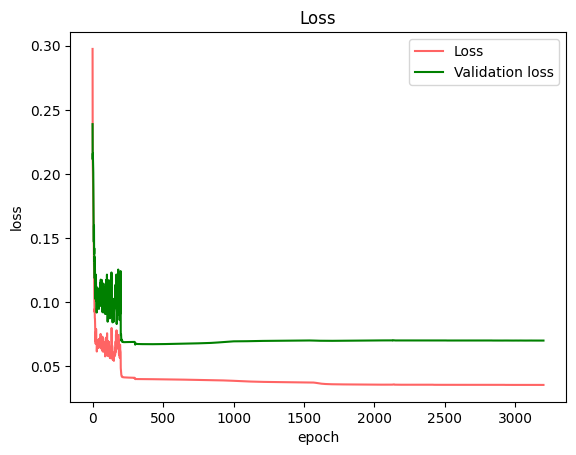

cv_time ：908.414995 s
[[0.15, 0.05, 0.01], 3200, 100, 50, [0.05, 0.03, 0.01]]
circuit is jitted
circuit is jitted
step 1, accuracy_train:0.659375, loss: 0.33237551464527487
step 2, accuracy_train:0.7, loss: 0.2546620814099185
step 3, accuracy_train:0.68125, loss: 0.20265442343392231
step 4, accuracy_train:0.76875, loss: 0.1716046800784454
step 5, accuracy_train:0.803125, loss: 0.1610724066928619
step 6, accuracy_train:0.85625, loss: 0.15771145893644492
step 7, accuracy_train:0.80625, loss: 0.15709654399577572
step 8, accuracy_train:0.878125, loss: 0.1523599875794973
step 9, accuracy_train:0.85625, loss: 0.15016261086200347
step 10, accuracy_train:0.85625, loss: 0.14005359363833922
step 11, accuracy_train:0.8625, loss: 0.1309601017337692
step 12, accuracy_train:0.878125, loss: 0.12787086223945093
step 13, accuracy_train:0.903125, loss: 0.12202641167475044
step 14, accuracy_train:0.915625, loss: 0.11877217436880572
step 15, accuracy_train:0.909375, loss: 0.11264187194023428
step 16, accu

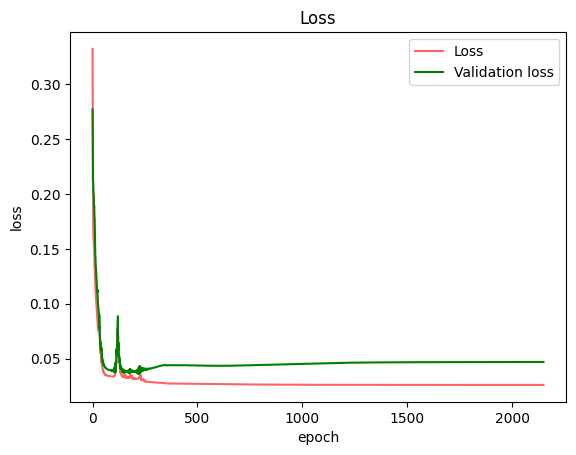

step 1, accuracy_train:0.6875, loss: 0.3277874648855158
step 2, accuracy_train:0.7, loss: 0.2557786406138706
step 3, accuracy_train:0.7375, loss: 0.20453686917716873
step 4, accuracy_train:0.790625, loss: 0.17383159450875676
step 5, accuracy_train:0.778125, loss: 0.1695604086884535
step 6, accuracy_train:0.771875, loss: 0.16977744931818142
step 7, accuracy_train:0.8125, loss: 0.16964172257366916
step 8, accuracy_train:0.85625, loss: 0.15981162125389928
step 9, accuracy_train:0.865625, loss: 0.1512370948822794
step 10, accuracy_train:0.834375, loss: 0.14123527568119792
step 11, accuracy_train:0.878125, loss: 0.13356216548637959
step 12, accuracy_train:0.875, loss: 0.1284466763978776
step 13, accuracy_train:0.884375, loss: 0.12458646537622933
step 14, accuracy_train:0.896875, loss: 0.11819833293300999
step 15, accuracy_train:0.9125, loss: 0.11231975036800024
step 16, accuracy_train:0.91875, loss: 0.10824055126005705
step 17, accuracy_train:0.909375, loss: 0.10547025733276658
step 18, acc

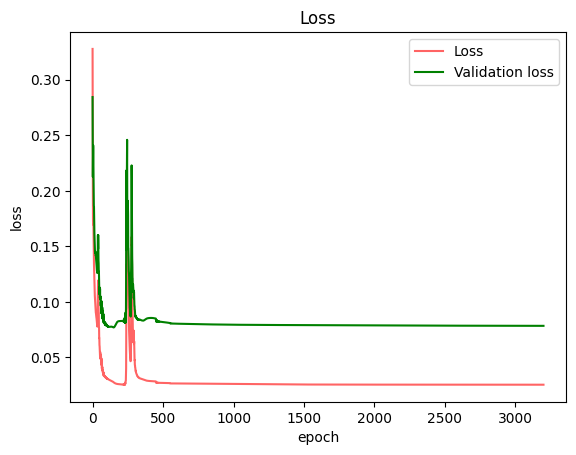

step 1, accuracy_train:0.675, loss: 0.33321985372645313
step 2, accuracy_train:0.74375, loss: 0.2474881635553854
step 3, accuracy_train:0.7125, loss: 0.19807035608197676
step 4, accuracy_train:0.803125, loss: 0.1743081140705888
step 5, accuracy_train:0.821875, loss: 0.16425573690127387
step 6, accuracy_train:0.83125, loss: 0.1564883938880104
step 7, accuracy_train:0.834375, loss: 0.15962535600349106
step 8, accuracy_train:0.85, loss: 0.15920462331628293
step 9, accuracy_train:0.825, loss: 0.1523287293443566
step 10, accuracy_train:0.846875, loss: 0.1395796580512688
step 11, accuracy_train:0.846875, loss: 0.1362302094483773
step 12, accuracy_train:0.878125, loss: 0.12878998903501712
step 13, accuracy_train:0.86875, loss: 0.12304131328573067
step 14, accuracy_train:0.88125, loss: 0.11683890100372672
step 15, accuracy_train:0.89375, loss: 0.11121028646453054
step 16, accuracy_train:0.903125, loss: 0.10700105347154094
step 17, accuracy_train:0.903125, loss: 0.1048990130719106
step 18, accu

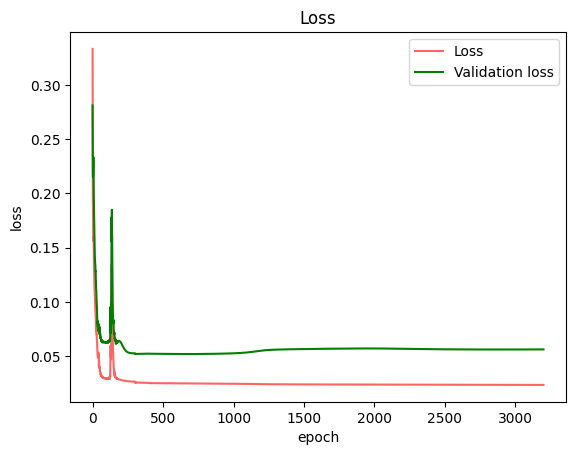

step 1, accuracy_train:0.628125, loss: 0.3358183221802886
step 2, accuracy_train:0.609375, loss: 0.25537304292155566
step 3, accuracy_train:0.709375, loss: 0.20896183265140522
step 4, accuracy_train:0.696875, loss: 0.18232914502366826
step 5, accuracy_train:0.8, loss: 0.16710940317321965
step 6, accuracy_train:0.80625, loss: 0.17004381719990258
step 7, accuracy_train:0.8375, loss: 0.1656857963757834
step 8, accuracy_train:0.828125, loss: 0.15823664298708878
step 9, accuracy_train:0.853125, loss: 0.15303493157451925
step 10, accuracy_train:0.8875, loss: 0.14566293254899979
step 11, accuracy_train:0.88125, loss: 0.13610492640307914
step 12, accuracy_train:0.884375, loss: 0.12798901766168685
step 13, accuracy_train:0.9, loss: 0.12196042317203595
step 14, accuracy_train:0.921875, loss: 0.1163222727845977
step 15, accuracy_train:0.90625, loss: 0.11312780799328444
step 16, accuracy_train:0.909375, loss: 0.10832074698455771
step 17, accuracy_train:0.915625, loss: 0.10408389882055927
step 18, 

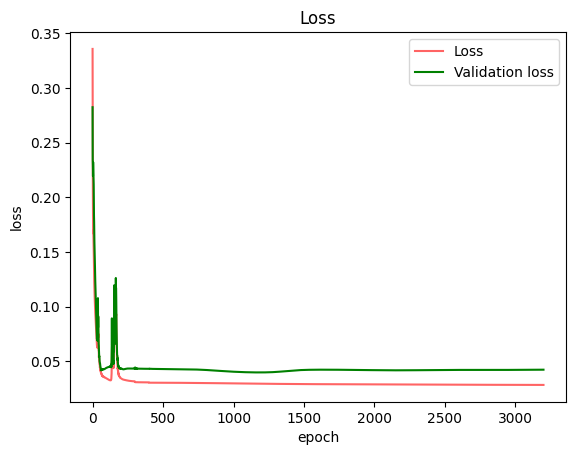

step 1, accuracy_train:0.634375, loss: 0.3373632481956931
step 2, accuracy_train:0.575, loss: 0.26195078894113966
step 3, accuracy_train:0.709375, loss: 0.20694436372541566
step 4, accuracy_train:0.771875, loss: 0.1870681010925995
step 5, accuracy_train:0.790625, loss: 0.1842271271042331
step 6, accuracy_train:0.821875, loss: 0.1858337137638655
step 7, accuracy_train:0.846875, loss: 0.1690490636882013
step 8, accuracy_train:0.871875, loss: 0.1551945549532982
step 9, accuracy_train:0.85625, loss: 0.14216143614503685
step 10, accuracy_train:0.846875, loss: 0.12894058897908406
step 11, accuracy_train:0.8625, loss: 0.12337455215418439
step 12, accuracy_train:0.890625, loss: 0.1126085681725047
step 13, accuracy_train:0.890625, loss: 0.10415846766607709
step 14, accuracy_train:0.8875, loss: 0.09671535279446818
step 15, accuracy_train:0.9, loss: 0.09090178428308854
step 16, accuracy_train:0.8875, loss: 0.08497423439917944
step 17, accuracy_train:0.903125, loss: 0.08125685623587015
step 18, ac

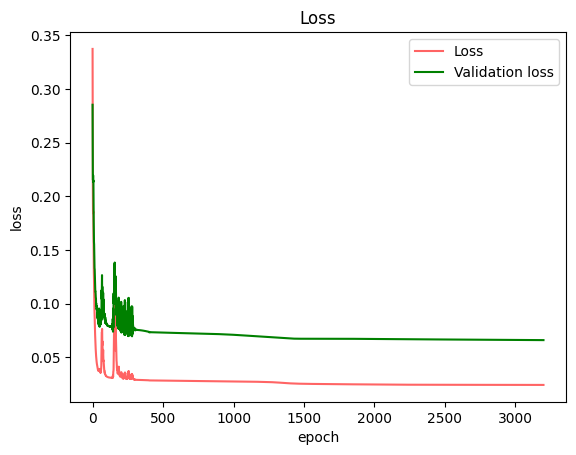

cv_time ：961.150411 s
[[0.15, 0.05, 0.01], 3200, 300, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.634375, loss: 0.26655141255441
step 2, accuracy_train:0.659375, loss: 0.22496748555717735
step 3, accuracy_train:0.7, loss: 0.2279942673551732
step 4, accuracy_train:0.7375, loss: 0.20889342635888497
step 5, accuracy_train:0.815625, loss: 0.18930453983130216
step 6, accuracy_train:0.84375, loss: 0.1644190201290881
step 7, accuracy_train:0.8625, loss: 0.14459103510996066
step 8, accuracy_train:0.884375, loss: 0.12864073828965816
step 9, accuracy_train:0.9, loss: 0.12887306583493743
step 10, accuracy_train:0.890625, loss: 0.12435860575568314
step 11, accuracy_train:0.890625, loss: 0.1303415578010959
step 12, accuracy_train:0.890625, loss: 0.13388355514163797
step 13, accuracy_train:0.89375, loss: 0.11582797509402945
step 14, accuracy_train:0.884375, loss: 0.1366527122882673
step 15, accuracy_train:0.90625, loss: 0.12013822161101761
step 16, accuracy_train:0.9, loss: 0.11243388688955903


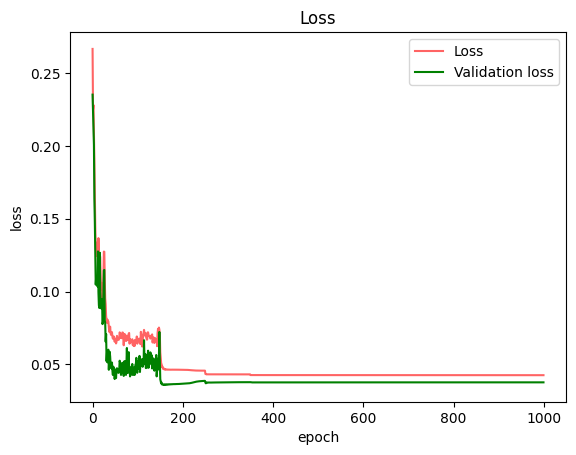

step 1, accuracy_train:0.640625, loss: 0.26489808228310213
step 2, accuracy_train:0.759375, loss: 0.2156435338119013
step 3, accuracy_train:0.809375, loss: 0.20181056711542958
step 4, accuracy_train:0.81875, loss: 0.1984315192725516
step 5, accuracy_train:0.85625, loss: 0.18327531328637342
step 6, accuracy_train:0.878125, loss: 0.16306112872972417
step 7, accuracy_train:0.8875, loss: 0.15205252905967073
step 8, accuracy_train:0.890625, loss: 0.1424804273590705
step 9, accuracy_train:0.9, loss: 0.13127725708389382
step 10, accuracy_train:0.9, loss: 0.11886214783906086
step 11, accuracy_train:0.9, loss: 0.11068879450978586
step 12, accuracy_train:0.915625, loss: 0.10493249203068195
step 13, accuracy_train:0.921875, loss: 0.11095821500296471
step 14, accuracy_train:0.91875, loss: 0.10083786236212568
step 15, accuracy_train:0.921875, loss: 0.09221265918349644
step 16, accuracy_train:0.90625, loss: 0.08920296788262516
step 17, accuracy_train:0.93125, loss: 0.09088077661958621
step 18, accur

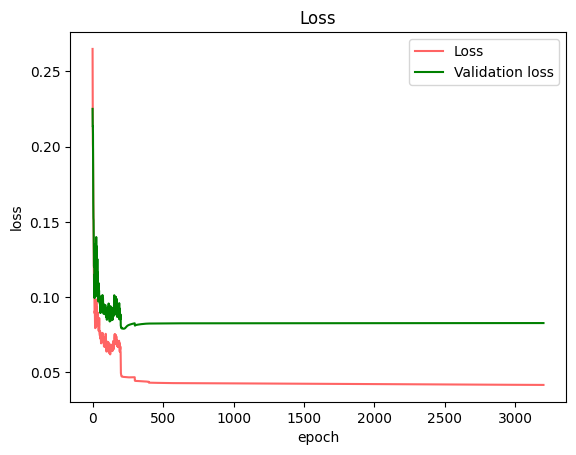

step 1, accuracy_train:0.69375, loss: 0.25990242895811
step 2, accuracy_train:0.740625, loss: 0.21865345711836204
step 3, accuracy_train:0.821875, loss: 0.20084226530675248
step 4, accuracy_train:0.85, loss: 0.19408122325434146
step 5, accuracy_train:0.83125, loss: 0.18368814067550635
step 6, accuracy_train:0.859375, loss: 0.16973730989071914
step 7, accuracy_train:0.85625, loss: 0.1567408595103054
step 8, accuracy_train:0.853125, loss: 0.15861014460620107
step 9, accuracy_train:0.871875, loss: 0.1407651259191779
step 10, accuracy_train:0.8875, loss: 0.1261643154361878
step 11, accuracy_train:0.89375, loss: 0.112813488968176
step 12, accuracy_train:0.896875, loss: 0.10931121754972309
step 13, accuracy_train:0.896875, loss: 0.10693369769067108
step 14, accuracy_train:0.896875, loss: 0.10100988064582099
step 15, accuracy_train:0.91875, loss: 0.09930750921414001
step 16, accuracy_train:0.903125, loss: 0.09750788253171999
step 17, accuracy_train:0.9125, loss: 0.10149554466623414
step 18, a

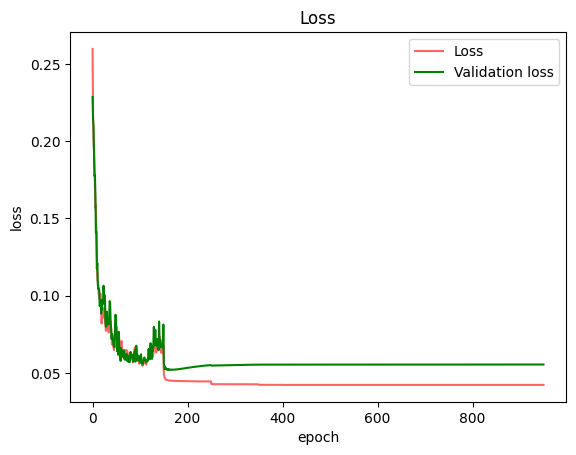

step 1, accuracy_train:0.66875, loss: 0.264130563126788
step 2, accuracy_train:0.6875, loss: 0.22425763913808278
step 3, accuracy_train:0.715625, loss: 0.21910654086144737
step 4, accuracy_train:0.71875, loss: 0.21401771967140407
step 5, accuracy_train:0.821875, loss: 0.18338166557152716
step 6, accuracy_train:0.85625, loss: 0.15452882016794303
step 7, accuracy_train:0.853125, loss: 0.14262205924679464
step 8, accuracy_train:0.859375, loss: 0.13603956258865793
step 9, accuracy_train:0.859375, loss: 0.12891046224114136
step 10, accuracy_train:0.890625, loss: 0.12411360209352044
step 11, accuracy_train:0.875, loss: 0.1210295800264008
step 12, accuracy_train:0.871875, loss: 0.11354377923562166
step 13, accuracy_train:0.896875, loss: 0.10331553552793032
step 14, accuracy_train:0.915625, loss: 0.10736324175650215
step 15, accuracy_train:0.89375, loss: 0.11930050301721803
step 16, accuracy_train:0.90625, loss: 0.10610727697826157
step 17, accuracy_train:0.896875, loss: 0.10227108759046377
st

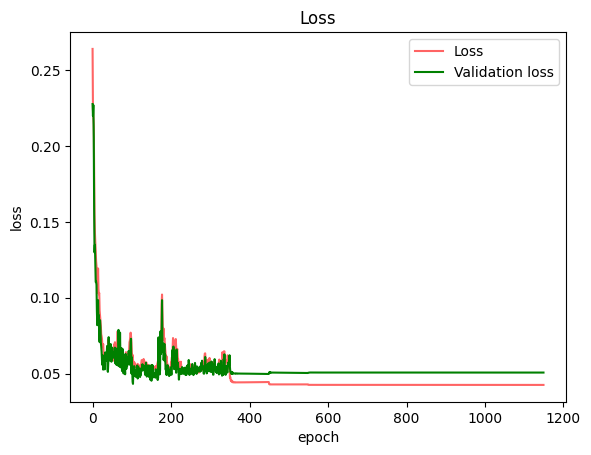

step 1, accuracy_train:0.690625, loss: 0.26056751956592356
step 2, accuracy_train:0.73125, loss: 0.22307835829828218
step 3, accuracy_train:0.728125, loss: 0.20643984204607724
step 4, accuracy_train:0.834375, loss: 0.19480811805740736
step 5, accuracy_train:0.853125, loss: 0.17110683849955458
step 6, accuracy_train:0.896875, loss: 0.1560998405625185
step 7, accuracy_train:0.915625, loss: 0.14230305604965476
step 8, accuracy_train:0.903125, loss: 0.1309434624952915
step 9, accuracy_train:0.9, loss: 0.12552684180227938
step 10, accuracy_train:0.903125, loss: 0.10930129820933032
step 11, accuracy_train:0.925, loss: 0.09476273219370586
step 12, accuracy_train:0.91875, loss: 0.10618246086042388
step 13, accuracy_train:0.90625, loss: 0.1003801395386004
step 14, accuracy_train:0.9125, loss: 0.09402590966693064
step 15, accuracy_train:0.921875, loss: 0.08496131384827278
step 16, accuracy_train:0.921875, loss: 0.07822481886240627
step 17, accuracy_train:0.9375, loss: 0.07471815625465376
step 18

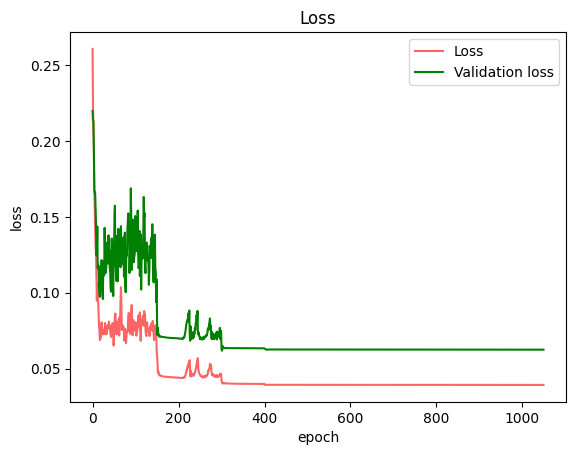

cv_time ：499.395214 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 50, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.559375, loss: 0.29764341309096426
step 2, accuracy_train:0.678125, loss: 0.21876571478924017
step 3, accuracy_train:0.75, loss: 0.21568454749245908
step 4, accuracy_train:0.73125, loss: 0.21490848113816013
step 5, accuracy_train:0.725, loss: 0.20557857319921308
step 6, accuracy_train:0.8, loss: 0.19269992725803775
step 7, accuracy_train:0.803125, loss: 0.18084387816148217
step 8, accuracy_train:0.853125, loss: 0.16910792758136167
step 9, accuracy_train:0.859375, loss: 0.1586098045492237
step 10, accuracy_train:0.8875, loss: 0.15049699338774974
step 11, accuracy_train:0.896875, loss: 0.1458426270763017
step 12, accuracy_train:0.903125, loss: 0.1362811985322101
step 13, accuracy_train:0.88125, loss: 0.13002895830622613
step 14, accuracy_train:0.9, loss: 0.12365864793498746
step 15, accuracy_train:0.909375, loss: 0.11836561231260498
step 16, accuracy_train:0.903125, loss: 0

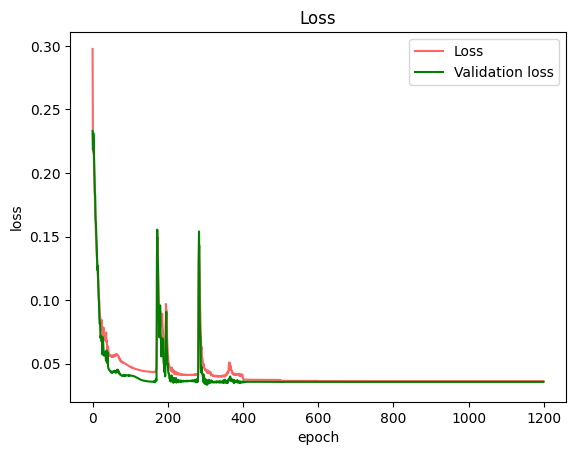

step 1, accuracy_train:0.63125, loss: 0.29319217850584156
step 2, accuracy_train:0.715625, loss: 0.2017131245724256
step 3, accuracy_train:0.803125, loss: 0.19583122461631736
step 4, accuracy_train:0.8125, loss: 0.1967752426541463
step 5, accuracy_train:0.85625, loss: 0.1716314449134262
step 6, accuracy_train:0.86875, loss: 0.15727285483242104
step 7, accuracy_train:0.9, loss: 0.14570929880082184
step 8, accuracy_train:0.878125, loss: 0.13349871364181332
step 9, accuracy_train:0.89375, loss: 0.11769272732503658
step 10, accuracy_train:0.90625, loss: 0.10631040297226253
step 11, accuracy_train:0.921875, loss: 0.09473385669394235
step 12, accuracy_train:0.921875, loss: 0.08667122252107347
step 13, accuracy_train:0.928125, loss: 0.08025129011423876
step 14, accuracy_train:0.93125, loss: 0.07145270373762154
step 15, accuracy_train:0.928125, loss: 0.06664198708273969
step 16, accuracy_train:0.934375, loss: 0.06721644456641222
step 17, accuracy_train:0.925, loss: 0.06672619282637368
step 18,

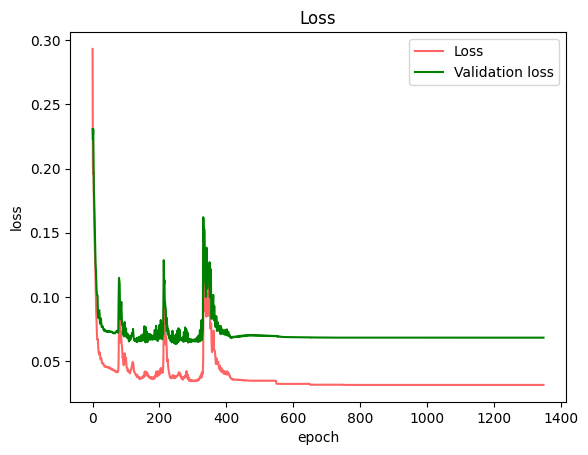

step 1, accuracy_train:0.59375, loss: 0.2981725550709363
step 2, accuracy_train:0.70625, loss: 0.2118051243026782
step 3, accuracy_train:0.828125, loss: 0.20172557847762385
step 4, accuracy_train:0.84375, loss: 0.197170833056088
step 5, accuracy_train:0.840625, loss: 0.1827040742165636
step 6, accuracy_train:0.865625, loss: 0.16943136813162088
step 7, accuracy_train:0.9, loss: 0.15723580409047583
step 8, accuracy_train:0.875, loss: 0.14292111467732188
step 9, accuracy_train:0.903125, loss: 0.12425624733102131
step 10, accuracy_train:0.915625, loss: 0.11035515817003143
step 11, accuracy_train:0.9125, loss: 0.0996282378784915
step 12, accuracy_train:0.903125, loss: 0.09175728019144339
step 13, accuracy_train:0.9, loss: 0.08440951011521328
step 14, accuracy_train:0.921875, loss: 0.08292269308544786
step 15, accuracy_train:0.91875, loss: 0.08712940840163047
step 16, accuracy_train:0.89375, loss: 0.09221370109866367
step 17, accuracy_train:0.90625, loss: 0.08359180696967677
step 18, accurac

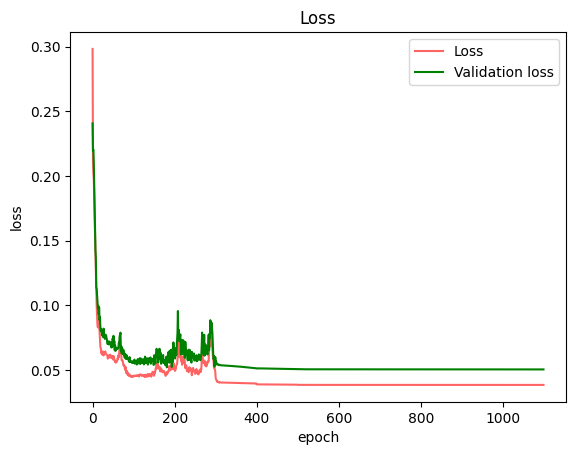

step 1, accuracy_train:0.621875, loss: 0.2958399547231546
step 2, accuracy_train:0.75, loss: 0.2025160007593808
step 3, accuracy_train:0.75625, loss: 0.20436172819331938
step 4, accuracy_train:0.7625, loss: 0.19868448583041676
step 5, accuracy_train:0.8125, loss: 0.18875948763197956
step 6, accuracy_train:0.890625, loss: 0.16793076112750346
step 7, accuracy_train:0.871875, loss: 0.15716908093622667
step 8, accuracy_train:0.903125, loss: 0.14478268503056446
step 9, accuracy_train:0.875, loss: 0.13097859459392736
step 10, accuracy_train:0.90625, loss: 0.11501983491484638
step 11, accuracy_train:0.884375, loss: 0.10856670389857692
step 12, accuracy_train:0.896875, loss: 0.10146391259683252
step 13, accuracy_train:0.9, loss: 0.09560016987858809
step 14, accuracy_train:0.9, loss: 0.08881434470286192
step 15, accuracy_train:0.90625, loss: 0.08759110269796938
step 16, accuracy_train:0.89375, loss: 0.08185233201665001
step 17, accuracy_train:0.909375, loss: 0.0831627782579995
step 18, accuracy

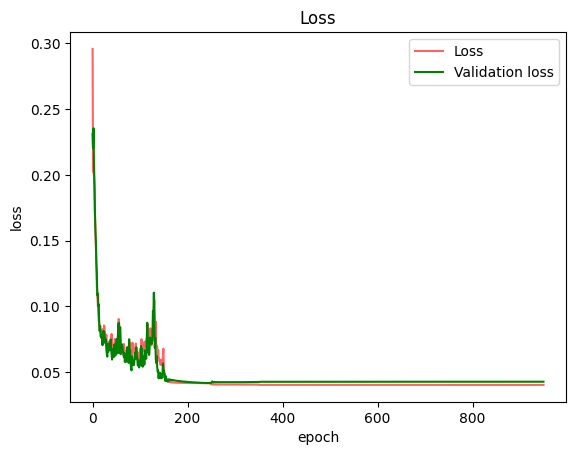

step 1, accuracy_train:0.609375, loss: 0.29754626119643035
step 2, accuracy_train:0.709375, loss: 0.20964843639815078
step 3, accuracy_train:0.80625, loss: 0.20341717365638295
step 4, accuracy_train:0.803125, loss: 0.19438962958735823
step 5, accuracy_train:0.8125, loss: 0.18792405343187588
step 6, accuracy_train:0.825, loss: 0.17815372829412143
step 7, accuracy_train:0.859375, loss: 0.17178389461883126
step 8, accuracy_train:0.86875, loss: 0.1523736846760811
step 9, accuracy_train:0.8625, loss: 0.14825254657824752
step 10, accuracy_train:0.896875, loss: 0.13265824851058927
step 11, accuracy_train:0.90625, loss: 0.12310559476562936
step 12, accuracy_train:0.903125, loss: 0.1203918747229345
step 13, accuracy_train:0.90625, loss: 0.1115815140489255
step 14, accuracy_train:0.909375, loss: 0.10530227352159105
step 15, accuracy_train:0.9, loss: 0.09220900394170542
step 16, accuracy_train:0.90625, loss: 0.09454176495516761
step 17, accuracy_train:0.9125, loss: 0.08735359841809204
step 18, ac

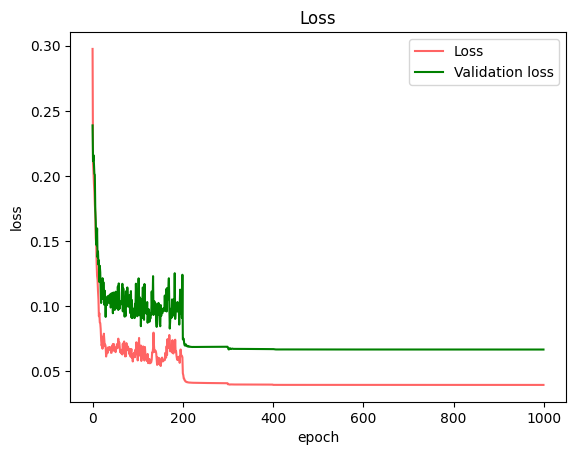

cv_time ：333.655146 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 100, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.659375, loss: 0.33237551464527487
step 2, accuracy_train:0.7, loss: 0.2546620814099185
step 3, accuracy_train:0.68125, loss: 0.20265442343392231
step 4, accuracy_train:0.76875, loss: 0.1716046800784454
step 5, accuracy_train:0.803125, loss: 0.1610724066928619
step 6, accuracy_train:0.85625, loss: 0.15771145893644492
step 7, accuracy_train:0.80625, loss: 0.15709654399577572
step 8, accuracy_train:0.878125, loss: 0.1523599875794973
step 9, accuracy_train:0.85625, loss: 0.15016261086200347
step 10, accuracy_train:0.85625, loss: 0.14005359363833922
step 11, accuracy_train:0.8625, loss: 0.1309601017337692
step 12, accuracy_train:0.878125, loss: 0.12787086223945093
step 13, accuracy_train:0.903125, loss: 0.12202641167475044
step 14, accuracy_train:0.915625, loss: 0.11877217436880572
step 15, accuracy_train:0.909375, loss: 0.11264187194023428
step 16, accuracy_train:0.921875, 

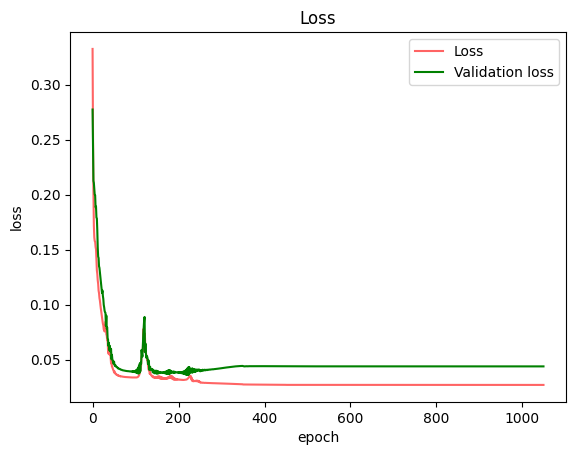

step 1, accuracy_train:0.6875, loss: 0.3277874648855158
step 2, accuracy_train:0.7, loss: 0.2557786406138706
step 3, accuracy_train:0.7375, loss: 0.20453686917716873
step 4, accuracy_train:0.790625, loss: 0.17383159450875676
step 5, accuracy_train:0.778125, loss: 0.1695604086884535
step 6, accuracy_train:0.771875, loss: 0.16977744931818142
step 7, accuracy_train:0.8125, loss: 0.16964172257366916
step 8, accuracy_train:0.85625, loss: 0.15981162125389928
step 9, accuracy_train:0.865625, loss: 0.1512370948822794
step 10, accuracy_train:0.834375, loss: 0.14123527568119792
step 11, accuracy_train:0.878125, loss: 0.13356216548637959
step 12, accuracy_train:0.875, loss: 0.1284466763978776
step 13, accuracy_train:0.884375, loss: 0.12458646537622933
step 14, accuracy_train:0.896875, loss: 0.11819833293300999
step 15, accuracy_train:0.9125, loss: 0.11231975036800024
step 16, accuracy_train:0.91875, loss: 0.10824055126005705
step 17, accuracy_train:0.909375, loss: 0.10547025733276658
step 18, acc

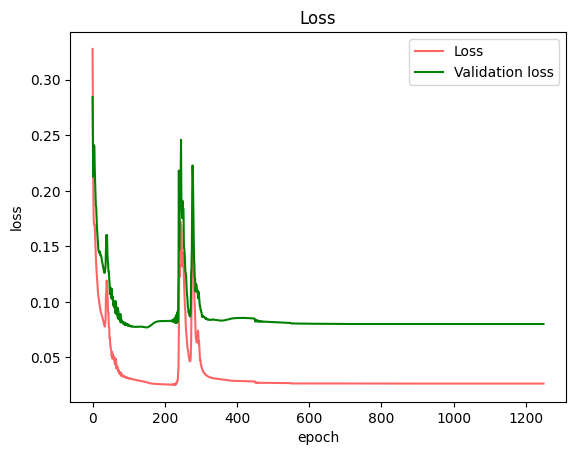

step 1, accuracy_train:0.675, loss: 0.33321985372645313
step 2, accuracy_train:0.74375, loss: 0.2474881635553854
step 3, accuracy_train:0.7125, loss: 0.19807035608197676
step 4, accuracy_train:0.803125, loss: 0.1743081140705888
step 5, accuracy_train:0.821875, loss: 0.16425573690127387
step 6, accuracy_train:0.83125, loss: 0.1564883938880104
step 7, accuracy_train:0.834375, loss: 0.15962535600349106
step 8, accuracy_train:0.85, loss: 0.15920462331628293
step 9, accuracy_train:0.825, loss: 0.1523287293443566
step 10, accuracy_train:0.846875, loss: 0.1395796580512688
step 11, accuracy_train:0.846875, loss: 0.1362302094483773
step 12, accuracy_train:0.878125, loss: 0.12878998903501712
step 13, accuracy_train:0.86875, loss: 0.12304131328573067
step 14, accuracy_train:0.88125, loss: 0.11683890100372672
step 15, accuracy_train:0.89375, loss: 0.11121028646453054
step 16, accuracy_train:0.903125, loss: 0.10700105347154094
step 17, accuracy_train:0.903125, loss: 0.1048990130719106
step 18, accu

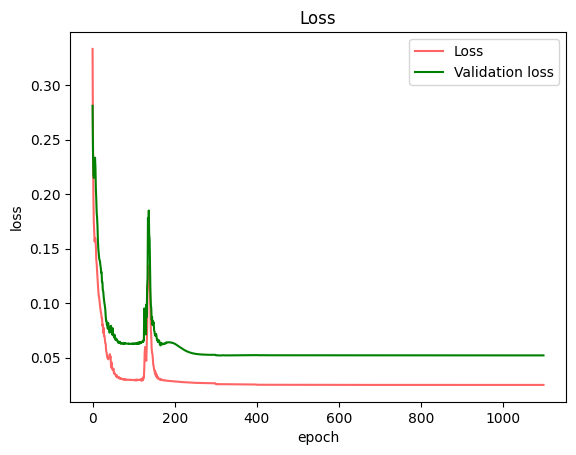

step 1, accuracy_train:0.628125, loss: 0.3358183221802886
step 2, accuracy_train:0.609375, loss: 0.25537304292155566
step 3, accuracy_train:0.709375, loss: 0.20896183265140522
step 4, accuracy_train:0.696875, loss: 0.18232914502366826
step 5, accuracy_train:0.8, loss: 0.16710940317321965
step 6, accuracy_train:0.80625, loss: 0.17004381719990258
step 7, accuracy_train:0.8375, loss: 0.1656857963757834
step 8, accuracy_train:0.828125, loss: 0.15823664298708878
step 9, accuracy_train:0.853125, loss: 0.15303493157451925
step 10, accuracy_train:0.8875, loss: 0.14566293254899979
step 11, accuracy_train:0.88125, loss: 0.13610492640307914
step 12, accuracy_train:0.884375, loss: 0.12798901766168685
step 13, accuracy_train:0.9, loss: 0.12196042317203595
step 14, accuracy_train:0.921875, loss: 0.1163222727845977
step 15, accuracy_train:0.90625, loss: 0.11312780799328444
step 16, accuracy_train:0.909375, loss: 0.10832074698455771
step 17, accuracy_train:0.915625, loss: 0.10408389882055927
step 18, 

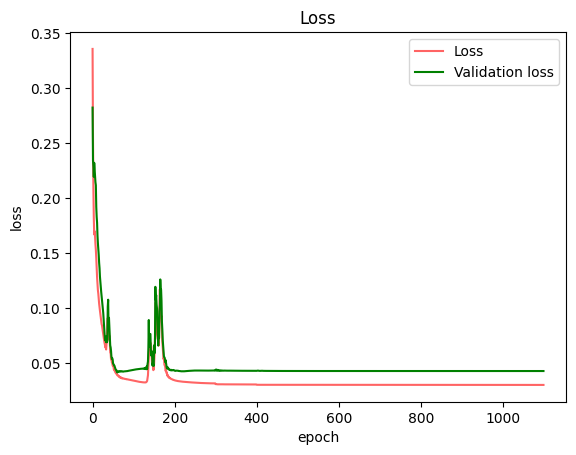

step 1, accuracy_train:0.634375, loss: 0.3373632481956931
step 2, accuracy_train:0.575, loss: 0.26195078894113966
step 3, accuracy_train:0.709375, loss: 0.20694436372541566
step 4, accuracy_train:0.771875, loss: 0.1870681010925995
step 5, accuracy_train:0.790625, loss: 0.1842271271042331
step 6, accuracy_train:0.821875, loss: 0.1858337137638655
step 7, accuracy_train:0.846875, loss: 0.1690490636882013
step 8, accuracy_train:0.871875, loss: 0.1551945549532982
step 9, accuracy_train:0.85625, loss: 0.14216143614503685
step 10, accuracy_train:0.846875, loss: 0.12894058897908406
step 11, accuracy_train:0.8625, loss: 0.12337455215418439
step 12, accuracy_train:0.890625, loss: 0.1126085681725047
step 13, accuracy_train:0.890625, loss: 0.10415846766607709
step 14, accuracy_train:0.8875, loss: 0.09671535279446818
step 15, accuracy_train:0.9, loss: 0.09090178428308854
step 16, accuracy_train:0.8875, loss: 0.08497423439917944
step 17, accuracy_train:0.903125, loss: 0.08125685623587015
step 18, ac

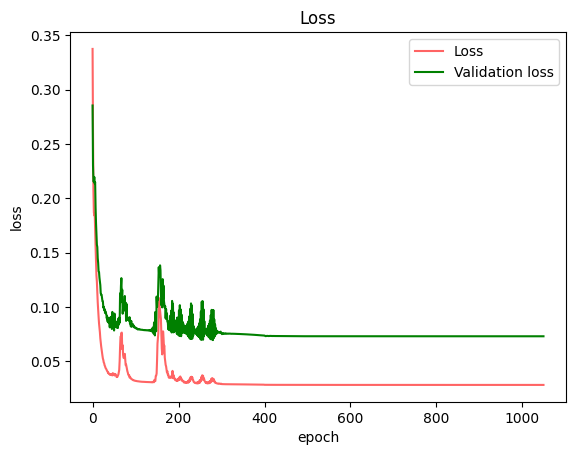

cv_time ：332.862362 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 300, 50, [0.05, 0.03, 0.01]]


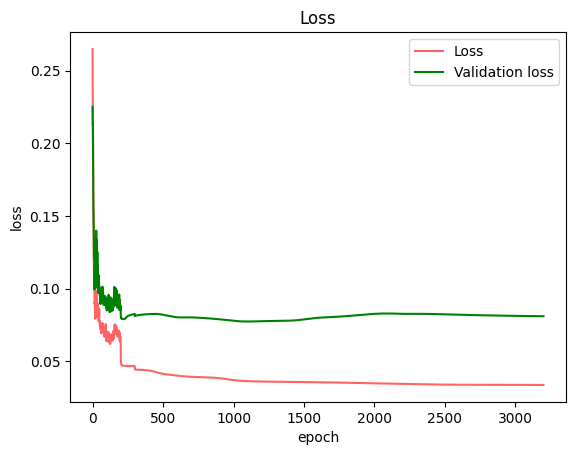

circuit is jitted
circuit is jitted
circuit is jitted
circuit is jitted


2024-07-20 19:21:49.070161: E external/org_tensorflow/tensorflow/compiler/xla/service/slow_operation_alarm.cc:65] 
********************************
[Compiling module jit_test] Very slow compile?  If you want to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
********************************
2024-07-20 19:21:53.856444: E external/org_tensorflow/tensorflow/compiler/xla/service/slow_operation_alarm.cc:133] The operation took 2m4.786419365s

********************************
[Compiling module jit_test] Very slow compile?  If you want to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
********************************


step 1, accuracy_train:0.696875, loss: 0.2575428731297536
circuit is jitted
circuit is jitted


2024-07-20 19:24:46.994390: E external/org_tensorflow/tensorflow/compiler/xla/service/slow_operation_alarm.cc:133] The operation took 2m25.866547059s

********************************
[Compiling module jit_test] Very slow compile?  If you want to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
********************************


step 2, accuracy_train:0.771875, loss: 0.21746426482455475
step 3, accuracy_train:0.78125, loss: 0.21303230406306867
step 4, accuracy_train:0.85, loss: 0.2056256247425381
step 5, accuracy_train:0.853125, loss: 0.19092557142329433
step 6, accuracy_train:0.88125, loss: 0.18608283705837725
step 7, accuracy_train:0.865625, loss: 0.18122964670766226
step 8, accuracy_train:0.878125, loss: 0.17513422250723798
step 9, accuracy_train:0.878125, loss: 0.16542457095320856
step 10, accuracy_train:0.871875, loss: 0.15637199621799258
step 11, accuracy_train:0.88125, loss: 0.153978419217644
step 12, accuracy_train:0.875, loss: 0.14936927049393606
step 13, accuracy_train:0.890625, loss: 0.13968289131487166
step 14, accuracy_train:0.8875, loss: 0.130568181569766
step 15, accuracy_train:0.890625, loss: 0.12732743607729533
step 16, accuracy_train:0.8875, loss: 0.13183265269835193
step 17, accuracy_train:0.871875, loss: 0.13984496924668194
step 18, accuracy_train:0.884375, loss: 0.1299258719473481
step 19,

2024-07-20 19:34:11.372577: E external/org_tensorflow/tensorflow/compiler/xla/service/slow_operation_alarm.cc:133] The operation took 2m27.650399342s

********************************
[Compiling module jit_test] Very slow compile?  If you want to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
********************************


Epoch:  0 | Cost: 0.050061 | Train accuracy: 0.940625 | Test Accuracy: 0.950000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 6, 1, 3, 3)


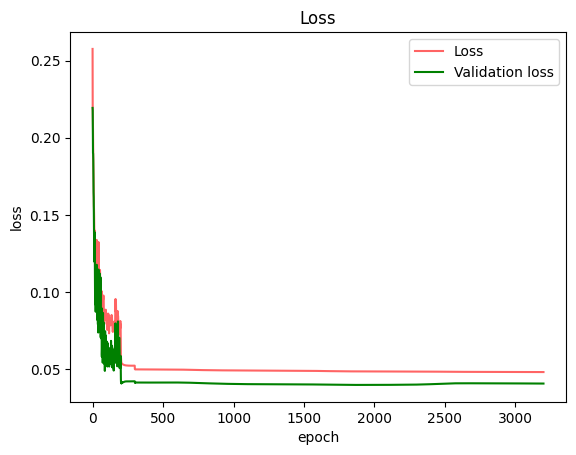

step 1, accuracy_train:0.7, loss: 0.25437207305396187
step 2, accuracy_train:0.803125, loss: 0.21105878116300286
step 3, accuracy_train:0.840625, loss: 0.20339865834905813
step 4, accuracy_train:0.85, loss: 0.18748709153724935
step 5, accuracy_train:0.88125, loss: 0.16890092978298077
step 6, accuracy_train:0.884375, loss: 0.15681801624201022
step 7, accuracy_train:0.88125, loss: 0.13842956956278826
step 8, accuracy_train:0.878125, loss: 0.12297954176222921
step 9, accuracy_train:0.9125, loss: 0.11563124879859912
step 10, accuracy_train:0.90625, loss: 0.09958318535781498
step 11, accuracy_train:0.878125, loss: 0.09921950322998344
step 12, accuracy_train:0.89375, loss: 0.10435068003898684
step 13, accuracy_train:0.903125, loss: 0.09500245133013381
step 14, accuracy_train:0.90625, loss: 0.09120341514582082
step 15, accuracy_train:0.89375, loss: 0.09495802774467269
step 16, accuracy_train:0.915625, loss: 0.09889840930871989
step 17, accuracy_train:0.90625, loss: 0.09350836793331108
step 18

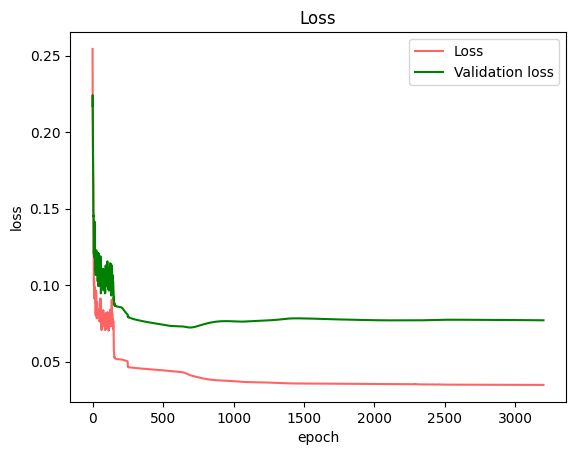

step 1, accuracy_train:0.671875, loss: 0.26330121201978474
step 2, accuracy_train:0.778125, loss: 0.22257382004664733
step 3, accuracy_train:0.728125, loss: 0.22473279283690312
step 4, accuracy_train:0.771875, loss: 0.21773917937709397
step 5, accuracy_train:0.815625, loss: 0.2115103932862341
step 6, accuracy_train:0.85625, loss: 0.19936195561957337
step 7, accuracy_train:0.825, loss: 0.20046454244737216
step 8, accuracy_train:0.840625, loss: 0.2006204034219734
step 9, accuracy_train:0.840625, loss: 0.19409661771319953
step 10, accuracy_train:0.86875, loss: 0.18751930997201294
step 11, accuracy_train:0.840625, loss: 0.1845098965250409
step 12, accuracy_train:0.871875, loss: 0.17654336577414645
step 13, accuracy_train:0.896875, loss: 0.16459721589250936
step 14, accuracy_train:0.88125, loss: 0.1553044125546333
step 15, accuracy_train:0.878125, loss: 0.14108201539653406
step 16, accuracy_train:0.89375, loss: 0.1290654951018365
step 17, accuracy_train:0.89375, loss: 0.12953015039479912
st

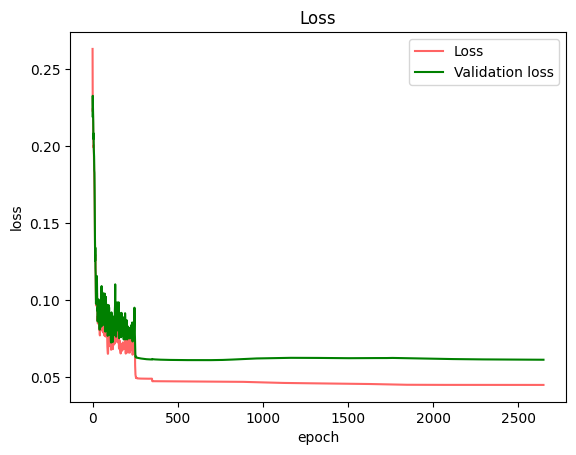

step 1, accuracy_train:0.690625, loss: 0.26237269689513876
step 2, accuracy_train:0.778125, loss: 0.2202796614999044
step 3, accuracy_train:0.778125, loss: 0.2218336049442642
step 4, accuracy_train:0.796875, loss: 0.2114017845643786
step 5, accuracy_train:0.85, loss: 0.20545728150238718
step 6, accuracy_train:0.840625, loss: 0.20079635448331784
step 7, accuracy_train:0.85, loss: 0.19618291949957684
step 8, accuracy_train:0.85625, loss: 0.19453220673945648
step 9, accuracy_train:0.865625, loss: 0.19784658339109656
step 10, accuracy_train:0.890625, loss: 0.19888296546704773
step 11, accuracy_train:0.85625, loss: 0.20233886559934872
step 12, accuracy_train:0.865625, loss: 0.20217566483843133
step 13, accuracy_train:0.859375, loss: 0.1941596246973326
step 14, accuracy_train:0.8375, loss: 0.19485051646964616
step 15, accuracy_train:0.859375, loss: 0.19408324860604786
step 16, accuracy_train:0.85, loss: 0.19187254147742308
step 17, accuracy_train:0.8625, loss: 0.19370533868747414
step 18, ac

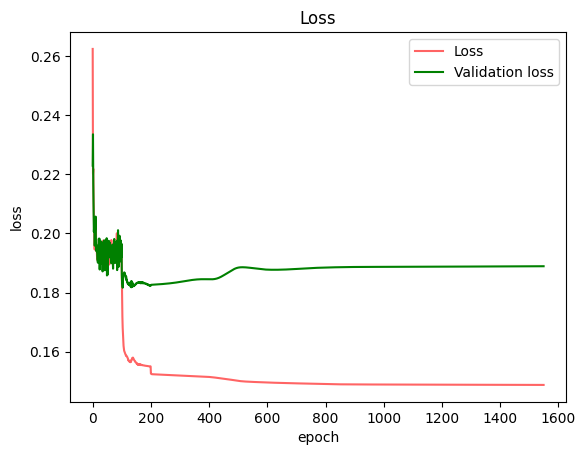

step 1, accuracy_train:0.69375, loss: 0.26387515132528555
step 2, accuracy_train:0.728125, loss: 0.2256843044789513
step 3, accuracy_train:0.840625, loss: 0.21769967752732433
step 4, accuracy_train:0.890625, loss: 0.2057617415890222
step 5, accuracy_train:0.88125, loss: 0.19816127013373136
step 6, accuracy_train:0.88125, loss: 0.20004288589033975
step 7, accuracy_train:0.91875, loss: 0.19647856358927007
step 8, accuracy_train:0.8875, loss: 0.20010499246423027
step 9, accuracy_train:0.90625, loss: 0.19521463040380507
step 10, accuracy_train:0.896875, loss: 0.19328959224048406
step 11, accuracy_train:0.884375, loss: 0.19197300601266498
step 12, accuracy_train:0.896875, loss: 0.1936732815113134
step 13, accuracy_train:0.88125, loss: 0.19377962129327714
step 14, accuracy_train:0.875, loss: 0.18975179799210767
step 15, accuracy_train:0.875, loss: 0.1872582062532488
step 16, accuracy_train:0.871875, loss: 0.1884533906785458
step 17, accuracy_train:0.909375, loss: 0.18272336853125726
step 18,

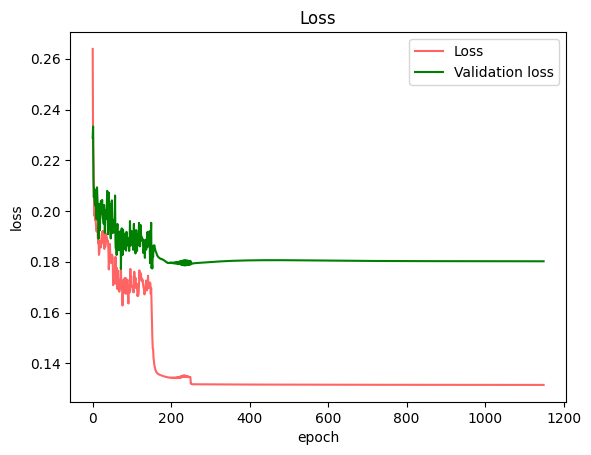

cv_time ：2045.309102 s
[[0.15, 0.05, 0.01], 3200, 50, 50, [0.05, 0.03, 0.01]]
circuit is jitted
circuit is jitted


2024-07-20 19:53:33.502085: E external/org_tensorflow/tensorflow/compiler/xla/service/slow_operation_alarm.cc:65] 
********************************
[Compiling module jit_test] Very slow compile?  If you want to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
********************************
2024-07-20 19:54:05.453046: E external/org_tensorflow/tensorflow/compiler/xla/service/slow_operation_alarm.cc:133] The operation took 2m31.951139215s

********************************
[Compiling module jit_test] Very slow compile?  If you want to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
********************************


step 1, accuracy_train:0.640625, loss: 0.2986265503610209
step 2, accuracy_train:0.7125, loss: 0.21265654279957058
step 3, accuracy_train:0.821875, loss: 0.20387870339991343
step 4, accuracy_train:0.8375, loss: 0.21371547247215839
step 5, accuracy_train:0.84375, loss: 0.20018611570032946
step 6, accuracy_train:0.81875, loss: 0.1882239443616359
step 7, accuracy_train:0.86875, loss: 0.17963517609824287
step 8, accuracy_train:0.878125, loss: 0.17041035509544256
step 9, accuracy_train:0.9, loss: 0.15951315728291204
step 10, accuracy_train:0.90625, loss: 0.1542084991981177
step 11, accuracy_train:0.909375, loss: 0.14242669046170825
step 12, accuracy_train:0.90625, loss: 0.1358220048427029
step 13, accuracy_train:0.909375, loss: 0.12756463818487357
step 14, accuracy_train:0.909375, loss: 0.11919656982075202
step 15, accuracy_train:0.9, loss: 0.10883910178406339
step 16, accuracy_train:0.896875, loss: 0.10442674108477847
step 17, accuracy_train:0.903125, loss: 0.10580683884589676
step 18, acc

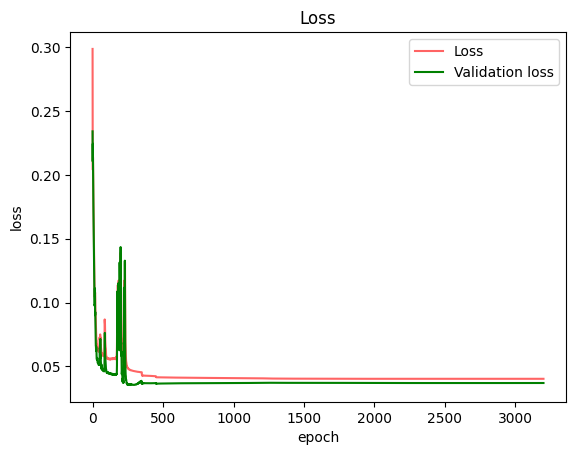

step 1, accuracy_train:0.671875, loss: 0.2937002400349478
step 2, accuracy_train:0.790625, loss: 0.20762629419412684
step 3, accuracy_train:0.85, loss: 0.19540941124512254
step 4, accuracy_train:0.846875, loss: 0.2028591786376398
step 5, accuracy_train:0.89375, loss: 0.18585305621654202
step 6, accuracy_train:0.884375, loss: 0.17796661698239497
step 7, accuracy_train:0.915625, loss: 0.16323020338553496
step 8, accuracy_train:0.9125, loss: 0.15350509457995146
step 9, accuracy_train:0.921875, loss: 0.1429946454490744
step 10, accuracy_train:0.909375, loss: 0.13305103687042608
step 11, accuracy_train:0.8875, loss: 0.12210878054389708
step 12, accuracy_train:0.915625, loss: 0.11220089959065918
step 13, accuracy_train:0.903125, loss: 0.10179908037304326
step 14, accuracy_train:0.90625, loss: 0.09575659897205265
step 15, accuracy_train:0.9, loss: 0.08637182667708079
step 16, accuracy_train:0.915625, loss: 0.07912787892612183
step 17, accuracy_train:0.915625, loss: 0.07144652291117257
step 18

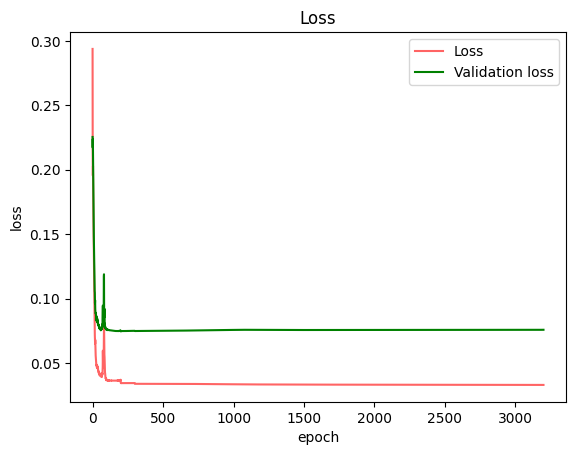

step 1, accuracy_train:0.64375, loss: 0.2929866993181014
step 2, accuracy_train:0.753125, loss: 0.21032351287888493
step 3, accuracy_train:0.853125, loss: 0.20307900717561145
step 4, accuracy_train:0.85625, loss: 0.20995651015163397
step 5, accuracy_train:0.834375, loss: 0.20335488605438357
step 6, accuracy_train:0.8625, loss: 0.19105450428379694
step 7, accuracy_train:0.859375, loss: 0.1819898178945669
step 8, accuracy_train:0.875, loss: 0.17141369467138243
step 9, accuracy_train:0.86875, loss: 0.16432986548808684
step 10, accuracy_train:0.890625, loss: 0.15197977012411842
step 11, accuracy_train:0.8875, loss: 0.14474661546471357
step 12, accuracy_train:0.89375, loss: 0.1376184138090457
step 13, accuracy_train:0.915625, loss: 0.13030823954064166
step 14, accuracy_train:0.925, loss: 0.12511684262330441
step 15, accuracy_train:0.925, loss: 0.11647213697298853
step 16, accuracy_train:0.925, loss: 0.11147439356506057
step 17, accuracy_train:0.928125, loss: 0.10520494790949067
step 18, acc

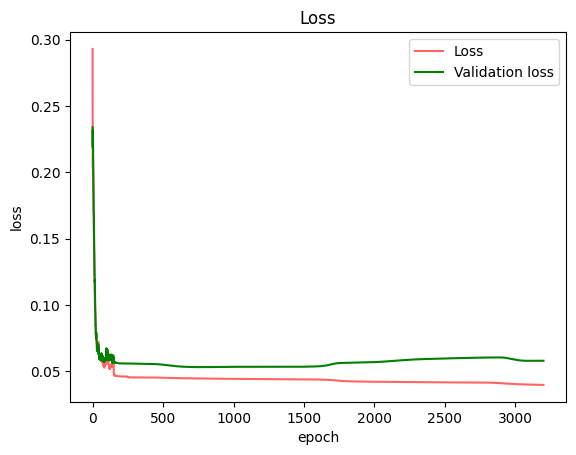

step 1, accuracy_train:0.6625, loss: 0.29239207959155333
step 2, accuracy_train:0.7625, loss: 0.2109273660534721
step 3, accuracy_train:0.821875, loss: 0.2033279138299957
step 4, accuracy_train:0.834375, loss: 0.20238072313303543
step 5, accuracy_train:0.79375, loss: 0.20079021204167055
step 6, accuracy_train:0.85625, loss: 0.19121285332829935
step 7, accuracy_train:0.878125, loss: 0.1772621258223343
step 8, accuracy_train:0.9125, loss: 0.1669305456662267
step 9, accuracy_train:0.915625, loss: 0.15527824478722968
step 10, accuracy_train:0.925, loss: 0.1457150901457219
step 11, accuracy_train:0.934375, loss: 0.1361537809028566
step 12, accuracy_train:0.921875, loss: 0.1245194633548567
step 13, accuracy_train:0.9375, loss: 0.11492549614284386
step 14, accuracy_train:0.934375, loss: 0.10518420995465248
step 15, accuracy_train:0.934375, loss: 0.10159041514649461
step 16, accuracy_train:0.921875, loss: 0.10295256497479283
step 17, accuracy_train:0.921875, loss: 0.09758925698705379
step 18, 

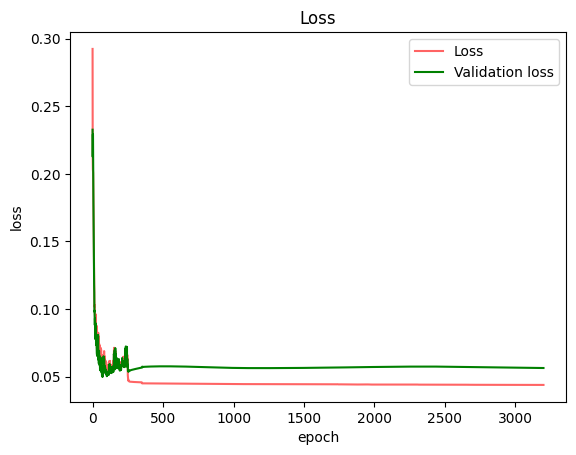

step 1, accuracy_train:0.653125, loss: 0.2932120364350929
step 2, accuracy_train:0.803125, loss: 0.2114297699321358
step 3, accuracy_train:0.81875, loss: 0.21121149784710758
step 4, accuracy_train:0.778125, loss: 0.2140270616339708
step 5, accuracy_train:0.85, loss: 0.19776923956878045
step 6, accuracy_train:0.853125, loss: 0.18627762198976455
step 7, accuracy_train:0.90625, loss: 0.17007392558079198
step 8, accuracy_train:0.884375, loss: 0.16232676434841384
step 9, accuracy_train:0.909375, loss: 0.14731791807782182
step 10, accuracy_train:0.9, loss: 0.1425900087816077
step 11, accuracy_train:0.9125, loss: 0.1277493219361029
step 12, accuracy_train:0.915625, loss: 0.12626351029291427
step 13, accuracy_train:0.9125, loss: 0.11839381864811091
step 14, accuracy_train:0.903125, loss: 0.11953104048080126
step 15, accuracy_train:0.93125, loss: 0.10891621614217134
step 16, accuracy_train:0.91875, loss: 0.10868373764660175
step 17, accuracy_train:0.921875, loss: 0.09741585989056095
step 18, ac

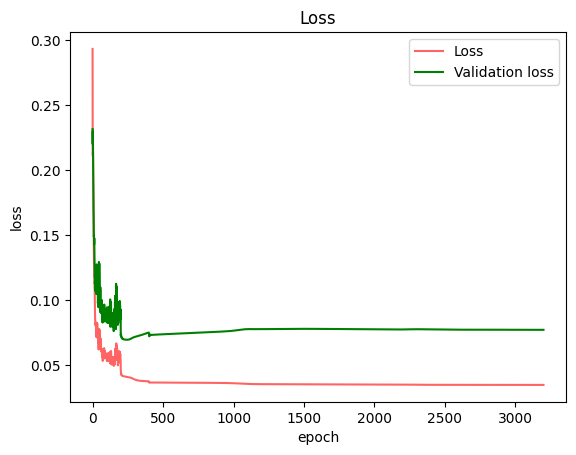

cv_time ：2203.018516 s
[[0.15, 0.05, 0.01], 3200, 100, 50, [0.05, 0.03, 0.01]]
circuit is jitted
circuit is jitted


2024-07-20 20:30:50.051327: E external/org_tensorflow/tensorflow/compiler/xla/service/slow_operation_alarm.cc:133] The operation took 2m39.332054661s

********************************
[Compiling module jit_test] Very slow compile?  If you want to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
********************************


step 1, accuracy_train:0.60625, loss: 0.3391438433671152
step 2, accuracy_train:0.753125, loss: 0.24851128149719928
step 3, accuracy_train:0.76875, loss: 0.1959998612480099
step 4, accuracy_train:0.815625, loss: 0.17220842087767163
step 5, accuracy_train:0.8375, loss: 0.16582251591038374
step 6, accuracy_train:0.840625, loss: 0.17412576846463812
step 7, accuracy_train:0.85625, loss: 0.17215420044040422
step 8, accuracy_train:0.8875, loss: 0.1673341825853034
step 9, accuracy_train:0.903125, loss: 0.1588763228748303
step 10, accuracy_train:0.89375, loss: 0.15157958456885112
step 11, accuracy_train:0.890625, loss: 0.1442439484289344
step 12, accuracy_train:0.915625, loss: 0.13903770530881032
step 13, accuracy_train:0.909375, loss: 0.13492644750739968
step 14, accuracy_train:0.909375, loss: 0.13004169070645955
step 15, accuracy_train:0.915625, loss: 0.1281265796006541
step 16, accuracy_train:0.903125, loss: 0.12228657458014663
step 17, accuracy_train:0.890625, loss: 0.11931211702951405
ste

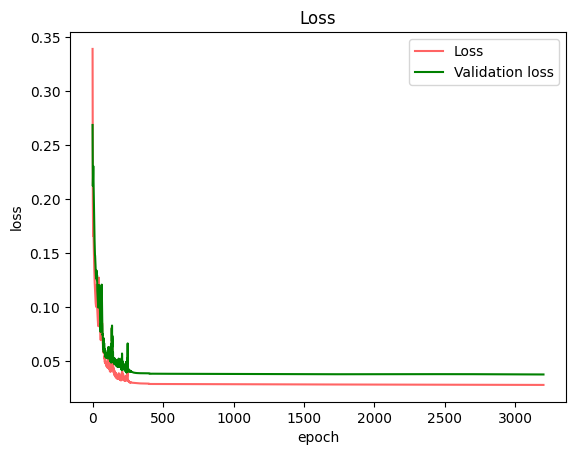

step 1, accuracy_train:0.61875, loss: 0.3406184949623213
step 2, accuracy_train:0.69375, loss: 0.2544235866271024
step 3, accuracy_train:0.80625, loss: 0.20090082857872246
step 4, accuracy_train:0.815625, loss: 0.17463398621103254
step 5, accuracy_train:0.8375, loss: 0.16922648104407173
step 6, accuracy_train:0.890625, loss: 0.16729658877970005
step 7, accuracy_train:0.88125, loss: 0.17165735902384524
step 8, accuracy_train:0.896875, loss: 0.16767315190735774
step 9, accuracy_train:0.91875, loss: 0.16342192247029
step 10, accuracy_train:0.925, loss: 0.15649406235473465
step 11, accuracy_train:0.91875, loss: 0.14725235714715448
step 12, accuracy_train:0.915625, loss: 0.14151072475698503
step 13, accuracy_train:0.928125, loss: 0.1362116524806207
step 14, accuracy_train:0.915625, loss: 0.13371052549341073
step 15, accuracy_train:0.921875, loss: 0.1298715119718213
step 16, accuracy_train:0.934375, loss: 0.1259641424553672
step 17, accuracy_train:0.928125, loss: 0.12172255920633587
step 18,

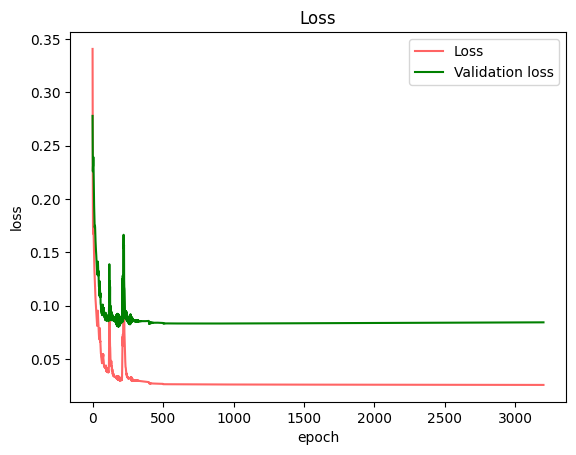

step 1, accuracy_train:0.625, loss: 0.3360712152002172
step 2, accuracy_train:0.709375, loss: 0.2533888958884659
step 3, accuracy_train:0.740625, loss: 0.20343491706510156
step 4, accuracy_train:0.790625, loss: 0.17741018489298715
step 5, accuracy_train:0.803125, loss: 0.17082936899679702
step 6, accuracy_train:0.9, loss: 0.16905671105898581
step 7, accuracy_train:0.89375, loss: 0.17135492861201093
step 8, accuracy_train:0.8875, loss: 0.1647660832387054
step 9, accuracy_train:0.903125, loss: 0.16127879534870193
step 10, accuracy_train:0.9, loss: 0.15121138817733354
step 11, accuracy_train:0.925, loss: 0.14618340069191593
step 12, accuracy_train:0.915625, loss: 0.14104241381052038
step 13, accuracy_train:0.915625, loss: 0.13263370950276737
step 14, accuracy_train:0.921875, loss: 0.12921970454323622
step 15, accuracy_train:0.928125, loss: 0.12585501088459117
step 16, accuracy_train:0.934375, loss: 0.12102209529910929
step 17, accuracy_train:0.93125, loss: 0.11542988920564137
step 18, acc

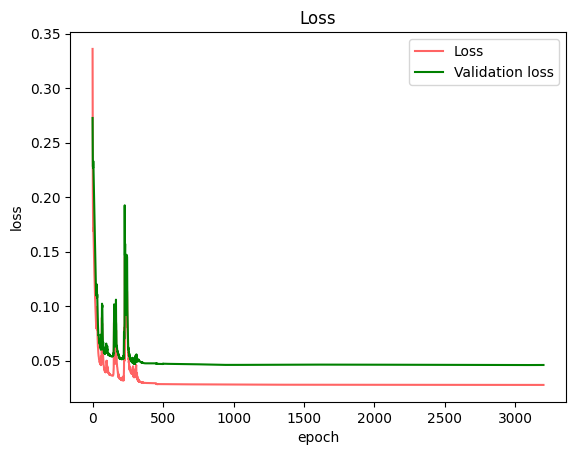

step 1, accuracy_train:0.603125, loss: 0.3380372528796699
step 2, accuracy_train:0.671875, loss: 0.25961928034990817
step 3, accuracy_train:0.703125, loss: 0.2081185330787013
step 4, accuracy_train:0.728125, loss: 0.18726307862602914
step 5, accuracy_train:0.73125, loss: 0.1770233227630749
step 6, accuracy_train:0.803125, loss: 0.17947460711060187
step 7, accuracy_train:0.853125, loss: 0.1766263574493365
step 8, accuracy_train:0.86875, loss: 0.16970802150109238
step 9, accuracy_train:0.88125, loss: 0.16270384764912912
step 10, accuracy_train:0.896875, loss: 0.15244154719080266
step 11, accuracy_train:0.909375, loss: 0.14518215017473682
step 12, accuracy_train:0.91875, loss: 0.134910245716471
step 13, accuracy_train:0.91875, loss: 0.13093466375588148
step 14, accuracy_train:0.91875, loss: 0.12488319105067394
step 15, accuracy_train:0.903125, loss: 0.1227530250829435
step 16, accuracy_train:0.896875, loss: 0.11795704861108426
step 17, accuracy_train:0.9125, loss: 0.11393117460317105
step

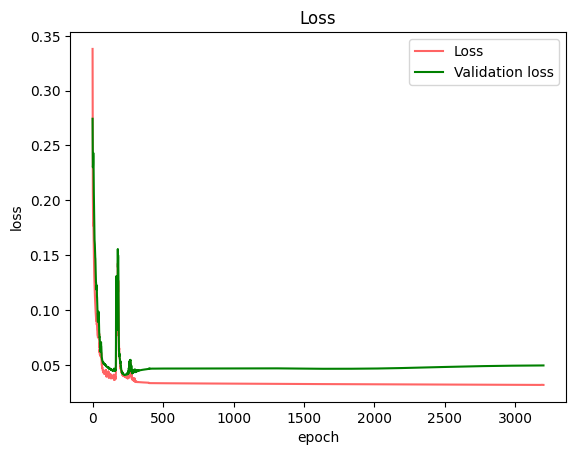

step 1, accuracy_train:0.634375, loss: 0.33412064332589547
step 2, accuracy_train:0.68125, loss: 0.2612366473335702
step 3, accuracy_train:0.76875, loss: 0.2041299665570399
step 4, accuracy_train:0.79375, loss: 0.18310376109288357
step 5, accuracy_train:0.809375, loss: 0.18127696284974829
step 6, accuracy_train:0.853125, loss: 0.18178817592785718
step 7, accuracy_train:0.846875, loss: 0.17637406337774758
step 8, accuracy_train:0.878125, loss: 0.17496714915344375
step 9, accuracy_train:0.909375, loss: 0.16244977659947632
step 10, accuracy_train:0.89375, loss: 0.14869628964443699
step 11, accuracy_train:0.903125, loss: 0.14053523705607587
step 12, accuracy_train:0.909375, loss: 0.13194023281240186
step 13, accuracy_train:0.9125, loss: 0.12447078826200839
step 14, accuracy_train:0.915625, loss: 0.11854522451277003
step 15, accuracy_train:0.903125, loss: 0.11045780391302118
step 16, accuracy_train:0.89375, loss: 0.10790501072599923
step 17, accuracy_train:0.903125, loss: 0.1022988590142811

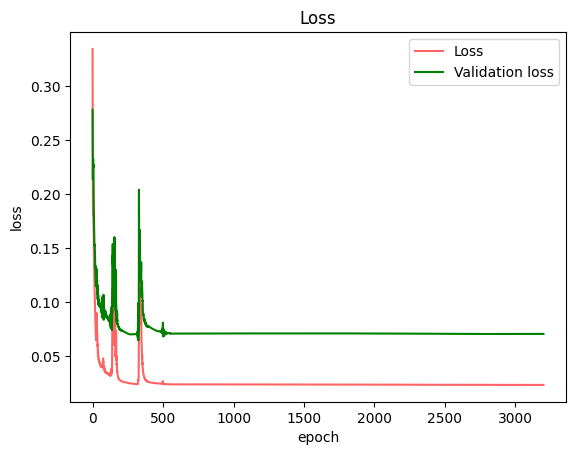

cv_time ：2065.436384 s
[[0.15, 0.05, 0.01], 3200, 300, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.696875, loss: 0.2575428731297536
step 2, accuracy_train:0.771875, loss: 0.21746426482455475
step 3, accuracy_train:0.78125, loss: 0.21303230406306867
step 4, accuracy_train:0.85, loss: 0.2056256247425381
step 5, accuracy_train:0.853125, loss: 0.19092557142329433
step 6, accuracy_train:0.88125, loss: 0.18608283705837725
step 7, accuracy_train:0.865625, loss: 0.18122964670766226
step 8, accuracy_train:0.878125, loss: 0.17513422250723798
step 9, accuracy_train:0.878125, loss: 0.16542457095320856
step 10, accuracy_train:0.871875, loss: 0.15637199621799258
step 11, accuracy_train:0.88125, loss: 0.153978419217644
step 12, accuracy_train:0.875, loss: 0.14936927049393606
step 13, accuracy_train:0.890625, loss: 0.13968289131487166
step 14, accuracy_train:0.8875, loss: 0.130568181569766
step 15, accuracy_train:0.890625, loss: 0.12732743607729533
step 16, accuracy_train:0.8875, loss: 0.13183265

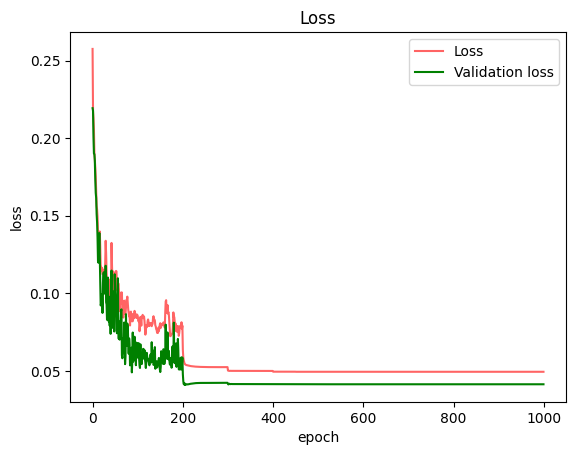

step 1, accuracy_train:0.7, loss: 0.25437207305396187
step 2, accuracy_train:0.803125, loss: 0.21105878116300286
step 3, accuracy_train:0.840625, loss: 0.20339865834905813
step 4, accuracy_train:0.85, loss: 0.18748709153724935
step 5, accuracy_train:0.88125, loss: 0.16890092978298077
step 6, accuracy_train:0.884375, loss: 0.15681801624201022
step 7, accuracy_train:0.88125, loss: 0.13842956956278826
step 8, accuracy_train:0.878125, loss: 0.12297954176222921
step 9, accuracy_train:0.9125, loss: 0.11563124879859912
step 10, accuracy_train:0.90625, loss: 0.09958318535781498
step 11, accuracy_train:0.878125, loss: 0.09921950322998344
step 12, accuracy_train:0.89375, loss: 0.10435068003898684
step 13, accuracy_train:0.903125, loss: 0.09500245133013381
step 14, accuracy_train:0.90625, loss: 0.09120341514582082
step 15, accuracy_train:0.89375, loss: 0.09495802774467269
step 16, accuracy_train:0.915625, loss: 0.09889840930871989
step 17, accuracy_train:0.90625, loss: 0.09350836793331108
step 18

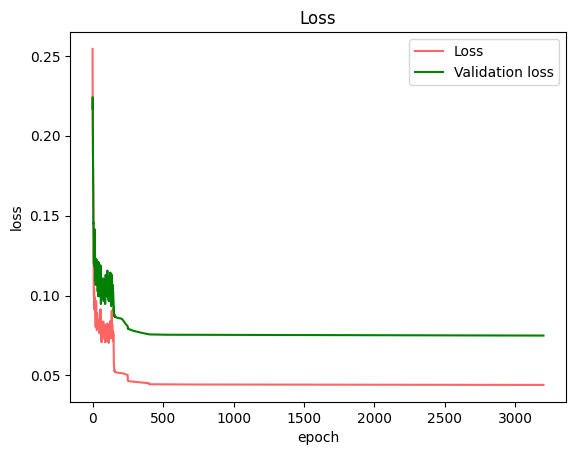

step 1, accuracy_train:0.671875, loss: 0.26330121201978474
step 2, accuracy_train:0.778125, loss: 0.22257382004664733
step 3, accuracy_train:0.728125, loss: 0.22473279283690312
step 4, accuracy_train:0.771875, loss: 0.21773917937709397
step 5, accuracy_train:0.815625, loss: 0.2115103932862341
step 6, accuracy_train:0.85625, loss: 0.19936195561957337
step 7, accuracy_train:0.825, loss: 0.20046454244737216
step 8, accuracy_train:0.840625, loss: 0.2006204034219734
step 9, accuracy_train:0.840625, loss: 0.19409661771319953
step 10, accuracy_train:0.86875, loss: 0.18751930997201294
step 11, accuracy_train:0.840625, loss: 0.1845098965250409
step 12, accuracy_train:0.871875, loss: 0.17654336577414645
step 13, accuracy_train:0.896875, loss: 0.16459721589250936
step 14, accuracy_train:0.88125, loss: 0.1553044125546333
step 15, accuracy_train:0.878125, loss: 0.14108201539653406
step 16, accuracy_train:0.89375, loss: 0.1290654951018365
step 17, accuracy_train:0.89375, loss: 0.12953015039479912
st

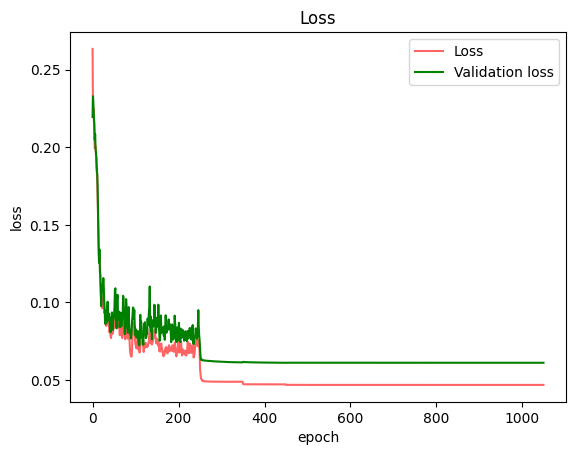

step 1, accuracy_train:0.690625, loss: 0.26237269689513876
step 2, accuracy_train:0.778125, loss: 0.2202796614999044
step 3, accuracy_train:0.778125, loss: 0.2218336049442642
step 4, accuracy_train:0.796875, loss: 0.2114017845643786
step 5, accuracy_train:0.85, loss: 0.20545728150238718
step 6, accuracy_train:0.840625, loss: 0.20079635448331784
step 7, accuracy_train:0.85, loss: 0.19618291949957684
step 8, accuracy_train:0.85625, loss: 0.19453220673945648
step 9, accuracy_train:0.865625, loss: 0.19784658339109656
step 10, accuracy_train:0.890625, loss: 0.19888296546704773
step 11, accuracy_train:0.85625, loss: 0.20233886559934872
step 12, accuracy_train:0.865625, loss: 0.20217566483843133
step 13, accuracy_train:0.859375, loss: 0.1941596246973326
step 14, accuracy_train:0.8375, loss: 0.19485051646964616
step 15, accuracy_train:0.859375, loss: 0.19408324860604786
step 16, accuracy_train:0.85, loss: 0.19187254147742308
step 17, accuracy_train:0.8625, loss: 0.19370533868747414
step 18, ac

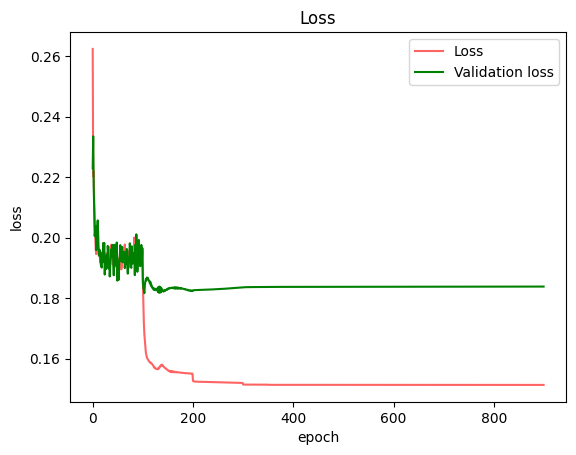

step 1, accuracy_train:0.69375, loss: 0.26387515132528555
step 2, accuracy_train:0.728125, loss: 0.2256843044789513
step 3, accuracy_train:0.840625, loss: 0.21769967752732433
step 4, accuracy_train:0.890625, loss: 0.2057617415890222
step 5, accuracy_train:0.88125, loss: 0.19816127013373136
step 6, accuracy_train:0.88125, loss: 0.20004288589033975
step 7, accuracy_train:0.91875, loss: 0.19647856358927007
step 8, accuracy_train:0.8875, loss: 0.20010499246423027
step 9, accuracy_train:0.90625, loss: 0.19521463040380507
step 10, accuracy_train:0.896875, loss: 0.19328959224048406
step 11, accuracy_train:0.884375, loss: 0.19197300601266498
step 12, accuracy_train:0.896875, loss: 0.1936732815113134
step 13, accuracy_train:0.88125, loss: 0.19377962129327714
step 14, accuracy_train:0.875, loss: 0.18975179799210767
step 15, accuracy_train:0.875, loss: 0.1872582062532488
step 16, accuracy_train:0.871875, loss: 0.1884533906785458
step 17, accuracy_train:0.909375, loss: 0.18272336853125726
step 18,

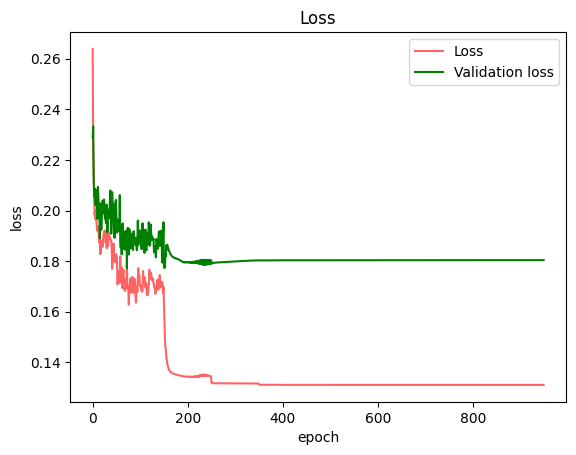

cv_time ：888.383621 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 50, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.640625, loss: 0.2986265503610209
step 2, accuracy_train:0.7125, loss: 0.21265654279957058
step 3, accuracy_train:0.821875, loss: 0.20387870339991343
step 4, accuracy_train:0.8375, loss: 0.21371547247215839
step 5, accuracy_train:0.84375, loss: 0.20018611570032946
step 6, accuracy_train:0.81875, loss: 0.1882239443616359
step 7, accuracy_train:0.86875, loss: 0.17963517609824287
step 8, accuracy_train:0.878125, loss: 0.17041035509544256
step 9, accuracy_train:0.9, loss: 0.15951315728291204
step 10, accuracy_train:0.90625, loss: 0.1542084991981177
step 11, accuracy_train:0.909375, loss: 0.14242669046170825
step 12, accuracy_train:0.90625, loss: 0.1358220048427029
step 13, accuracy_train:0.909375, loss: 0.12756463818487357
step 14, accuracy_train:0.909375, loss: 0.11919656982075202
step 15, accuracy_train:0.9, loss: 0.10883910178406339
step 16, accuracy_train:0.896875, loss: 

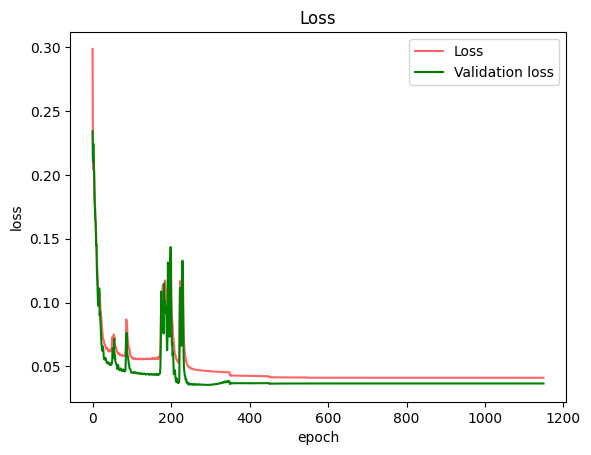

step 1, accuracy_train:0.671875, loss: 0.2937002400349478
step 2, accuracy_train:0.790625, loss: 0.20762629419412684
step 3, accuracy_train:0.85, loss: 0.19540941124512254
step 4, accuracy_train:0.846875, loss: 0.2028591786376398
step 5, accuracy_train:0.89375, loss: 0.18585305621654202
step 6, accuracy_train:0.884375, loss: 0.17796661698239497
step 7, accuracy_train:0.915625, loss: 0.16323020338553496
step 8, accuracy_train:0.9125, loss: 0.15350509457995146
step 9, accuracy_train:0.921875, loss: 0.1429946454490744
step 10, accuracy_train:0.909375, loss: 0.13305103687042608
step 11, accuracy_train:0.8875, loss: 0.12210878054389708
step 12, accuracy_train:0.915625, loss: 0.11220089959065918
step 13, accuracy_train:0.903125, loss: 0.10179908037304326
step 14, accuracy_train:0.90625, loss: 0.09575659897205265
step 15, accuracy_train:0.9, loss: 0.08637182667708079
step 16, accuracy_train:0.915625, loss: 0.07912787892612183
step 17, accuracy_train:0.915625, loss: 0.07144652291117257
step 18

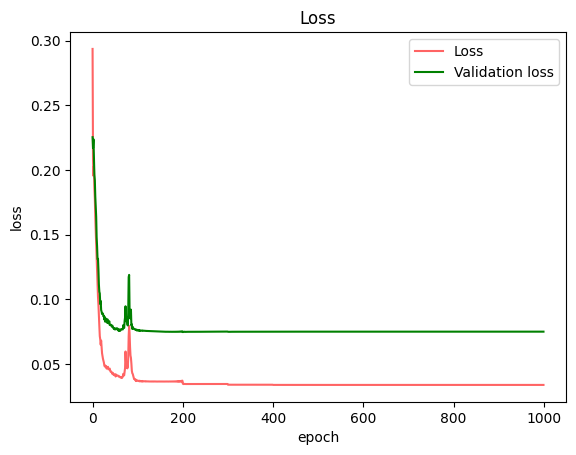

step 1, accuracy_train:0.64375, loss: 0.2929866993181014
step 2, accuracy_train:0.753125, loss: 0.21032351287888493
step 3, accuracy_train:0.853125, loss: 0.20307900717561145
step 4, accuracy_train:0.85625, loss: 0.20995651015163397
step 5, accuracy_train:0.834375, loss: 0.20335488605438357
step 6, accuracy_train:0.8625, loss: 0.19105450428379694
step 7, accuracy_train:0.859375, loss: 0.1819898178945669
step 8, accuracy_train:0.875, loss: 0.17141369467138243
step 9, accuracy_train:0.86875, loss: 0.16432986548808684
step 10, accuracy_train:0.890625, loss: 0.15197977012411842
step 11, accuracy_train:0.8875, loss: 0.14474661546471357
step 12, accuracy_train:0.89375, loss: 0.1376184138090457
step 13, accuracy_train:0.915625, loss: 0.13030823954064166
step 14, accuracy_train:0.925, loss: 0.12511684262330441
step 15, accuracy_train:0.925, loss: 0.11647213697298853
step 16, accuracy_train:0.925, loss: 0.11147439356506057
step 17, accuracy_train:0.928125, loss: 0.10520494790949067
step 18, acc

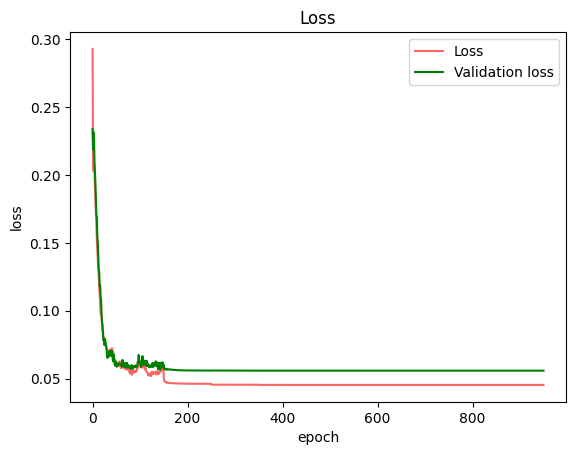

step 1, accuracy_train:0.6625, loss: 0.29239207959155333
step 2, accuracy_train:0.7625, loss: 0.2109273660534721
step 3, accuracy_train:0.821875, loss: 0.2033279138299957
step 4, accuracy_train:0.834375, loss: 0.20238072313303543
step 5, accuracy_train:0.79375, loss: 0.20079021204167055
step 6, accuracy_train:0.85625, loss: 0.19121285332829935
step 7, accuracy_train:0.878125, loss: 0.1772621258223343
step 8, accuracy_train:0.9125, loss: 0.1669305456662267
step 9, accuracy_train:0.915625, loss: 0.15527824478722968
step 10, accuracy_train:0.925, loss: 0.1457150901457219
step 11, accuracy_train:0.934375, loss: 0.1361537809028566
step 12, accuracy_train:0.921875, loss: 0.1245194633548567
step 13, accuracy_train:0.9375, loss: 0.11492549614284386
step 14, accuracy_train:0.934375, loss: 0.10518420995465248
step 15, accuracy_train:0.934375, loss: 0.10159041514649461
step 16, accuracy_train:0.921875, loss: 0.10295256497479283
step 17, accuracy_train:0.921875, loss: 0.09758925698705379
step 18, 

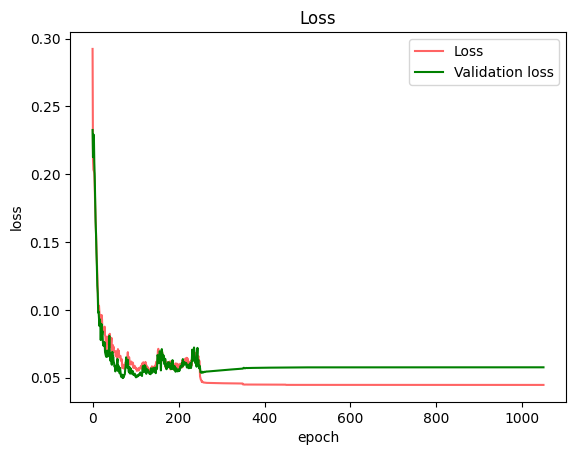

step 1, accuracy_train:0.653125, loss: 0.2932120364350929
step 2, accuracy_train:0.803125, loss: 0.2114297699321358
step 3, accuracy_train:0.81875, loss: 0.21121149784710758
step 4, accuracy_train:0.778125, loss: 0.2140270616339708
step 5, accuracy_train:0.85, loss: 0.19776923956878045
step 6, accuracy_train:0.853125, loss: 0.18627762198976455
step 7, accuracy_train:0.90625, loss: 0.17007392558079198
step 8, accuracy_train:0.884375, loss: 0.16232676434841384
step 9, accuracy_train:0.909375, loss: 0.14731791807782182
step 10, accuracy_train:0.9, loss: 0.1425900087816077
step 11, accuracy_train:0.9125, loss: 0.1277493219361029
step 12, accuracy_train:0.915625, loss: 0.12626351029291427
step 13, accuracy_train:0.9125, loss: 0.11839381864811091
step 14, accuracy_train:0.903125, loss: 0.11953104048080126
step 15, accuracy_train:0.93125, loss: 0.10891621614217134
step 16, accuracy_train:0.91875, loss: 0.10868373764660175
step 17, accuracy_train:0.921875, loss: 0.09741585989056095
step 18, ac

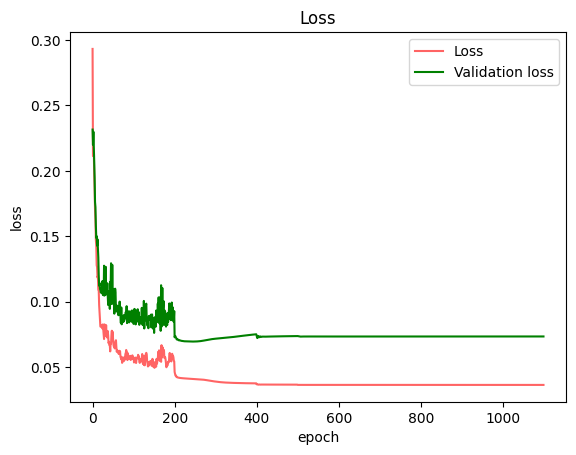

cv_time ：563.550762 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 100, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.60625, loss: 0.3391438433671152
step 2, accuracy_train:0.753125, loss: 0.24851128149719928
step 3, accuracy_train:0.76875, loss: 0.1959998612480099
step 4, accuracy_train:0.815625, loss: 0.17220842087767163
step 5, accuracy_train:0.8375, loss: 0.16582251591038374
step 6, accuracy_train:0.840625, loss: 0.17412576846463812
step 7, accuracy_train:0.85625, loss: 0.17215420044040422
step 8, accuracy_train:0.8875, loss: 0.1673341825853034
step 9, accuracy_train:0.903125, loss: 0.1588763228748303
step 10, accuracy_train:0.89375, loss: 0.15157958456885112
step 11, accuracy_train:0.890625, loss: 0.1442439484289344
step 12, accuracy_train:0.915625, loss: 0.13903770530881032
step 13, accuracy_train:0.909375, loss: 0.13492644750739968
step 14, accuracy_train:0.909375, loss: 0.13004169070645955
step 15, accuracy_train:0.915625, loss: 0.1281265796006541
step 16, accuracy_train:0.9031

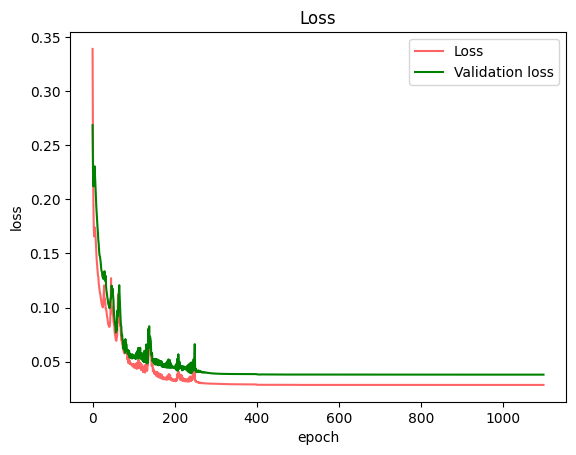

step 1, accuracy_train:0.61875, loss: 0.3406184949623213
step 2, accuracy_train:0.69375, loss: 0.2544235866271024
step 3, accuracy_train:0.80625, loss: 0.20090082857872246
step 4, accuracy_train:0.815625, loss: 0.17463398621103254
step 5, accuracy_train:0.8375, loss: 0.16922648104407173
step 6, accuracy_train:0.890625, loss: 0.16729658877970005
step 7, accuracy_train:0.88125, loss: 0.17165735902384524
step 8, accuracy_train:0.896875, loss: 0.16767315190735774
step 9, accuracy_train:0.91875, loss: 0.16342192247029
step 10, accuracy_train:0.925, loss: 0.15649406235473465
step 11, accuracy_train:0.91875, loss: 0.14725235714715448
step 12, accuracy_train:0.915625, loss: 0.14151072475698503
step 13, accuracy_train:0.928125, loss: 0.1362116524806207
step 14, accuracy_train:0.915625, loss: 0.13371052549341073
step 15, accuracy_train:0.921875, loss: 0.1298715119718213
step 16, accuracy_train:0.934375, loss: 0.1259641424553672
step 17, accuracy_train:0.928125, loss: 0.12172255920633587
step 18,

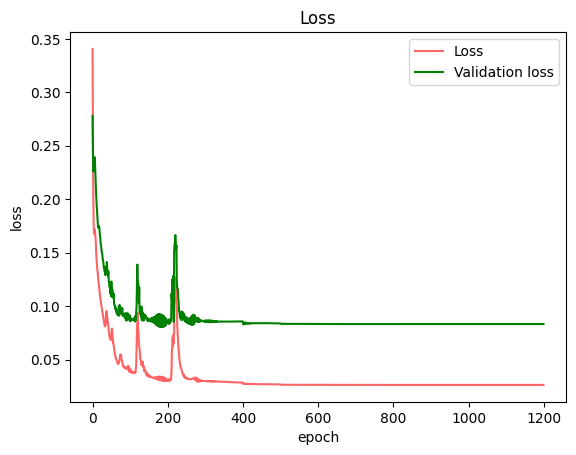

step 1, accuracy_train:0.625, loss: 0.3360712152002172
step 2, accuracy_train:0.709375, loss: 0.2533888958884659
step 3, accuracy_train:0.740625, loss: 0.20343491706510156
step 4, accuracy_train:0.790625, loss: 0.17741018489298715
step 5, accuracy_train:0.803125, loss: 0.17082936899679702
step 6, accuracy_train:0.9, loss: 0.16905671105898581
step 7, accuracy_train:0.89375, loss: 0.17135492861201093
step 8, accuracy_train:0.8875, loss: 0.1647660832387054
step 9, accuracy_train:0.903125, loss: 0.16127879534870193
step 10, accuracy_train:0.9, loss: 0.15121138817733354
step 11, accuracy_train:0.925, loss: 0.14618340069191593
step 12, accuracy_train:0.915625, loss: 0.14104241381052038
step 13, accuracy_train:0.915625, loss: 0.13263370950276737
step 14, accuracy_train:0.921875, loss: 0.12921970454323622
step 15, accuracy_train:0.928125, loss: 0.12585501088459117
step 16, accuracy_train:0.934375, loss: 0.12102209529910929
step 17, accuracy_train:0.93125, loss: 0.11542988920564137
step 18, acc

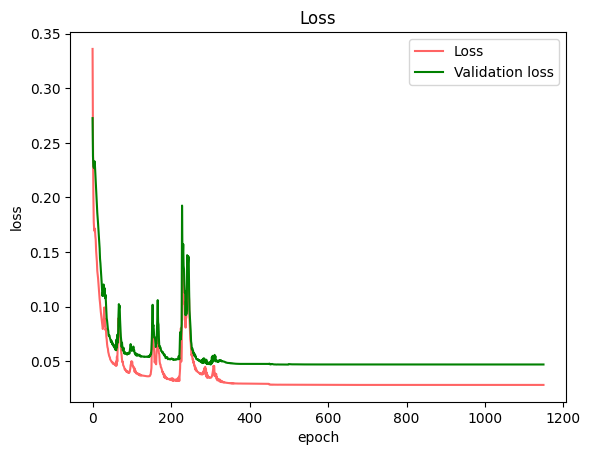

step 1, accuracy_train:0.603125, loss: 0.3380372528796699
step 2, accuracy_train:0.671875, loss: 0.25961928034990817
step 3, accuracy_train:0.703125, loss: 0.2081185330787013
step 4, accuracy_train:0.728125, loss: 0.18726307862602914
step 5, accuracy_train:0.73125, loss: 0.1770233227630749
step 6, accuracy_train:0.803125, loss: 0.17947460711060187
step 7, accuracy_train:0.853125, loss: 0.1766263574493365
step 8, accuracy_train:0.86875, loss: 0.16970802150109238
step 9, accuracy_train:0.88125, loss: 0.16270384764912912
step 10, accuracy_train:0.896875, loss: 0.15244154719080266
step 11, accuracy_train:0.909375, loss: 0.14518215017473682
step 12, accuracy_train:0.91875, loss: 0.134910245716471
step 13, accuracy_train:0.91875, loss: 0.13093466375588148
step 14, accuracy_train:0.91875, loss: 0.12488319105067394
step 15, accuracy_train:0.903125, loss: 0.1227530250829435
step 16, accuracy_train:0.896875, loss: 0.11795704861108426
step 17, accuracy_train:0.9125, loss: 0.11393117460317105
step

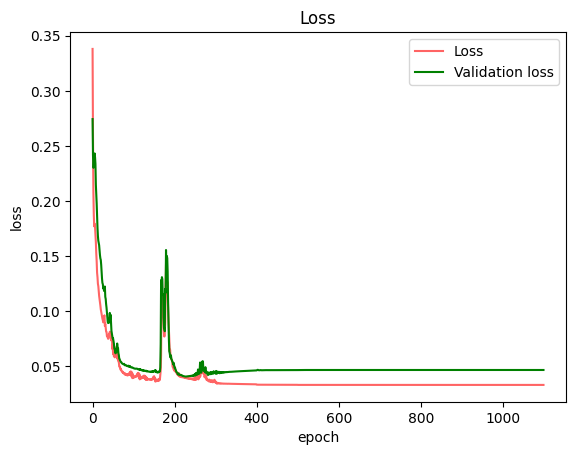

step 1, accuracy_train:0.634375, loss: 0.33412064332589547
step 2, accuracy_train:0.68125, loss: 0.2612366473335702
step 3, accuracy_train:0.76875, loss: 0.2041299665570399
step 4, accuracy_train:0.79375, loss: 0.18310376109288357
step 5, accuracy_train:0.809375, loss: 0.18127696284974829
step 6, accuracy_train:0.853125, loss: 0.18178817592785718
step 7, accuracy_train:0.846875, loss: 0.17637406337774758
step 8, accuracy_train:0.878125, loss: 0.17496714915344375
step 9, accuracy_train:0.909375, loss: 0.16244977659947632
step 10, accuracy_train:0.89375, loss: 0.14869628964443699
step 11, accuracy_train:0.903125, loss: 0.14053523705607587
step 12, accuracy_train:0.909375, loss: 0.13194023281240186
step 13, accuracy_train:0.9125, loss: 0.12447078826200839
step 14, accuracy_train:0.915625, loss: 0.11854522451277003
step 15, accuracy_train:0.903125, loss: 0.11045780391302118
step 16, accuracy_train:0.89375, loss: 0.10790501072599923
step 17, accuracy_train:0.903125, loss: 0.1022988590142811

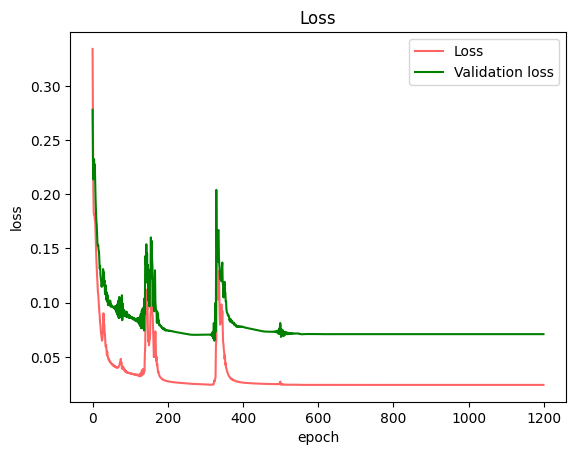

cv_time ：690.053890 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 300, 50, [0.05, 0.03, 0.01]]


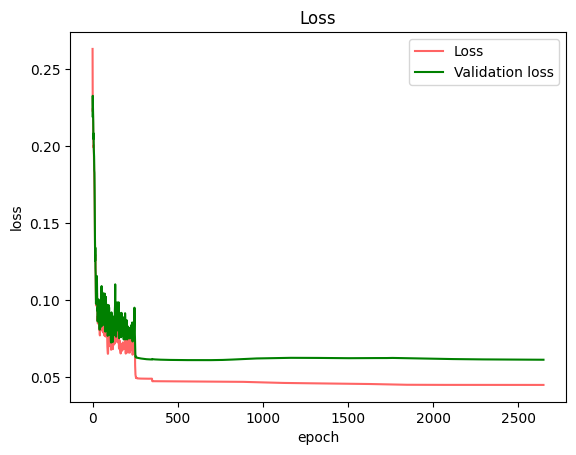

circuit is jitted
circuit is jitted


2024-07-20 21:40:12.035536: E external/org_tensorflow/tensorflow/compiler/xla/service/slow_operation_alarm.cc:65] 
********************************
[Compiling module jit_test] Very slow compile?  If you want to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
********************************
2024-07-20 21:42:12.381041: E external/org_tensorflow/tensorflow/compiler/xla/service/slow_operation_alarm.cc:133] The operation took 4m0.345650542s

********************************
[Compiling module jit_test] Very slow compile?  If you want to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
********************************


circuit is jitted
circuit is jitted


2024-07-20 21:44:53.160969: E external/org_tensorflow/tensorflow/compiler/xla/service/slow_operation_alarm.cc:65] 
********************************
[Compiling module jit_test] Very slow compile?  If you want to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
********************************
2024-07-20 21:47:39.286278: E external/org_tensorflow/tensorflow/compiler/xla/service/slow_operation_alarm.cc:133] The operation took 4m46.125421162s

********************************
[Compiling module jit_test] Very slow compile?  If you want to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
********************************


step 1, accuracy_train:0.64375, loss: 0.24338378328948507
circuit is jitted
circuit is jitted


2024-07-20 21:50:16.122762: E external/org_tensorflow/tensorflow/compiler/xla/service/slow_operation_alarm.cc:65] 
********************************
[Compiling module jit_test] Very slow compile?  If you want to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
********************************
2024-07-20 21:52:33.169646: E external/org_tensorflow/tensorflow/compiler/xla/service/slow_operation_alarm.cc:133] The operation took 4m17.046971346s

********************************
[Compiling module jit_test] Very slow compile?  If you want to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
********************************


step 2, accuracy_train:0.73125, loss: 0.2281951478293414
step 3, accuracy_train:0.759375, loss: 0.21913241261969363
step 4, accuracy_train:0.825, loss: 0.21413252834602747
step 5, accuracy_train:0.825, loss: 0.21393740598383137
step 6, accuracy_train:0.85, loss: 0.21440743594429743
step 7, accuracy_train:0.871875, loss: 0.21393397881760762
step 8, accuracy_train:0.84375, loss: 0.21567859463759706
step 9, accuracy_train:0.840625, loss: 0.21424202393770175
step 10, accuracy_train:0.89375, loss: 0.21090358011095917
step 11, accuracy_train:0.853125, loss: 0.2126288326701551
step 12, accuracy_train:0.859375, loss: 0.21449390750190292
step 13, accuracy_train:0.8875, loss: 0.21333772951436095
step 14, accuracy_train:0.8375, loss: 0.2169480298653591
step 15, accuracy_train:0.83125, loss: 0.217054766783202
step 16, accuracy_train:0.859375, loss: 0.21572318343904268
step 17, accuracy_train:0.840625, loss: 0.2159487900284438
step 18, accuracy_train:0.84375, loss: 0.21753691988038162
step 19, accu

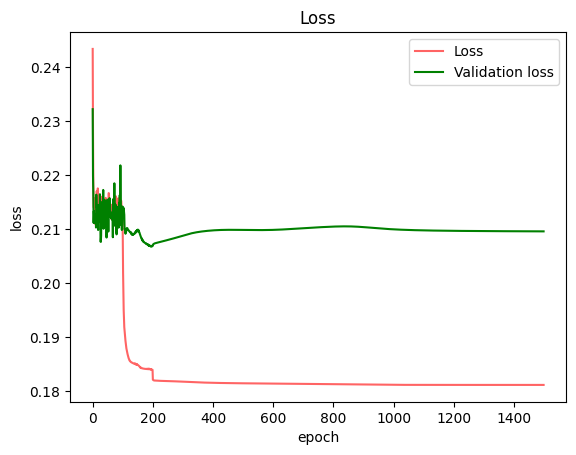

step 1, accuracy_train:0.65, loss: 0.24340552900293977
step 2, accuracy_train:0.775, loss: 0.22747886534405895
step 3, accuracy_train:0.796875, loss: 0.2189715257950965
step 4, accuracy_train:0.828125, loss: 0.21455810169858153
step 5, accuracy_train:0.89375, loss: 0.21005233446668484
step 6, accuracy_train:0.859375, loss: 0.20994332480352323
step 7, accuracy_train:0.8875, loss: 0.21001416501201364
step 8, accuracy_train:0.88125, loss: 0.20854584037467963
step 9, accuracy_train:0.85625, loss: 0.21060695146563355
step 10, accuracy_train:0.86875, loss: 0.20470341555249372
step 11, accuracy_train:0.865625, loss: 0.20339560100020307
step 12, accuracy_train:0.878125, loss: 0.20088925652680228
step 13, accuracy_train:0.865625, loss: 0.19675946600115218
step 14, accuracy_train:0.878125, loss: 0.19292269335877732
step 15, accuracy_train:0.871875, loss: 0.19269501248856072
step 16, accuracy_train:0.86875, loss: 0.19169718647521983
step 17, accuracy_train:0.878125, loss: 0.1885482693955686
step 

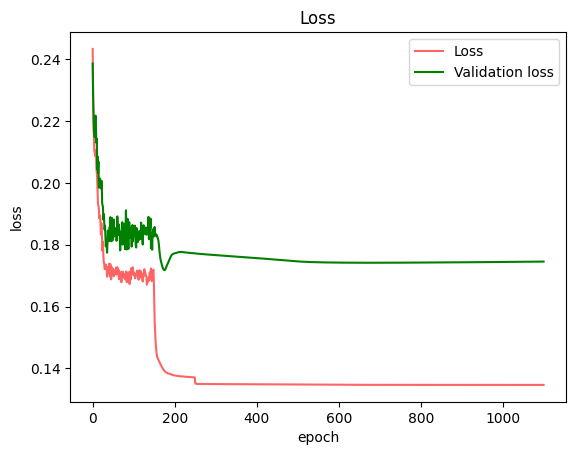

step 1, accuracy_train:0.640625, loss: 0.2435135140452529
step 2, accuracy_train:0.659375, loss: 0.2304243842976155
step 3, accuracy_train:0.70625, loss: 0.22629852385816907
step 4, accuracy_train:0.778125, loss: 0.21578272132750012
step 5, accuracy_train:0.79375, loss: 0.2165346467609405
step 6, accuracy_train:0.85, loss: 0.20666778375208988
step 7, accuracy_train:0.84375, loss: 0.21098803348014597
step 8, accuracy_train:0.871875, loss: 0.20948149485518489
step 9, accuracy_train:0.846875, loss: 0.20919210192579568
step 10, accuracy_train:0.865625, loss: 0.2064985333213011
step 11, accuracy_train:0.84375, loss: 0.2038890051468193
step 12, accuracy_train:0.85, loss: 0.20468883747114122
step 13, accuracy_train:0.84375, loss: 0.20548554313954887
step 14, accuracy_train:0.878125, loss: 0.20475647335535072
step 15, accuracy_train:0.871875, loss: 0.20210309864828385
step 16, accuracy_train:0.88125, loss: 0.20060919105572797
step 17, accuracy_train:0.890625, loss: 0.20068097443441113
step 18,

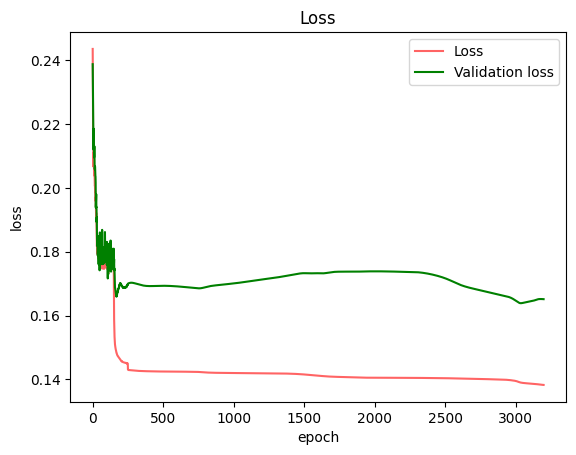

step 1, accuracy_train:0.621875, loss: 0.2433646493915061
step 2, accuracy_train:0.7375, loss: 0.2287918845964846
step 3, accuracy_train:0.790625, loss: 0.2201234804022653
step 4, accuracy_train:0.846875, loss: 0.21683141276204065
step 5, accuracy_train:0.878125, loss: 0.20967768748889004
step 6, accuracy_train:0.878125, loss: 0.21038541997285723
step 7, accuracy_train:0.8625, loss: 0.20926470111517173
step 8, accuracy_train:0.903125, loss: 0.20730867487464702
step 9, accuracy_train:0.878125, loss: 0.2091399015037473
step 10, accuracy_train:0.878125, loss: 0.20871798641965691
step 11, accuracy_train:0.89375, loss: 0.2079079511355784
step 12, accuracy_train:0.88125, loss: 0.21088504903773997
step 13, accuracy_train:0.890625, loss: 0.21140557806586974
step 14, accuracy_train:0.8875, loss: 0.2113055840069367
step 15, accuracy_train:0.9, loss: 0.21011217849663466
step 16, accuracy_train:0.875, loss: 0.21156881694223723
step 17, accuracy_train:0.875, loss: 0.21264962501858253
step 18, accur

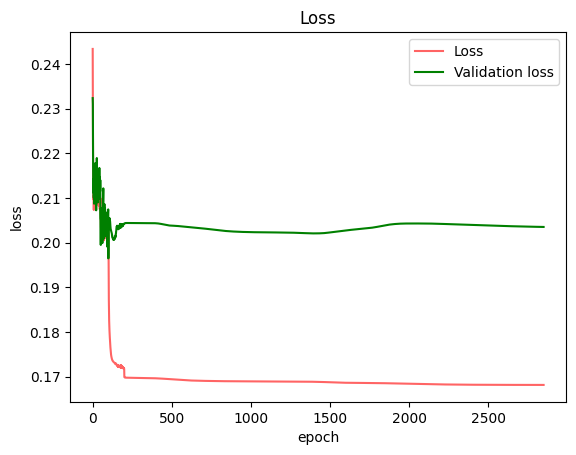

step 1, accuracy_train:0.621875, loss: 0.24594742250471216
step 2, accuracy_train:0.709375, loss: 0.23373063689179777
step 3, accuracy_train:0.79375, loss: 0.22403099087950737
step 4, accuracy_train:0.8125, loss: 0.21558406457851942
step 5, accuracy_train:0.859375, loss: 0.21517246754713704
step 6, accuracy_train:0.859375, loss: 0.2142558349909805
step 7, accuracy_train:0.78125, loss: 0.22100971410901318
step 8, accuracy_train:0.815625, loss: 0.21838143771167873
step 9, accuracy_train:0.85625, loss: 0.2132533213415262
step 10, accuracy_train:0.88125, loss: 0.21322144962070536
step 11, accuracy_train:0.86875, loss: 0.2103990049494884
step 12, accuracy_train:0.90625, loss: 0.20499174344448504
step 13, accuracy_train:0.884375, loss: 0.20730653664414203
step 14, accuracy_train:0.865625, loss: 0.21042034586722208
step 15, accuracy_train:0.88125, loss: 0.20628077565758357
step 16, accuracy_train:0.9, loss: 0.20487959208892173
step 17, accuracy_train:0.890625, loss: 0.20786675332369703
step 1

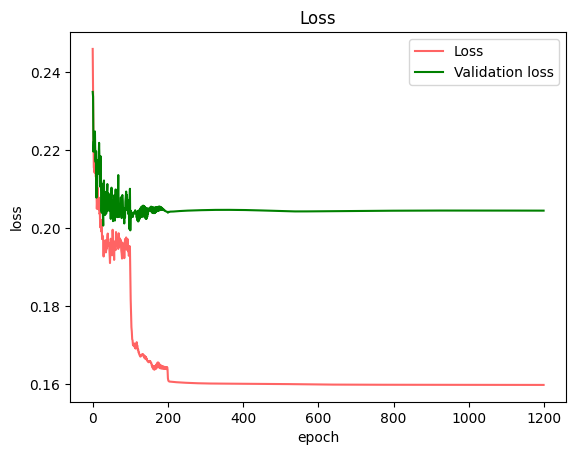

cv_time ：3393.751498 s
[[0.15, 0.05, 0.01], 3200, 50, 50, [0.05, 0.03, 0.01]]
circuit is jitted
circuit is jitted


2024-07-20 22:39:42.477955: E external/org_tensorflow/tensorflow/compiler/xla/service/slow_operation_alarm.cc:133] The operation took 5m2.027887473s

********************************
[Compiling module jit_test] Very slow compile?  If you want to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
********************************


step 1, accuracy_train:0.6375, loss: 0.25146452556645804
step 2, accuracy_train:0.6625, loss: 0.21950764147030755
step 3, accuracy_train:0.796875, loss: 0.21721454074513155
step 4, accuracy_train:0.80625, loss: 0.21175073738182087
step 5, accuracy_train:0.8625, loss: 0.20234992985703432
step 6, accuracy_train:0.8625, loss: 0.19750812178045749
step 7, accuracy_train:0.890625, loss: 0.1925885961389257
step 8, accuracy_train:0.9125, loss: 0.18728075199887328
step 9, accuracy_train:0.89375, loss: 0.1834751285017205
step 10, accuracy_train:0.90625, loss: 0.1775248223009043
step 11, accuracy_train:0.90625, loss: 0.17193233520918433
step 12, accuracy_train:0.90625, loss: 0.16801200361276586
step 13, accuracy_train:0.909375, loss: 0.16387118377738252
step 14, accuracy_train:0.91875, loss: 0.16068175468986423
step 15, accuracy_train:0.915625, loss: 0.1563638861063893
step 16, accuracy_train:0.9, loss: 0.14842426674336556
step 17, accuracy_train:0.928125, loss: 0.13874414552982484
step 18, accur

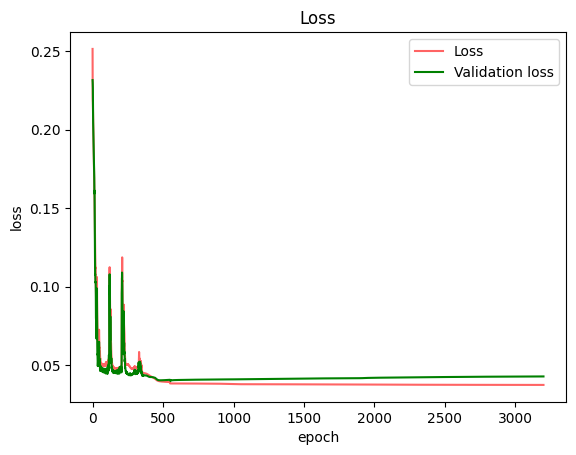

step 1, accuracy_train:0.525, loss: 0.2548758576636948
step 2, accuracy_train:0.6125, loss: 0.21900187950394676
step 3, accuracy_train:0.590625, loss: 0.22774502414795716
step 4, accuracy_train:0.60625, loss: 0.22499120320335564
step 5, accuracy_train:0.621875, loss: 0.21804231301353266
step 6, accuracy_train:0.728125, loss: 0.2138659083123295
step 7, accuracy_train:0.771875, loss: 0.20781019160214442
step 8, accuracy_train:0.83125, loss: 0.20613233154188212
step 9, accuracy_train:0.853125, loss: 0.20139836364801542
step 10, accuracy_train:0.875, loss: 0.19848354451840042
step 11, accuracy_train:0.921875, loss: 0.1898560694589464
step 12, accuracy_train:0.903125, loss: 0.18629378577921724
step 13, accuracy_train:0.940625, loss: 0.18237120287301722
step 14, accuracy_train:0.925, loss: 0.17795690836807052
step 15, accuracy_train:0.928125, loss: 0.17598876966563767
step 16, accuracy_train:0.915625, loss: 0.1681856715034699
step 17, accuracy_train:0.90625, loss: 0.16558301494025363
step 18

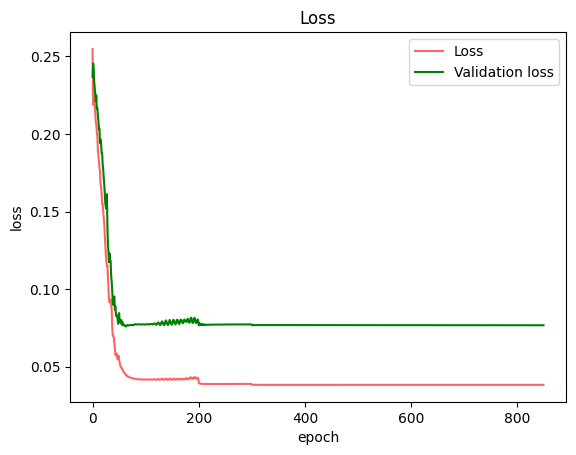

step 1, accuracy_train:0.55, loss: 0.2527066300831596
step 2, accuracy_train:0.64375, loss: 0.2196902111646339
step 3, accuracy_train:0.715625, loss: 0.21904234225641794
step 4, accuracy_train:0.753125, loss: 0.213003653887125
step 5, accuracy_train:0.825, loss: 0.20973081225206508
step 6, accuracy_train:0.853125, loss: 0.2037941454378438
step 7, accuracy_train:0.875, loss: 0.19847574183736277
step 8, accuracy_train:0.884375, loss: 0.1955370849420226
step 9, accuracy_train:0.878125, loss: 0.19134507612533622
step 10, accuracy_train:0.909375, loss: 0.18627172447075355
step 11, accuracy_train:0.90625, loss: 0.1847606434413689
step 12, accuracy_train:0.921875, loss: 0.18049885569603957
step 13, accuracy_train:0.925, loss: 0.17884725813212937
step 14, accuracy_train:0.925, loss: 0.1758125488112791
step 15, accuracy_train:0.91875, loss: 0.17324857145094494
step 16, accuracy_train:0.921875, loss: 0.1663550271096556
step 17, accuracy_train:0.928125, loss: 0.16270007279416349
step 18, accuracy

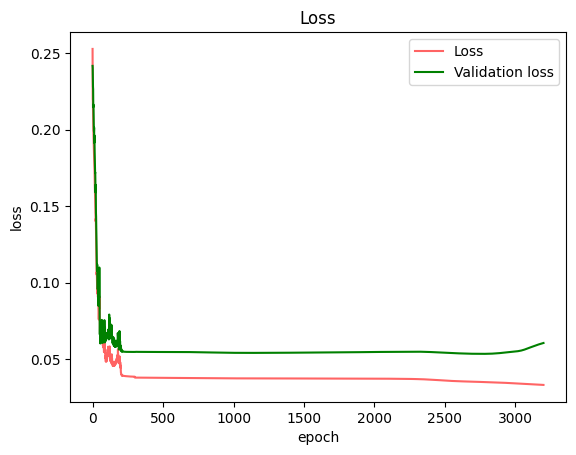

step 1, accuracy_train:0.55, loss: 0.25277785042379863
step 2, accuracy_train:0.66875, loss: 0.21946534677552096
step 3, accuracy_train:0.684375, loss: 0.21861418237360541
step 4, accuracy_train:0.75625, loss: 0.21629078959166007
step 5, accuracy_train:0.846875, loss: 0.20559183441903506
step 6, accuracy_train:0.8375, loss: 0.20347509510446768
step 7, accuracy_train:0.865625, loss: 0.19643831667390244
step 8, accuracy_train:0.875, loss: 0.1948115903294229
step 9, accuracy_train:0.9, loss: 0.1842513522412043
step 10, accuracy_train:0.90625, loss: 0.17959557787709446
step 11, accuracy_train:0.9125, loss: 0.1738261812409186
step 12, accuracy_train:0.9, loss: 0.1701139961483204
step 13, accuracy_train:0.9125, loss: 0.16338246324294026
step 14, accuracy_train:0.909375, loss: 0.1559625320663991
step 15, accuracy_train:0.91875, loss: 0.14864359438069724
step 16, accuracy_train:0.896875, loss: 0.14113166738207122
step 17, accuracy_train:0.915625, loss: 0.13456419059609837
step 18, accuracy_tra

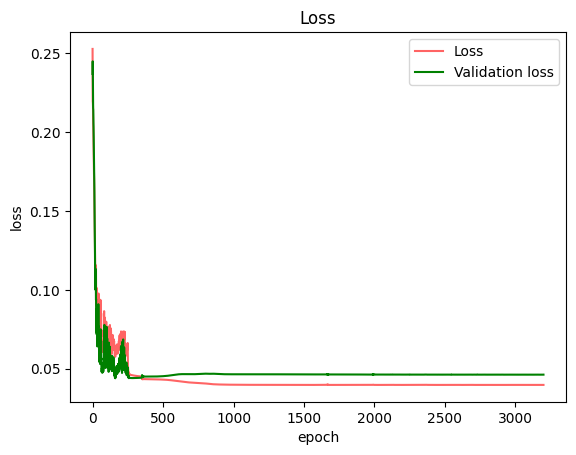

step 1, accuracy_train:0.540625, loss: 0.2560648902425837
step 2, accuracy_train:0.728125, loss: 0.22255231274613002
step 3, accuracy_train:0.7125, loss: 0.22254582760800312
step 4, accuracy_train:0.815625, loss: 0.21037916204394896
step 5, accuracy_train:0.8625, loss: 0.20172778827213703
step 6, accuracy_train:0.859375, loss: 0.19509811658006815
step 7, accuracy_train:0.88125, loss: 0.18419689062622452
step 8, accuracy_train:0.89375, loss: 0.18151457777956614
step 9, accuracy_train:0.9, loss: 0.1706858115327701
step 10, accuracy_train:0.90625, loss: 0.15889293807364813
step 11, accuracy_train:0.915625, loss: 0.1496692493258206
step 12, accuracy_train:0.915625, loss: 0.13637104988888596
step 13, accuracy_train:0.915625, loss: 0.12471805749193747
step 14, accuracy_train:0.903125, loss: 0.12541393303156828
step 15, accuracy_train:0.921875, loss: 0.11365525611320888
step 16, accuracy_train:0.91875, loss: 0.11437570310813786
step 17, accuracy_train:0.909375, loss: 0.10964010530823556
step 

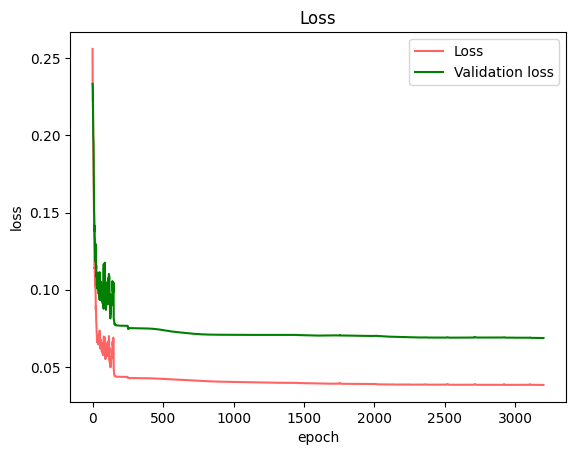

cv_time ：3961.897004 s
[[0.15, 0.05, 0.01], 3200, 100, 50, [0.05, 0.03, 0.01]]
circuit is jitted
circuit is jitted
step 1, accuracy_train:0.553125, loss: 0.2629281993598165
step 2, accuracy_train:0.628125, loss: 0.2154811967473796
step 3, accuracy_train:0.64375, loss: 0.2006257047629098
step 4, accuracy_train:0.63125, loss: 0.19827996223864516
step 5, accuracy_train:0.678125, loss: 0.19545650461467146
step 6, accuracy_train:0.69375, loss: 0.19672901599570908
step 7, accuracy_train:0.759375, loss: 0.19341740017973866
step 8, accuracy_train:0.746875, loss: 0.19018869631814178
step 9, accuracy_train:0.784375, loss: 0.18192081022893228
step 10, accuracy_train:0.825, loss: 0.1752533784876232
step 11, accuracy_train:0.859375, loss: 0.17016603148273932
step 12, accuracy_train:0.85, loss: 0.16735147396556016
step 13, accuracy_train:0.871875, loss: 0.16386659195236256
step 14, accuracy_train:0.853125, loss: 0.16008575584933854
step 15, accuracy_train:0.86875, loss: 0.15883382136360585
step 16, 

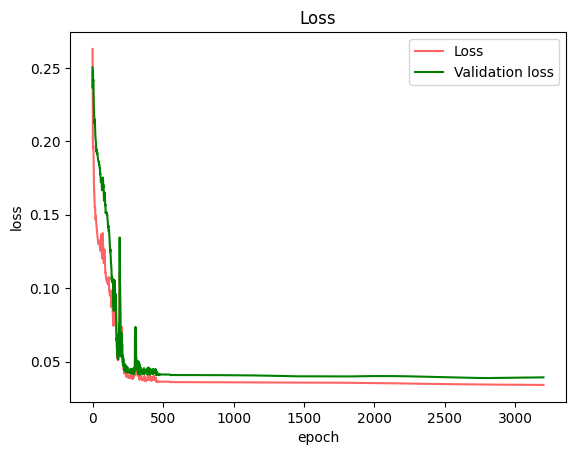

step 1, accuracy_train:0.559375, loss: 0.2645169741974323
step 2, accuracy_train:0.63125, loss: 0.2171155117148531
step 3, accuracy_train:0.671875, loss: 0.19910805304905804
step 4, accuracy_train:0.71875, loss: 0.19101280845477736
step 5, accuracy_train:0.74375, loss: 0.1913734516900112
step 6, accuracy_train:0.7375, loss: 0.19311771779710454
step 7, accuracy_train:0.76875, loss: 0.18973042453752076
step 8, accuracy_train:0.78125, loss: 0.18352167046222928
step 9, accuracy_train:0.825, loss: 0.1814125833508289
step 10, accuracy_train:0.853125, loss: 0.17614547875412295
step 11, accuracy_train:0.846875, loss: 0.1686418777520025
step 12, accuracy_train:0.85625, loss: 0.16788255589937284
step 13, accuracy_train:0.840625, loss: 0.1647926817596309
step 14, accuracy_train:0.840625, loss: 0.16099133036815996
step 15, accuracy_train:0.85, loss: 0.15614032136590042
step 16, accuracy_train:0.865625, loss: 0.15452525565255465
step 17, accuracy_train:0.865625, loss: 0.15093813009337015
step 18, a

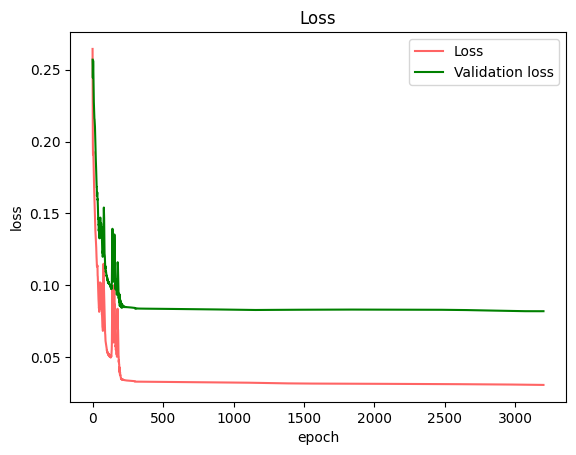

step 1, accuracy_train:0.559375, loss: 0.2670892672127654
step 2, accuracy_train:0.665625, loss: 0.21850060046621528
step 3, accuracy_train:0.596875, loss: 0.1978052872285176
step 4, accuracy_train:0.671875, loss: 0.19276329083650745
step 5, accuracy_train:0.7125, loss: 0.1958632535623256
step 6, accuracy_train:0.7125, loss: 0.1956458035962485
step 7, accuracy_train:0.721875, loss: 0.19083543139753756
step 8, accuracy_train:0.84375, loss: 0.18555440991049554
step 9, accuracy_train:0.85, loss: 0.17826403654901948
step 10, accuracy_train:0.875, loss: 0.17358581897801773
step 11, accuracy_train:0.865625, loss: 0.1699293088215225
step 12, accuracy_train:0.871875, loss: 0.1658146463491205
step 13, accuracy_train:0.878125, loss: 0.16168794500319675
step 14, accuracy_train:0.875, loss: 0.15730352117994043
step 15, accuracy_train:0.8875, loss: 0.15439758417934607
step 16, accuracy_train:0.9, loss: 0.15120663829102093
step 17, accuracy_train:0.90625, loss: 0.14550107889503
step 18, accuracy_tra

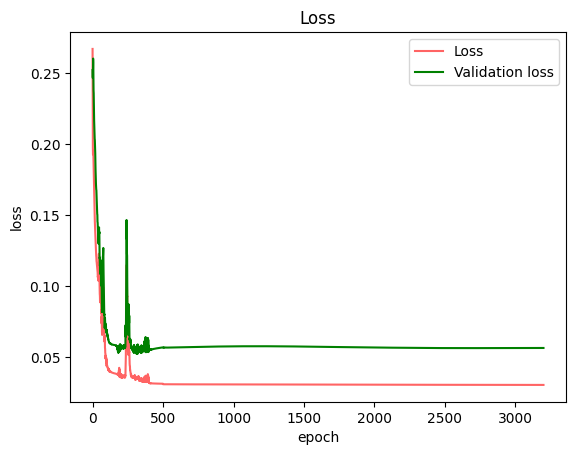

step 1, accuracy_train:0.53125, loss: 0.26719116705131873
step 2, accuracy_train:0.55, loss: 0.22111683173834853
step 3, accuracy_train:0.6125, loss: 0.19859832355014845
step 4, accuracy_train:0.6375, loss: 0.19552522886994342
step 5, accuracy_train:0.696875, loss: 0.19484302871801107
step 6, accuracy_train:0.703125, loss: 0.194823712821647
step 7, accuracy_train:0.65625, loss: 0.19418455431342097
step 8, accuracy_train:0.684375, loss: 0.1887980378725323
step 9, accuracy_train:0.73125, loss: 0.18490514646267886
step 10, accuracy_train:0.784375, loss: 0.17978047240949407
step 11, accuracy_train:0.81875, loss: 0.1748079789225001
step 12, accuracy_train:0.828125, loss: 0.17107978982812616
step 13, accuracy_train:0.871875, loss: 0.16685188483932223
step 14, accuracy_train:0.896875, loss: 0.16246863881266396
step 15, accuracy_train:0.89375, loss: 0.15879367006311584
step 16, accuracy_train:0.903125, loss: 0.15796685071861505
step 17, accuracy_train:0.90625, loss: 0.15367744475879838
step 18

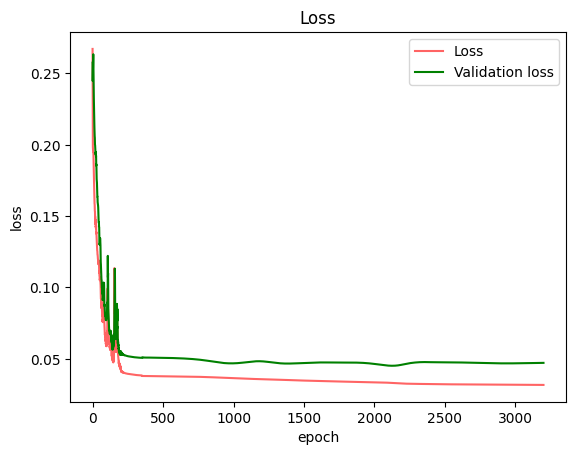

step 1, accuracy_train:0.525, loss: 0.27178772682102037
step 2, accuracy_train:0.69375, loss: 0.2264006524933663
step 3, accuracy_train:0.721875, loss: 0.21229931601175267
step 4, accuracy_train:0.721875, loss: 0.20945220533750936
step 5, accuracy_train:0.809375, loss: 0.20613844352787475
step 6, accuracy_train:0.815625, loss: 0.19827992393174343
step 7, accuracy_train:0.828125, loss: 0.19155927482041984
step 8, accuracy_train:0.85625, loss: 0.18480136801235278
step 9, accuracy_train:0.840625, loss: 0.17986031967881244
step 10, accuracy_train:0.8375, loss: 0.17029608586138972
step 11, accuracy_train:0.8125, loss: 0.16374466993557577
step 12, accuracy_train:0.865625, loss: 0.15780156027374442
step 13, accuracy_train:0.865625, loss: 0.14942755341113542
step 14, accuracy_train:0.865625, loss: 0.14357911759828393
step 15, accuracy_train:0.884375, loss: 0.13861609119180757
step 16, accuracy_train:0.909375, loss: 0.14016558831614642
step 17, accuracy_train:0.890625, loss: 0.14044899507145203

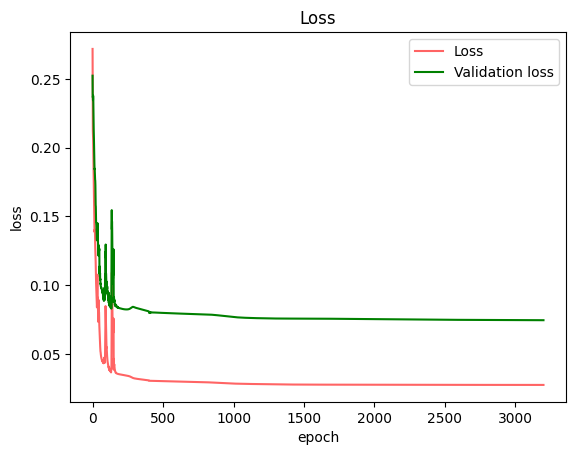

cv_time ：6212.900771 s
[[0.15, 0.05, 0.01], 3200, 300, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.64375, loss: 0.24338378328948507
step 2, accuracy_train:0.73125, loss: 0.2281951478293414
step 3, accuracy_train:0.759375, loss: 0.21913241261969363
step 4, accuracy_train:0.825, loss: 0.21413252834602747
step 5, accuracy_train:0.825, loss: 0.21393740598383137
step 6, accuracy_train:0.85, loss: 0.21440743594429743
step 7, accuracy_train:0.871875, loss: 0.21393397881760762
step 8, accuracy_train:0.84375, loss: 0.21567859463759706
step 9, accuracy_train:0.840625, loss: 0.21424202393770175
step 10, accuracy_train:0.89375, loss: 0.21090358011095917
step 11, accuracy_train:0.853125, loss: 0.2126288326701551
step 12, accuracy_train:0.859375, loss: 0.21449390750190292
step 13, accuracy_train:0.8875, loss: 0.21333772951436095
step 14, accuracy_train:0.8375, loss: 0.2169480298653591
step 15, accuracy_train:0.83125, loss: 0.217054766783202
step 16, accuracy_train:0.859375, loss: 0.215723183439

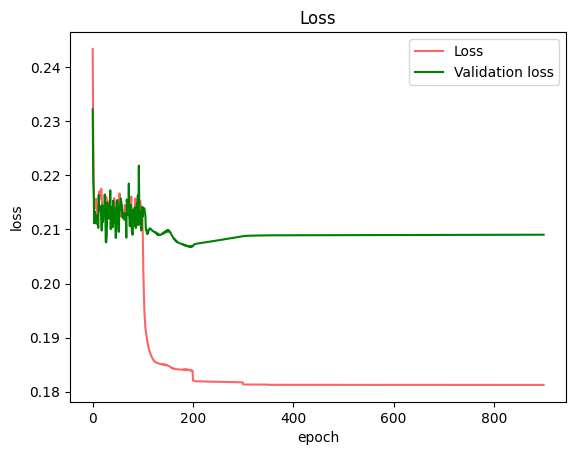

step 1, accuracy_train:0.65, loss: 0.24340552900293977
step 2, accuracy_train:0.775, loss: 0.22747886534405895
step 3, accuracy_train:0.796875, loss: 0.2189715257950965
step 4, accuracy_train:0.828125, loss: 0.21455810169858153
step 5, accuracy_train:0.89375, loss: 0.21005233446668484
step 6, accuracy_train:0.859375, loss: 0.20994332480352323
step 7, accuracy_train:0.8875, loss: 0.21001416501201364
step 8, accuracy_train:0.88125, loss: 0.20854584037467963
step 9, accuracy_train:0.85625, loss: 0.21060695146563355
step 10, accuracy_train:0.86875, loss: 0.20470341555249372
step 11, accuracy_train:0.865625, loss: 0.20339560100020307
step 12, accuracy_train:0.878125, loss: 0.20088925652680228
step 13, accuracy_train:0.865625, loss: 0.19675946600115218
step 14, accuracy_train:0.878125, loss: 0.19292269335877732
step 15, accuracy_train:0.871875, loss: 0.19269501248856072
step 16, accuracy_train:0.86875, loss: 0.19169718647521983
step 17, accuracy_train:0.878125, loss: 0.1885482693955686
step 

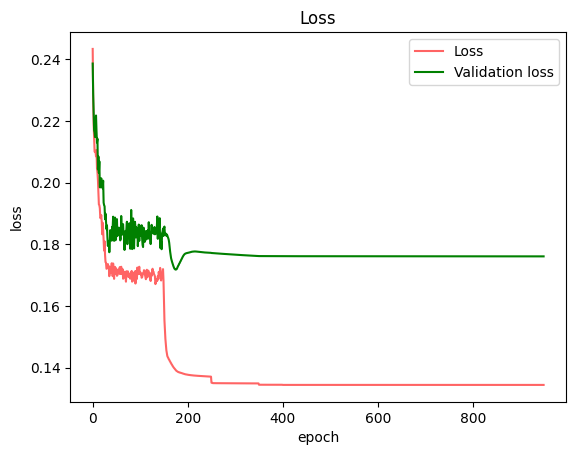

step 1, accuracy_train:0.640625, loss: 0.2435135140452529
step 2, accuracy_train:0.659375, loss: 0.2304243842976155
step 3, accuracy_train:0.70625, loss: 0.22629852385816907
step 4, accuracy_train:0.778125, loss: 0.21578272132750012
step 5, accuracy_train:0.79375, loss: 0.2165346467609405
step 6, accuracy_train:0.85, loss: 0.20666778375208988
step 7, accuracy_train:0.84375, loss: 0.21098803348014597
step 8, accuracy_train:0.871875, loss: 0.20948149485518489
step 9, accuracy_train:0.846875, loss: 0.20919210192579568
step 10, accuracy_train:0.865625, loss: 0.2064985333213011
step 11, accuracy_train:0.84375, loss: 0.2038890051468193
step 12, accuracy_train:0.85, loss: 0.20468883747114122
step 13, accuracy_train:0.84375, loss: 0.20548554313954887
step 14, accuracy_train:0.878125, loss: 0.20475647335535072
step 15, accuracy_train:0.871875, loss: 0.20210309864828385
step 16, accuracy_train:0.88125, loss: 0.20060919105572797
step 17, accuracy_train:0.890625, loss: 0.20068097443441113
step 18,

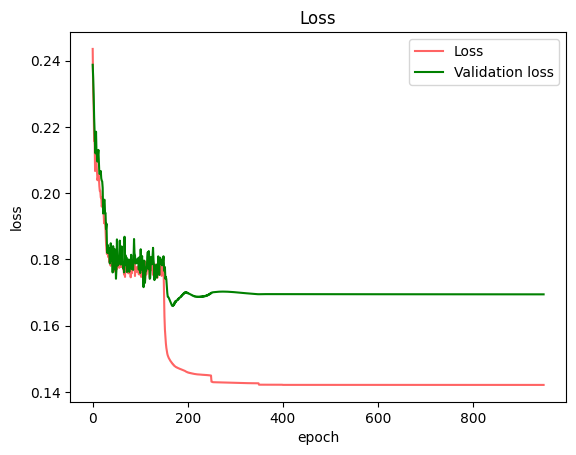

step 1, accuracy_train:0.621875, loss: 0.2433646493915061
step 2, accuracy_train:0.7375, loss: 0.2287918845964846
step 3, accuracy_train:0.790625, loss: 0.2201234804022653
step 4, accuracy_train:0.846875, loss: 0.21683141276204065
step 5, accuracy_train:0.878125, loss: 0.20967768748889004
step 6, accuracy_train:0.878125, loss: 0.21038541997285723
step 7, accuracy_train:0.8625, loss: 0.20926470111517173
step 8, accuracy_train:0.903125, loss: 0.20730867487464702
step 9, accuracy_train:0.878125, loss: 0.2091399015037473
step 10, accuracy_train:0.878125, loss: 0.20871798641965691
step 11, accuracy_train:0.89375, loss: 0.2079079511355784
step 12, accuracy_train:0.88125, loss: 0.21088504903773997
step 13, accuracy_train:0.890625, loss: 0.21140557806586974
step 14, accuracy_train:0.8875, loss: 0.2113055840069367
step 15, accuracy_train:0.9, loss: 0.21011217849663466
step 16, accuracy_train:0.875, loss: 0.21156881694223723
step 17, accuracy_train:0.875, loss: 0.21264962501858253
step 18, accur

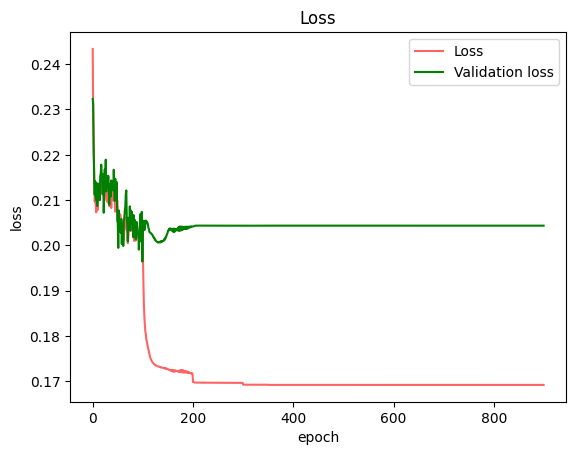

step 1, accuracy_train:0.621875, loss: 0.24594742250471216
step 2, accuracy_train:0.709375, loss: 0.23373063689179777
step 3, accuracy_train:0.79375, loss: 0.22403099087950737
step 4, accuracy_train:0.8125, loss: 0.21558406457851942
step 5, accuracy_train:0.859375, loss: 0.21517246754713704
step 6, accuracy_train:0.859375, loss: 0.2142558349909805
step 7, accuracy_train:0.78125, loss: 0.22100971410901318
step 8, accuracy_train:0.815625, loss: 0.21838143771167873
step 9, accuracy_train:0.85625, loss: 0.2132533213415262
step 10, accuracy_train:0.88125, loss: 0.21322144962070536
step 11, accuracy_train:0.86875, loss: 0.2103990049494884
step 12, accuracy_train:0.90625, loss: 0.20499174344448504
step 13, accuracy_train:0.884375, loss: 0.20730653664414203
step 14, accuracy_train:0.865625, loss: 0.21042034586722208
step 15, accuracy_train:0.88125, loss: 0.20628077565758357
step 16, accuracy_train:0.9, loss: 0.20487959208892173
step 17, accuracy_train:0.890625, loss: 0.20786675332369703
step 1

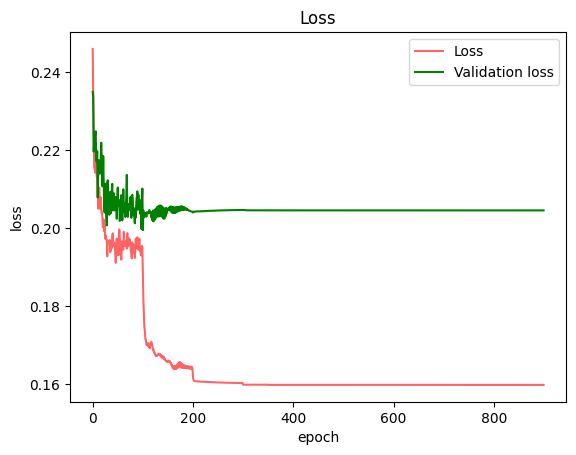

cv_time ：1116.082970 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 50, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.6375, loss: 0.25146452556645804
step 2, accuracy_train:0.6625, loss: 0.21950764147030755
step 3, accuracy_train:0.796875, loss: 0.21721454074513155
step 4, accuracy_train:0.80625, loss: 0.21175073738182087
step 5, accuracy_train:0.8625, loss: 0.20234992985703432
step 6, accuracy_train:0.8625, loss: 0.19750812178045749
step 7, accuracy_train:0.890625, loss: 0.1925885961389257
step 8, accuracy_train:0.9125, loss: 0.18728075199887328
step 9, accuracy_train:0.89375, loss: 0.1834751285017205
step 10, accuracy_train:0.90625, loss: 0.1775248223009043
step 11, accuracy_train:0.90625, loss: 0.17193233520918433
step 12, accuracy_train:0.90625, loss: 0.16801200361276586
step 13, accuracy_train:0.909375, loss: 0.16387118377738252
step 14, accuracy_train:0.91875, loss: 0.16068175468986423
step 15, accuracy_train:0.915625, loss: 0.1563638861063893
step 16, accuracy_train:0.9, loss: 0

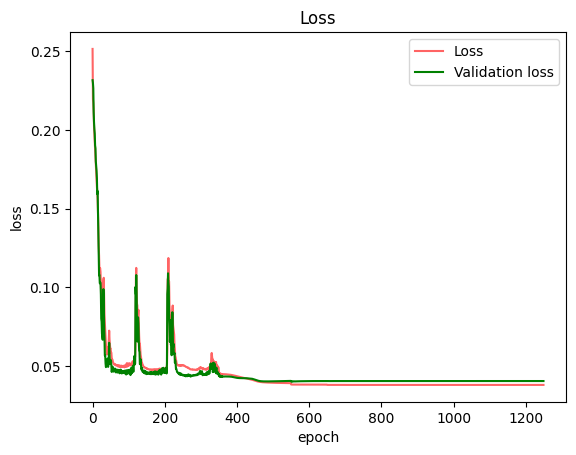

step 1, accuracy_train:0.525, loss: 0.2548758576636948
step 2, accuracy_train:0.6125, loss: 0.21900187950394676
step 3, accuracy_train:0.590625, loss: 0.22774502414795716
step 4, accuracy_train:0.60625, loss: 0.22499120320335564
step 5, accuracy_train:0.621875, loss: 0.21804231301353266
step 6, accuracy_train:0.728125, loss: 0.2138659083123295
step 7, accuracy_train:0.771875, loss: 0.20781019160214442
step 8, accuracy_train:0.83125, loss: 0.20613233154188212
step 9, accuracy_train:0.853125, loss: 0.20139836364801542
step 10, accuracy_train:0.875, loss: 0.19848354451840042
step 11, accuracy_train:0.921875, loss: 0.1898560694589464
step 12, accuracy_train:0.903125, loss: 0.18629378577921724
step 13, accuracy_train:0.940625, loss: 0.18237120287301722
step 14, accuracy_train:0.925, loss: 0.17795690836807052
step 15, accuracy_train:0.928125, loss: 0.17598876966563767
step 16, accuracy_train:0.915625, loss: 0.1681856715034699
step 17, accuracy_train:0.90625, loss: 0.16558301494025363
step 18

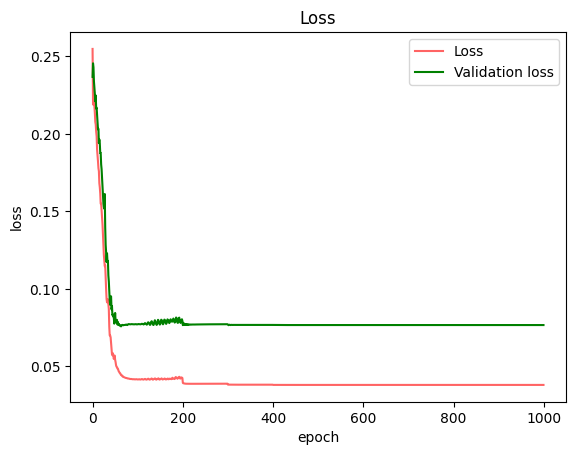

step 1, accuracy_train:0.55, loss: 0.2527066300831596
step 2, accuracy_train:0.64375, loss: 0.2196902111646339
step 3, accuracy_train:0.715625, loss: 0.21904234225641794
step 4, accuracy_train:0.753125, loss: 0.213003653887125
step 5, accuracy_train:0.825, loss: 0.20973081225206508
step 6, accuracy_train:0.853125, loss: 0.2037941454378438
step 7, accuracy_train:0.875, loss: 0.19847574183736277
step 8, accuracy_train:0.884375, loss: 0.1955370849420226
step 9, accuracy_train:0.878125, loss: 0.19134507612533622
step 10, accuracy_train:0.909375, loss: 0.18627172447075355
step 11, accuracy_train:0.90625, loss: 0.1847606434413689
step 12, accuracy_train:0.921875, loss: 0.18049885569603957
step 13, accuracy_train:0.925, loss: 0.17884725813212937
step 14, accuracy_train:0.925, loss: 0.1758125488112791
step 15, accuracy_train:0.91875, loss: 0.17324857145094494
step 16, accuracy_train:0.921875, loss: 0.1663550271096556
step 17, accuracy_train:0.928125, loss: 0.16270007279416349
step 18, accuracy

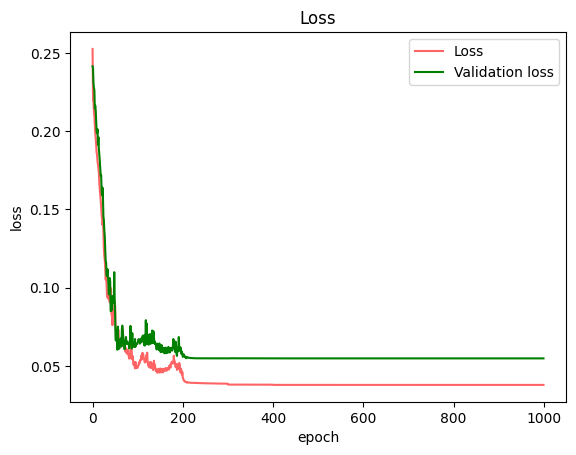

step 1, accuracy_train:0.55, loss: 0.25277785042379863
step 2, accuracy_train:0.66875, loss: 0.21946534677552096
step 3, accuracy_train:0.684375, loss: 0.21861418237360541
step 4, accuracy_train:0.75625, loss: 0.21629078959166007
step 5, accuracy_train:0.846875, loss: 0.20559183441903506
step 6, accuracy_train:0.8375, loss: 0.20347509510446768
step 7, accuracy_train:0.865625, loss: 0.19643831667390244
step 8, accuracy_train:0.875, loss: 0.1948115903294229
step 9, accuracy_train:0.9, loss: 0.1842513522412043
step 10, accuracy_train:0.90625, loss: 0.17959557787709446
step 11, accuracy_train:0.9125, loss: 0.1738261812409186
step 12, accuracy_train:0.9, loss: 0.1701139961483204
step 13, accuracy_train:0.9125, loss: 0.16338246324294026
step 14, accuracy_train:0.909375, loss: 0.1559625320663991
step 15, accuracy_train:0.91875, loss: 0.14864359438069724
step 16, accuracy_train:0.896875, loss: 0.14113166738207122
step 17, accuracy_train:0.915625, loss: 0.13456419059609837
step 18, accuracy_tra

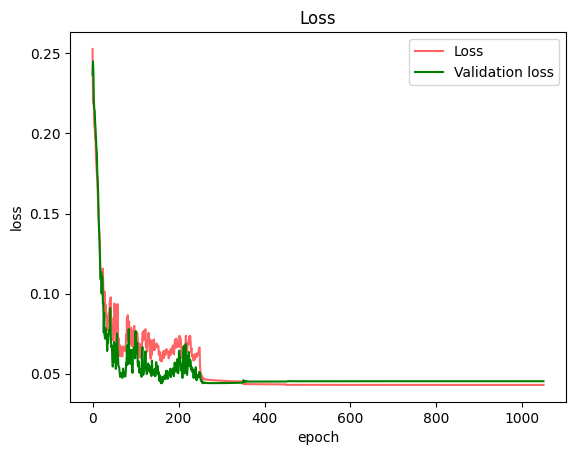

step 1, accuracy_train:0.540625, loss: 0.2560648902425837
step 2, accuracy_train:0.728125, loss: 0.22255231274613002
step 3, accuracy_train:0.7125, loss: 0.22254582760800312
step 4, accuracy_train:0.815625, loss: 0.21037916204394896
step 5, accuracy_train:0.8625, loss: 0.20172778827213703
step 6, accuracy_train:0.859375, loss: 0.19509811658006815
step 7, accuracy_train:0.88125, loss: 0.18419689062622452
step 8, accuracy_train:0.89375, loss: 0.18151457777956614
step 9, accuracy_train:0.9, loss: 0.1706858115327701
step 10, accuracy_train:0.90625, loss: 0.15889293807364813
step 11, accuracy_train:0.915625, loss: 0.1496692493258206
step 12, accuracy_train:0.915625, loss: 0.13637104988888596
step 13, accuracy_train:0.915625, loss: 0.12471805749193747
step 14, accuracy_train:0.903125, loss: 0.12541393303156828
step 15, accuracy_train:0.921875, loss: 0.11365525611320888
step 16, accuracy_train:0.91875, loss: 0.11437570310813786
step 17, accuracy_train:0.909375, loss: 0.10964010530823556
step 

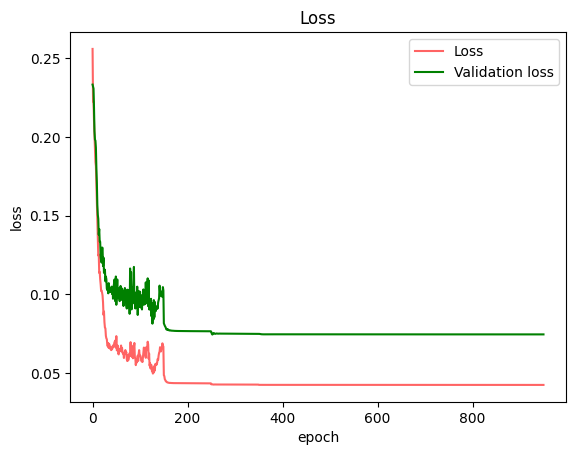

cv_time ：1399.832223 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 100, 50, [0.05, 0.03, 0.01]]
step 1, accuracy_train:0.553125, loss: 0.2629281993598165
step 2, accuracy_train:0.628125, loss: 0.2154811967473796
step 3, accuracy_train:0.64375, loss: 0.2006257047629098
step 4, accuracy_train:0.63125, loss: 0.19827996223864516
step 5, accuracy_train:0.678125, loss: 0.19545650461467146
step 6, accuracy_train:0.69375, loss: 0.19672901599570908
step 7, accuracy_train:0.759375, loss: 0.19341740017973866
step 8, accuracy_train:0.746875, loss: 0.19018869631814178
step 9, accuracy_train:0.784375, loss: 0.18192081022893228
step 10, accuracy_train:0.825, loss: 0.1752533784876232
step 11, accuracy_train:0.859375, loss: 0.17016603148273932
step 12, accuracy_train:0.85, loss: 0.16735147396556016
step 13, accuracy_train:0.871875, loss: 0.16386659195236256
step 14, accuracy_train:0.853125, loss: 0.16008575584933854
step 15, accuracy_train:0.86875, loss: 0.15883382136360585
step 16, accuracy_train:0.8812

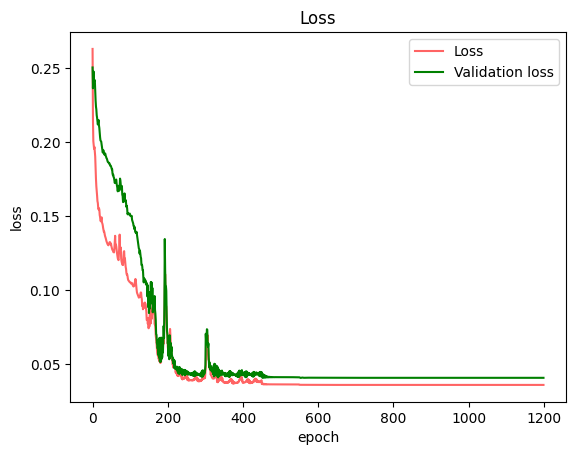

step 1, accuracy_train:0.559375, loss: 0.2645169741974323
step 2, accuracy_train:0.63125, loss: 0.2171155117148531
step 3, accuracy_train:0.671875, loss: 0.19910805304905804
step 4, accuracy_train:0.71875, loss: 0.19101280845477736
step 5, accuracy_train:0.74375, loss: 0.1913734516900112
step 6, accuracy_train:0.7375, loss: 0.19311771779710454
step 7, accuracy_train:0.76875, loss: 0.18973042453752076
step 8, accuracy_train:0.78125, loss: 0.18352167046222928
step 9, accuracy_train:0.825, loss: 0.1814125833508289
step 10, accuracy_train:0.853125, loss: 0.17614547875412295
step 11, accuracy_train:0.846875, loss: 0.1686418777520025
step 12, accuracy_train:0.85625, loss: 0.16788255589937284
step 13, accuracy_train:0.840625, loss: 0.1647926817596309
step 14, accuracy_train:0.840625, loss: 0.16099133036815996
step 15, accuracy_train:0.85, loss: 0.15614032136590042
step 16, accuracy_train:0.865625, loss: 0.15452525565255465
step 17, accuracy_train:0.865625, loss: 0.15093813009337015
step 18, a

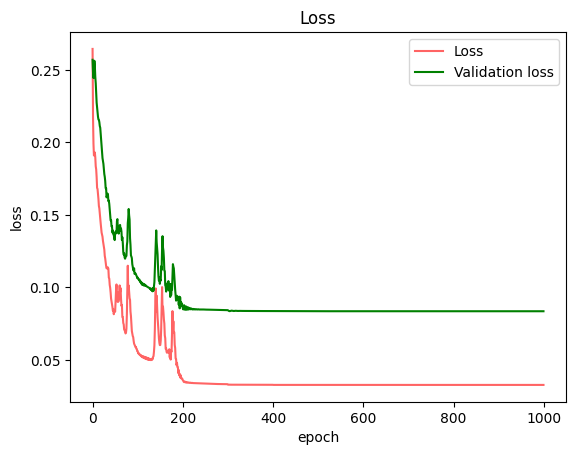

step 1, accuracy_train:0.559375, loss: 0.2670892672127654
step 2, accuracy_train:0.665625, loss: 0.21850060046621528
step 3, accuracy_train:0.596875, loss: 0.1978052872285176
step 4, accuracy_train:0.671875, loss: 0.19276329083650745
step 5, accuracy_train:0.7125, loss: 0.1958632535623256
step 6, accuracy_train:0.7125, loss: 0.1956458035962485
step 7, accuracy_train:0.721875, loss: 0.19083543139753756
step 8, accuracy_train:0.84375, loss: 0.18555440991049554
step 9, accuracy_train:0.85, loss: 0.17826403654901948
step 10, accuracy_train:0.875, loss: 0.17358581897801773
step 11, accuracy_train:0.865625, loss: 0.1699293088215225
step 12, accuracy_train:0.871875, loss: 0.1658146463491205
step 13, accuracy_train:0.878125, loss: 0.16168794500319675
step 14, accuracy_train:0.875, loss: 0.15730352117994043
step 15, accuracy_train:0.8875, loss: 0.15439758417934607
step 16, accuracy_train:0.9, loss: 0.15120663829102093
step 17, accuracy_train:0.90625, loss: 0.14550107889503
step 18, accuracy_tra

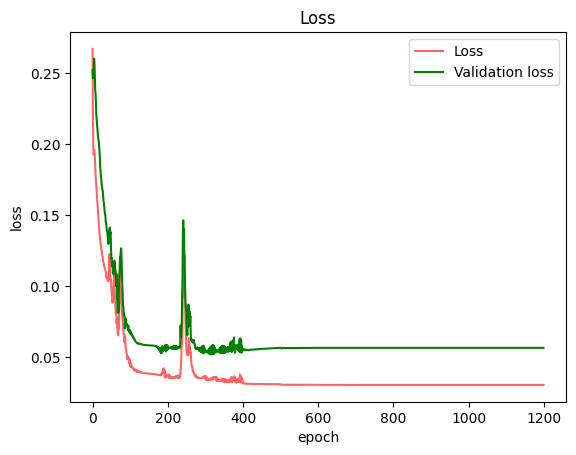

step 1, accuracy_train:0.53125, loss: 0.26719116705131873
step 2, accuracy_train:0.55, loss: 0.22111683173834853
step 3, accuracy_train:0.6125, loss: 0.19859832355014845
step 4, accuracy_train:0.6375, loss: 0.19552522886994342
step 5, accuracy_train:0.696875, loss: 0.19484302871801107
step 6, accuracy_train:0.703125, loss: 0.194823712821647
step 7, accuracy_train:0.65625, loss: 0.19418455431342097
step 8, accuracy_train:0.684375, loss: 0.1887980378725323
step 9, accuracy_train:0.73125, loss: 0.18490514646267886
step 10, accuracy_train:0.784375, loss: 0.17978047240949407
step 11, accuracy_train:0.81875, loss: 0.1748079789225001
step 12, accuracy_train:0.828125, loss: 0.17107978982812616
step 13, accuracy_train:0.871875, loss: 0.16685188483932223
step 14, accuracy_train:0.896875, loss: 0.16246863881266396
step 15, accuracy_train:0.89375, loss: 0.15879367006311584
step 16, accuracy_train:0.903125, loss: 0.15796685071861505
step 17, accuracy_train:0.90625, loss: 0.15367744475879838
step 18

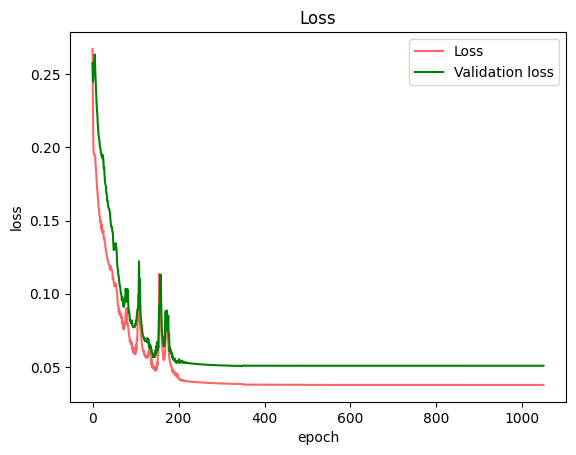

step 1, accuracy_train:0.525, loss: 0.27178772682102037
step 2, accuracy_train:0.69375, loss: 0.2264006524933663
step 3, accuracy_train:0.721875, loss: 0.21229931601175267
step 4, accuracy_train:0.721875, loss: 0.20945220533750936
step 5, accuracy_train:0.809375, loss: 0.20613844352787475
step 6, accuracy_train:0.815625, loss: 0.19827992393174343
step 7, accuracy_train:0.828125, loss: 0.19155927482041984
step 8, accuracy_train:0.85625, loss: 0.18480136801235278
step 9, accuracy_train:0.840625, loss: 0.17986031967881244
step 10, accuracy_train:0.8375, loss: 0.17029608586138972
step 11, accuracy_train:0.8125, loss: 0.16374466993557577
step 12, accuracy_train:0.865625, loss: 0.15780156027374442
step 13, accuracy_train:0.865625, loss: 0.14942755341113542
step 14, accuracy_train:0.865625, loss: 0.14357911759828393
step 15, accuracy_train:0.884375, loss: 0.13861609119180757
step 16, accuracy_train:0.909375, loss: 0.14016558831614642
step 17, accuracy_train:0.890625, loss: 0.14044899507145203

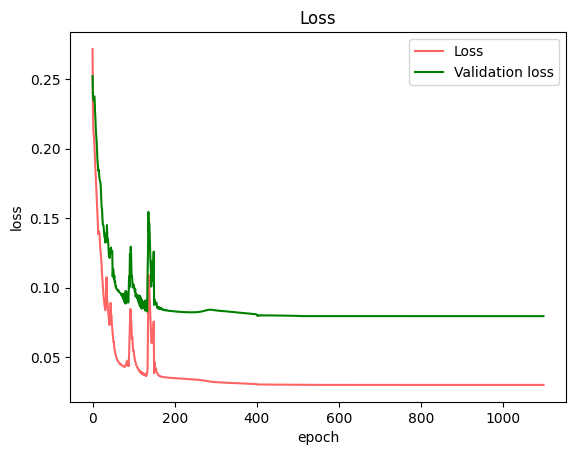

cv_time ：2064.780956 s
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 300, 50, [0.05, 0.03, 0.01]]


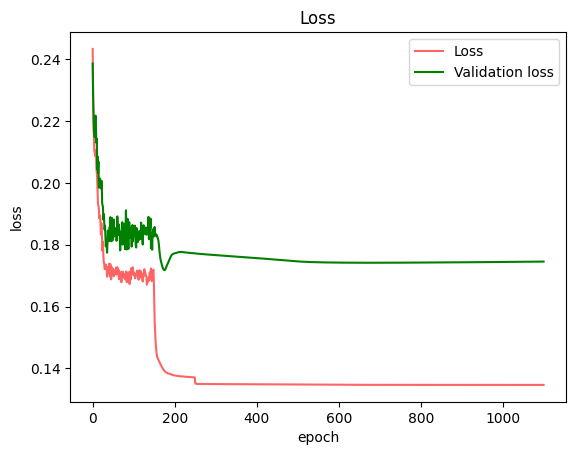

In [31]:
# Grid search of hyper-parameters
best_h_pm, h_pm_rsts =[], []
cv_start = time.process_time()
for setting in settings:
    enc_dim,num_qubits,num_layers,num_reupload,num_rot = setting
    X_train, y_train, X_test, y_test = initialize_data(problem,num_training,num_test,seed_num,enc_dim)
    h_pm_rst=[]
    loss_history_cvs=[]
    for h_pm in h_pms:
        learning_rate,max_epoch,batch_size,dynamic_size,threshold = h_pm
        
        seed_rsts, seed_params = [], []
        loss_history, valid_loss_history = [], []
        accuracy_history = []
        h_pm_rst.append(n_cv(num_cvs, X_train, y_train,setting))
        print(h_pm)

        
    h_pm_i = np.argmax(h_pm_rst,axis=0)[0]
    best_h_pm.append(h_pm_i)
    h_pm_rsts.append(h_pm_rst)
    l_h_best, val_l_h_best = loss_history_cvs[h_pm_i]
    plot_loss_history(l_h_best, val_l_h_best, setting=setting, fig_name=f'{setting}_loss_best_h_pms')
t_cvs = time.process_time()-cv_start

In [32]:
def run(seed_num, x_tr, y_tr, x_te=None, y_te=None, ratio_tr=0.875):
    #if:   x_te=None & y_te=None -> choosing random seed with validation accuracy
    #else: train and test
    global loss_history, valid_loss_history, lr    
    if x_te is None and y_te is None:
        from sklearn.utils import shuffle
        xs_tr, xs_val, ys_tr, ys_val = train_test_split(
            x_tr,y_tr,train_size=ratio_tr,random_state=seed_num,stratify=y_tr)
        # xs = shuffle(x_tr, random_state=seed_num, n_samples=None)
        # ys = shuffle(y_tr, random_state=seed_num, n_samples=None)
        # num_seed_train = int(num_training*ratio_tr)
        # num_seed_valid = num_training-num_seed_train
        # xs_tr = xs[:num_seed_train] 
        # ys_tr = ys[:num_seed_train]
        # xs_val = xs[num_seed_train:] 
        # ys_val = ys[num_seed_train:] 
    else:
        xs_tr, ys_tr, xs_val, ys_val = x_tr, y_tr, x_te, y_te

    params = initiallize_params(num_layers, num_reupload, num_qubits, enc_dim, num_rot, seed_num)
    optimizer = optax.inject_hyperparams(optax.adam)(learning_rate=lr)
    opt_state = optimizer.init(params)
    if x_te is None and y_te is None: # optimized by validation data but not peeking in true test data
        params, lr, opt_state, num_epoch = fit(params, optimizer, opt_state, xs_tr, ys_tr,xs_val,ys_val)  
    else: 
        params, lr, opt_state, num_epoch = fit(params, optimizer, opt_state, xs_tr, ys_tr)
    accuracy_train, loss, accuracy_valid, loss_test = scores(params, xs_tr, ys_tr, x_te=xs_val, y_te=ys_val)
    plot_loss_history(loss_history, valid_loss_history, setting=setting, fig_name=None)
    
    if x_te is None and y_te is None:
        print("Epoch: {:2d} | Cost: {:3f} | Train accuracy: {:3f} | Validation Accuracy: {:3f}".format(0, loss, accuracy_train, accuracy_valid))
    else:
        print("Epoch: {:2d} | Cost: {:3f} | Train accuracy: {:3f} | Test Accuracy: {:3f}".format(0, loss, accuracy_train, accuracy_valid))
    print(f"(n_dim, n_q, n_f, n_r, n_rot) = {enc_dim, num_qubits, num_layers, num_reupload, num_rot}")
    
    return params, [seed_num, accuracy_train, accuracy_valid, loss, num_epoch]

step 1, accuracy_train:0.6685714285714286, loss: 0.3307568210544565
step 2, accuracy_train:0.8228571428571428, loss: 0.26343166936272555
step 3, accuracy_train:0.8485714285714285, loss: 0.252011350163311
step 4, accuracy_train:0.8885714285714286, loss: 0.23915979238247534
step 5, accuracy_train:0.8942857142857142, loss: 0.23139526032683477
step 6, accuracy_train:0.8914285714285715, loss: 0.23330557481660089
step 7, accuracy_train:0.8942857142857142, loss: 0.22680467141187907
step 8, accuracy_train:0.9057142857142857, loss: 0.22390027977954902
step 9, accuracy_train:0.9085714285714286, loss: 0.22281651340866937
step 10, accuracy_train:0.9142857142857143, loss: 0.22199930973045492
step 11, accuracy_train:0.9114285714285715, loss: 0.22193290971187907
step 12, accuracy_train:0.92, loss: 0.22180565680292091
step 13, accuracy_train:0.9114285714285715, loss: 0.22066634848018823
step 14, accuracy_train:0.9228571428571428, loss: 0.21872519159920503
step 15, accuracy_train:0.9257142857142857, lo

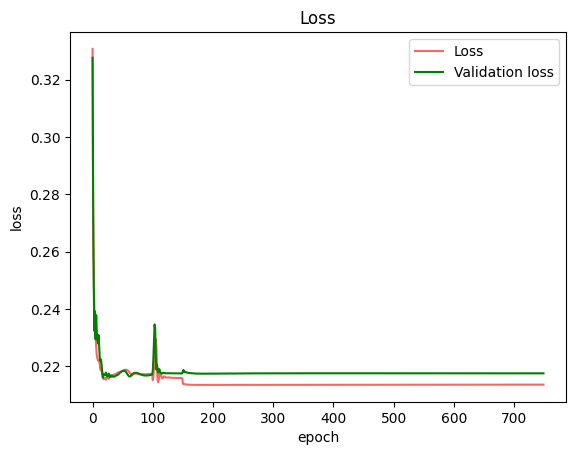

Epoch:  0 | Cost: 0.213290 | Train accuracy: 0.931429 | Validation Accuracy: 0.920000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 1, 1, 3, 3)
step 1, accuracy_train:0.5485714285714286, loss: 0.31052951977570004
step 2, accuracy_train:0.6428571428571429, loss: 0.2839122339542175
step 3, accuracy_train:0.7685714285714286, loss: 0.24054549436092412
step 4, accuracy_train:0.8171428571428572, loss: 0.22134915683646142
step 5, accuracy_train:0.8428571428571429, loss: 0.2084741377646012
step 6, accuracy_train:0.8771428571428571, loss: 0.1924761439557977
step 7, accuracy_train:0.8942857142857142, loss: 0.18178599964151534
step 8, accuracy_train:0.9171428571428571, loss: 0.17559790016446863
step 9, accuracy_train:0.9171428571428571, loss: 0.17302874731466147
step 10, accuracy_train:0.9114285714285715, loss: 0.1727463025182221
step 11, accuracy_train:0.9057142857142857, loss: 0.1719590149687834
step 12, accuracy_train:0.9028571428571428, loss: 0.17129783170464982
step 13, accuracy_train:0.90571428571428

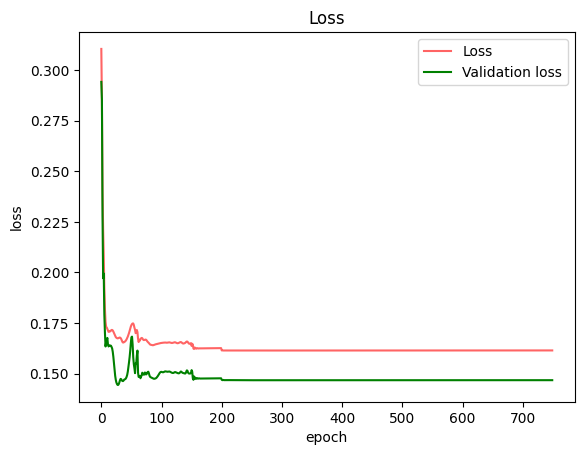

Epoch:  0 | Cost: 0.161195 | Train accuracy: 0.928571 | Validation Accuracy: 0.960000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 1, 1, 3, 3)
step 1, accuracy_train:0.6714285714285714, loss: 0.26124702758088303
step 2, accuracy_train:0.76, loss: 0.24000012636737555
step 3, accuracy_train:0.7485714285714286, loss: 0.23282121620713547
step 4, accuracy_train:0.8085714285714286, loss: 0.20538173094451898
step 5, accuracy_train:0.8742857142857143, loss: 0.18975318157655396
step 6, accuracy_train:0.8428571428571429, loss: 0.19592482245668003
step 7, accuracy_train:0.8314285714285714, loss: 0.1998816417241185
step 8, accuracy_train:0.8485714285714285, loss: 0.18683583814665553
step 9, accuracy_train:0.8914285714285715, loss: 0.1764587365627014
step 10, accuracy_train:0.9114285714285715, loss: 0.16831036240965794
step 11, accuracy_train:0.9228571428571428, loss: 0.16750547919932549
step 12, accuracy_train:0.9228571428571428, loss: 0.16028259052102023
step 13, accuracy_train:0.9085714285714286, loss: 0

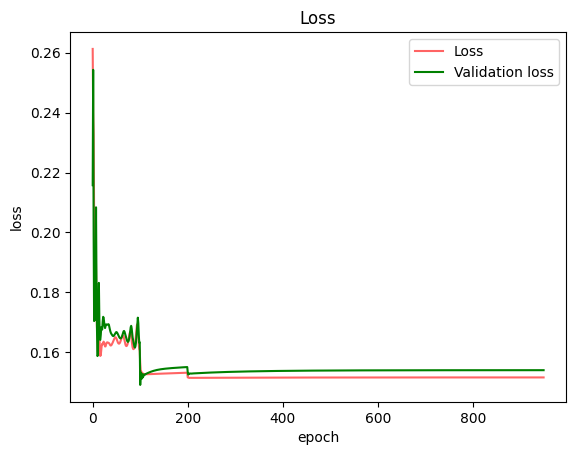

Epoch:  0 | Cost: 0.151180 | Train accuracy: 0.942857 | Validation Accuracy: 0.960000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 1, 1, 3, 3)
step 1, accuracy_train:0.6428571428571429, loss: 0.22780751896659826
step 2, accuracy_train:0.7571428571428571, loss: 0.18149631471529445
step 3, accuracy_train:0.8228571428571428, loss: 0.14621119038566044
step 4, accuracy_train:0.8342857142857143, loss: 0.13459744983569838
step 5, accuracy_train:0.8514285714285714, loss: 0.12001037085206417
step 6, accuracy_train:0.8942857142857142, loss: 0.09997282268421936
step 7, accuracy_train:0.9, loss: 0.09059494808636433
step 8, accuracy_train:0.9171428571428571, loss: 0.08712780744044468
step 9, accuracy_train:0.9171428571428571, loss: 0.08631966984479202
step 10, accuracy_train:0.9028571428571428, loss: 0.09277937957109733
step 11, accuracy_train:0.8885714285714286, loss: 0.10006895246470918
step 12, accuracy_train:0.8657142857142858, loss: 0.11000003462820969
step 13, accuracy_train:0.8742857142857143, loss: 

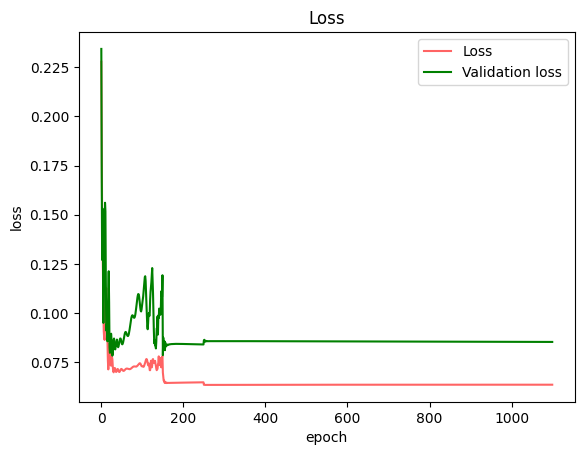

Epoch:  0 | Cost: 0.063140 | Train accuracy: 0.942857 | Validation Accuracy: 0.920000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 1, 1, 3, 3)
step 1, accuracy_train:0.6857142857142857, loss: 0.46304384587549857
step 2, accuracy_train:0.7457142857142857, loss: 0.452835216626937
step 3, accuracy_train:0.6371428571428571, loss: 0.45020773880426146
step 4, accuracy_train:0.6628571428571428, loss: 0.4488189975629779
step 5, accuracy_train:0.6771428571428572, loss: 0.4474140543691687
step 6, accuracy_train:0.6742857142857143, loss: 0.44743138737021493
step 7, accuracy_train:0.7, loss: 0.44675101425736863
step 8, accuracy_train:0.7371428571428571, loss: 0.4467734316545117
step 9, accuracy_train:0.7171428571428572, loss: 0.4465623652941112
step 10, accuracy_train:0.7028571428571428, loss: 0.4464395456179998
step 11, accuracy_train:0.7257142857142858, loss: 0.4463573388039581
step 12, accuracy_train:0.7457142857142857, loss: 0.44629120876791284
step 13, accuracy_train:0.7485714285714286, loss: 0.446219

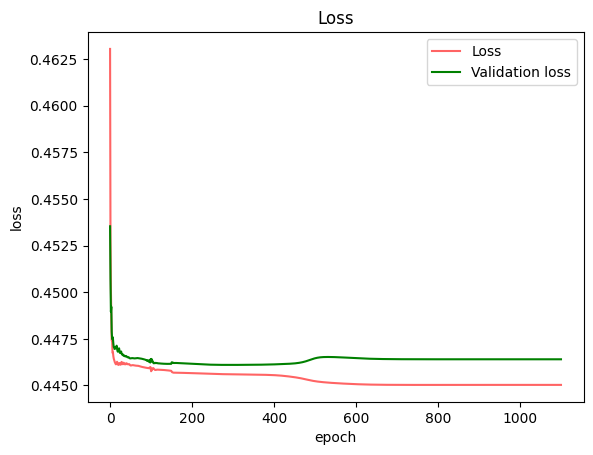

Epoch:  0 | Cost: 0.445012 | Train accuracy: 0.860000 | Validation Accuracy: 0.800000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 1, 1, 3, 3)
step 1, accuracy_train:0.6628571428571428, loss: 0.24416015388514425
step 2, accuracy_train:0.7542857142857143, loss: 0.20391747455484144
step 3, accuracy_train:0.7742857142857142, loss: 0.1912043148663433
step 4, accuracy_train:0.8142857142857143, loss: 0.18394626106671208
step 5, accuracy_train:0.8828571428571429, loss: 0.15288434583505847
step 6, accuracy_train:0.9, loss: 0.1381167854125153
step 7, accuracy_train:0.9085714285714286, loss: 0.14093354344466977
step 8, accuracy_train:0.8971428571428571, loss: 0.14685376602953668
step 9, accuracy_train:0.9057142857142857, loss: 0.14401774262790903
step 10, accuracy_train:0.9085714285714286, loss: 0.14546633873353518
step 11, accuracy_train:0.9057142857142857, loss: 0.14221097816471528
step 12, accuracy_train:0.9285714285714286, loss: 0.1338305215903274
step 13, accuracy_train:0.92, loss: 0.134470965790730

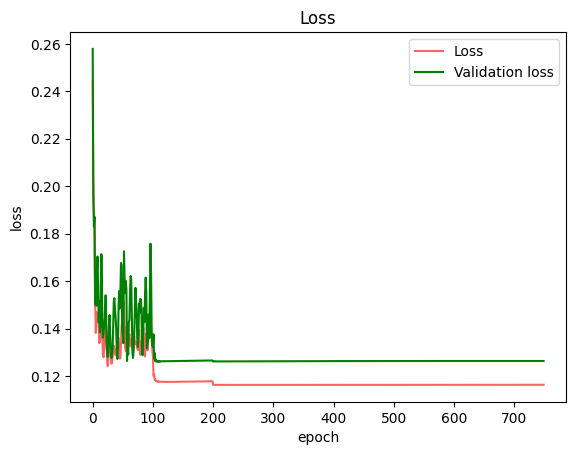

Epoch:  0 | Cost: 0.115929 | Train accuracy: 0.940000 | Validation Accuracy: 0.920000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 1, 1, 3, 3)
step 1, accuracy_train:0.5657142857142857, loss: 0.3973656080294251
step 2, accuracy_train:0.6371428571428571, loss: 0.37801105873769936
step 3, accuracy_train:0.8, loss: 0.344236228436622
step 4, accuracy_train:0.8485714285714285, loss: 0.3315057525796848
step 5, accuracy_train:0.8228571428571428, loss: 0.3410397648723768
step 6, accuracy_train:0.8371428571428572, loss: 0.33133207617714194
step 7, accuracy_train:0.8714285714285714, loss: 0.32716292937461183
step 8, accuracy_train:0.88, loss: 0.3247053965515832
step 9, accuracy_train:0.9085714285714286, loss: 0.3186834105013665
step 10, accuracy_train:0.9114285714285715, loss: 0.31705802537394057
step 11, accuracy_train:0.8828571428571429, loss: 0.3205968478567992
step 12, accuracy_train:0.88, loss: 0.3231414085732418
step 13, accuracy_train:0.8971428571428571, loss: 0.32076196848406063
step 14, accuracy

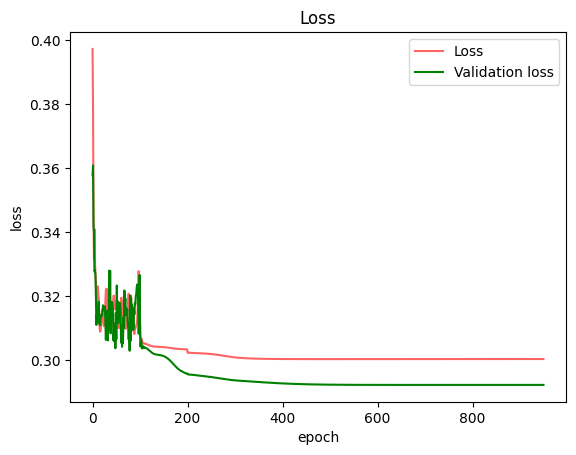

Epoch:  0 | Cost: 0.300266 | Train accuracy: 0.940000 | Validation Accuracy: 0.960000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 1, 1, 3, 3)
step 1, accuracy_train:0.7, loss: 0.26221982014878314
step 2, accuracy_train:0.7628571428571429, loss: 0.24278160711059668
step 3, accuracy_train:0.8057142857142857, loss: 0.22665581797781664
step 4, accuracy_train:0.8485714285714285, loss: 0.21710764107531644
step 5, accuracy_train:0.8771428571428571, loss: 0.20715137351198543
step 6, accuracy_train:0.8885714285714286, loss: 0.203944414797591
step 7, accuracy_train:0.8885714285714286, loss: 0.2053077004867055
step 8, accuracy_train:0.9, loss: 0.2013974933901057
step 9, accuracy_train:0.9085714285714286, loss: 0.19479051808791084
step 10, accuracy_train:0.9228571428571428, loss: 0.18999154827432893
step 11, accuracy_train:0.9171428571428571, loss: 0.19016143512988787
step 12, accuracy_train:0.9257142857142857, loss: 0.18960090198747376
step 13, accuracy_train:0.9257142857142857, loss: 0.1913450372796968


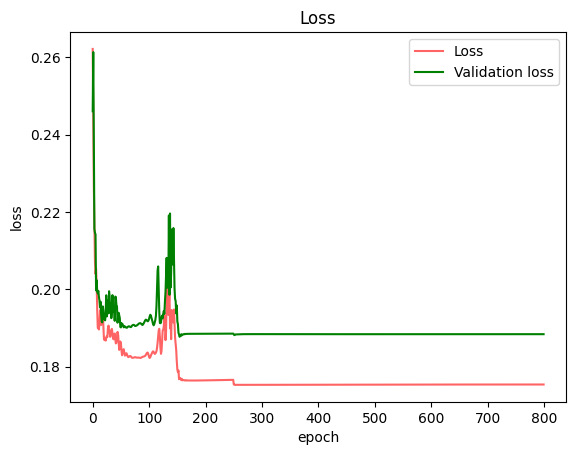

Epoch:  0 | Cost: 0.175042 | Train accuracy: 0.937143 | Validation Accuracy: 0.920000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 1, 1, 3, 3)
step 1, accuracy_train:0.6314285714285715, loss: 0.26232420199044926
step 2, accuracy_train:0.86, loss: 0.18087547497288917
step 3, accuracy_train:0.8942857142857142, loss: 0.16378084761420464
step 4, accuracy_train:0.8857142857142857, loss: 0.1643275291914786
step 5, accuracy_train:0.9114285714285715, loss: 0.15314658880122226
step 6, accuracy_train:0.9171428571428571, loss: 0.1485618391007857
step 7, accuracy_train:0.92, loss: 0.14488759429384354
step 8, accuracy_train:0.9371428571428572, loss: 0.1450382339729783
step 9, accuracy_train:0.94, loss: 0.13893039912311111
step 10, accuracy_train:0.9342857142857143, loss: 0.13855954233422277
step 11, accuracy_train:0.9371428571428572, loss: 0.13868156878080481
step 12, accuracy_train:0.9371428571428572, loss: 0.1374217178435079
step 13, accuracy_train:0.9371428571428572, loss: 0.13656412146044516
step 14, ac

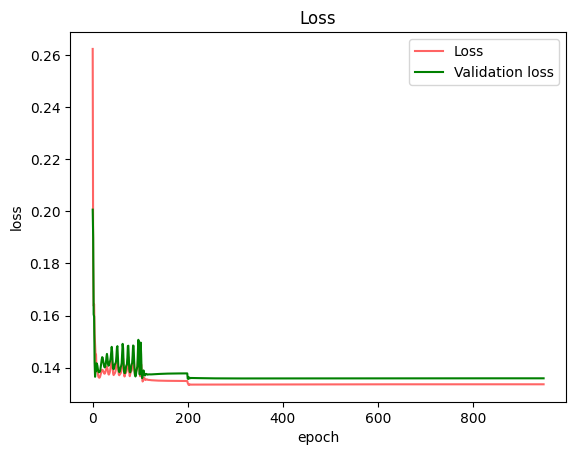

Epoch:  0 | Cost: 0.133385 | Train accuracy: 0.937143 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 1, 1, 3, 3)
step 1, accuracy_train:0.5285714285714286, loss: 0.31735978287509836
step 2, accuracy_train:0.6114285714285714, loss: 0.3017797003340544
step 3, accuracy_train:0.7542857142857143, loss: 0.2520423003638146
step 4, accuracy_train:0.7828571428571428, loss: 0.24178637075005854
step 5, accuracy_train:0.8514285714285714, loss: 0.22474114289450503
step 6, accuracy_train:0.8771428571428571, loss: 0.2153548419089445
step 7, accuracy_train:0.9085714285714286, loss: 0.20526445758857692
step 8, accuracy_train:0.9, loss: 0.20462807748550985
step 9, accuracy_train:0.9, loss: 0.2066420731146264
step 10, accuracy_train:0.8885714285714286, loss: 0.20844293996791308
step 11, accuracy_train:0.8885714285714286, loss: 0.2047645465704149
step 12, accuracy_train:0.9085714285714286, loss: 0.1999721832175406
step 13, accuracy_train:0.9142857142857143, loss: 0.19936878185936482
s

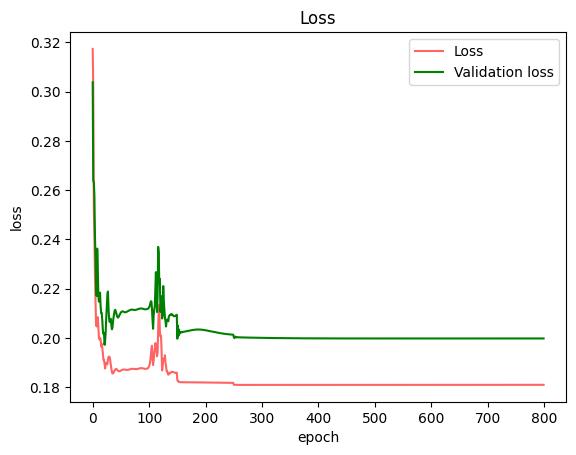

Epoch:  0 | Cost: 0.180733 | Train accuracy: 0.962857 | Validation Accuracy: 0.900000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 1, 1, 3, 3)
t_n_seeds: 153.78415989999485


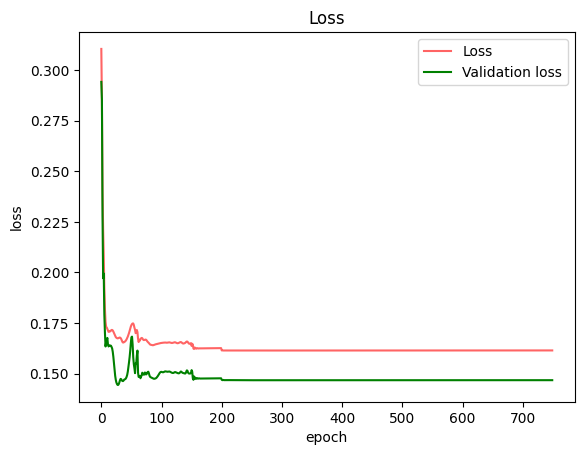

step 1, accuracy_train:0.6525, loss: 0.28868096619146777
step 2, accuracy_train:0.8375, loss: 0.21567101431355856
step 3, accuracy_train:0.85, loss: 0.20558639193437145
step 4, accuracy_train:0.895, loss: 0.18854794093953842
step 5, accuracy_train:0.9125, loss: 0.18319526195017097
step 6, accuracy_train:0.915, loss: 0.1796359750396732
step 7, accuracy_train:0.9175, loss: 0.17849582258514224
step 8, accuracy_train:0.93, loss: 0.17465531265889267
step 9, accuracy_train:0.9325, loss: 0.17338293042894765
step 10, accuracy_train:0.935, loss: 0.17202052639169874
step 11, accuracy_train:0.935, loss: 0.17233470335646406
step 12, accuracy_train:0.94, loss: 0.17205360101821066
step 13, accuracy_train:0.935, loss: 0.17147418750388238
step 14, accuracy_train:0.9425, loss: 0.17078487796269903
step 15, accuracy_train:0.94, loss: 0.1708207448214244
step 16, accuracy_train:0.9275, loss: 0.17137750214016978
step 17, accuracy_train:0.925, loss: 0.17183891038464788
step 18, accuracy_train:0.925, loss: 0.

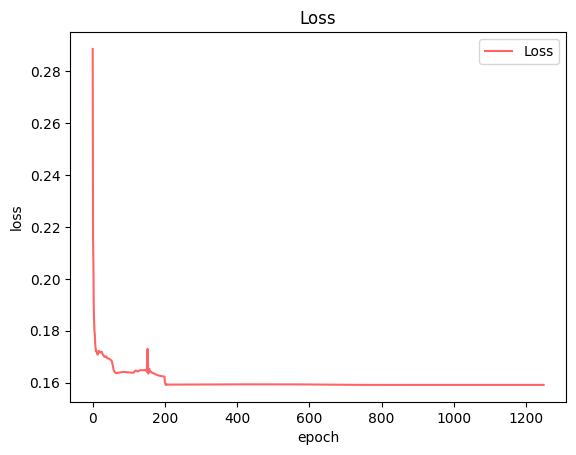

Epoch:  0 | Cost: 0.158691 | Train accuracy: 0.930000 | Test Accuracy: 0.920000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 1, 1, 3, 3)


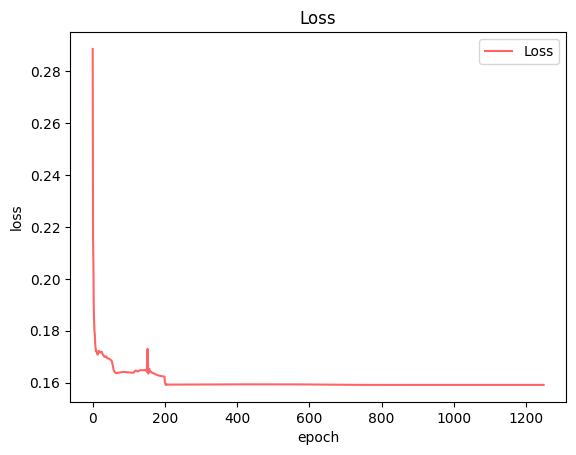

step 1, accuracy_train:0.5542857142857143, loss: 0.3573716783014247
step 2, accuracy_train:0.7485714285714286, loss: 0.19596769875868691
step 3, accuracy_train:0.7971428571428572, loss: 0.17526887219170204
step 4, accuracy_train:0.8371428571428572, loss: 0.15148500310197865
step 5, accuracy_train:0.8371428571428572, loss: 0.12994538956569227
step 6, accuracy_train:0.8828571428571429, loss: 0.10644113079839568
step 7, accuracy_train:0.8885714285714286, loss: 0.0961744416581231
step 8, accuracy_train:0.8914285714285715, loss: 0.09265160916067969
step 9, accuracy_train:0.9142857142857143, loss: 0.07839939097623466
step 10, accuracy_train:0.9142857142857143, loss: 0.07827163429944413
step 11, accuracy_train:0.9171428571428571, loss: 0.07643966152628104
step 12, accuracy_train:0.9142857142857143, loss: 0.0702350051165554
step 13, accuracy_train:0.9114285714285715, loss: 0.06818406334022842
step 14, accuracy_train:0.92, loss: 0.06462651212889733
step 15, accuracy_train:0.9171428571428571, lo

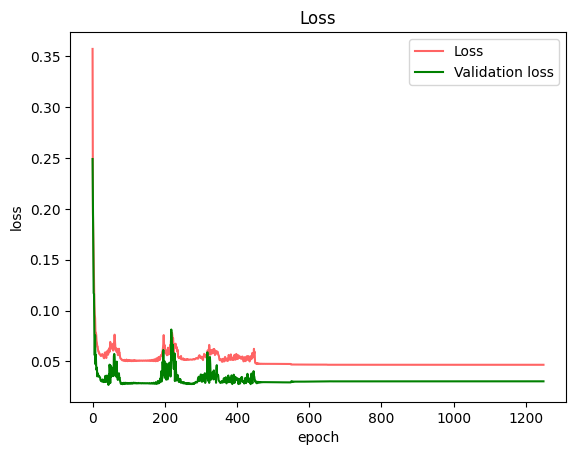

Epoch:  0 | Cost: 0.046375 | Train accuracy: 0.931429 | Validation Accuracy: 0.980000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 2, 1, 3, 3)
step 1, accuracy_train:0.5028571428571429, loss: 0.3325168663489865
step 2, accuracy_train:0.8028571428571428, loss: 0.18570978328979165
step 3, accuracy_train:0.8314285714285714, loss: 0.14272669070372956
step 4, accuracy_train:0.84, loss: 0.14914191207963512
step 5, accuracy_train:0.8371428571428572, loss: 0.12442342945235751
step 6, accuracy_train:0.8885714285714286, loss: 0.10780098280511258
step 7, accuracy_train:0.8828571428571429, loss: 0.0930721290967815
step 8, accuracy_train:0.9085714285714286, loss: 0.08216620485757062
step 9, accuracy_train:0.9142857142857143, loss: 0.0764424317286571
step 10, accuracy_train:0.92, loss: 0.0694628510703109
step 11, accuracy_train:0.9228571428571428, loss: 0.06810839207403241
step 12, accuracy_train:0.9, loss: 0.06946376458312489
step 13, accuracy_train:0.9257142857142857, loss: 0.06570350677465753
step 14, acc

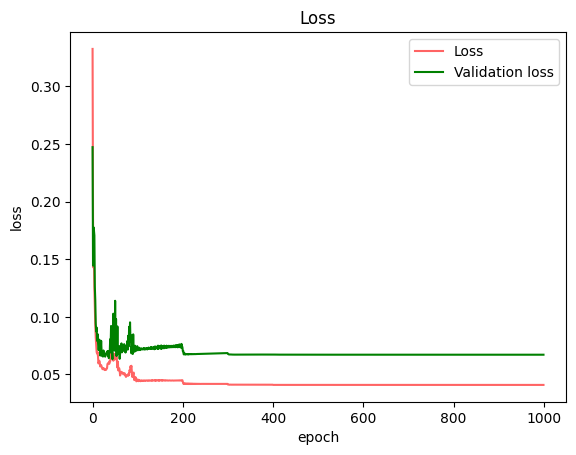

Epoch:  0 | Cost: 0.041680 | Train accuracy: 0.942857 | Validation Accuracy: 0.920000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 2, 1, 3, 3)
step 1, accuracy_train:0.6028571428571429, loss: 0.27320035789226077
step 2, accuracy_train:0.7657142857142857, loss: 0.18034884539700852
step 3, accuracy_train:0.7971428571428572, loss: 0.17143454352266968
step 4, accuracy_train:0.8171428571428572, loss: 0.1338851945861258
step 5, accuracy_train:0.8542857142857143, loss: 0.11593903845173642
step 6, accuracy_train:0.8828571428571429, loss: 0.09734319880678048
step 7, accuracy_train:0.9028571428571428, loss: 0.08796051821908334
step 8, accuracy_train:0.9, loss: 0.0814562315520325
step 9, accuracy_train:0.9028571428571428, loss: 0.07554021146160111
step 10, accuracy_train:0.9142857142857143, loss: 0.06720516413688721
step 11, accuracy_train:0.9, loss: 0.07634200059958036
step 12, accuracy_train:0.9114285714285715, loss: 0.07412769172283284
step 13, accuracy_train:0.9285714285714286, loss: 0.059868217480889

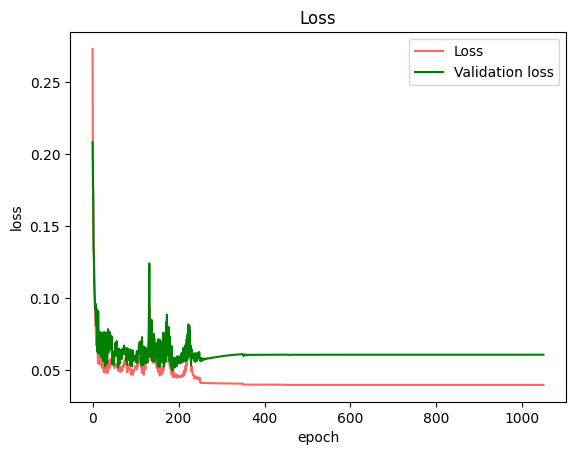

Epoch:  0 | Cost: 0.042858 | Train accuracy: 0.945714 | Validation Accuracy: 0.920000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 2, 1, 3, 3)
step 1, accuracy_train:0.6142857142857143, loss: 0.2768769777403022
step 2, accuracy_train:0.8142857142857143, loss: 0.16545837973875374
step 3, accuracy_train:0.8142857142857143, loss: 0.16992661193564323
step 4, accuracy_train:0.8885714285714286, loss: 0.12804649795174
step 5, accuracy_train:0.8857142857142857, loss: 0.11721546536860249
step 6, accuracy_train:0.8914285714285715, loss: 0.09457016878144224
step 7, accuracy_train:0.9057142857142857, loss: 0.08543101768295039
step 8, accuracy_train:0.9114285714285715, loss: 0.07590493423532334
step 9, accuracy_train:0.92, loss: 0.06919224364331719
step 10, accuracy_train:0.92, loss: 0.06347675424580816
step 11, accuracy_train:0.9142857142857143, loss: 0.06782815323197339
step 12, accuracy_train:0.92, loss: 0.06323356105656838
step 13, accuracy_train:0.9228571428571428, loss: 0.05534750915194519
step 14, ac

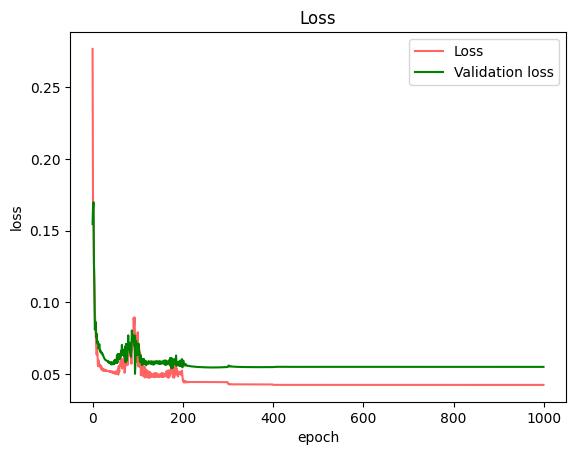

Epoch:  0 | Cost: 0.044157 | Train accuracy: 0.934286 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 2, 1, 3, 3)
step 1, accuracy_train:0.5628571428571428, loss: 0.3374395356990127
step 2, accuracy_train:0.8, loss: 0.18039420208294055
step 3, accuracy_train:0.8085714285714286, loss: 0.14061391123454078
step 4, accuracy_train:0.8485714285714285, loss: 0.15124725756264268
step 5, accuracy_train:0.8771428571428571, loss: 0.13410803380195968
step 6, accuracy_train:0.9085714285714286, loss: 0.09196278128189148
step 7, accuracy_train:0.9, loss: 0.09459850360866554
step 8, accuracy_train:0.9171428571428571, loss: 0.08353729818867206
step 9, accuracy_train:0.9171428571428571, loss: 0.0680307904892759
step 10, accuracy_train:0.9171428571428571, loss: 0.06838044270195193
step 11, accuracy_train:0.9228571428571428, loss: 0.06340802495073601
step 12, accuracy_train:0.9257142857142857, loss: 0.059559938185114354
step 13, accuracy_train:0.9314285714285714, loss: 0.05653934879990

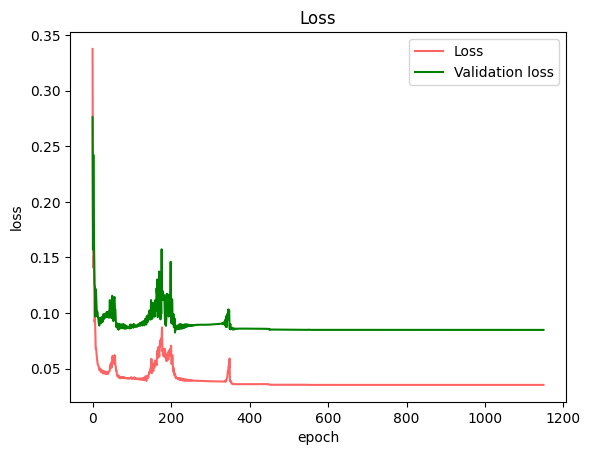

Epoch:  0 | Cost: 0.037685 | Train accuracy: 0.954286 | Validation Accuracy: 0.880000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 2, 1, 3, 3)
step 1, accuracy_train:0.5942857142857143, loss: 0.26474381522873736
step 2, accuracy_train:0.8371428571428572, loss: 0.16702999084905878
step 3, accuracy_train:0.7971428571428572, loss: 0.1632018693946439
step 4, accuracy_train:0.8571428571428571, loss: 0.13875213576394152
step 5, accuracy_train:0.9085714285714286, loss: 0.10230518446484653
step 6, accuracy_train:0.9, loss: 0.0906658311746337
step 7, accuracy_train:0.9, loss: 0.0836342155907034
step 8, accuracy_train:0.9, loss: 0.07559212430785348
step 9, accuracy_train:0.9228571428571428, loss: 0.06645337795780029
step 10, accuracy_train:0.9257142857142857, loss: 0.062319400775255454
step 11, accuracy_train:0.9314285714285714, loss: 0.06201741556385135
step 12, accuracy_train:0.9314285714285714, loss: 0.0638705456009164
step 13, accuracy_train:0.9342857142857143, loss: 0.056647534726990044
step 14, acc

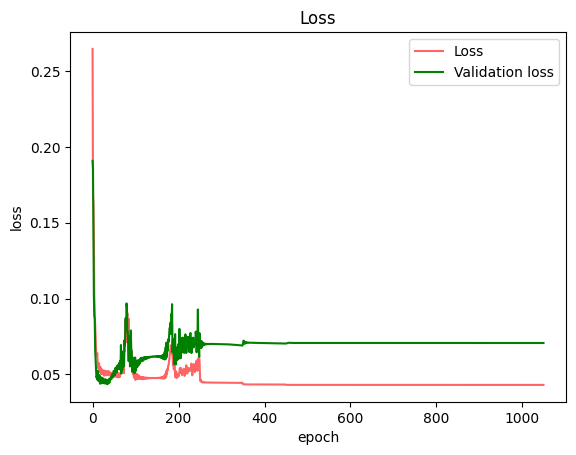

Epoch:  0 | Cost: 0.041954 | Train accuracy: 0.948571 | Validation Accuracy: 0.900000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 2, 1, 3, 3)
step 1, accuracy_train:0.5057142857142857, loss: 0.2736405653954815
step 2, accuracy_train:0.8085714285714286, loss: 0.17692147847285292
step 3, accuracy_train:0.8257142857142857, loss: 0.15933843708421436
step 4, accuracy_train:0.8657142857142858, loss: 0.12013578326369245
step 5, accuracy_train:0.8771428571428571, loss: 0.11175397000326434
step 6, accuracy_train:0.8771428571428571, loss: 0.09507942100649414
step 7, accuracy_train:0.8971428571428571, loss: 0.09986808831901695
step 8, accuracy_train:0.8771428571428571, loss: 0.09270624950692367
step 9, accuracy_train:0.9085714285714286, loss: 0.07849273903261064
step 10, accuracy_train:0.9285714285714286, loss: 0.07083123726922154
step 11, accuracy_train:0.9171428571428571, loss: 0.07309809121788201
step 12, accuracy_train:0.9114285714285715, loss: 0.07862550648331289
step 13, accuracy_train:0.9371428571

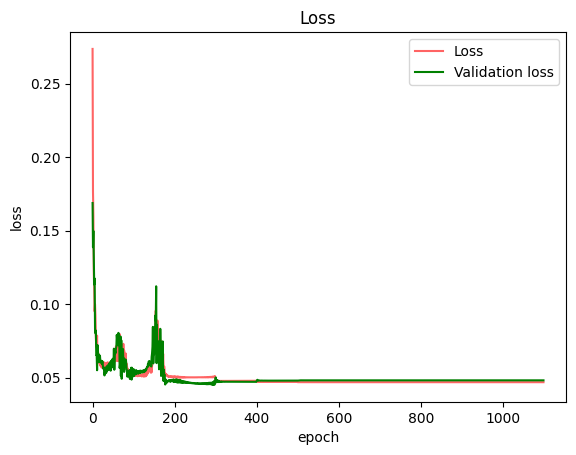

Epoch:  0 | Cost: 0.044785 | Train accuracy: 0.942857 | Validation Accuracy: 0.900000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 2, 1, 3, 3)
step 1, accuracy_train:0.7114285714285714, loss: 0.2495330160875538
step 2, accuracy_train:0.82, loss: 0.15358081888695996
step 3, accuracy_train:0.8142857142857143, loss: 0.17362591838465072
step 4, accuracy_train:0.8514285714285714, loss: 0.12782457927196253
step 5, accuracy_train:0.8857142857142857, loss: 0.10947144602243375
step 6, accuracy_train:0.9085714285714286, loss: 0.09570522758512132
step 7, accuracy_train:0.8828571428571429, loss: 0.08972503841305662
step 8, accuracy_train:0.9171428571428571, loss: 0.07167977022387936
step 9, accuracy_train:0.8885714285714286, loss: 0.07582305269018554
step 10, accuracy_train:0.9228571428571428, loss: 0.06739481824425671
step 11, accuracy_train:0.9085714285714286, loss: 0.06462042602230501
step 12, accuracy_train:0.9142857142857143, loss: 0.06675421743416542
step 13, accuracy_train:0.9171428571428571, loss: 

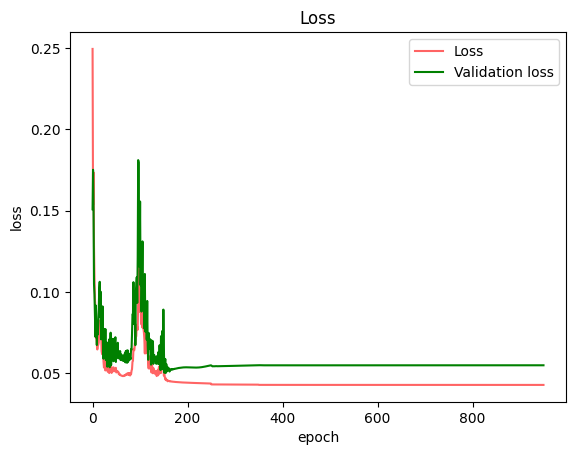

Epoch:  0 | Cost: 0.044531 | Train accuracy: 0.942857 | Validation Accuracy: 0.920000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 2, 1, 3, 3)
step 1, accuracy_train:0.5085714285714286, loss: 0.28598357780546435
step 2, accuracy_train:0.7542857142857143, loss: 0.195097059047367
step 3, accuracy_train:0.7885714285714286, loss: 0.18130412036987917
step 4, accuracy_train:0.8371428571428572, loss: 0.15011855508764932
step 5, accuracy_train:0.8514285714285714, loss: 0.14724870488460678
step 6, accuracy_train:0.8571428571428571, loss: 0.12603127356000482
step 7, accuracy_train:0.8942857142857142, loss: 0.09265828196487143
step 8, accuracy_train:0.8885714285714286, loss: 0.09729565087651043
step 9, accuracy_train:0.9114285714285715, loss: 0.0817133621372993
step 10, accuracy_train:0.9057142857142857, loss: 0.08260262362615164
step 11, accuracy_train:0.9228571428571428, loss: 0.07506765130084211
step 12, accuracy_train:0.9057142857142857, loss: 0.07707763943131854
step 13, accuracy_train:0.908571428571

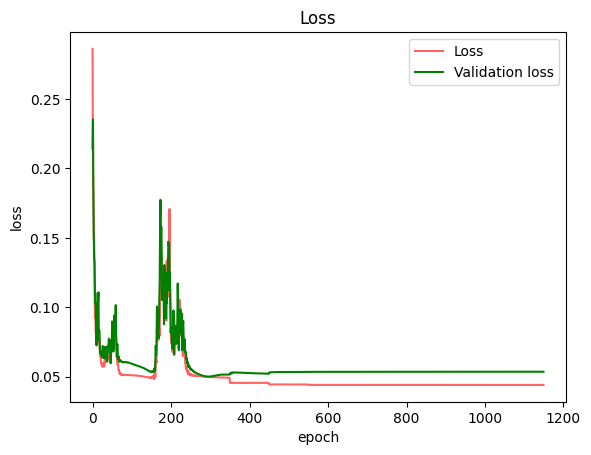

Epoch:  0 | Cost: 0.044786 | Train accuracy: 0.940000 | Validation Accuracy: 0.920000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 2, 1, 3, 3)
step 1, accuracy_train:0.6171428571428571, loss: 0.23369481066399922
step 2, accuracy_train:0.7342857142857143, loss: 0.1915505444508819
step 3, accuracy_train:0.8371428571428572, loss: 0.1461209834581395
step 4, accuracy_train:0.8571428571428571, loss: 0.12136831967169548
step 5, accuracy_train:0.8885714285714286, loss: 0.10214317770778525
step 6, accuracy_train:0.8914285714285715, loss: 0.09533282200261242
step 7, accuracy_train:0.8971428571428571, loss: 0.08043958011830601
step 8, accuracy_train:0.9057142857142857, loss: 0.0756632835124221
step 9, accuracy_train:0.9, loss: 0.07005566324163943
step 10, accuracy_train:0.92, loss: 0.06778731827992909
step 11, accuracy_train:0.9342857142857143, loss: 0.06278531042814853
step 12, accuracy_train:0.9171428571428571, loss: 0.0648744467155053
step 13, accuracy_train:0.9285714285714286, loss: 0.0581339242881721

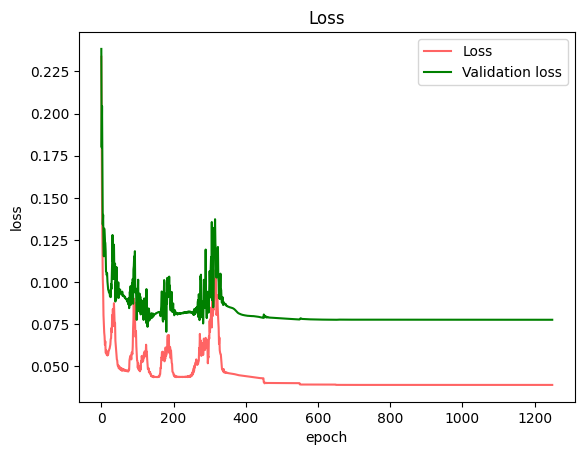

Epoch:  0 | Cost: 0.039531 | Train accuracy: 0.948571 | Validation Accuracy: 0.860000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 2, 1, 3, 3)
t_n_seeds: 241.09274800000276


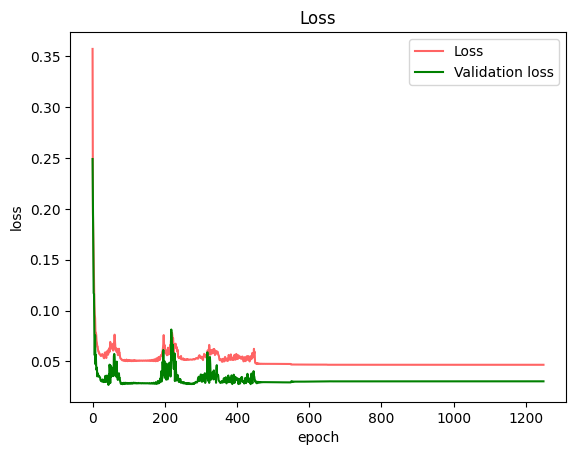

step 1, accuracy_train:0.56, loss: 0.36438102387804416
step 2, accuracy_train:0.745, loss: 0.20048325464663366
step 3, accuracy_train:0.805, loss: 0.16513061080927532
step 4, accuracy_train:0.835, loss: 0.15356876337682232
step 5, accuracy_train:0.85, loss: 0.1289680012381406
step 6, accuracy_train:0.905, loss: 0.10503767957316082
step 7, accuracy_train:0.9, loss: 0.09885125572140308
step 8, accuracy_train:0.9175, loss: 0.0782003373937967
step 9, accuracy_train:0.9225, loss: 0.0750507061531687
step 10, accuracy_train:0.905, loss: 0.08010087110800293
step 11, accuracy_train:0.9175, loss: 0.06735515224599882
step 12, accuracy_train:0.9125, loss: 0.0651360873737348
step 13, accuracy_train:0.91, loss: 0.06726159599870207
step 14, accuracy_train:0.9225, loss: 0.05890442915729231
step 15, accuracy_train:0.9275, loss: 0.057652698332714976
step 16, accuracy_train:0.915, loss: 0.06417597274967804
step 17, accuracy_train:0.92, loss: 0.05662377125675974
step 18, accuracy_train:0.92, loss: 0.05807

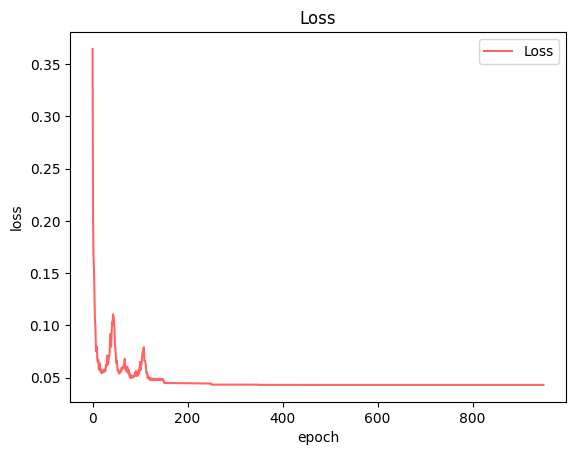

Epoch:  0 | Cost: 0.043159 | Train accuracy: 0.942500 | Test Accuracy: 0.910000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 2, 1, 3, 3)


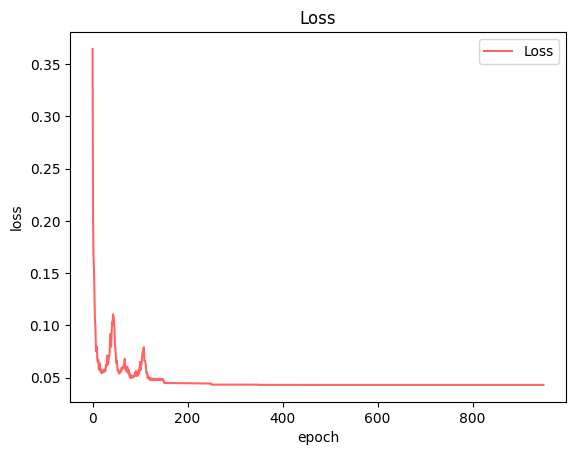

step 1, accuracy_train:0.64, loss: 0.279529890178171
step 2, accuracy_train:0.7571428571428571, loss: 0.21237907630814598
step 3, accuracy_train:0.6942857142857143, loss: 0.20941777380832255
step 4, accuracy_train:0.78, loss: 0.18602118276251758
step 5, accuracy_train:0.8485714285714285, loss: 0.14813967072466686
step 6, accuracy_train:0.8971428571428571, loss: 0.1217138241305676
step 7, accuracy_train:0.8742857142857143, loss: 0.10543940602510311
step 8, accuracy_train:0.9028571428571428, loss: 0.07883678332959525
step 9, accuracy_train:0.9085714285714286, loss: 0.0737163898315916
step 10, accuracy_train:0.9285714285714286, loss: 0.07267658503863227
step 11, accuracy_train:0.9228571428571428, loss: 0.07079946036442718
step 12, accuracy_train:0.9342857142857143, loss: 0.07091694064592179
step 13, accuracy_train:0.9228571428571428, loss: 0.07230643273161606
step 14, accuracy_train:0.9285714285714286, loss: 0.07136456765576005
step 15, accuracy_train:0.92, loss: 0.07091624723751137
step 

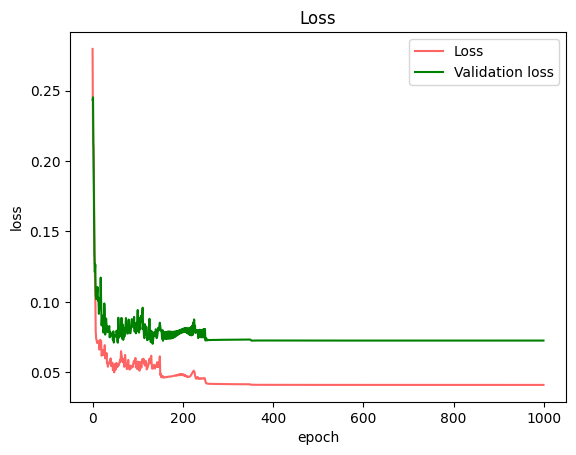

Epoch:  0 | Cost: 0.041021 | Train accuracy: 0.945714 | Validation Accuracy: 0.920000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 3, 1, 3, 3)
step 1, accuracy_train:0.5257142857142857, loss: 0.27130237596943596
step 2, accuracy_train:0.6485714285714286, loss: 0.23606785352609233
step 3, accuracy_train:0.6942857142857143, loss: 0.21288118787131508
step 4, accuracy_train:0.7371428571428571, loss: 0.19788689215643496
step 5, accuracy_train:0.7885714285714286, loss: 0.1902867643464651
step 6, accuracy_train:0.8114285714285714, loss: 0.17654479003915693
step 7, accuracy_train:0.8485714285714285, loss: 0.1582254668379126
step 8, accuracy_train:0.8685714285714285, loss: 0.14710535244465328
step 9, accuracy_train:0.8971428571428571, loss: 0.13167799590101234
step 10, accuracy_train:0.8942857142857142, loss: 0.11288639130318548
step 11, accuracy_train:0.9057142857142857, loss: 0.10458995980838642
step 12, accuracy_train:0.9057142857142857, loss: 0.10062267101238187
step 13, accuracy_train:0.92857142857

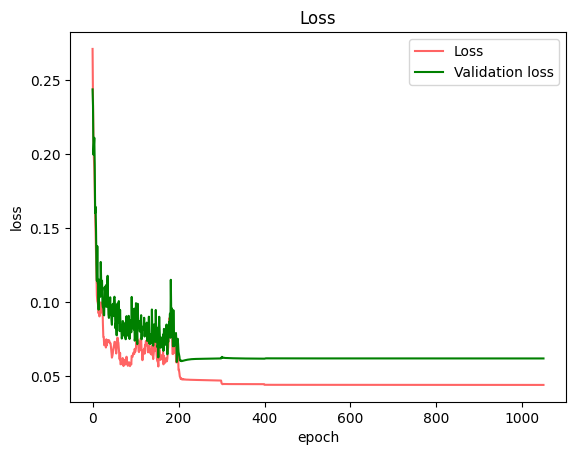

Epoch:  0 | Cost: 0.043824 | Train accuracy: 0.934286 | Validation Accuracy: 0.900000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 3, 1, 3, 3)
step 1, accuracy_train:0.6314285714285715, loss: 0.24391032578442465
step 2, accuracy_train:0.7228571428571429, loss: 0.2087745262353115
step 3, accuracy_train:0.7657142857142857, loss: 0.1935734660182576
step 4, accuracy_train:0.7885714285714286, loss: 0.17746807143329443
step 5, accuracy_train:0.8428571428571429, loss: 0.14810729134894104
step 6, accuracy_train:0.88, loss: 0.12725789332097495
step 7, accuracy_train:0.8914285714285715, loss: 0.1142237087249333
step 8, accuracy_train:0.8942857142857142, loss: 0.09667758522061204
step 9, accuracy_train:0.9028571428571428, loss: 0.08393604230410796
step 10, accuracy_train:0.9028571428571428, loss: 0.08409128426502935
step 11, accuracy_train:0.92, loss: 0.07703365541466167
step 12, accuracy_train:0.9057142857142857, loss: 0.08029836222763863
step 13, accuracy_train:0.9114285714285715, loss: 0.07981177070575

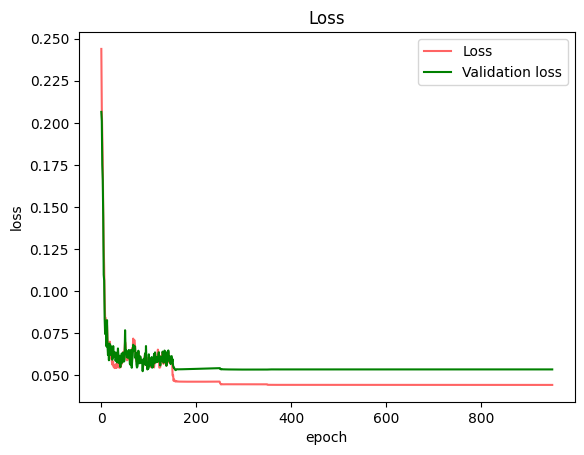

Epoch:  0 | Cost: 0.044344 | Train accuracy: 0.940000 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 3, 1, 3, 3)
step 1, accuracy_train:0.6485714285714286, loss: 0.24801631949503392
step 2, accuracy_train:0.7685714285714286, loss: 0.19696483578415894
step 3, accuracy_train:0.7914285714285715, loss: 0.18351385921180108
step 4, accuracy_train:0.84, loss: 0.15485565987915192
step 5, accuracy_train:0.8685714285714285, loss: 0.1331943959070696
step 6, accuracy_train:0.8971428571428571, loss: 0.1126858692532446
step 7, accuracy_train:0.9028571428571428, loss: 0.10237864989786978
step 8, accuracy_train:0.9085714285714286, loss: 0.09727679104798506
step 9, accuracy_train:0.9285714285714286, loss: 0.08762810584416576
step 10, accuracy_train:0.9085714285714286, loss: 0.08388146711826501
step 11, accuracy_train:0.9257142857142857, loss: 0.07544764075072075
step 12, accuracy_train:0.9342857142857143, loss: 0.06473902051054997
step 13, accuracy_train:0.9228571428571428, loss: 0

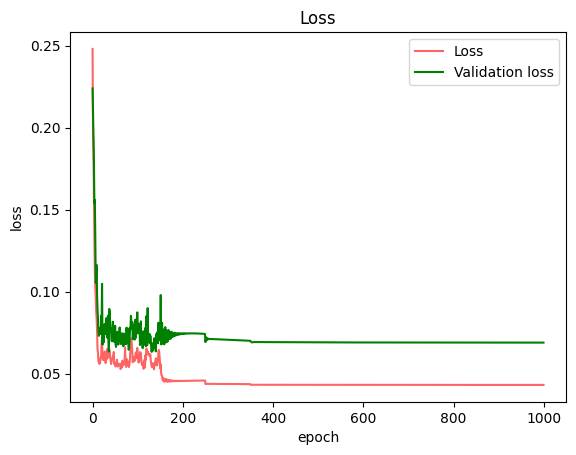

Epoch:  0 | Cost: 0.043195 | Train accuracy: 0.942857 | Validation Accuracy: 0.900000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 3, 1, 3, 3)
step 1, accuracy_train:0.6114285714285714, loss: 0.23762026404145292
step 2, accuracy_train:0.7657142857142857, loss: 0.20783382557245306
step 3, accuracy_train:0.7771428571428571, loss: 0.17904484394693
step 4, accuracy_train:0.84, loss: 0.1339394578589008
step 5, accuracy_train:0.8542857142857143, loss: 0.13509328644018317
step 6, accuracy_train:0.8771428571428571, loss: 0.11805641114372545
step 7, accuracy_train:0.8914285714285715, loss: 0.10493038879451451
step 8, accuracy_train:0.8685714285714285, loss: 0.10888745295064961
step 9, accuracy_train:0.8971428571428571, loss: 0.09689272236613866
step 10, accuracy_train:0.8914285714285715, loss: 0.09313524729677454
step 11, accuracy_train:0.8885714285714286, loss: 0.08525410432783423
step 12, accuracy_train:0.9028571428571428, loss: 0.08580176006178926
step 13, accuracy_train:0.9057142857142857, loss: 0.0

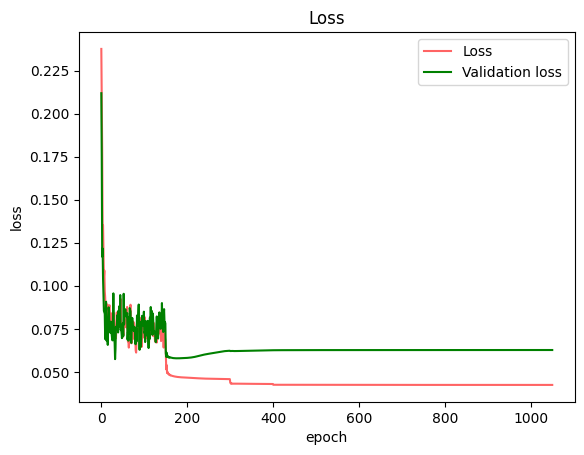

Epoch:  0 | Cost: 0.042402 | Train accuracy: 0.942857 | Validation Accuracy: 0.920000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 3, 1, 3, 3)
step 1, accuracy_train:0.6657142857142857, loss: 0.24847453253412674
step 2, accuracy_train:0.8057142857142857, loss: 0.18622848612688359
step 3, accuracy_train:0.8228571428571428, loss: 0.15631147748265653
step 4, accuracy_train:0.8571428571428571, loss: 0.12289330476160225
step 5, accuracy_train:0.8714285714285714, loss: 0.11685391053950507
step 6, accuracy_train:0.8857142857142857, loss: 0.09838665286178297
step 7, accuracy_train:0.9114285714285715, loss: 0.09230867774321713
step 8, accuracy_train:0.9142857142857143, loss: 0.08042436269021024
step 9, accuracy_train:0.9285714285714286, loss: 0.07188817352343523
step 10, accuracy_train:0.9257142857142857, loss: 0.07343081694582106
step 11, accuracy_train:0.9228571428571428, loss: 0.07253053803645777
step 12, accuracy_train:0.9142857142857143, loss: 0.07999023886332346
step 13, accuracy_train:0.908571428

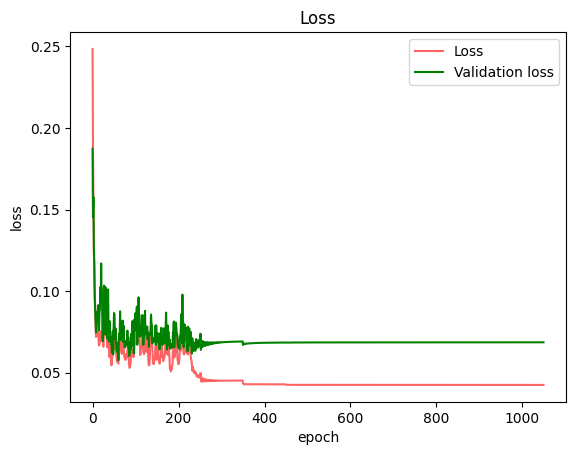

Epoch:  0 | Cost: 0.042426 | Train accuracy: 0.940000 | Validation Accuracy: 0.920000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 3, 1, 3, 3)
step 1, accuracy_train:0.6028571428571429, loss: 0.27724532019080245
step 2, accuracy_train:0.6657142857142857, loss: 0.24021717028681147
step 3, accuracy_train:0.6971428571428572, loss: 0.21510185043003371
step 4, accuracy_train:0.7428571428571429, loss: 0.19232779006385473
step 5, accuracy_train:0.7885714285714286, loss: 0.1765920837978081
step 6, accuracy_train:0.8485714285714285, loss: 0.15366021001304617
step 7, accuracy_train:0.8342857142857143, loss: 0.14956681559563495
step 8, accuracy_train:0.8142857142857143, loss: 0.13878195638701143
step 9, accuracy_train:0.8914285714285715, loss: 0.11329267093463344
step 10, accuracy_train:0.9257142857142857, loss: 0.0969729204054606
step 11, accuracy_train:0.9171428571428571, loss: 0.09033755511949046
step 12, accuracy_train:0.9, loss: 0.10582123697385067
step 13, accuracy_train:0.9057142857142857, loss: 0.

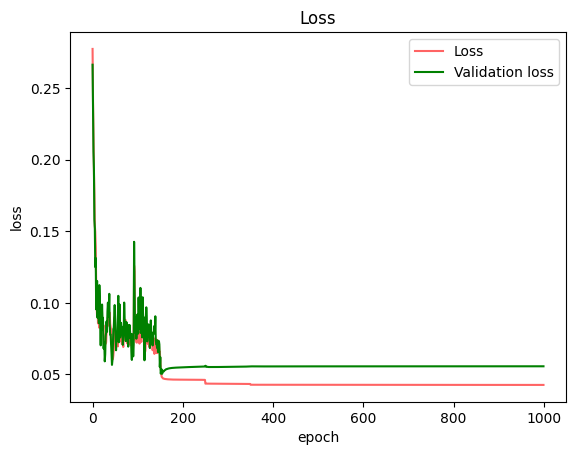

Epoch:  0 | Cost: 0.042696 | Train accuracy: 0.951429 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 3, 1, 3, 3)
step 1, accuracy_train:0.5571428571428572, loss: 0.26542919837873585
step 2, accuracy_train:0.6857142857142857, loss: 0.22748093828555388
step 3, accuracy_train:0.7514285714285714, loss: 0.20601377464589998
step 4, accuracy_train:0.7857142857142857, loss: 0.1884122045530185
step 5, accuracy_train:0.82, loss: 0.17469852335100358
step 6, accuracy_train:0.8114285714285714, loss: 0.16489936353149487
step 7, accuracy_train:0.8628571428571429, loss: 0.14164080061166803
step 8, accuracy_train:0.8657142857142858, loss: 0.13039707404784898
step 9, accuracy_train:0.8714285714285714, loss: 0.11265633950223963
step 10, accuracy_train:0.8885714285714286, loss: 0.10126833855468635
step 11, accuracy_train:0.9028571428571428, loss: 0.09608752454014259
step 12, accuracy_train:0.8742857142857143, loss: 0.10531819036334639
step 13, accuracy_train:0.8971428571428571, loss: 

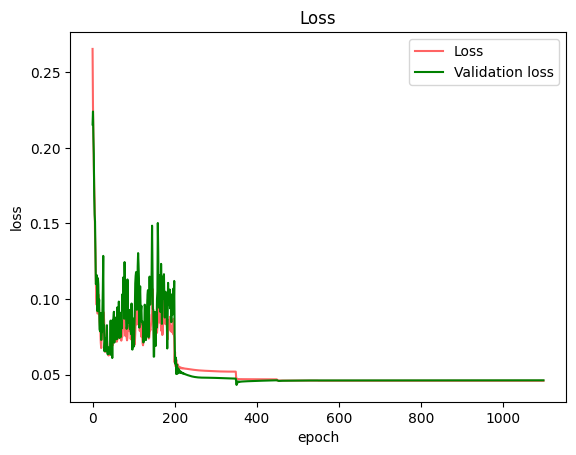

Epoch:  0 | Cost: 0.045895 | Train accuracy: 0.948571 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 3, 1, 3, 3)
step 1, accuracy_train:0.6685714285714286, loss: 0.29981201752949355
step 2, accuracy_train:0.7742857142857142, loss: 0.19976467247928706
step 3, accuracy_train:0.7314285714285714, loss: 0.21861232765143454
step 4, accuracy_train:0.7485714285714286, loss: 0.19648571402169468
step 5, accuracy_train:0.8228571428571428, loss: 0.15156276334685073
step 6, accuracy_train:0.8457142857142858, loss: 0.1382128814400522
step 7, accuracy_train:0.8942857142857142, loss: 0.11796449838083217
step 8, accuracy_train:0.88, loss: 0.10701490390667218
step 9, accuracy_train:0.9085714285714286, loss: 0.08882047439242557
step 10, accuracy_train:0.9171428571428571, loss: 0.08705741631925423
step 11, accuracy_train:0.8914285714285715, loss: 0.09788970544825687
step 12, accuracy_train:0.8914285714285715, loss: 0.09129856641257311
step 13, accuracy_train:0.88, loss: 0.090503804229

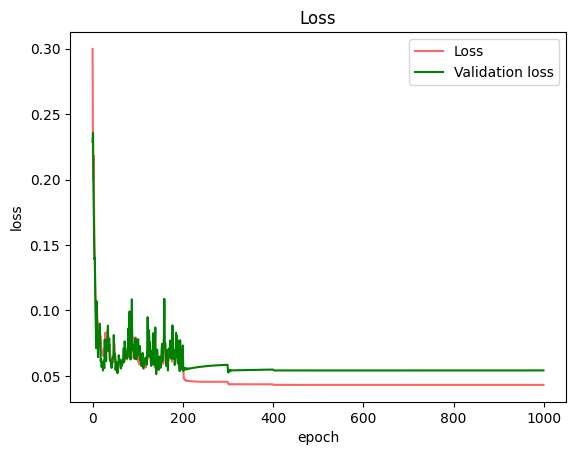

Epoch:  0 | Cost: 0.043149 | Train accuracy: 0.945714 | Validation Accuracy: 0.880000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 3, 1, 3, 3)
step 1, accuracy_train:0.5142857142857142, loss: 0.3036274667970839
step 2, accuracy_train:0.5942857142857143, loss: 0.2459628344348975
step 3, accuracy_train:0.6028571428571429, loss: 0.24179985327556194
step 4, accuracy_train:0.6571428571428571, loss: 0.21504566266780145
step 5, accuracy_train:0.7257142857142858, loss: 0.21163250146234194
step 6, accuracy_train:0.7142857142857143, loss: 0.2065761358149933
step 7, accuracy_train:0.7371428571428571, loss: 0.19239672802413393
step 8, accuracy_train:0.7828571428571428, loss: 0.1865872716040396
step 9, accuracy_train:0.8171428571428572, loss: 0.16048793593639463
step 10, accuracy_train:0.8342857142857143, loss: 0.14852230899494323
step 11, accuracy_train:0.8428571428571429, loss: 0.14030851222660903
step 12, accuracy_train:0.8571428571428571, loss: 0.12496492790330276
step 13, accuracy_train:0.9114285714285

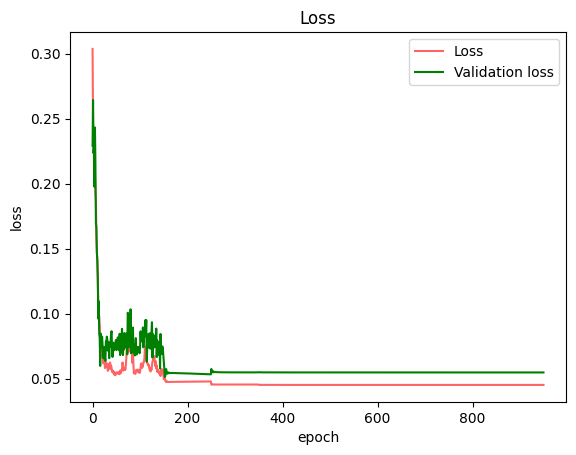

Epoch:  0 | Cost: 0.045062 | Train accuracy: 0.945714 | Validation Accuracy: 0.900000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 3, 1, 3, 3)
t_n_seeds: 342.4051252999998


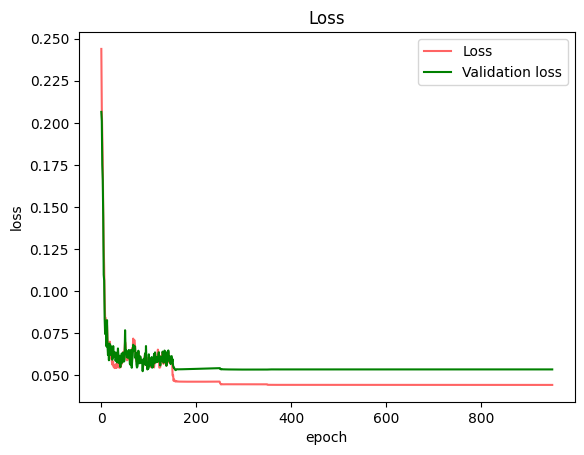

step 1, accuracy_train:0.505, loss: 0.2759072138088988
step 2, accuracy_train:0.655, loss: 0.22412289247748837
step 3, accuracy_train:0.755, loss: 0.17624794470603872
step 4, accuracy_train:0.8325, loss: 0.14139513967288142
step 5, accuracy_train:0.89, loss: 0.12795360944160583
step 6, accuracy_train:0.87, loss: 0.11710737563541587
step 7, accuracy_train:0.895, loss: 0.09828885295245886
step 8, accuracy_train:0.905, loss: 0.08982433031608805
step 9, accuracy_train:0.9075, loss: 0.08769209463107477
step 10, accuracy_train:0.92, loss: 0.08270161040716711
step 11, accuracy_train:0.9225, loss: 0.07981088139546615
step 12, accuracy_train:0.92, loss: 0.07529289801118522
step 13, accuracy_train:0.93, loss: 0.07515468327156097
step 14, accuracy_train:0.915, loss: 0.06877369641833762
step 15, accuracy_train:0.9325, loss: 0.062381014904094395
step 16, accuracy_train:0.9175, loss: 0.06928200093118755
step 17, accuracy_train:0.9275, loss: 0.06647671922532332
step 18, accuracy_train:0.935, loss: 0.

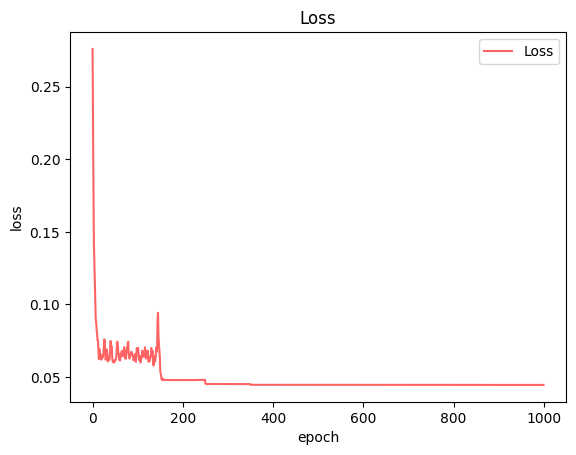

Epoch:  0 | Cost: 0.044568 | Train accuracy: 0.940000 | Test Accuracy: 0.960000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 3, 1, 3, 3)


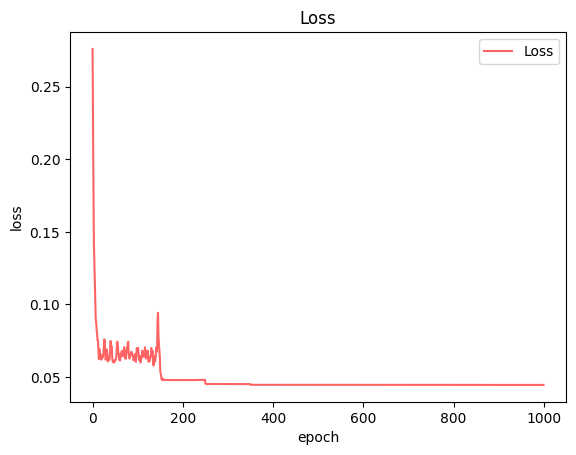

step 1, accuracy_train:0.5742857142857143, loss: 0.2885345632498545
step 2, accuracy_train:0.6457142857142857, loss: 0.2348660204247101
step 3, accuracy_train:0.7028571428571428, loss: 0.2152786853839829
step 4, accuracy_train:0.7685714285714286, loss: 0.2042865038840999
step 5, accuracy_train:0.84, loss: 0.19108381005073036
step 6, accuracy_train:0.8942857142857142, loss: 0.16683332826158292
step 7, accuracy_train:0.8857142857142857, loss: 0.15570450823670862
step 8, accuracy_train:0.9085714285714286, loss: 0.1402075010806394
step 9, accuracy_train:0.9, loss: 0.12530241033799547
step 10, accuracy_train:0.9085714285714286, loss: 0.11743414939327025
step 11, accuracy_train:0.9114285714285715, loss: 0.11247606451373218
step 12, accuracy_train:0.9142857142857143, loss: 0.10541827762782058
step 13, accuracy_train:0.9085714285714286, loss: 0.10061011293811294
step 14, accuracy_train:0.9142857142857143, loss: 0.08957537018187425
step 15, accuracy_train:0.9342857142857143, loss: 0.08731551163

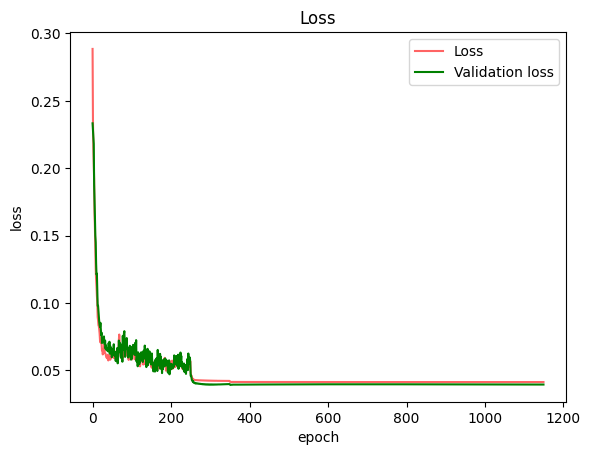

Epoch:  0 | Cost: 0.043647 | Train accuracy: 0.940000 | Validation Accuracy: 0.980000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 4, 1, 3, 3)
step 1, accuracy_train:0.5542857142857143, loss: 0.2664422179662731
step 2, accuracy_train:0.6914285714285714, loss: 0.22089904485874862
step 3, accuracy_train:0.6971428571428572, loss: 0.215308906264738
step 4, accuracy_train:0.7085714285714285, loss: 0.21316823223137515
step 5, accuracy_train:0.7628571428571429, loss: 0.1944384954201758
step 6, accuracy_train:0.8257142857142857, loss: 0.184735077519728
step 7, accuracy_train:0.8342857142857143, loss: 0.17579540920311118
step 8, accuracy_train:0.8628571428571429, loss: 0.16120874349898806
step 9, accuracy_train:0.8657142857142858, loss: 0.15001554489655844
step 10, accuracy_train:0.86, loss: 0.13973421685020385
step 11, accuracy_train:0.9, loss: 0.12212686719994567
step 12, accuracy_train:0.9342857142857143, loss: 0.1105062284176648
step 13, accuracy_train:0.9228571428571428, loss: 0.10336342880336821
s

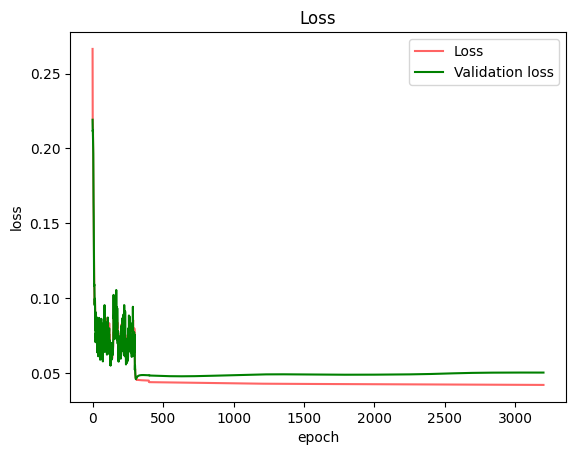

Epoch:  0 | Cost: 0.040580 | Train accuracy: 0.945714 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 4, 1, 3, 3)
step 1, accuracy_train:0.5114285714285715, loss: 0.2877195056482839
step 2, accuracy_train:0.7228571428571429, loss: 0.2282578609707796
step 3, accuracy_train:0.7828571428571428, loss: 0.20185260762175133
step 4, accuracy_train:0.7771428571428571, loss: 0.19672975751633465
step 5, accuracy_train:0.8228571428571428, loss: 0.1695289343478476
step 6, accuracy_train:0.8657142857142858, loss: 0.14066558344028152
step 7, accuracy_train:0.9, loss: 0.1251508201009906
step 8, accuracy_train:0.92, loss: 0.10320418772126438
step 9, accuracy_train:0.9, loss: 0.10433070815761461
step 10, accuracy_train:0.9171428571428571, loss: 0.09285044024726664
step 11, accuracy_train:0.9314285714285714, loss: 0.08832675610763796
step 12, accuracy_train:0.9142857142857143, loss: 0.08682075703711069
step 13, accuracy_train:0.9114285714285715, loss: 0.08553185599954345
step 14, accu

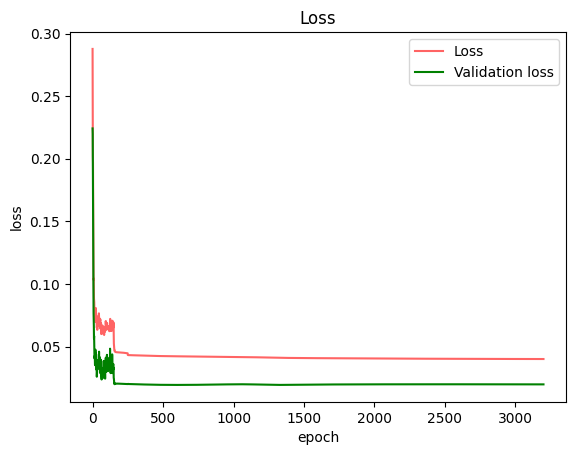

Epoch:  0 | Cost: 0.041942 | Train accuracy: 0.942857 | Validation Accuracy: 0.980000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 4, 1, 3, 3)
step 1, accuracy_train:0.52, loss: 0.32107386127558896
step 2, accuracy_train:0.7028571428571428, loss: 0.225371706406963
step 3, accuracy_train:0.7485714285714286, loss: 0.20816147447035865
step 4, accuracy_train:0.7857142857142857, loss: 0.1989342672146378
step 5, accuracy_train:0.8685714285714285, loss: 0.15949372875052556
step 6, accuracy_train:0.9057142857142857, loss: 0.13568758586443053
step 7, accuracy_train:0.9085714285714286, loss: 0.1215956555376876
step 8, accuracy_train:0.9314285714285714, loss: 0.10273571303178555
step 9, accuracy_train:0.92, loss: 0.09387363063649906
step 10, accuracy_train:0.9257142857142857, loss: 0.0845068919056081
step 11, accuracy_train:0.92, loss: 0.08037896961451331
step 12, accuracy_train:0.9342857142857143, loss: 0.0742904839343971
step 13, accuracy_train:0.9371428571428572, loss: 0.06795288125292072
step 14, accu

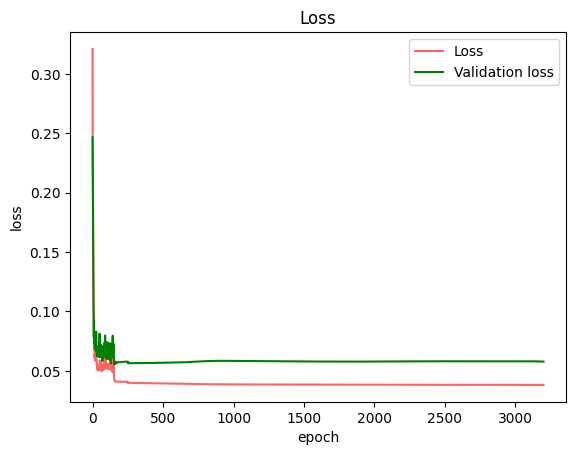

Epoch:  0 | Cost: 0.038980 | Train accuracy: 0.945714 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 4, 1, 3, 3)
step 1, accuracy_train:0.6057142857142858, loss: 0.27321405135893906
step 2, accuracy_train:0.72, loss: 0.21276162038466856
step 3, accuracy_train:0.7571428571428571, loss: 0.20356797142923716
step 4, accuracy_train:0.8342857142857143, loss: 0.18024942681503786
step 5, accuracy_train:0.8828571428571429, loss: 0.15028141394121564
step 6, accuracy_train:0.8942857142857142, loss: 0.1350484124775281
step 7, accuracy_train:0.9142857142857143, loss: 0.1147177190207453
step 8, accuracy_train:0.9285714285714286, loss: 0.10532140595538628
step 9, accuracy_train:0.9114285714285715, loss: 0.09504056819221954
step 10, accuracy_train:0.9085714285714286, loss: 0.09007398860531574
step 11, accuracy_train:0.9257142857142857, loss: 0.08234400553491464
step 12, accuracy_train:0.9314285714285714, loss: 0.07436965317374712
step 13, accuracy_train:0.9314285714285714, loss: 0

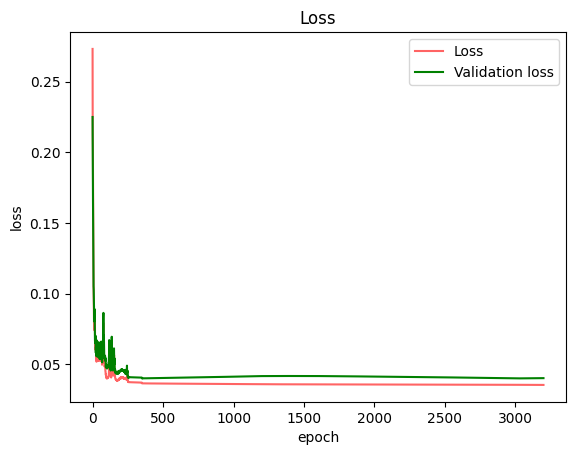

Epoch:  0 | Cost: 0.038833 | Train accuracy: 0.954286 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 4, 1, 3, 3)
step 1, accuracy_train:0.6371428571428571, loss: 0.28651598965344127
step 2, accuracy_train:0.7628571428571429, loss: 0.20258622020774092
step 3, accuracy_train:0.8742857142857143, loss: 0.17250074908643442
step 4, accuracy_train:0.8628571428571429, loss: 0.16472301849006601
step 5, accuracy_train:0.8685714285714285, loss: 0.1466189560007692
step 6, accuracy_train:0.8742857142857143, loss: 0.13464865434082934
step 7, accuracy_train:0.88, loss: 0.11626999360297627
step 8, accuracy_train:0.8971428571428571, loss: 0.10796941569834168
step 9, accuracy_train:0.8971428571428571, loss: 0.10411653086562872
step 10, accuracy_train:0.9228571428571428, loss: 0.08720394957424843
step 11, accuracy_train:0.9028571428571428, loss: 0.08594751059252738
step 12, accuracy_train:0.9228571428571428, loss: 0.07219100638780304
step 13, accuracy_train:0.9171428571428571, loss: 

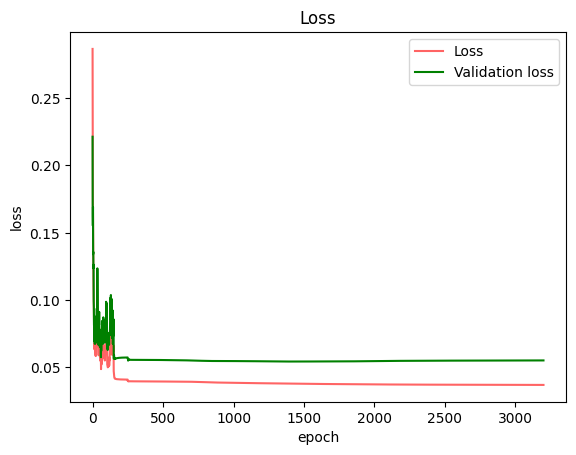

Epoch:  0 | Cost: 0.038118 | Train accuracy: 0.951429 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 4, 1, 3, 3)
step 1, accuracy_train:0.6257142857142857, loss: 0.28328272735846555
step 2, accuracy_train:0.7428571428571429, loss: 0.20208907850129565
step 3, accuracy_train:0.7857142857142857, loss: 0.19232963801138103
step 4, accuracy_train:0.8457142857142858, loss: 0.1741276997454071
step 5, accuracy_train:0.8742857142857143, loss: 0.1569267378449041
step 6, accuracy_train:0.9114285714285715, loss: 0.14261642648345266
step 7, accuracy_train:0.9114285714285715, loss: 0.11184864272804489
step 8, accuracy_train:0.9085714285714286, loss: 0.10738853778495709
step 9, accuracy_train:0.8942857142857142, loss: 0.10207915995659231
step 10, accuracy_train:0.9114285714285715, loss: 0.09297944850919761
step 11, accuracy_train:0.9257142857142857, loss: 0.08885454946750009
step 12, accuracy_train:0.9228571428571428, loss: 0.09375973491194983
step 13, accuracy_train:0.90285714285

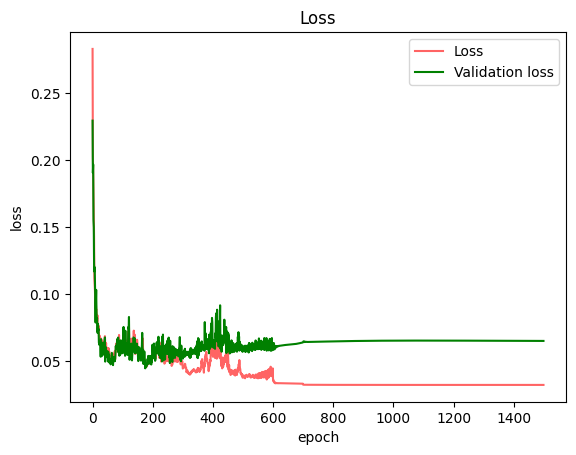

Epoch:  0 | Cost: 0.033599 | Train accuracy: 0.965714 | Validation Accuracy: 0.880000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 4, 1, 3, 3)
step 1, accuracy_train:0.6085714285714285, loss: 0.2835238006363916
step 2, accuracy_train:0.7085714285714285, loss: 0.22404981061146714
step 3, accuracy_train:0.76, loss: 0.209532002655016
step 4, accuracy_train:0.8028571428571428, loss: 0.199090997169527
step 5, accuracy_train:0.8, loss: 0.17760664780736574
step 6, accuracy_train:0.8657142857142858, loss: 0.1577734769675176
step 7, accuracy_train:0.8942857142857142, loss: 0.14321020391542705
step 8, accuracy_train:0.9171428571428571, loss: 0.11892316775053664
step 9, accuracy_train:0.9171428571428571, loss: 0.10716850065089215
step 10, accuracy_train:0.9085714285714286, loss: 0.0952921898194318
step 11, accuracy_train:0.9085714285714286, loss: 0.09064885230519723
step 12, accuracy_train:0.9257142857142857, loss: 0.08620665437166732
step 13, accuracy_train:0.9285714285714286, loss: 0.07828629367053042
s

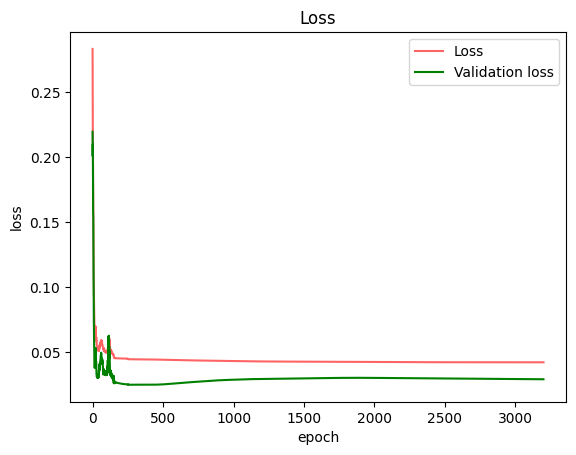

Epoch:  0 | Cost: 0.041593 | Train accuracy: 0.948571 | Validation Accuracy: 0.960000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 4, 1, 3, 3)
step 1, accuracy_train:0.6228571428571429, loss: 0.24601094076055952
step 2, accuracy_train:0.6828571428571428, loss: 0.22048575046107874
step 3, accuracy_train:0.7457142857142857, loss: 0.20256740200444162
step 4, accuracy_train:0.8485714285714285, loss: 0.18863578497346453
step 5, accuracy_train:0.8342857142857143, loss: 0.1764014592464711
step 6, accuracy_train:0.86, loss: 0.14553468470233547
step 7, accuracy_train:0.8971428571428571, loss: 0.12377443544826945
step 8, accuracy_train:0.8942857142857142, loss: 0.11615252786105558
step 9, accuracy_train:0.9114285714285715, loss: 0.10350898903007427
step 10, accuracy_train:0.9285714285714286, loss: 0.09283708307271053
step 11, accuracy_train:0.9314285714285714, loss: 0.08445634371593054
step 12, accuracy_train:0.9342857142857143, loss: 0.07779615733252501
step 13, accuracy_train:0.92, loss: 0.076178344163

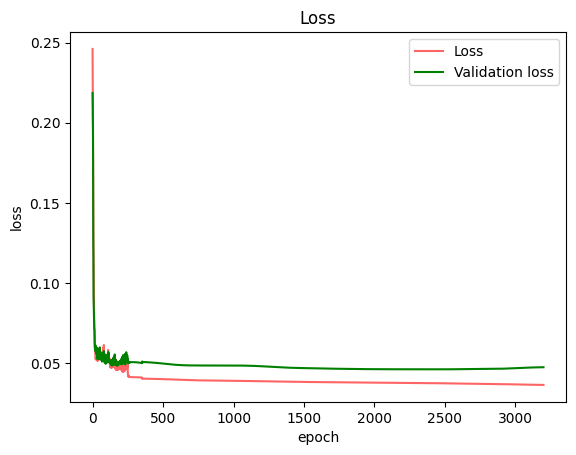

Epoch:  0 | Cost: 0.037699 | Train accuracy: 0.954286 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 4, 1, 3, 3)
step 1, accuracy_train:0.5628571428571428, loss: 0.3080529408449619
step 2, accuracy_train:0.6628571428571428, loss: 0.2391157771948531
step 3, accuracy_train:0.6314285714285715, loss: 0.22921988106069635
step 4, accuracy_train:0.7028571428571428, loss: 0.2255078635691687
step 5, accuracy_train:0.7457142857142857, loss: 0.21494719636798715
step 6, accuracy_train:0.74, loss: 0.20408636474735145
step 7, accuracy_train:0.8, loss: 0.19650884350126763
step 8, accuracy_train:0.7971428571428572, loss: 0.18396565772286558
step 9, accuracy_train:0.8228571428571428, loss: 0.17678953522730742
step 10, accuracy_train:0.84, loss: 0.16407357062107575
step 11, accuracy_train:0.8428571428571429, loss: 0.15568011916734828
step 12, accuracy_train:0.8771428571428571, loss: 0.14886952590397176
step 13, accuracy_train:0.88, loss: 0.14136626006834718
step 14, accuracy_train:0

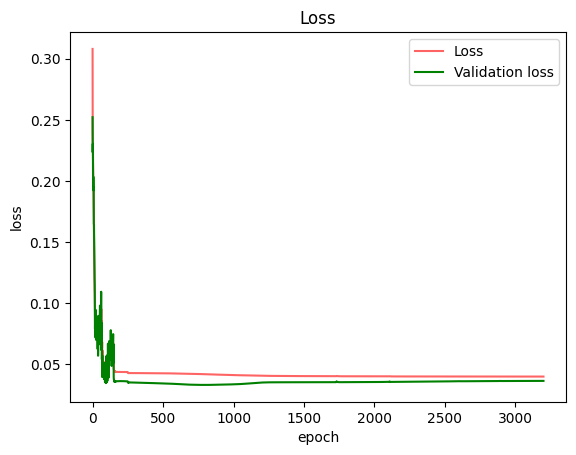

Epoch:  0 | Cost: 0.038825 | Train accuracy: 0.948571 | Validation Accuracy: 0.980000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 4, 1, 3, 3)
t_n_seeds: 981.8779726000066


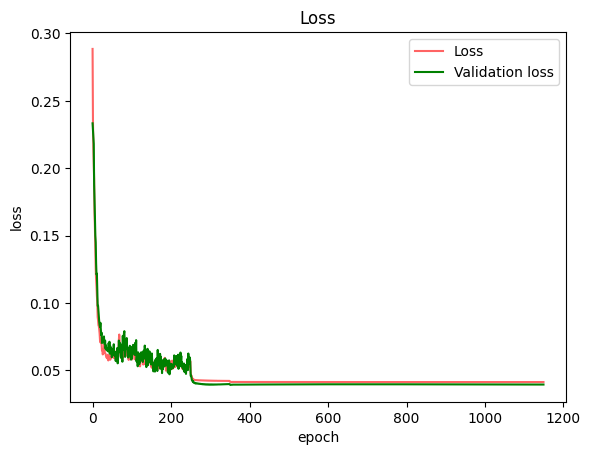

step 1, accuracy_train:0.61, loss: 0.2809538461786018
step 2, accuracy_train:0.71, loss: 0.22723317950833027
step 3, accuracy_train:0.715, loss: 0.2187933813934504
step 4, accuracy_train:0.785, loss: 0.20982307693224322
step 5, accuracy_train:0.78, loss: 0.20036547968809723
step 6, accuracy_train:0.81, loss: 0.17745825573433707
step 7, accuracy_train:0.865, loss: 0.1561479248211479
step 8, accuracy_train:0.8875, loss: 0.1347240437329781
step 9, accuracy_train:0.895, loss: 0.11814627565036365
step 10, accuracy_train:0.92, loss: 0.10013253797437702
step 11, accuracy_train:0.91, loss: 0.09504883383566612
step 12, accuracy_train:0.9275, loss: 0.08374277682313291
step 13, accuracy_train:0.9275, loss: 0.08109782061444011
step 14, accuracy_train:0.9425, loss: 0.07864831707179064
step 15, accuracy_train:0.93, loss: 0.07239999580125624
step 16, accuracy_train:0.9425, loss: 0.06615359569260607
step 17, accuracy_train:0.9475, loss: 0.06509270010205755
step 18, accuracy_train:0.9425, loss: 0.06371

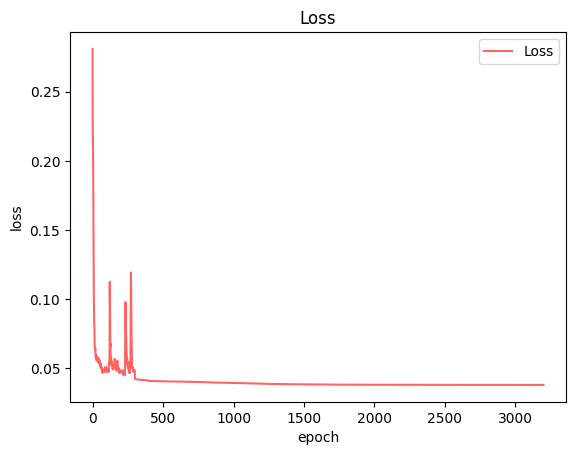

Epoch:  0 | Cost: 0.037947 | Train accuracy: 0.947500 | Test Accuracy: 0.880000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 4, 1, 3, 3)


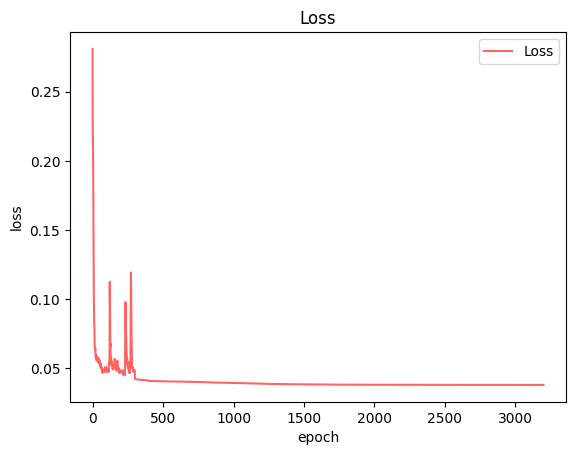

step 1, accuracy_train:0.4942857142857143, loss: 0.3053661987480915
step 2, accuracy_train:0.7028571428571428, loss: 0.22700682398495034
step 3, accuracy_train:0.7342857142857143, loss: 0.2094829675339391
step 4, accuracy_train:0.7857142857142857, loss: 0.20508594258044277
step 5, accuracy_train:0.8628571428571429, loss: 0.18644532023904734
step 6, accuracy_train:0.8542857142857143, loss: 0.1660172914747589
step 7, accuracy_train:0.88, loss: 0.15847062102039994
step 8, accuracy_train:0.9, loss: 0.13848254408064473
step 9, accuracy_train:0.9085714285714286, loss: 0.12422297411143095
step 10, accuracy_train:0.92, loss: 0.117372877004155
step 11, accuracy_train:0.9057142857142857, loss: 0.11545569238062314
step 12, accuracy_train:0.9228571428571428, loss: 0.10587865002382767
step 13, accuracy_train:0.9085714285714286, loss: 0.10262685091945917
step 14, accuracy_train:0.9142857142857143, loss: 0.09630404039687819
step 15, accuracy_train:0.9228571428571428, loss: 0.09262085375133787
step 16

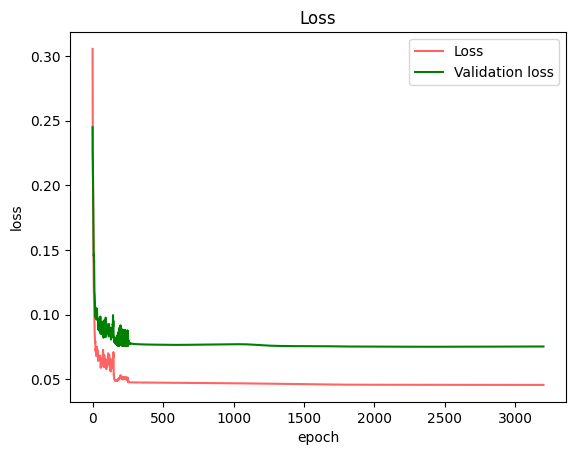

Epoch:  0 | Cost: 0.045579 | Train accuracy: 0.945714 | Validation Accuracy: 0.900000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 5, 1, 3, 3)
step 1, accuracy_train:0.5857142857142857, loss: 0.2939777916424101
step 2, accuracy_train:0.8171428571428572, loss: 0.19770696702599969
step 3, accuracy_train:0.8542857142857143, loss: 0.1883473614925173
step 4, accuracy_train:0.8885714285714286, loss: 0.1678408039046905
step 5, accuracy_train:0.9057142857142857, loss: 0.14226833658134075
step 6, accuracy_train:0.8971428571428571, loss: 0.12443160731947533
step 7, accuracy_train:0.8885714285714286, loss: 0.11144737000484242
step 8, accuracy_train:0.8971428571428571, loss: 0.10322717870938097
step 9, accuracy_train:0.9142857142857143, loss: 0.09234711139944707
step 10, accuracy_train:0.9057142857142857, loss: 0.09350960849926623
step 11, accuracy_train:0.92, loss: 0.08463923651374294
step 12, accuracy_train:0.9257142857142857, loss: 0.07338465154506885
step 13, accuracy_train:0.9257142857142857, loss: 0.

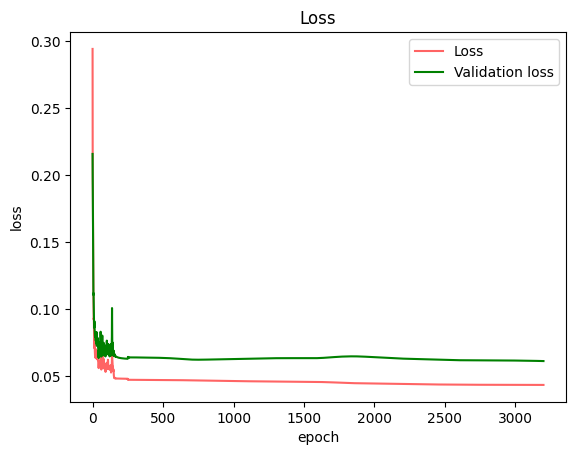

Epoch:  0 | Cost: 0.043985 | Train accuracy: 0.945714 | Validation Accuracy: 0.920000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 5, 1, 3, 3)
step 1, accuracy_train:0.62, loss: 0.2659437954569688
step 2, accuracy_train:0.7342857142857143, loss: 0.21351568361155593
step 3, accuracy_train:0.74, loss: 0.21426381006749118
step 4, accuracy_train:0.82, loss: 0.18144690185092877
step 5, accuracy_train:0.8828571428571429, loss: 0.16252663021318564
step 6, accuracy_train:0.8857142857142857, loss: 0.13806939162392876
step 7, accuracy_train:0.88, loss: 0.1160308448298572
step 8, accuracy_train:0.8914285714285715, loss: 0.10417417735711589
step 9, accuracy_train:0.8971428571428571, loss: 0.09746047985824363
step 10, accuracy_train:0.9057142857142857, loss: 0.08855101514601779
step 11, accuracy_train:0.9114285714285715, loss: 0.08354625058453721
step 12, accuracy_train:0.9171428571428571, loss: 0.0793019767482041
step 13, accuracy_train:0.9085714285714286, loss: 0.07490039549186922
step 14, accuracy_train:

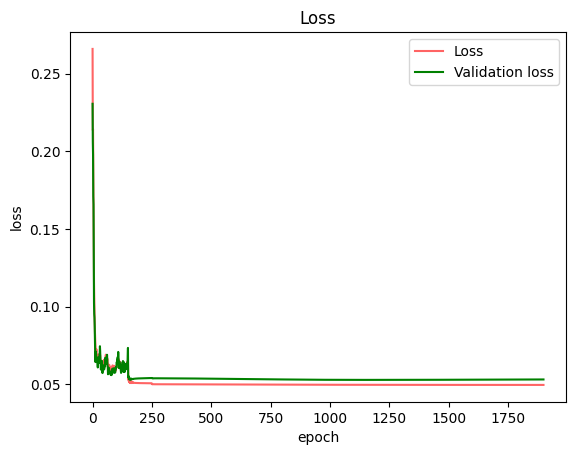

Epoch:  0 | Cost: 0.050216 | Train accuracy: 0.934286 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 5, 1, 3, 3)
step 1, accuracy_train:0.5828571428571429, loss: 0.26806424034624254
step 2, accuracy_train:0.6914285714285714, loss: 0.2251031279878629
step 3, accuracy_train:0.76, loss: 0.20928343167652066
step 4, accuracy_train:0.7971428571428572, loss: 0.19968604417682012
step 5, accuracy_train:0.82, loss: 0.18915458370505867
step 6, accuracy_train:0.8628571428571429, loss: 0.16969853244414795
step 7, accuracy_train:0.8828571428571429, loss: 0.15301613878034176
step 8, accuracy_train:0.8685714285714285, loss: 0.14486705168573666
step 9, accuracy_train:0.9, loss: 0.12711135324689155
step 10, accuracy_train:0.8971428571428571, loss: 0.11538864697636514
step 11, accuracy_train:0.9114285714285715, loss: 0.10922148838130233
step 12, accuracy_train:0.9114285714285715, loss: 0.10073349252795724
step 13, accuracy_train:0.9142857142857143, loss: 0.09201573549142077
step 14, 

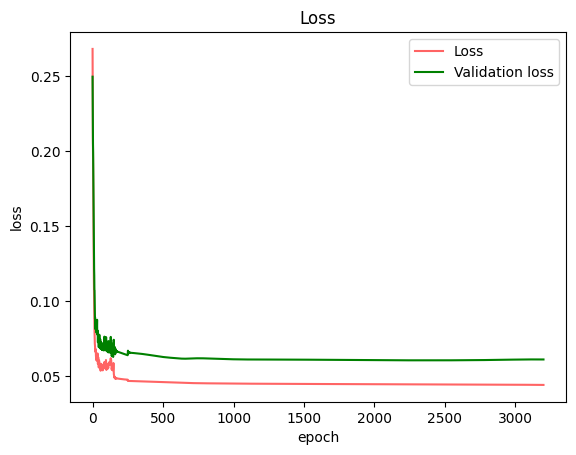

Epoch:  0 | Cost: 0.044902 | Train accuracy: 0.942857 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 5, 1, 3, 3)
step 1, accuracy_train:0.5485714285714286, loss: 0.2625339976409641
step 2, accuracy_train:0.5771428571428572, loss: 0.23395109969573513
step 3, accuracy_train:0.6085714285714285, loss: 0.23552354370131873
step 4, accuracy_train:0.5542857142857143, loss: 0.23709950318177447
step 5, accuracy_train:0.6371428571428571, loss: 0.22813965607644723
step 6, accuracy_train:0.6628571428571428, loss: 0.22311423840033306
step 7, accuracy_train:0.7171428571428572, loss: 0.21330957933615974
step 8, accuracy_train:0.8285714285714286, loss: 0.2024019420969806
step 9, accuracy_train:0.8142857142857143, loss: 0.19689667153135246
step 10, accuracy_train:0.8228571428571428, loss: 0.1936740624764751
step 11, accuracy_train:0.8257142857142857, loss: 0.18281617965085958
step 12, accuracy_train:0.82, loss: 0.17793702353934526
step 13, accuracy_train:0.8342857142857143, loss: 0.

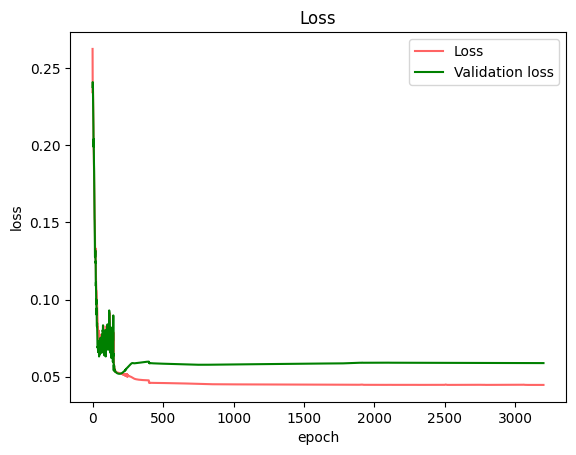

Epoch:  0 | Cost: 0.044508 | Train accuracy: 0.948571 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 5, 1, 3, 3)
step 1, accuracy_train:0.6114285714285714, loss: 0.27912490954017777
step 2, accuracy_train:0.72, loss: 0.21273331789226727
step 3, accuracy_train:0.7714285714285715, loss: 0.21529702393731792
step 4, accuracy_train:0.8114285714285714, loss: 0.2077446683154961
step 5, accuracy_train:0.8428571428571429, loss: 0.19584287952282467
step 6, accuracy_train:0.8685714285714285, loss: 0.17883972491943745
step 7, accuracy_train:0.9, loss: 0.16529305160157937
step 8, accuracy_train:0.8942857142857142, loss: 0.15555453918699977
step 9, accuracy_train:0.9028571428571428, loss: 0.1406980259084437
step 10, accuracy_train:0.9171428571428571, loss: 0.1329257829097484
step 11, accuracy_train:0.9171428571428571, loss: 0.1255296820589314
step 12, accuracy_train:0.92, loss: 0.1208979454605815
step 13, accuracy_train:0.9171428571428571, loss: 0.11833056731533605
step 14, accu

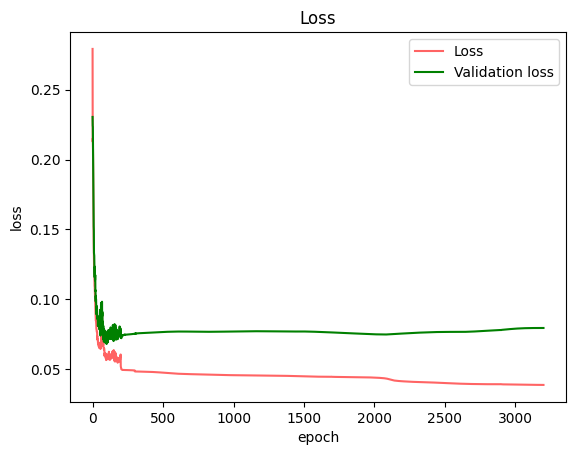

Epoch:  0 | Cost: 0.039030 | Train accuracy: 0.951429 | Validation Accuracy: 0.880000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 5, 1, 3, 3)
step 1, accuracy_train:0.5857142857142857, loss: 0.30288913807966306
step 2, accuracy_train:0.6114285714285714, loss: 0.23670665311760597
step 3, accuracy_train:0.7057142857142857, loss: 0.2198735549271532
step 4, accuracy_train:0.7571428571428571, loss: 0.21568466013421678
step 5, accuracy_train:0.7714285714285715, loss: 0.21376047601905743
step 6, accuracy_train:0.7828571428571428, loss: 0.19717292826348726
step 7, accuracy_train:0.8485714285714285, loss: 0.17791494809704061
step 8, accuracy_train:0.8685714285714285, loss: 0.1664573970598979
step 9, accuracy_train:0.8857142857142857, loss: 0.147055531178719
step 10, accuracy_train:0.8857142857142857, loss: 0.1376208575954497
step 11, accuracy_train:0.8828571428571429, loss: 0.1284756880502027
step 12, accuracy_train:0.92, loss: 0.11583757213341944
step 13, accuracy_train:0.9142857142857143, loss: 0.109

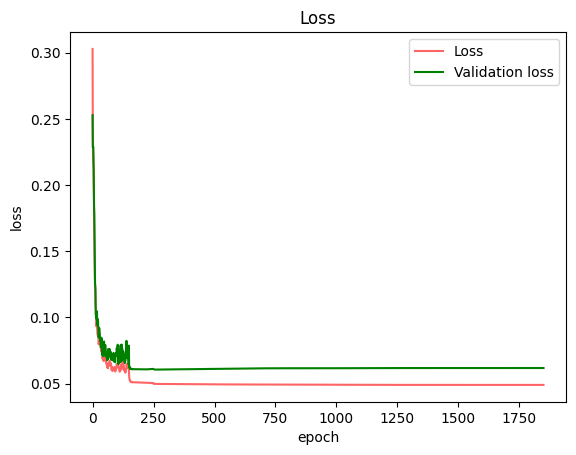

Epoch:  0 | Cost: 0.047007 | Train accuracy: 0.942857 | Validation Accuracy: 0.960000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 5, 1, 3, 3)
step 1, accuracy_train:0.5285714285714286, loss: 0.31251705073993896
step 2, accuracy_train:0.6542857142857142, loss: 0.22847665856951377
step 3, accuracy_train:0.7457142857142857, loss: 0.21717894821319528
step 4, accuracy_train:0.7685714285714286, loss: 0.22734049642936027
step 5, accuracy_train:0.6657142857142857, loss: 0.2215673204693117
step 6, accuracy_train:0.7285714285714285, loss: 0.20508538376300572
step 7, accuracy_train:0.8, loss: 0.19367394034003613
step 8, accuracy_train:0.8142857142857143, loss: 0.1808161951324127
step 9, accuracy_train:0.8371428571428572, loss: 0.17153435129130237
step 10, accuracy_train:0.8371428571428572, loss: 0.1614191487503125
step 11, accuracy_train:0.8457142857142858, loss: 0.15245198249625153
step 12, accuracy_train:0.8771428571428571, loss: 0.13753323390084193
step 13, accuracy_train:0.88, loss: 0.127740415078675

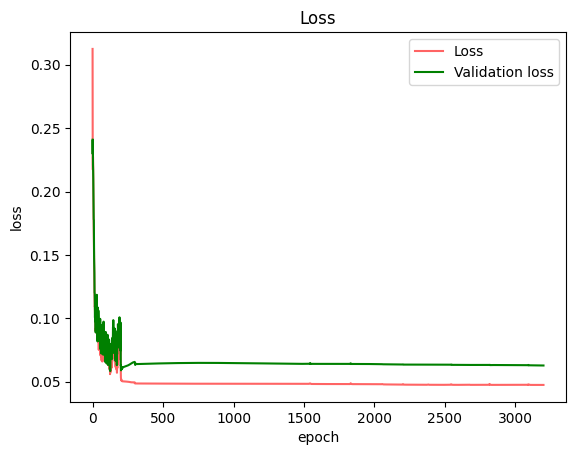

Epoch:  0 | Cost: 0.049539 | Train accuracy: 0.942857 | Validation Accuracy: 0.900000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 5, 1, 3, 3)
step 1, accuracy_train:0.5228571428571429, loss: 0.3016111099615303
step 2, accuracy_train:0.6885714285714286, loss: 0.2301957646809439
step 3, accuracy_train:0.7285714285714285, loss: 0.2145285690174303
step 4, accuracy_train:0.7685714285714286, loss: 0.2098579498782937
step 5, accuracy_train:0.8028571428571428, loss: 0.19192697184562924
step 6, accuracy_train:0.8342857142857143, loss: 0.17441431462345833
step 7, accuracy_train:0.8428571428571429, loss: 0.15911122999661054
step 8, accuracy_train:0.8628571428571429, loss: 0.14382486585171425
step 9, accuracy_train:0.8742857142857143, loss: 0.1324922805760807
step 10, accuracy_train:0.8685714285714285, loss: 0.13460526810085868
step 11, accuracy_train:0.8771428571428571, loss: 0.13221582648394142
step 12, accuracy_train:0.8914285714285715, loss: 0.1188248430343369
step 13, accuracy_train:0.902857142857142

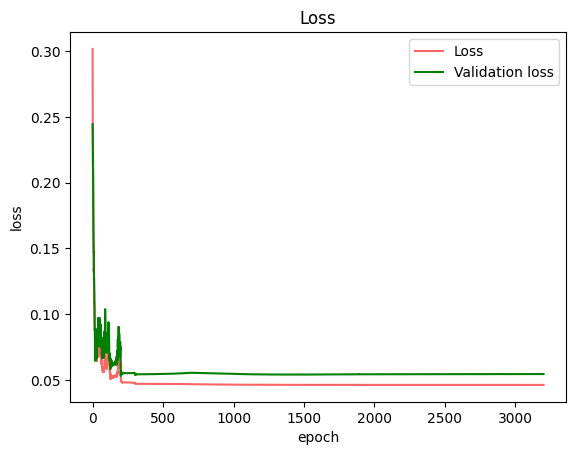

Epoch:  0 | Cost: 0.045246 | Train accuracy: 0.940000 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 5, 1, 3, 3)
step 1, accuracy_train:0.62, loss: 0.2925291019191422
step 2, accuracy_train:0.74, loss: 0.2150787339650485
step 3, accuracy_train:0.7542857142857143, loss: 0.2193292798384849
step 4, accuracy_train:0.7971428571428572, loss: 0.2157530226297757
step 5, accuracy_train:0.7457142857142857, loss: 0.2113282588331093
step 6, accuracy_train:0.8228571428571428, loss: 0.1989247636483056
step 7, accuracy_train:0.8742857142857143, loss: 0.17871357035651933
step 8, accuracy_train:0.8771428571428571, loss: 0.16401332669232951
step 9, accuracy_train:0.8942857142857142, loss: 0.14927301149144306
step 10, accuracy_train:0.9085714285714286, loss: 0.14144015746862934
step 11, accuracy_train:0.9, loss: 0.12876593989980017
step 12, accuracy_train:0.8885714285714286, loss: 0.11856114480615247
step 13, accuracy_train:0.9057142857142857, loss: 0.10928502864354213
step 14, accur

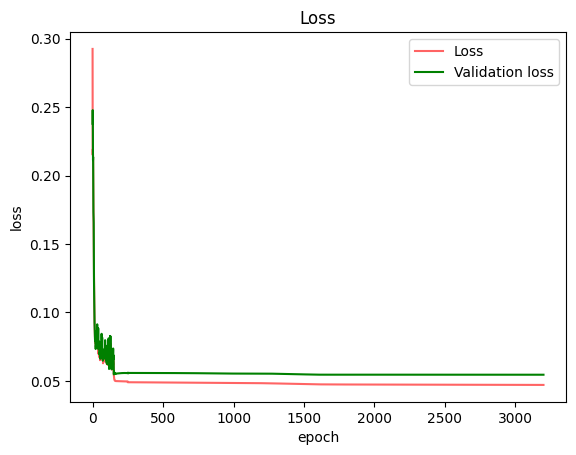

Epoch:  0 | Cost: 0.049332 | Train accuracy: 0.942857 | Validation Accuracy: 0.900000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 5, 1, 3, 3)
t_n_seeds: 1635.3083314000032


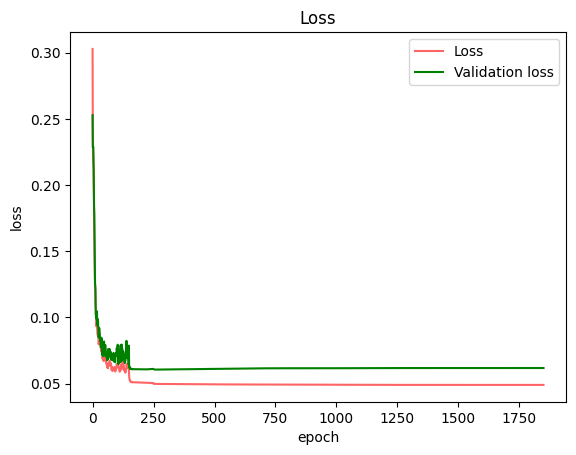

step 1, accuracy_train:0.6175, loss: 0.3036342648211299
step 2, accuracy_train:0.7, loss: 0.22459316717987443
step 3, accuracy_train:0.8025, loss: 0.2066467937512811
step 4, accuracy_train:0.84, loss: 0.192472788136827
step 5, accuracy_train:0.8625, loss: 0.17716031385874947
step 6, accuracy_train:0.87, loss: 0.15881580988127486
step 7, accuracy_train:0.8875, loss: 0.14539557905140787
step 8, accuracy_train:0.9125, loss: 0.13168841004905563
step 9, accuracy_train:0.9125, loss: 0.1235898267260733
step 10, accuracy_train:0.915, loss: 0.11113234026704025
step 11, accuracy_train:0.92, loss: 0.11169476227614088
step 12, accuracy_train:0.9175, loss: 0.10484668541665598
step 13, accuracy_train:0.9225, loss: 0.09714334345801434
step 14, accuracy_train:0.925, loss: 0.09739255425986076
step 15, accuracy_train:0.93, loss: 0.08752371757314822
step 16, accuracy_train:0.9225, loss: 0.08574186664130497
step 17, accuracy_train:0.91, loss: 0.0867419745014325
step 18, accuracy_train:0.9125, loss: 0.0800

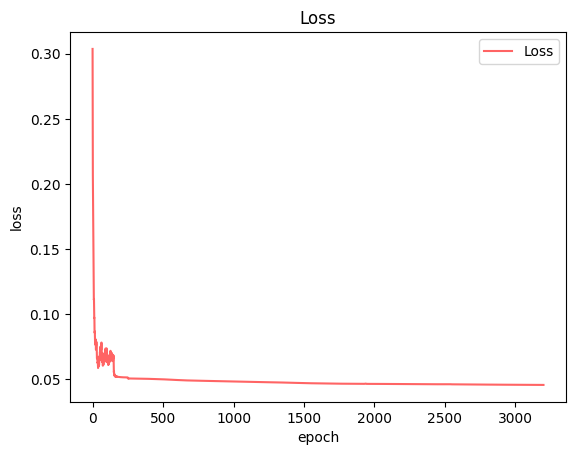

Epoch:  0 | Cost: 0.045482 | Train accuracy: 0.940000 | Test Accuracy: 0.960000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 5, 1, 3, 3)


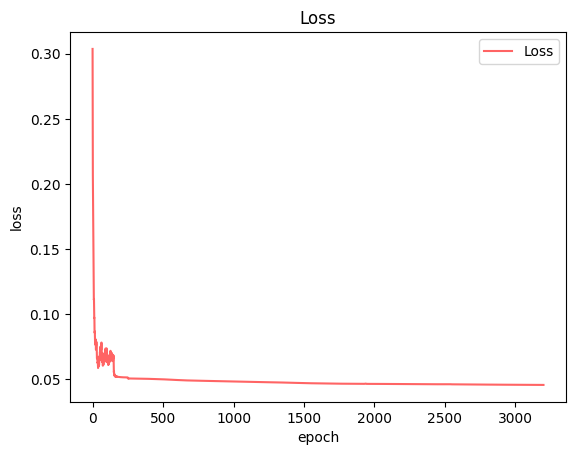

step 1, accuracy_train:0.5085714285714286, loss: 0.33142785644009654
step 2, accuracy_train:0.6742857142857143, loss: 0.2715649852865284
step 3, accuracy_train:0.7485714285714286, loss: 0.23130680348839222
step 4, accuracy_train:0.8314285714285714, loss: 0.21034422403381947
step 5, accuracy_train:0.8285714285714286, loss: 0.2039520743299203
step 6, accuracy_train:0.8971428571428571, loss: 0.19567234163871283
step 7, accuracy_train:0.9171428571428571, loss: 0.18873324354842824
step 8, accuracy_train:0.9, loss: 0.18095512984802714
step 9, accuracy_train:0.9057142857142857, loss: 0.16724571082829734
step 10, accuracy_train:0.9028571428571428, loss: 0.16116343592147134
step 11, accuracy_train:0.9114285714285715, loss: 0.14911201891422662
step 12, accuracy_train:0.9085714285714286, loss: 0.1425825014283963
step 13, accuracy_train:0.92, loss: 0.13835598369915317
step 14, accuracy_train:0.9085714285714286, loss: 0.13232573296747357
step 15, accuracy_train:0.9171428571428571, loss: 0.128174852

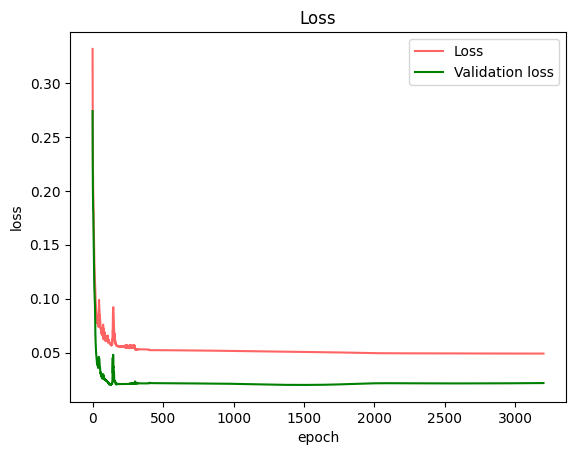

Epoch:  0 | Cost: 0.055855 | Train accuracy: 0.925714 | Validation Accuracy: 0.980000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 6, 1, 3, 3)
step 1, accuracy_train:0.5285714285714286, loss: 0.3018850149084696
step 2, accuracy_train:0.5142857142857142, loss: 0.25621636964375627
step 3, accuracy_train:0.6114285714285714, loss: 0.23680856741246886
step 4, accuracy_train:0.7114285714285714, loss: 0.2289873975803452
step 5, accuracy_train:0.7057142857142857, loss: 0.22440312039573307
step 6, accuracy_train:0.7428571428571429, loss: 0.21700386506930147
step 7, accuracy_train:0.7885714285714286, loss: 0.21145858747988672
step 8, accuracy_train:0.8228571428571428, loss: 0.20514030911107417
step 9, accuracy_train:0.8828571428571429, loss: 0.19136172733741422
step 10, accuracy_train:0.8571428571428571, loss: 0.18169763395147975
step 11, accuracy_train:0.8885714285714286, loss: 0.17184480692350612
step 12, accuracy_train:0.8914285714285715, loss: 0.1659373086511536
step 13, accuracy_train:0.891428571428

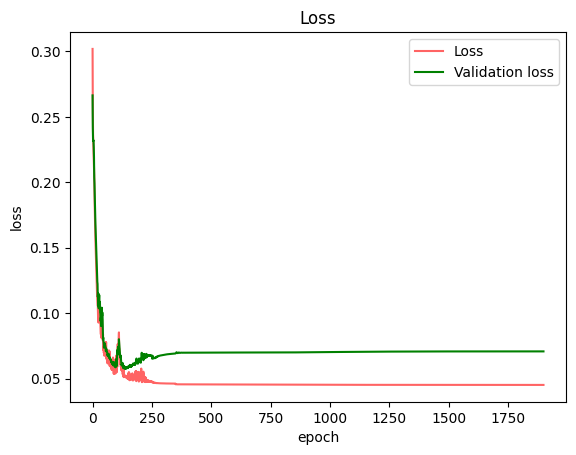

Epoch:  0 | Cost: 0.047135 | Train accuracy: 0.951429 | Validation Accuracy: 0.900000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 6, 1, 3, 3)
step 1, accuracy_train:0.44571428571428573, loss: 0.3254193029468072
step 2, accuracy_train:0.6171428571428571, loss: 0.2696550847167394
step 3, accuracy_train:0.7628571428571429, loss: 0.23258765962918593
step 4, accuracy_train:0.7685714285714286, loss: 0.22290596457356093
step 5, accuracy_train:0.8257142857142857, loss: 0.20573793477429428
step 6, accuracy_train:0.8685714285714285, loss: 0.19742658650189845
step 7, accuracy_train:0.8771428571428571, loss: 0.1860659712567656
step 8, accuracy_train:0.9114285714285715, loss: 0.1779084333815752
step 9, accuracy_train:0.92, loss: 0.1647592564356155
step 10, accuracy_train:0.8885714285714286, loss: 0.15595864562723763
step 11, accuracy_train:0.9142857142857143, loss: 0.1472657361967477
step 12, accuracy_train:0.9085714285714286, loss: 0.13798062473379444
step 13, accuracy_train:0.9085714285714286, loss: 0.13

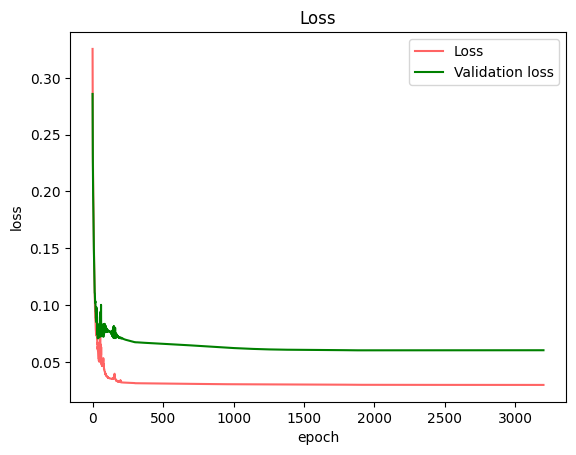

Epoch:  0 | Cost: 0.042651 | Train accuracy: 0.951429 | Validation Accuracy: 0.960000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 6, 1, 3, 3)
step 1, accuracy_train:0.5314285714285715, loss: 0.2854401886239745
step 2, accuracy_train:0.6171428571428571, loss: 0.2393999296540475
step 3, accuracy_train:0.6028571428571429, loss: 0.22750103267138483
step 4, accuracy_train:0.6628571428571428, loss: 0.22406727976553334
step 5, accuracy_train:0.7457142857142857, loss: 0.2150690041873775
step 6, accuracy_train:0.7942857142857143, loss: 0.2144016422609607
step 7, accuracy_train:0.7885714285714286, loss: 0.20489443390873133
step 8, accuracy_train:0.8114285714285714, loss: 0.19465564088967321
step 9, accuracy_train:0.8257142857142857, loss: 0.19115573516973933
step 10, accuracy_train:0.8285714285714286, loss: 0.18397185168083902
step 11, accuracy_train:0.8457142857142858, loss: 0.1766324327053994
step 12, accuracy_train:0.8714285714285714, loss: 0.1741551796179277
step 13, accuracy_train:0.882857142857142

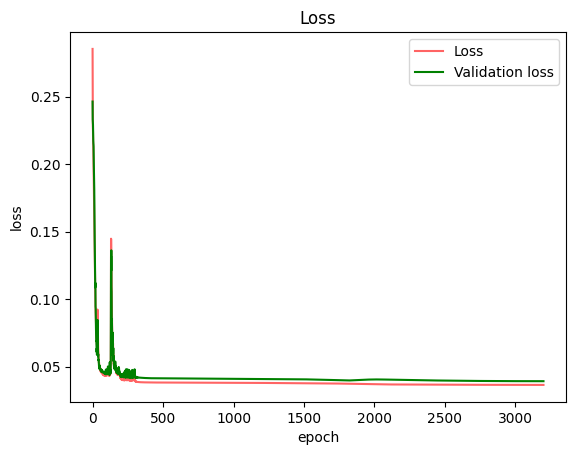

Epoch:  0 | Cost: 0.046874 | Train accuracy: 0.934286 | Validation Accuracy: 0.960000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 6, 1, 3, 3)
step 1, accuracy_train:0.4514285714285714, loss: 0.2944585973728616
step 2, accuracy_train:0.6371428571428571, loss: 0.24137788590986753
step 3, accuracy_train:0.6542857142857142, loss: 0.21677667196140324
step 4, accuracy_train:0.7828571428571428, loss: 0.20481192316488753
step 5, accuracy_train:0.8028571428571428, loss: 0.20148262779189752
step 6, accuracy_train:0.8114285714285714, loss: 0.19284294126015394
step 7, accuracy_train:0.88, loss: 0.18385370929724493
step 8, accuracy_train:0.8942857142857142, loss: 0.18122774857183876
step 9, accuracy_train:0.8914285714285715, loss: 0.17543173462860423
step 10, accuracy_train:0.8942857142857142, loss: 0.16805752901840693
step 11, accuracy_train:0.8914285714285715, loss: 0.16242520389757328
step 12, accuracy_train:0.9114285714285715, loss: 0.15510063489166528
step 13, accuracy_train:0.9114285714285715, loss: 

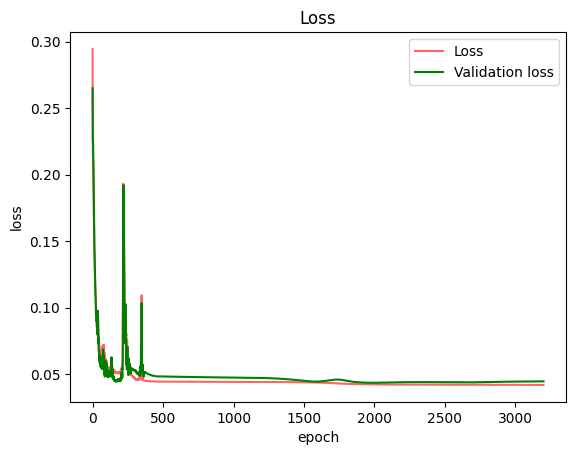

Epoch:  0 | Cost: 0.053642 | Train accuracy: 0.940000 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 6, 1, 3, 3)
step 1, accuracy_train:0.5828571428571429, loss: 0.3039333638688845
step 2, accuracy_train:0.6371428571428571, loss: 0.24983276612355526
step 3, accuracy_train:0.7514285714285714, loss: 0.21817913393191965
step 4, accuracy_train:0.7828571428571428, loss: 0.1999035218377801
step 5, accuracy_train:0.82, loss: 0.1926228500677456
step 6, accuracy_train:0.8342857142857143, loss: 0.18533081061027065
step 7, accuracy_train:0.8571428571428571, loss: 0.17849459731200223
step 8, accuracy_train:0.8714285714285714, loss: 0.16407168973227482
step 9, accuracy_train:0.8657142857142858, loss: 0.1554238655223431
step 10, accuracy_train:0.8571428571428571, loss: 0.14590042320393995
step 11, accuracy_train:0.8628571428571429, loss: 0.13939781058781758
step 12, accuracy_train:0.8514285714285714, loss: 0.12936008660599055
step 13, accuracy_train:0.8942857142857142, loss: 0.1

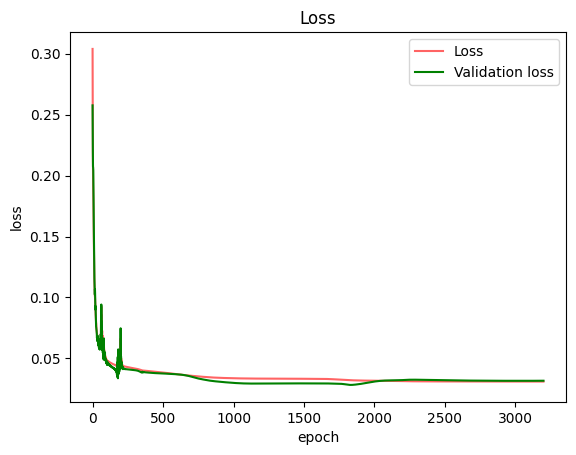

Epoch:  0 | Cost: 0.046961 | Train accuracy: 0.948571 | Validation Accuracy: 0.980000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 6, 1, 3, 3)
step 1, accuracy_train:0.6142857142857143, loss: 0.3197683338049256
step 2, accuracy_train:0.68, loss: 0.2576640780607885
step 3, accuracy_train:0.7371428571428571, loss: 0.22822178916042754
step 4, accuracy_train:0.7285714285714285, loss: 0.21372897975952296
step 5, accuracy_train:0.82, loss: 0.20930530260582106
step 6, accuracy_train:0.8314285714285714, loss: 0.1986085774518026
step 7, accuracy_train:0.86, loss: 0.1905114753762584
step 8, accuracy_train:0.86, loss: 0.18084140795429257
step 9, accuracy_train:0.8914285714285715, loss: 0.16677730560001197
step 10, accuracy_train:0.8628571428571429, loss: 0.15499676263630438
step 11, accuracy_train:0.9057142857142857, loss: 0.14470021614908324
step 12, accuracy_train:0.8942857142857142, loss: 0.13174042475439618
step 13, accuracy_train:0.9057142857142857, loss: 0.1264438007130566
step 14, accuracy_train:0.

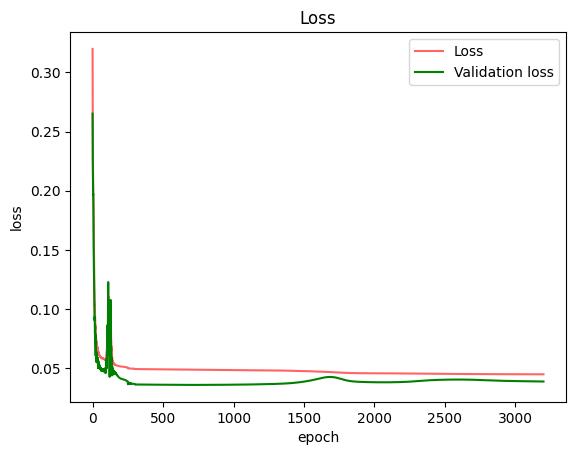

Epoch:  0 | Cost: 0.050149 | Train accuracy: 0.937143 | Validation Accuracy: 0.980000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 6, 1, 3, 3)
step 1, accuracy_train:0.6514285714285715, loss: 0.3288861271134159
step 2, accuracy_train:0.52, loss: 0.26560229947682007
step 3, accuracy_train:0.6828571428571428, loss: 0.22645911171600813
step 4, accuracy_train:0.7514285714285714, loss: 0.20443548746665025
step 5, accuracy_train:0.78, loss: 0.19687297535285198
step 6, accuracy_train:0.8114285714285714, loss: 0.19878352616283507
step 7, accuracy_train:0.8257142857142857, loss: 0.19432793992275416
step 8, accuracy_train:0.8542857142857143, loss: 0.19058508792857293
step 9, accuracy_train:0.8714285714285714, loss: 0.18443817038927568
step 10, accuracy_train:0.88, loss: 0.17852264737450857
step 11, accuracy_train:0.8828571428571429, loss: 0.17065141711562432
step 12, accuracy_train:0.9057142857142857, loss: 0.16538940548110553
step 13, accuracy_train:0.8942857142857142, loss: 0.16133915404443266
step 14,

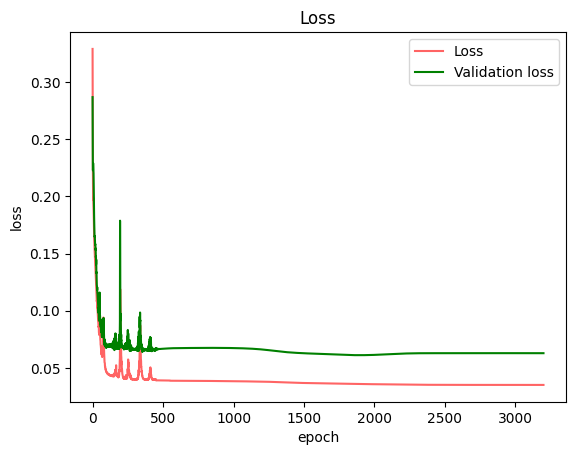

Epoch:  0 | Cost: 0.044483 | Train accuracy: 0.937143 | Validation Accuracy: 0.920000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 6, 1, 3, 3)
step 1, accuracy_train:0.5571428571428572, loss: 0.34201582190656155
step 2, accuracy_train:0.6942857142857143, loss: 0.2684526934793322
step 3, accuracy_train:0.7485714285714286, loss: 0.22967914672120932
step 4, accuracy_train:0.8628571428571429, loss: 0.20818533603978606
step 5, accuracy_train:0.8857142857142857, loss: 0.20376205939939568
step 6, accuracy_train:0.8914285714285715, loss: 0.19894350667436583
step 7, accuracy_train:0.9057142857142857, loss: 0.18882344319951555
step 8, accuracy_train:0.9142857142857143, loss: 0.17723587545754307
step 9, accuracy_train:0.9142857142857143, loss: 0.16863602765591076
step 10, accuracy_train:0.9142857142857143, loss: 0.15915801894130946
step 11, accuracy_train:0.9257142857142857, loss: 0.146778077740539
step 12, accuracy_train:0.9142857142857143, loss: 0.13627746766227278
step 13, accuracy_train:0.908571428571

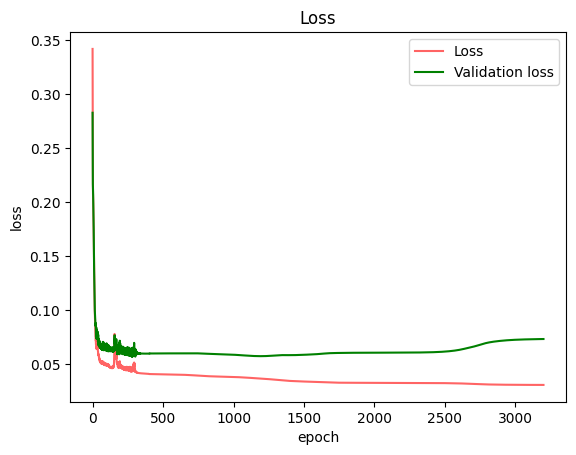

Epoch:  0 | Cost: 0.042625 | Train accuracy: 0.951429 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 6, 1, 3, 3)
step 1, accuracy_train:0.43142857142857144, loss: 0.2884237406862401
step 2, accuracy_train:0.6742857142857143, loss: 0.235629172533595
step 3, accuracy_train:0.5685714285714286, loss: 0.227110114241182
step 4, accuracy_train:0.7742857142857142, loss: 0.21407703008115883
step 5, accuracy_train:0.7771428571428571, loss: 0.2000645408056787
step 6, accuracy_train:0.86, loss: 0.1916489722421313
step 7, accuracy_train:0.8771428571428571, loss: 0.18626472296737245
step 8, accuracy_train:0.9057142857142857, loss: 0.17218262126336809
step 9, accuracy_train:0.88, loss: 0.16226891282748307
step 10, accuracy_train:0.9057142857142857, loss: 0.1547325255938397
step 11, accuracy_train:0.9171428571428571, loss: 0.14708963180532472
step 12, accuracy_train:0.9142857142857143, loss: 0.1397752572720416
step 13, accuracy_train:0.9285714285714286, loss: 0.1325144663726519
st

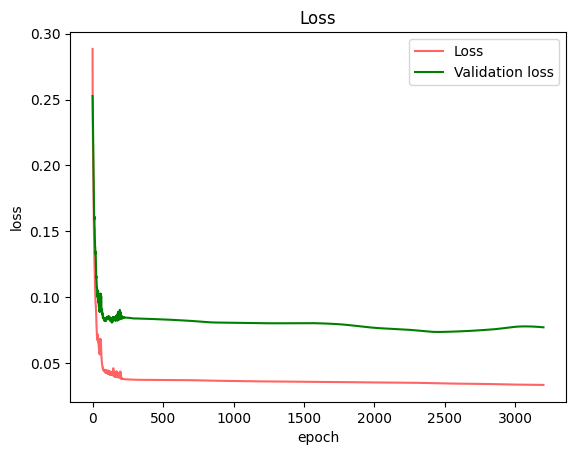

Epoch:  0 | Cost: 0.044780 | Train accuracy: 0.945714 | Validation Accuracy: 0.900000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 6, 1, 3, 3)
t_n_seeds: 3097.0500877000013


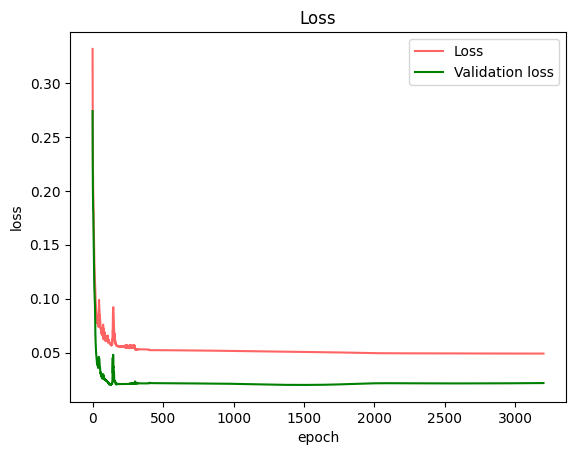

step 1, accuracy_train:0.5475, loss: 0.3280666802367387
step 2, accuracy_train:0.62, loss: 0.2709443533214144
step 3, accuracy_train:0.8425, loss: 0.22175466318592274
step 4, accuracy_train:0.855, loss: 0.20320180852315778
step 5, accuracy_train:0.9025, loss: 0.18978434832727697
step 6, accuracy_train:0.89, loss: 0.19021760133796736
step 7, accuracy_train:0.9125, loss: 0.18077351079686665
step 8, accuracy_train:0.9125, loss: 0.17189071236214842
step 9, accuracy_train:0.9025, loss: 0.16189297616080203
step 10, accuracy_train:0.9125, loss: 0.15033578404046083
step 11, accuracy_train:0.9225, loss: 0.13934568927389468
step 12, accuracy_train:0.915, loss: 0.1325826868098732
step 13, accuracy_train:0.915, loss: 0.12396019597492365
step 14, accuracy_train:0.9125, loss: 0.11965925004846623
step 15, accuracy_train:0.91, loss: 0.11194857969943078
step 16, accuracy_train:0.91, loss: 0.1045065684177024
step 17, accuracy_train:0.91, loss: 0.09954387463915565
step 18, accuracy_train:0.915, loss: 0.0

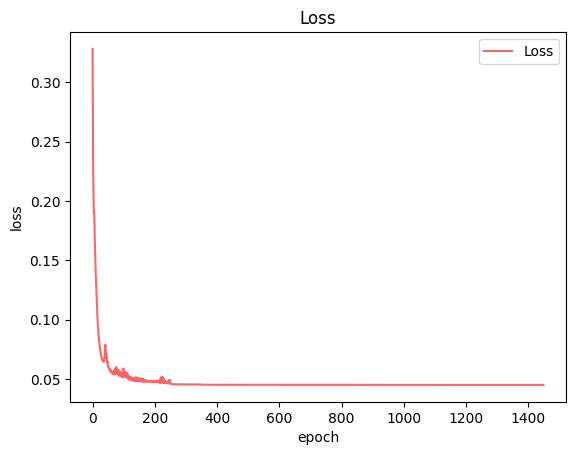

Epoch:  0 | Cost: 0.047167 | Train accuracy: 0.942500 | Test Accuracy: 0.890000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 6, 1, 3, 3)


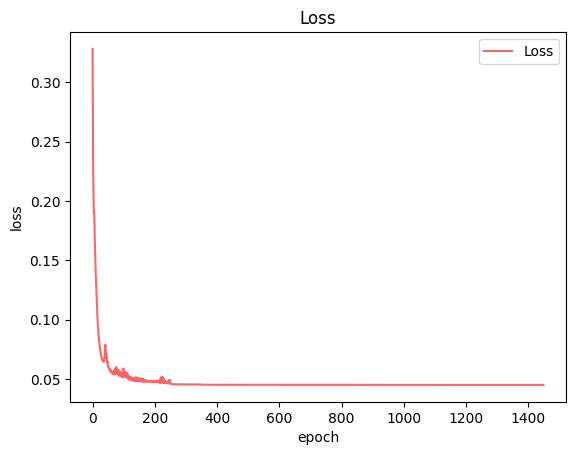

step 1, accuracy_train:0.5657142857142857, loss: 0.276881798415327
step 2, accuracy_train:0.6571428571428571, loss: 0.2349318721540759
step 3, accuracy_train:0.6628571428571428, loss: 0.23861512513947936
step 4, accuracy_train:0.7457142857142857, loss: 0.22964909870211647
step 5, accuracy_train:0.8, loss: 0.22140258976623536
step 6, accuracy_train:0.8285714285714286, loss: 0.21615828684193544
step 7, accuracy_train:0.8714285714285714, loss: 0.21094227672649934
step 8, accuracy_train:0.8771428571428571, loss: 0.2047021066305114
step 9, accuracy_train:0.8971428571428571, loss: 0.20345259671872823
step 10, accuracy_train:0.88, loss: 0.20244189574781674
step 11, accuracy_train:0.88, loss: 0.1983731272432476
step 12, accuracy_train:0.8942857142857142, loss: 0.1940141716332064
step 13, accuracy_train:0.8914285714285715, loss: 0.1888030366514757
step 14, accuracy_train:0.9028571428571428, loss: 0.18573415941923327
step 15, accuracy_train:0.9142857142857143, loss: 0.18427459645600977
step 16, 

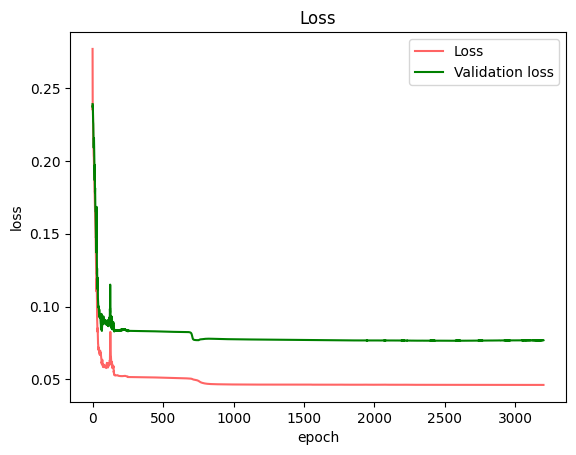

Epoch:  0 | Cost: 0.046368 | Train accuracy: 0.945714 | Validation Accuracy: 0.920000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 7, 1, 3, 3)
step 1, accuracy_train:0.6171428571428571, loss: 0.2592416400314395
step 2, accuracy_train:0.6828571428571428, loss: 0.23078682802475128
step 3, accuracy_train:0.66, loss: 0.23531718735268853
step 4, accuracy_train:0.74, loss: 0.2217796784852425
step 5, accuracy_train:0.8057142857142857, loss: 0.21619665479601402
step 6, accuracy_train:0.86, loss: 0.20801963460635955
step 7, accuracy_train:0.8771428571428571, loss: 0.1950649957864089
step 8, accuracy_train:0.88, loss: 0.19069896534343375
step 9, accuracy_train:0.9171428571428571, loss: 0.18338323388974453
step 10, accuracy_train:0.9, loss: 0.17791594977863107
step 11, accuracy_train:0.9085714285714286, loss: 0.17134158581698722
step 12, accuracy_train:0.92, loss: 0.16886426420980177
step 13, accuracy_train:0.9085714285714286, loss: 0.1638867476812566
step 14, accuracy_train:0.9257142857142857, loss: 0.15

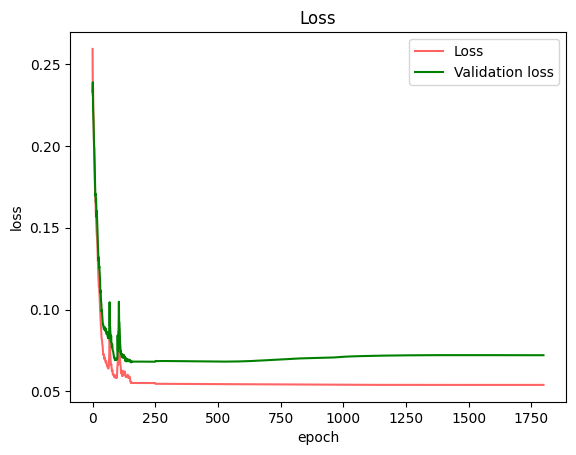

Epoch:  0 | Cost: 0.054383 | Train accuracy: 0.937143 | Validation Accuracy: 0.900000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 7, 1, 3, 3)
step 1, accuracy_train:0.5742857142857143, loss: 0.3182708282121988
step 2, accuracy_train:0.6771428571428572, loss: 0.2409275065953045
step 3, accuracy_train:0.7828571428571428, loss: 0.22692692168724077
step 4, accuracy_train:0.7542857142857143, loss: 0.23243661727969483
step 5, accuracy_train:0.78, loss: 0.21970952393575288
step 6, accuracy_train:0.8228571428571428, loss: 0.20428747914557377
step 7, accuracy_train:0.8685714285714285, loss: 0.19524772341147367
step 8, accuracy_train:0.88, loss: 0.18594812573823988
step 9, accuracy_train:0.8514285714285714, loss: 0.176012143961408
step 10, accuracy_train:0.8828571428571429, loss: 0.1664477485621322
step 11, accuracy_train:0.8857142857142857, loss: 0.15727375568084634
step 12, accuracy_train:0.8857142857142857, loss: 0.1449885679389715
step 13, accuracy_train:0.8971428571428571, loss: 0.13805775081608146

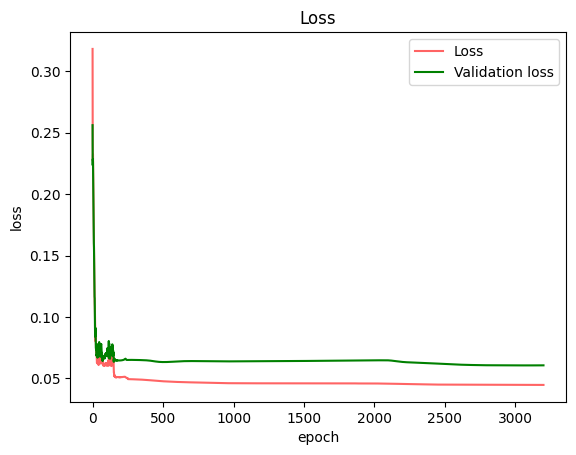

Epoch:  0 | Cost: 0.045749 | Train accuracy: 0.940000 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 7, 1, 3, 3)
step 1, accuracy_train:0.5657142857142857, loss: 0.2873540793060615
step 2, accuracy_train:0.7028571428571428, loss: 0.22888145539986193
step 3, accuracy_train:0.7857142857142857, loss: 0.22735398465740142
step 4, accuracy_train:0.82, loss: 0.22538323354932988
step 5, accuracy_train:0.7742857142857142, loss: 0.22075385827321692
step 6, accuracy_train:0.8657142857142858, loss: 0.21147054767320678
step 7, accuracy_train:0.8485714285714285, loss: 0.2048892468688421
step 8, accuracy_train:0.8828571428571429, loss: 0.19915040941581424
step 9, accuracy_train:0.8857142857142857, loss: 0.19312058496883022
step 10, accuracy_train:0.8885714285714286, loss: 0.18432988020021657
step 11, accuracy_train:0.9114285714285715, loss: 0.18067002652204417
step 12, accuracy_train:0.8942857142857142, loss: 0.1743136131395263
step 13, accuracy_train:0.8942857142857142, loss: 0.

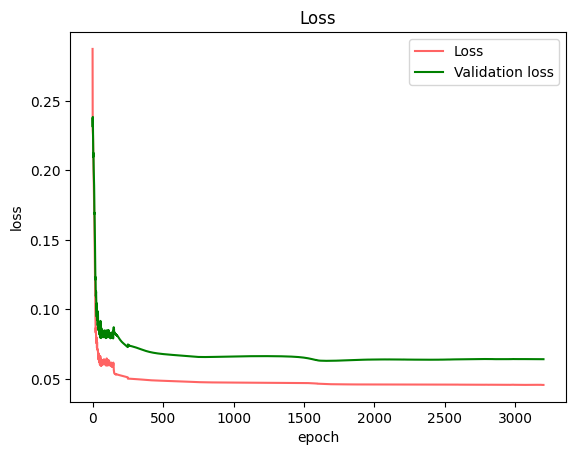

Epoch:  0 | Cost: 0.047237 | Train accuracy: 0.940000 | Validation Accuracy: 0.900000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 7, 1, 3, 3)
step 1, accuracy_train:0.5314285714285715, loss: 0.2703449518246145
step 2, accuracy_train:0.64, loss: 0.22953649931888687
step 3, accuracy_train:0.7314285714285714, loss: 0.22769248453697644
step 4, accuracy_train:0.7514285714285714, loss: 0.22347425675115834
step 5, accuracy_train:0.8057142857142857, loss: 0.21883580302733274
step 6, accuracy_train:0.8171428571428572, loss: 0.21408573279828683
step 7, accuracy_train:0.8485714285714285, loss: 0.20683063167595486
step 8, accuracy_train:0.88, loss: 0.2042268208423424
step 9, accuracy_train:0.8628571428571429, loss: 0.2032195592721765
step 10, accuracy_train:0.8628571428571429, loss: 0.1994678190572517
step 11, accuracy_train:0.8742857142857143, loss: 0.19552039199646998
step 12, accuracy_train:0.8714285714285714, loss: 0.19108707707465608
step 13, accuracy_train:0.8914285714285715, loss: 0.185902462148349

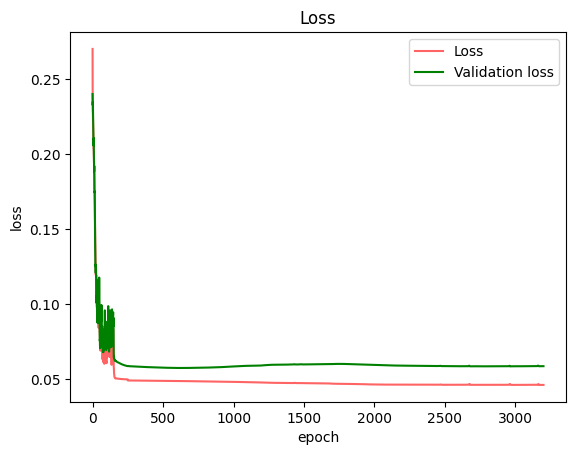

Epoch:  0 | Cost: 0.045492 | Train accuracy: 0.945714 | Validation Accuracy: 0.920000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 7, 1, 3, 3)
step 1, accuracy_train:0.6628571428571428, loss: 0.2782149129329856
step 2, accuracy_train:0.74, loss: 0.22895547273909891
step 3, accuracy_train:0.7114285714285714, loss: 0.23453361894945765
step 4, accuracy_train:0.7857142857142857, loss: 0.22625069833346131
step 5, accuracy_train:0.8314285714285714, loss: 0.2114593220320185
step 6, accuracy_train:0.8685714285714285, loss: 0.20684436477079393
step 7, accuracy_train:0.8942857142857142, loss: 0.2019166686641016
step 8, accuracy_train:0.9057142857142857, loss: 0.19589917033406945
step 9, accuracy_train:0.9, loss: 0.18842633120651753
step 10, accuracy_train:0.8914285714285715, loss: 0.18119282845478168
step 11, accuracy_train:0.8857142857142857, loss: 0.17271320366759677
step 12, accuracy_train:0.8942857142857142, loss: 0.1603540001849394
step 13, accuracy_train:0.8742857142857143, loss: 0.1534275155750603

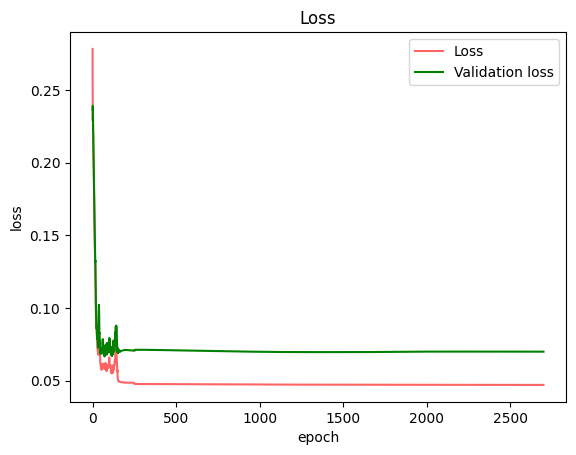

Epoch:  0 | Cost: 0.046955 | Train accuracy: 0.948571 | Validation Accuracy: 0.900000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 7, 1, 3, 3)
step 1, accuracy_train:0.64, loss: 0.3232109716848828
step 2, accuracy_train:0.6914285714285714, loss: 0.2409381203902023
step 3, accuracy_train:0.74, loss: 0.22708748737383172
step 4, accuracy_train:0.7742857142857142, loss: 0.22385423415812075
step 5, accuracy_train:0.8085714285714286, loss: 0.21970428249188517
step 6, accuracy_train:0.8257142857142857, loss: 0.2095989669788439
step 7, accuracy_train:0.8514285714285714, loss: 0.1966356991345437
step 8, accuracy_train:0.8942857142857142, loss: 0.18942264133499567
step 9, accuracy_train:0.8714285714285714, loss: 0.18000608259204748
step 10, accuracy_train:0.8885714285714286, loss: 0.17043797324208512
step 11, accuracy_train:0.8971428571428571, loss: 0.15993700767564564
step 12, accuracy_train:0.8885714285714286, loss: 0.15083821713803858
step 13, accuracy_train:0.8828571428571429, loss: 0.143407527236979

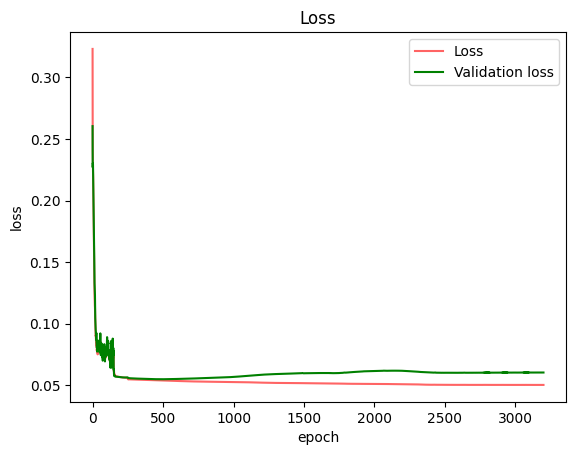

Epoch:  0 | Cost: 0.048163 | Train accuracy: 0.948571 | Validation Accuracy: 0.960000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 7, 1, 3, 3)
step 1, accuracy_train:0.6714285714285714, loss: 0.2913648211614993
step 2, accuracy_train:0.7971428571428572, loss: 0.22238178885264204
step 3, accuracy_train:0.7885714285714286, loss: 0.21290593875807398
step 4, accuracy_train:0.8485714285714285, loss: 0.21712133511941867
step 5, accuracy_train:0.8314285714285714, loss: 0.21161994203068527
step 6, accuracy_train:0.86, loss: 0.20035814945508473
step 7, accuracy_train:0.8971428571428571, loss: 0.191025896389725
step 8, accuracy_train:0.8742857142857143, loss: 0.18418405944428212
step 9, accuracy_train:0.8685714285714285, loss: 0.17492359929071336
step 10, accuracy_train:0.8885714285714286, loss: 0.16127248082707468
step 11, accuracy_train:0.9114285714285715, loss: 0.15498275162521025
step 12, accuracy_train:0.9, loss: 0.14514007802685916
step 13, accuracy_train:0.8971428571428571, loss: 0.139913938768471

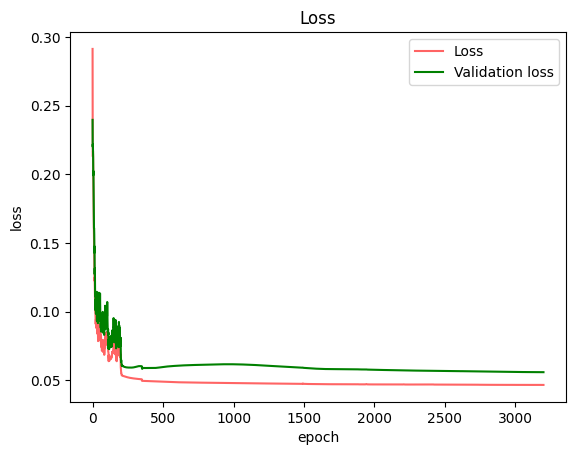

Epoch:  0 | Cost: 0.048305 | Train accuracy: 0.940000 | Validation Accuracy: 0.900000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 7, 1, 3, 3)
step 1, accuracy_train:0.5942857142857143, loss: 0.2902760699027356
step 2, accuracy_train:0.7771428571428571, loss: 0.23283303192665447
step 3, accuracy_train:0.7857142857142857, loss: 0.2274059659612971
step 4, accuracy_train:0.8485714285714285, loss: 0.22447457798945547
step 5, accuracy_train:0.8228571428571428, loss: 0.2210576949707397
step 6, accuracy_train:0.82, loss: 0.21623955953282925
step 7, accuracy_train:0.8342857142857143, loss: 0.21183195157400295
step 8, accuracy_train:0.86, loss: 0.20333217547813182
step 9, accuracy_train:0.8742857142857143, loss: 0.19668259111111486
step 10, accuracy_train:0.8571428571428571, loss: 0.19171561253448874
step 11, accuracy_train:0.88, loss: 0.1847237615106094
step 12, accuracy_train:0.86, loss: 0.18165265729066396
step 13, accuracy_train:0.8857142857142857, loss: 0.17532764391635522
step 14, accuracy_train:0

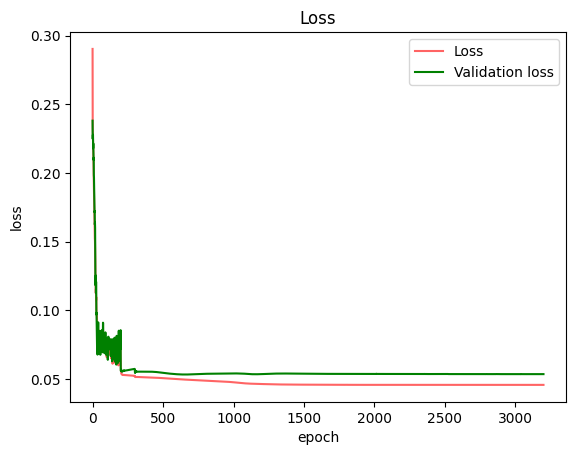

Epoch:  0 | Cost: 0.044562 | Train accuracy: 0.940000 | Validation Accuracy: 0.940000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 7, 1, 3, 3)
step 1, accuracy_train:0.5571428571428572, loss: 0.29743908929488105
step 2, accuracy_train:0.7685714285714286, loss: 0.2209620774563245
step 3, accuracy_train:0.7914285714285715, loss: 0.22188950201144905
step 4, accuracy_train:0.8342857142857143, loss: 0.2171383284396514
step 5, accuracy_train:0.8571428571428571, loss: 0.20766019853129591
step 6, accuracy_train:0.88, loss: 0.1938705700970265
step 7, accuracy_train:0.8914285714285715, loss: 0.18359324531354357
step 8, accuracy_train:0.8942857142857142, loss: 0.17079247311126297
step 9, accuracy_train:0.8942857142857142, loss: 0.15960726004746287
step 10, accuracy_train:0.9, loss: 0.15307047088022818
step 11, accuracy_train:0.9057142857142857, loss: 0.1420046810462719
step 12, accuracy_train:0.9114285714285715, loss: 0.13396667108963325
step 13, accuracy_train:0.9085714285714286, loss: 0.1269038793841042

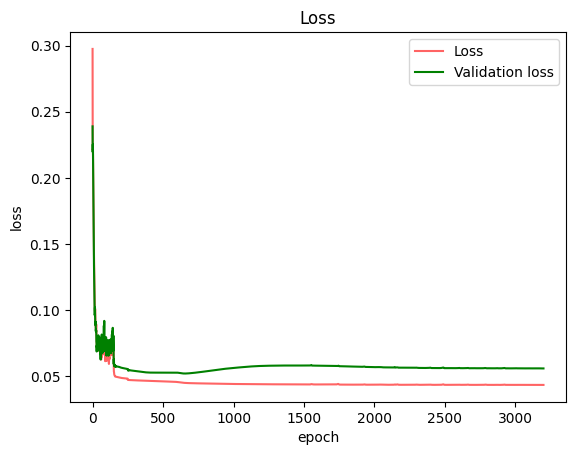

Epoch:  0 | Cost: 0.045943 | Train accuracy: 0.945714 | Validation Accuracy: 0.900000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 7, 1, 3, 3)
t_n_seeds: 5791.571523699997


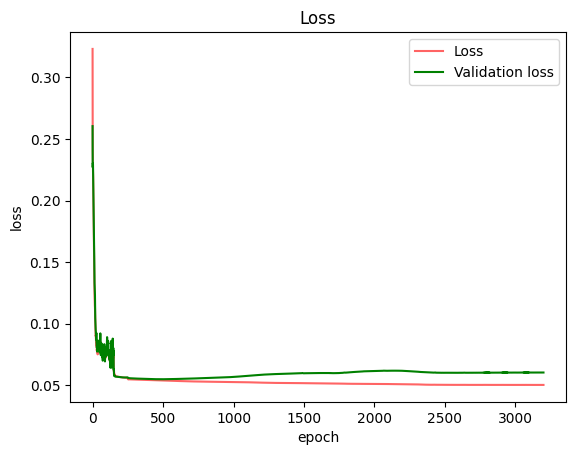

step 1, accuracy_train:0.6475, loss: 0.32325703768676284
step 2, accuracy_train:0.7125, loss: 0.23820814469912593
step 3, accuracy_train:0.795, loss: 0.22458787500883415
step 4, accuracy_train:0.8425, loss: 0.2174816570253251
step 5, accuracy_train:0.83, loss: 0.2115415574501739
step 6, accuracy_train:0.88, loss: 0.19479550047865635
step 7, accuracy_train:0.8775, loss: 0.1844521045612399
step 8, accuracy_train:0.895, loss: 0.1725633912327135
step 9, accuracy_train:0.8925, loss: 0.16381980657694162
step 10, accuracy_train:0.89, loss: 0.14776224215642714
step 11, accuracy_train:0.915, loss: 0.1318294280115097
step 12, accuracy_train:0.9125, loss: 0.12262483670916824
step 13, accuracy_train:0.9125, loss: 0.11626573617180654
step 14, accuracy_train:0.9275, loss: 0.10900710489904422
step 15, accuracy_train:0.9275, loss: 0.10758526472164759
step 16, accuracy_train:0.9075, loss: 0.10747430427244087
step 17, accuracy_train:0.91, loss: 0.10275005485863102
step 18, accuracy_train:0.915, loss: 0.

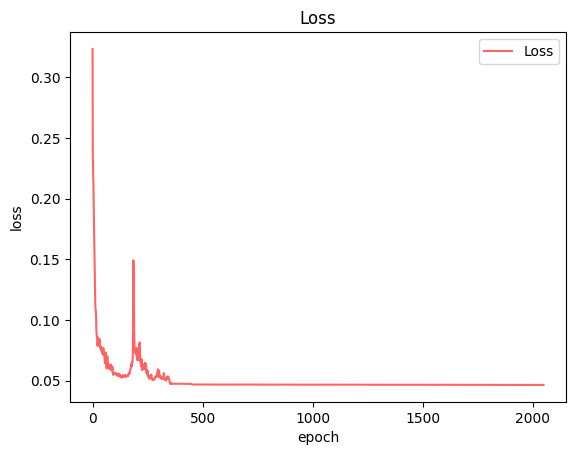

Epoch:  0 | Cost: 0.046267 | Train accuracy: 0.940000 | Test Accuracy: 0.950000
(n_dim, n_q, n_f, n_r, n_rot) = (5, 7, 1, 3, 3)


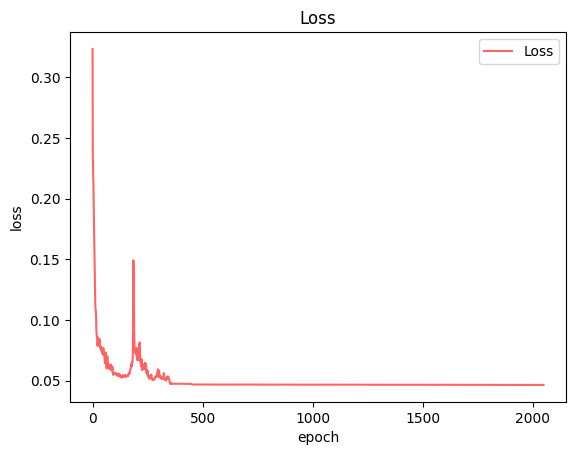

In [33]:
t_seed_start = time.process_time()
best_params = []
for i,setting in enumerate(settings):
    enc_dim,num_qubits,num_layers,num_reupload,num_rot = setting
    learning_rate,max_epoch,batch_size,dynamic_size,threshold = h_pms[best_h_pm[i]]
    t_seed_start = time.process_time()
    # Generate training and test data
    X_train, y_train, X_test, y_test = initialize_data(problem,num_training,num_test,seed_num,enc_dim)
    seed_rsts, seed_params = [], []
    loss_history_seeds= []
    #run 10 seeds
    for seed_num in seeds:
        #########
        loss_history = []
        valid_loss_history = []
        accuracy_history = []        
        iter_lr = iter(learning_rate)
        iter_thres = iter(list(threshold))
        lr = next(iter_lr)
        thres_n = next(iter_thres)
        seed_rst = run(seed_num, X_train, y_train)
        #########
        seed_params.append(seed_rst[0])
        seed_rsts.append(seed_rst[1])
        loss_history_seeds.append([loss_history,valid_loss_history])
    t_n_seeds = time.process_time()-t_seed_start
    print('t_n_seeds:', t_n_seeds)
    best_index = np.argmax(seed_rsts,axis=0)[2]  #best index based on validation accuracy->(seed_num,accuracy_train, accuracy_valid,...) 
    #best_rst = seed_rsts[best_index]
    seed_num = seeds[best_index]
    l_h_best, val_l_h_best = loss_history_seeds[best_index]
    plot_loss_history(l_h_best, val_l_h_best, setting=setting,
                      fig_name = f'{setting}_loss_best_seed')
    #########
    loss_history = []
    valid_loss_history = []
    accuracy_history = []
    iter_lr = iter(learning_rate)
    iter_thres = iter(list(threshold))
    lr = next(iter_lr)
    thres_n = next(iter_thres) 
    params,best_rst = run(seed_num, X_train, y_train, X_test, y_test, ratio_tr=1)
    plot_loss_history(loss_history, setting=setting)
    #########
    best_params.append(params)
    results.append([enc_dim,num_qubits,num_layers,num_reupload,num_rot,*best_rst, t_n_seeds])
t_seeds = time.process_time()-t_seed_start

In [34]:
def name_experiment(num_settings,start_value):
    exp_name = '('
    exp = ['enc','q','f','r','rot']
    # if len(exp)!=len(num_settings): print(experiment styles not matched!)
    for i, j in enumerate(num_settings):
        exp_name = exp_name+f'{start_value[i]}' if j==1 else exp_name+f'{exp[i]}'
        exp_name = exp_name+')' if i==len(exp)-1 else exp_name+','
    return exp_name
exp_name = name_experiment(num_settings,start_value)

In [35]:
import pandas as pd
data = {'enc_dim' : [],
        'num_qubits' : [],
        'num_layers' : [],
        'num_reupload' : [],
        'num_rot ': [],
        'seed_num' : [],
        'Train_acc' : [],
        'Test_acc' : [],
        'loss' : [],
        'num_epoch':[],
        f'time_{num_seeds}_seeds' : []}
for result in results:
    for i,(d,r) in enumerate(zip(data,result)):
        print(d,r)
        if i<5: data[d].append(int(r));
        else:   data[d].append(float(r))

# 将数据转换为DataFrame
df = pd.DataFrame(data)
df.style.hide()
# 显示DataFrame
#print(df.to_string(index=False))
# 若要在Jupyter Notebook中显示漂亮的表格，可以使用以下方法
display(df)
# 如果需要将DataFrame保存为HTML文件，可以使用以下方法
# df.to_html('table.html')

# Export to Excel
excel_file_path = f'Data_{exp_name}.xlsx'
sheet_name = 'Sheet1'

df.to_excel(excel_file_path, index=False, sheet_name=sheet_name)

enc_dim 5
num_qubits 1
num_layers 1
num_reupload 3
num_rot  3
seed_num 593
Train_acc 0.93
Test_acc 0.92
loss 0.158690587519741
num_epoch 1250
time_10_seeds 153.78415989999485
enc_dim 5
num_qubits 2
num_layers 1
num_reupload 3
num_rot  3
seed_num 469
Train_acc 0.9425
Test_acc 0.91
loss 0.0431591579579197
num_epoch 950
time_10_seeds 241.09274800000276
enc_dim 5
num_qubits 3
num_layers 1
num_reupload 3
num_rot  3
seed_num 898
Train_acc 0.94
Test_acc 0.96
loss 0.04456811318287737
num_epoch 1000
time_10_seeds 342.4051252999998
enc_dim 5
num_qubits 4
num_layers 1
num_reupload 3
num_rot  3
seed_num 469
Train_acc 0.9475
Test_acc 0.88
loss 0.037946925579571925
num_epoch 3200
time_10_seeds 981.8779726000066
enc_dim 5
num_qubits 5
num_layers 1
num_reupload 3
num_rot  3
seed_num 289
Train_acc 0.94
Test_acc 0.96
loss 0.045481876042768474
num_epoch 3200
time_10_seeds 1635.3083314000032
enc_dim 5
num_qubits 6
num_layers 1
num_reupload 3
num_rot  3
seed_num 469
Train_acc 0.9425
Test_acc 0.89
loss 0.04

,enc_dim,num_qubits,num_layers,num_reupload,num_rot,seed_num,Train_acc,Test_acc,loss,num_epoch,time_10_seeds
0,5,1,1,3,3,593.0,0.9300,0.92,0.158691,1250.0,153.784160
1,5,2,1,3,3,469.0,0.9425,0.91,0.043159,950.0,241.092748
2,5,3,1,3,3,898.0,0.9400,0.96,0.044568,1000.0,342.405125
3,5,4,1,3,3,469.0,0.9475,0.88,0.037947,3200.0,981.877973
4,5,5,1,3,3,289.0,0.9400,0.96,0.045482,3200.0,1635.308331
5,5,6,1,3,3,469.0,0.9425,0.89,0.047167,1450.0,3097.050088
6,5,7,1,3,3,289.0,0.9400,0.95,0.046267,2050.0,5791.571524


In [36]:
rec_settings = {'problem':problem,
                'shape':shape, 
                'rot':rot,
                'num_training':len(X_train),
                'num_test':len(X_test),
                'preprocess':preprocess,
                'max_converge_number':max_n_converge,
                'threshold_of_converge':thres_converge,
                'data_seed_num': data_seed_num,
                'param_seed_nums': seeds,
                f't_{num_cvs}_cv': f'{t_cvs} s',
                f't_{num_seeds}_seeds': f'{t_seeds} s',
                '[enc_dim,num_qubits,num_layers,num_reupload,num_rot]':settings,
                '[learning_rate,max_epoch,batch_size,dynamic_size,threshold]':[h_pms[i] for i in best_h_pm ]
               }
#dict_settings = {k:v for i,(k,v) in enumerate(data.items()) if i<6 }

In [37]:
F = open("{}_settings.txt".format(ver), "w")
for i,j in rec_settings.items():
    F.write(i+": {}\n".format(j))


# F.write("t_{}_cv: {} s\n".format(num_cvs, t_cvs))    
# F.write("t_{}_seeds: {} s\n".format(num_seeds, t_seeds))

F.write("params ：{} \n".format(best_params))
F.close()

In [38]:
print(t_cvs)
t_seeds

36336.2923276


6245.891732299999

In [39]:
# F = open("{}_settings.txt".format(ver), "w")
# settings = [problem,num_training,num_test,num_qubits,num_layers,learning_rate,epochs
#             ,batch_size,dynamic_size,threshold,preprocess,seed_num]
# F.write(("problem:{}\n"+"num_training:{}\n"+"num_test:{}\n"+"num_qubits:{}\n"+"num_layers:{}\n"+"learning_rate:{}\n"+" epochs:{}\n"
#          +"batch_size:{}\n"+"dynamic_size:{}\n"+"threshold:{}\n"+"preprocess:{}\n"+"seed_num:{}\n").format(*settings))
# F.write("process_time ：{} \n".format(t_tot))
# F.write("params ：{} \n".format(params))
# print(params)
# F.close()

In [40]:
len(loss_history)

2050

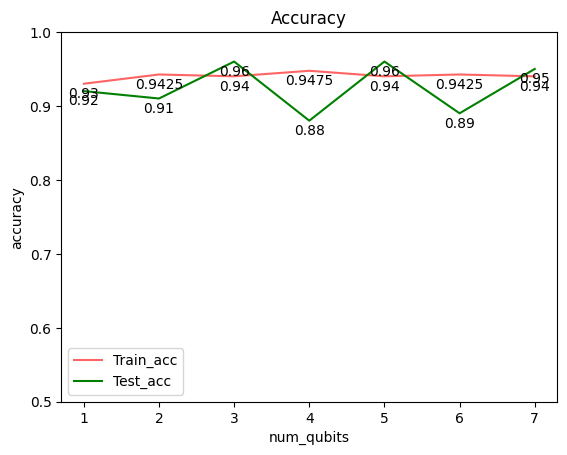

In [51]:
for run_exp, x_label in zip([i != 1 for i in num_settings],data):
    if run_exp:
        fig, ax = plt.subplots(1, 1)
        ax.set_ylim([0.5, 1])
        plt.plot(data[x_label],data['Train_acc'],color=(255/255,100/255,100/255),label='Train_acc')
        plt.plot(data[x_label],data['Test_acc'],color='g',label='Test_acc')
        for i,j,k in zip(data[x_label],data['Train_acc'],data['Test_acc']):
            ax.annotate(f'{j}', xy=(i,j), xytext=(0,-10), textcoords='offset points' ,ha='center')
            ax.annotate(f'{k}', xy=(i,k), xytext=(0,-10), textcoords='offset points' ,ha='center')
        plt.title("Accuracy") # title
        plt.ylabel("accuracy") # y label
        plt.xlabel(x_label) # x label
        plt.legend()
        plt.show()
        fig.savefig(f'Accuracy-{x_label}.png', transparent=True)

In [54]:
def backtrack(n, k, start, path, result):
    if len(path) == k:
        result.append(path[:])
        return
    
    for i in range(start, n + 1):
        path.append(i)
        backtrack(n, k, i, path, result)  # Use i instead of i+1 to allow duplicates
        path.pop()

def generate_combinations(n, k):
    result = []
    backtrack(n, k, 1, [], result)
    return result

# Example usage:
n = 5  # Range from 1 to 5
k = 4  # Length of the array
combinations = generate_combinations(n, k)
print((combinations))


[[1, 1, 1, 1], [1, 1, 1, 2], [1, 1, 1, 3], [1, 1, 1, 4], [1, 1, 1, 5], [1, 1, 2, 2], [1, 1, 2, 3], [1, 1, 2, 4], [1, 1, 2, 5], [1, 1, 3, 3], [1, 1, 3, 4], [1, 1, 3, 5], [1, 1, 4, 4], [1, 1, 4, 5], [1, 1, 5, 5], [1, 2, 2, 2], [1, 2, 2, 3], [1, 2, 2, 4], [1, 2, 2, 5], [1, 2, 3, 3], [1, 2, 3, 4], [1, 2, 3, 5], [1, 2, 4, 4], [1, 2, 4, 5], [1, 2, 5, 5], [1, 3, 3, 3], [1, 3, 3, 4], [1, 3, 3, 5], [1, 3, 4, 4], [1, 3, 4, 5], [1, 3, 5, 5], [1, 4, 4, 4], [1, 4, 4, 5], [1, 4, 5, 5], [1, 5, 5, 5], [2, 2, 2, 2], [2, 2, 2, 3], [2, 2, 2, 4], [2, 2, 2, 5], [2, 2, 3, 3], [2, 2, 3, 4], [2, 2, 3, 5], [2, 2, 4, 4], [2, 2, 4, 5], [2, 2, 5, 5], [2, 3, 3, 3], [2, 3, 3, 4], [2, 3, 3, 5], [2, 3, 4, 4], [2, 3, 4, 5], [2, 3, 5, 5], [2, 4, 4, 4], [2, 4, 4, 5], [2, 4, 5, 5], [2, 5, 5, 5], [3, 3, 3, 3], [3, 3, 3, 4], [3, 3, 3, 5], [3, 3, 4, 4], [3, 3, 4, 5], [3, 3, 5, 5], [3, 4, 4, 4], [3, 4, 4, 5], [3, 4, 5, 5], [3, 5, 5, 5], [4, 4, 4, 4], [4, 4, 4, 5], [4, 4, 5, 5], [4, 5, 5, 5], [5, 5, 5, 5]]


In [42]:
for i in best_h_pm:
    print(h_pms[i])
best_h_pm

[[0.15, 0.05, 0.01], 3200, 50, 50, [0.05, 0.03, 0.01]]
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 100, 50, [0.05, 0.03, 0.01]]
[[0.15, 0.05, 0.01, 0.001, 0.0001], 3200, 50, 50, [0.05, 0.03, 0.01]]
[[0.15, 0.05, 0.01], 3200, 100, 50, [0.05, 0.03, 0.01]]
[[0.15, 0.05, 0.01], 3200, 100, 50, [0.05, 0.03, 0.01]]
[[0.15, 0.05, 0.01], 3200, 300, 50, [0.05, 0.03, 0.01]]
[[0.15, 0.05, 0.01], 3200, 100, 50, [0.05, 0.03, 0.01]]


[0, 4, 3, 1, 1, 2, 1]

In [43]:
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score, classification_report

X_train, y_train, X_test, y_test = initialize_data(problem,num_training,num_test,seed_num,enc_dim)
max_search_n=20
n_nodes = []
t1_c = time.process_time()
for f in range(r_f):
    scores=[]
    for n in range(max_search_n):
        size = [n+1]*(f+1)
        clf = MLPClassifier(solver='adam', alpha=1e-5,hidden_layer_sizes=size, 
                            random_state=data_seed_num,max_iter=6000, warm_start=False)
        score = np.min(cross_val_score(clf, X_train, y_train, cv=10))  
        if score >= data['Test_acc'][f] or n == (max_search_n-1): 
            n_nodes.append(n+1)
            break

sizes = [[n_nodes[f]]*(f+1) for f in range(r_f)]
accuracy_tr, accuracy=[],[]

for size in sizes:
    seed_tr_rsts, seed_rsts = [], []
    for seed in seeds:
        clf = MLPClassifier(solver='adam', alpha=1e-5,hidden_layer_sizes=size, 
                                random_state=seed,max_iter=6000, warm_start=False)
        clf.fit(X_train, y_train)
        y_pred_tr = clf.predict(X_train)
        y_pred = clf.predict(X_test)
        # report = classification_report(y_test, y_pred)
        seed_tr_rsts.append(accuracy_score(y_train, y_pred_tr))
        seed_rsts.append(accuracy_score(y_test, y_pred))
    accuracy_tr.append(np.average(seed_tr_rsts))
    accuracy.append(np.average(seed_rsts))
t_c_tot = time.process_time()-t1_c
print(f'Time for classical NN: {t_c_tot} s')
print(accuracy_tr)
print(accuracy)
print(data['Test_acc'])
n_nodes

Time for classical NN: 732.7974520000062 s
[0.93875]
[0.869]
[0.92, 0.91, 0.96, 0.88, 0.96, 0.89, 0.95]


[20]

In [44]:
def param_n_model(setting, model='NN'):
    if model=='NN':
        n_nodes = setting
        
        n_params = []
        r_f = len(n_nodes)
        for f in range(r_f):
            n_p=0
            for i in range(f+1):
                n_p=n_p+(len(X_train[0])+1)*n_nodes[f] if i==0  else n_p
                n_p=n_p+(n_nodes[i]+1)*num_class if i==(r_f-1) else n_p
                n_p=n_p+(n_nodes[f]+1)*n_nodes[f] if i!=0 or i!=(r_f-1) else n_p
            n_params.append(n_p)
    if model=='QNN':
        enc_dim,num_qubits,num_layers,num_reupload,num_rot = setting
        n_params = (enc_dim +n_rot*3)*num_qubits*num_reupload*num_layers+ num_class* num_qubits

    return n_params
num_params_NN = param_n_model(n_nodes,model='NN')
num_params_QNN = [param_n_model(setting,model='QNN') for setting in settings]

print('Number of params in NN model:', num_params_NN)
print('Number of params in QNN model:', num_params_QNN)

Number of params in NN model: [162]
Number of params in QNN model: [44, 88, 132, 176, 220, 264, 308]


In [45]:
import pandas as pd
c_values=np.array([n_nodes,accuracy_tr,accuracy,data['Test_acc'],
                   num_params_NN,num_params_QNN,[t_c_tot]*len(settings)])
c_values=np.append(settings,c_values.T, axis=1)
c_data = {'enc_dim' : [],
        'num_qubits' : [],
        'num_layers' : [],
        'num_reupload' : [],
        'num_rot ': [],
        'num_c_nodes ': [],
        'C_train_acc' : [],
        'C_test_acc' : [],
        'Q_test_acc' : [],
        'num_params_NN' : [],
        'num_params_QNN' : [],
        f'time_{num_seeds}_seeds' : []}
for result in c_values:
    for i,(d,r) in enumerate(zip(c_data,result)):
        if i<6: c_data[d].append(int(r));
        else:   c_data[d].append(float(r))
df = pd.DataFrame(c_data)
df.style.hide()
display(df)
# Export to Excel
excel_file_path = f'classical_data_comparism.xlsx'
sheet_name = 'Sheet1'
df.to_excel(excel_file_path, index=False, sheet_name=sheet_name)

/tmp/ipykernel_12056/881509092.py:2: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  c_values=np.array([n_nodes,accuracy_tr,accuracy,data['Test_acc'],


ValueError: all the input arrays must have same number of dimensions, but the array at index 0 has 2 dimension(s) and the array at index 1 has 1 dimension(s)

In [ ]:
for fx

In [ ]:
from qiskit.providers.fake_provider import FakeBelem
backend = FakeBelem()
# backend.qubit_properties()
from datetime import datetime

t = datetime(day=15, month=4, year=2020, hour=10)
backend.properties(datetime=t)

In [ ]:
X_test.shape

In [ ]:
F = open("{}_settings.txt".format(ver), "a")
print(
    "Cost: {:3f} | Train accuracy {:3f} | Test Accuracy : {:3f}".format(
        loss, accuracy_train, accuracy_test
    ), file = F)#)#

fig, axes = plt.subplots(1, 3, figsize=(10, 3))
plot_data(X_test[:,:], initial_predictions, fig, axes[0])
plot_data(X_test[:,:], predicted_test, fig, axes[1])
plot_data(X_test[:,:], y_test, fig, axes[2])
axes[0].set_title("Predictions with random weights")
axes[1].set_title("Training Accuracy = {} \n Test Accuracy = {}".format(accuracy_train,accuracy_test))
axes[2].set_title("True test data \n # of points = {}".format(num_test))
plt.tight_layout()
plt.show()
fig.savefig('{}_train.png'.format(ver), transparent=True)

In [ ]:
#initialize_data(problem,num_Test,seed_num=seed_num)

In [ ]:
num_Test = 568

X_Test, y_Test = initialize_data(problem,num_Test,seed_num=seed_num)#data_gen(problem,num_Test,seed_num=np.random.randint(num_Test))#circle(num_test)#
predicted_Test, loss, _  = test(params, X_Test, y_Test)
accuracy_Test = accuracy_score(y_Test, predicted_Test)  


print("Cost: {:3f} | Train accuracy {:3f} | Test Accuracy : {:3f}".format(
        loss, accuracy_train, accuracy_Test), file = F)



fig, axes = plt.subplots(1, 3, figsize=(10, 3))
plot_data(X_train[:,:,], y_train, fig, axes[0])
plot_data(X_Test[:,:], predicted_Test, fig, axes[1])
plot_data(X_Test[:,:], y_Test, fig, axes[2])
axes[0].set_title("Training data")
axes[1].set_title("Predictions after training \n Accuracy = {}".format(accuracy_Test))
axes[2].set_title("True test data \n # of points = {}".format(num_Test))
plt.tight_layout()
plt.show()
fig.savefig('{}_test.png'.format(ver), transparent=True)
print("process_time ：%f s" % (time.process_time()- end))

In [ ]:
for fx

In [ ]:
%whos 

In [ ]:
# from qiskit_ibm_provider import least_busy
# backend = least_busy(provider.backends(min_num_qubits=5,simulator=False,operational=True))
# backend = backend.name
# print(backend)

In [ ]:
#noisy device
str_error = None
noise=True
noise_num_Test = 100
sleep_time = 2
num_retries = 10
noise_batch_size = 9 if real_device else noise_num_Test
#ver = ver+'_'+backend if noise else ver

noise_start = time.time()
noise_XTest, noise_y_Test = data_gen(problem,noise_num_Test,seed_num=noise_num_Test)#circle(num_test)#
noise_X_Test = np.hstack((np.zeros((noise_num_Test,1)), noise_XTest))
noise_predicted_Test = jnp.array([])
noise_minibatches = iterate_minibatches(noise_X_Test, noise_y_Test, batch_size=noise_batch_size)
backend = 'ibm_algiers'
print(backend,noise_start)

In [ ]:
while True:
    try: 
        if not str_error:
            Xbatch, ybatch = next(noise_minibatches)
        for x in range(0, num_retries):  
            try:
                str_error = 'Calculating...'
                predicted, loss, _  = test(params, Xbatch, ybatch)
                noise_predicted_Test = jnp.append(noise_predicted_Test, predicted)
                print(predicted)
                str_error = None
            except Exception as e:
                str_error = str(e)
                print('err:',str_error)
            if str_error:               # if None->break, if 'some_string'(error happens)->sleep and retry
                time.sleep(sleep_time)  # wait before trying to fetch the data again
                sleep_time *= 1.5  
                if x==(num_retries-1):
                    print('operation fail')
                else:
                    print(f'retry {x} times')
            else:
                break
    except StopIteration:
        break
noise_end = time.time()

In [ ]:
def device(noise=False,real_device=False,backend=backend,noise_model=None):
    if noise:
        if real_device:
            dev = qml.device('qiskit.ibmq.sampler', wires=2, backend=backend, 
                             provider=provider,initial_layout= [4,7],start_session=True)#)#
        else:
            if not noise_model:
                noise_model = model_noise(backend,fake_backend)
            dev = qml.device('qiskit.aer', wires=2, diff_method="adjoint", noise_model=noise_model)#
    else: 
        dev = qml.device("default.qubit", wires=2)
    return dev
def conditional_qnode(dev,noise=False):
    if noise:
        #print('noise circ operated')
        return qml.qnode(dev) 
    else: 
        return qml.qnode(dev,interface='jax')

In [ ]:
Xbatch, ybatch = next(noise_minibatches)
test(params, Xbatch, ybatch)

In [ ]:
noise_accuracy_Test = accuracy_score(noise_y_Test, noise_predicted_Test)  
print("noise:",noise,", real_device:",real_device,', backend:',backend,', num_noise_Test:',noise_num_Test,file = F)#)#
print("Cost: {:3f} | Noisy Test Accuracy : {:3f}".format(loss, noise_accuracy_Test), file = F)#)#
print("process_time ：%f s" % (noise_end- noise_start), file = F)#)#
print(datetime.datetime.now(), file = F)#)#
print('noise_model:', None if real_device else noise_model, file = F)
F.close()#
fig, axes = plt.subplots(1, 3, figsize=(10, 3))
plot_data(X_train, y_train, fig, axes[0])
plot_data(noise_X_Test[:,1:], noise_predicted_Test, fig, axes[1])
plot_data(noise_X_Test[:,1:], noise_y_Test, fig, axes[2])
axes[0].set_title("Training data")
axes[1].set_title("Predictions after training \n Accuracy with noise = {}".format(noise_accuracy_Test))
axes[2].set_title("True test data \n # of points = {}".format(noise_num_Test))
plt.tight_layout()
plt.show()
fig.savefig('{}_noise_test.png'.format(ver), transparent=True)

In [ ]:
qml.about()

In [ ]:
a = [(i,j) for i,j in zip(globals().keys(),globals().values())]
import sys
for i,j in a:
    print(i,sys.getsizeof(j))

In [ ]:
ibm_brisbane

In [ ]:
dev = qml.device('qiskit.ibmq', wires=2, backend=backend, provider=provider)

In [ ]:
# minimum qiskit-runtime connect-testing code

sleep_time = 5
num_retries = 5
str_error = None
initial_layout = [1,2]# None#
backend = 'ibmq_mumbai' #'ibmq_qasm_simulator' # or 
program_id = 'qiskit.ibmq.sampler' #'qiskit.ibmq.circuit_runner' # 
provider = IBMProvider(instance='ibm-q-hub-ntu/ntu-internal/default')
dev = qml.device(program_id, wires=2, backend=backend
                 , provider=provider,initial_layout=initial_layout,start_session=True)

@qml.qnode(dev)
def circuit(x, y):
    qml.RY(y, wires=[0])
    qml.RX(x, wires=[0])
    qml.CNOT(wires=[0,1])
    return qml.expval(qml.Hermitian([[1,0],[0,0]],wires=0)),qml.expval(qml.PauliY(wires=1))

data = iter([[[0.1,0.2,0.3],[0.2,0.3,0.4]],[[0.4,0.5,0.6],[0.5,0.6,0.7]]])

while True:
    try:
        if not str_error:
            databatch=next(data)
        for x in range(0, num_retries):  
            try:
                rst = circuit(*databatch)
                print('result:',rst)
                str_error = None
            except  Exception as e:
                str_error = str(e)
                print(e)
            if str_error:               # if None->break; if 'some_string'(error happens)->sleep
                time.sleep(sleep_time)  # wait before trying to fetch the data again
                sleep_time *= 3
                print(f'retry {x} times')
            else:
                break
    except StopIteration:
        break

In [ ]:
dm_labels[0]

In [ ]:
initial_layout = [1,2]#None #
backend = 'ibm_auckland'# 'ibmq_qasm_simulator' # or 
program_id = 'qiskit.ibmq.sampler' #'qiskit.ibmq.circuit_runner' # 
provider = IBMProvider(instance='ibm-q-hub-ntu/ntu-internal/default')
dev = qml.device(program_id, wires=2, backend=backend
                 , provider=provider,initial_layout=initial_layout)

@qml.qnode(dev)
def circuit(x, y):
    qml.RY(y, wires=[0])
    qml.RX(x, wires=[0])
    qml.CNOT(wires=[0,1])
    return qml.expval(qml.PauliZ(wires=0)),qml.expval(qml.PauliY(wires=1))

data = iter([[[0.1,0.2,0.3],[0.2,0.3,0.4]],[[0.4,0.5,0.6],[0.5,0.6,0.7]]])
databatch = next(data)
databatch = next(data)
circuit(*databatch)

In [ ]:
from qiskit_ibm_runtime import QiskitRuntimeService, Sampler, Estimator, Session

In [ ]:
##qiskit version
from qiskit import *
from qiskit.compiler import transpile, assemble
from qiskit_ibm_runtime import QiskitRuntimeService, Session, Sampler, Estimator, Options

shots = 2048
sleep_time = 5
num_retries = 5
str_error = None
initial_layout = None#[1,2]
provider = IBMProvider(instance='ibm-q-hub-ntu/ntu-internal/default')
backend = provider.get_backend('ibmq_jakarta')#'ibm_hanoi')#'ibmq_qasm_simulator')#'ibmq_quito')
runtime_service = QiskitRuntimeService(channel="ibm_quantum")
options = {"backend": backend.name}
def qcircuit(x,y):
    qr = QuantumRegister(2)
    cr = ClassicalRegister(2)
    circuit = QuantumCircuit(qr, cr)
    circuit.rx(x,qr[0])
    circuit.ry(y,qr[1])
    circuit.cx(qr[0], qr[1])
    circuit.measure(qr, cr)
    mapped_circuit = transpile(circuit, backend=backend)
    return mapped_circuit
data = iter([[0.1,0.2],[0.2,0.3],[0.4,0.5]])

while True:
    try:
        if not str_error:
            databatch=next(data)
        for x in range(0, num_retries):  
            try:
                program_inputs = {"circuits": qcircuit(*databatch)  , "shots": shots , 'initial_layout':initial_layout
                                  , 'optimization_level': 3,'start_session': True}
                job = runtime_service.run(program_id="circuit-runner", options=options, inputs=program_inputs)#
                counts = job.result().get_counts()
                print('result:',counts)
                str_error = None
            except  Exception as e:
                str_error = str(e)
                print(e)
            if str_error:               # if None->break; if 'some_string'(error happens)->sleep
                time.sleep(sleep_time)  # wait before trying to fetch the data again
                sleep_time *= 3
                print(f'retry {x} times')
            else:
                break
    except StopIteration:
        break

In [ ]:
circuit(*databatch)

In [ ]:
# provider = IBMProvider()
# dev = qml.device('qiskit.ibmq', wires=2, backend=backend, provider=provider)
# dev.capabilities()['backend']

In [ ]:
from sklearn.datasets import load_breast_cancer
data = load_breast_cancer()
x,y = load_breast_cancer(return_X_y=True)
x.shape